In [9]:
# import torch
# import torchvision.transforms as transforms
# import torch.nn as nn
# import torch.nn.functional as F
# import torch.optim as optim
# from torch.utils.data import DataLoader, random_split
# from torchvision.datasets import ImageFolder
# import fiftyone.zoo as foz

# dataset = foz.load_zoo_dataset(
#     "open-images-v7",
#     label_types=["detections"],
#     max_samples=30,
#     classes=["House", "Building", "Cabinetry", "Furniture", "Desk", "Door", "Kitchen appliance"],
# )

Necessary images already downloaded
Existing download of split 'train' is sufficient
Necessary images already downloaded
Existing download of split 'test' is sufficient
Necessary images already downloaded
Existing download of split 'validation' is sufficient
Loading existing dataset 'open-images-v7-30'. To reload from disk, either delete the existing dataset or provide a custom `dataset_name` to use


In [10]:
# import fiftyone as fo

# session = fo.launch_app(dataset)
# session.wait()

In [ ]:
# dataset.export(
#     export_dir="open_images",
#     dataset_type=fo.types.COCODetectionDataset,
#     label_field="ground_truth",
# )

 100% |███████████████████| 90/90 [3.8s elapsed, 0s remaining, 16.2 samples/s]      


In [ ]:
# dataset.export(
#     export_dir="open_images_classification",
#     dataset_type=fo.types.ImageClassificationDirectoryTree,
#     label_field="ground_truth",
# )

Detected an image classification exporter and a label field 'ground_truth' of type <class 'fiftyone.core.labels.Detections'>. Exporting image patches...
 100% |███████████████| 1281/1281 [52.7s elapsed, 0s remaining, 32.4 samples/s]      


In [2]:
import torch
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, random_split
from torchvision.datasets import ImageFolder

# Преобразование данных для использования в PyTorch
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

dataset_torch = ImageFolder(root='open_images_classification', transform=transform)
print(dataset_torch)

Dataset ImageFolder
    Number of datapoints: 5066
    Root location: open_images_classification
    StandardTransform
Transform: Compose(
               Resize(size=(64, 64), interpolation=bilinear, max_size=None, antialias=True)
               ToTensor()
               Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
           )


In [3]:
train_size = int(0.8 * len(dataset_torch))
test_size = len(dataset_torch) - train_size
train_dataset, test_dataset = random_split(dataset_torch, [train_size, test_size])

trainloader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=2)
testloader = DataLoader(test_dataset, batch_size=4, shuffle=False, num_workers=2)

classes = dataset_torch.classes

In [4]:
import torch
import torchvision.transforms as transforms
import torch.nn as nn
# import torch.nn.functional as F
# import torch.optim as optim
# from torch.utils.data import DataLoader, random_split
# from torchvision.datasets import ImageFolder

# Определение модели CNN
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(3, 32, 3, padding=1)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 64, 3, padding=1)
        self.conv3 = nn.Conv2d(64, 64, 3, padding=1)
        self.fc1 = nn.Linear(64 * 8 * 8, 64)
        self.fc2 = nn.Linear(64, len(classes))  # количество выходных классов

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))
        x = x.view(-1, 64 * 8 * 8)
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x

net = Net()
net

Net(
  (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (fc1): Linear(in_features=4096, out_features=64, bias=True)
  (fc2): Linear(in_features=64, out_features=170, bias=True)
)

In [5]:
import torch.nn.functional as F
import torch.optim as optim

# Определение функции потерь и оптимизатора
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(net.parameters(), lr=0.001)


In [7]:
import numpy as np
import matplotlib.pyplot as plt

mean = [0.4670, 0.4735, 0.4662]
std = [0.2496, 0.2489, 0.2521]

preprocess = transforms.Compose([
    transforms.Normalize(mean=mean, std=std)
])

device = "cuda" if torch.cuda.is_available() else "cpu"

input_tensors = []

# Оценка модели и вывод изображений с предсказаниями
def imshow(img):
    img = img / 2 + 0.5  # unnormalize
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()


labels ---> tensor([ 96,  36,  69, 164])
predicted ---> tensor([164, 164, 150, 164])
total ---> 4
correct ---> 1
Истинный класс: Man, Предсказанный класс: Window


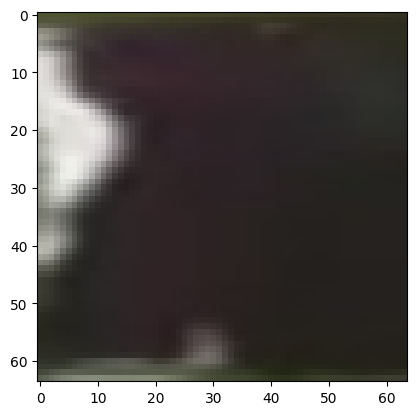

Истинный класс: Clothing, Предсказанный класс: Window


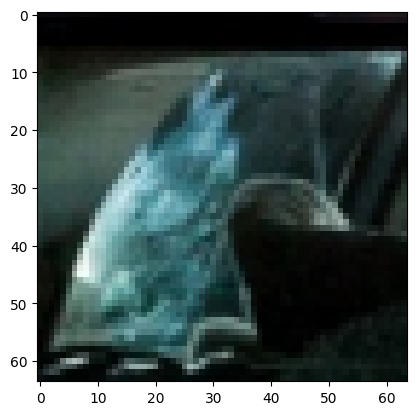

Истинный класс: House, Предсказанный класс: Tree


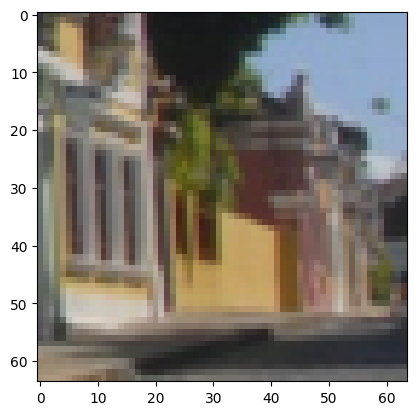

Истинный класс: Window, Предсказанный класс: Window


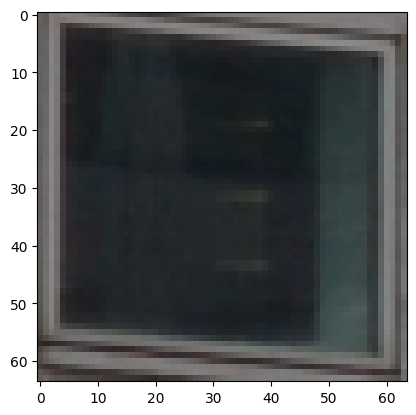

labels ---> tensor([ 63,  67,  61, 159])
predicted ---> tensor([108,  25, 108, 164])
total ---> 8
correct ---> 1
Истинный класс: Furniture, Предсказанный класс: Person


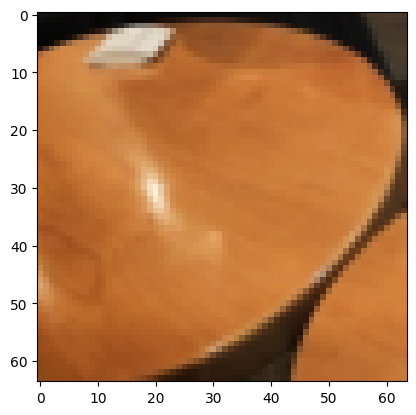

Истинный класс: Goat, Предсказанный класс: Building


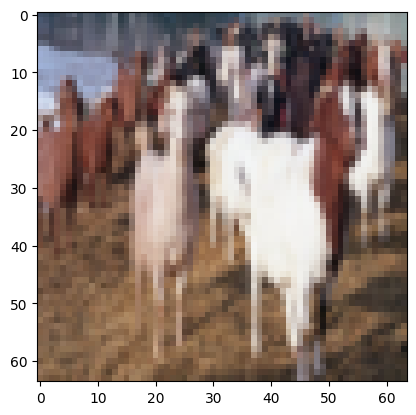

Истинный класс: Footwear, Предсказанный класс: Person


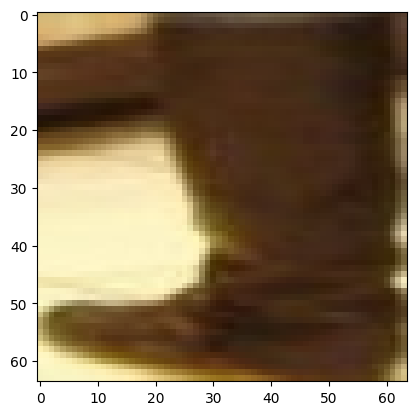

Истинный класс: Waste container, Предсказанный класс: Window


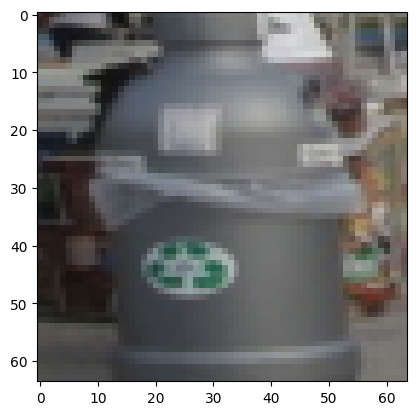

labels ---> tensor([25, 79, 95, 77])
predicted ---> tensor([ 25, 164,  61,  77])
total ---> 12
correct ---> 3
Истинный класс: Building, Предсказанный класс: Building


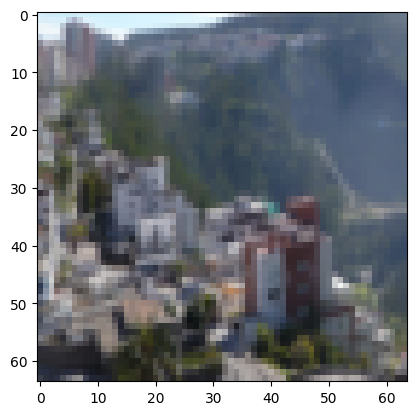

Истинный класс: Human leg, Предсказанный класс: Window


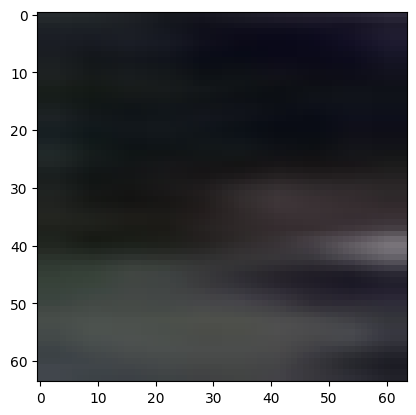

Истинный класс: Mammal, Предсказанный класс: Footwear


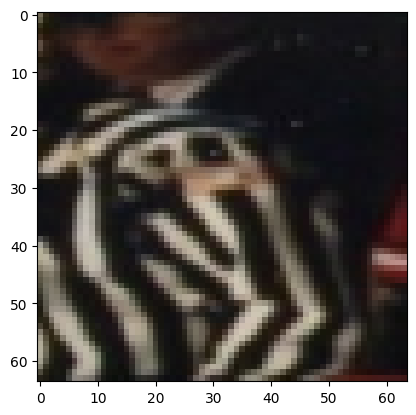

Истинный класс: Human hand, Предсказанный класс: Human hand


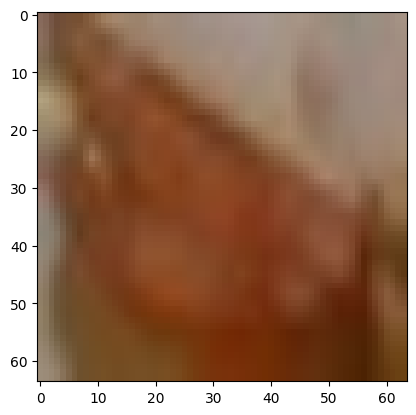

labels ---> tensor([108, 138,  96,  60])
predicted ---> tensor([108, 164,  25, 108])
total ---> 16
correct ---> 4
Истинный класс: Person, Предсказанный класс: Person


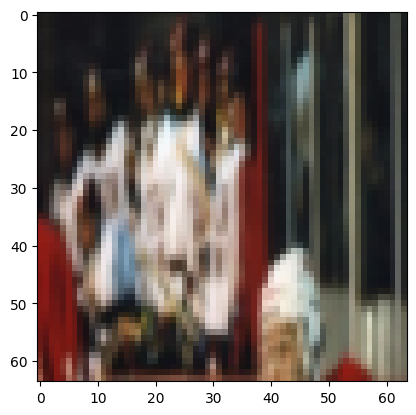

Истинный класс: Tableware, Предсказанный класс: Window


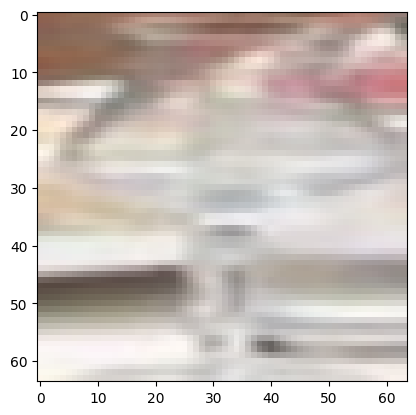

Истинный класс: Man, Предсказанный класс: Building


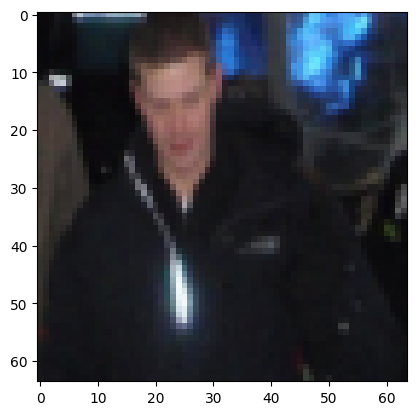

Истинный класс: Food, Предсказанный класс: Person


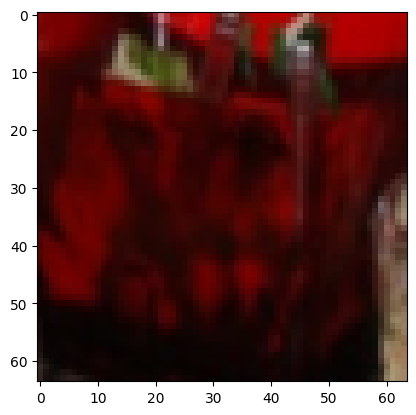

labels ---> tensor([ 61, 168,  47, 136])
predicted ---> tensor([164, 108, 164, 108])
total ---> 20
correct ---> 4
Истинный класс: Footwear, Предсказанный класс: Window


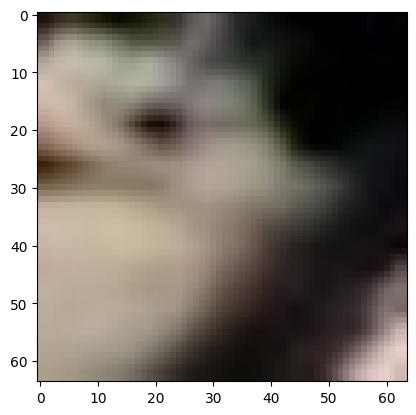

Истинный класс: Woman, Предсказанный класс: Person


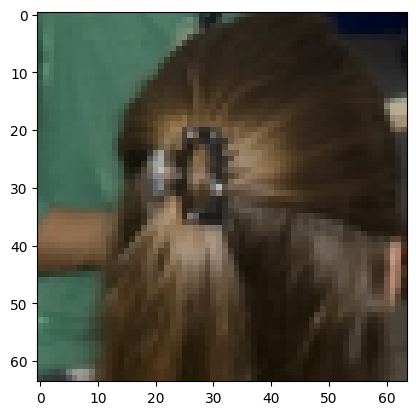

Истинный класс: Door, Предсказанный класс: Window


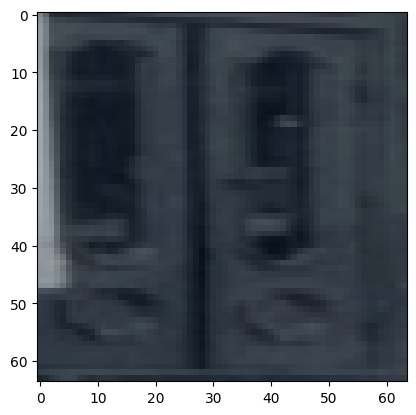

Истинный класс: Table, Предсказанный класс: Person


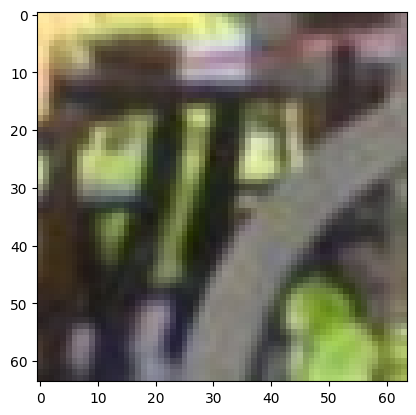

labels ---> tensor([164, 112,  96,  96])
predicted ---> tensor([ 25, 164, 164,  61])
total ---> 24
correct ---> 4
Истинный класс: Window, Предсказанный класс: Building


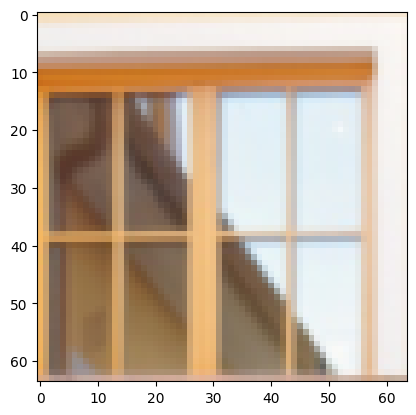

Истинный класс: Plant, Предсказанный класс: Window


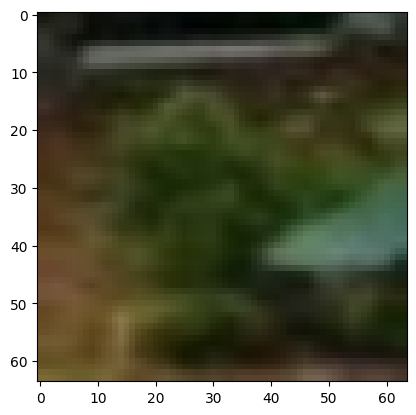

Истинный класс: Man, Предсказанный класс: Window


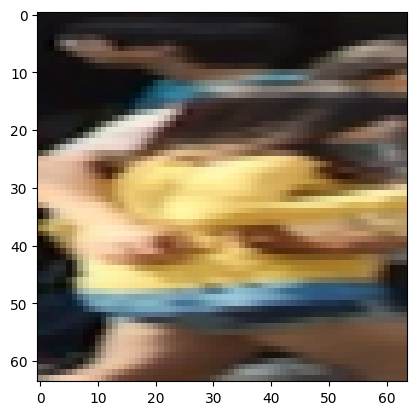

Истинный класс: Man, Предсказанный класс: Footwear


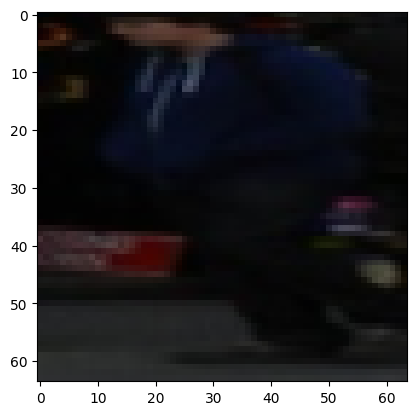

labels ---> tensor([162,  17,  75, 150])
predicted ---> tensor([164,  69,  61, 150])
total ---> 28
correct ---> 5
Истинный класс: Wheel, Предсказанный класс: Window


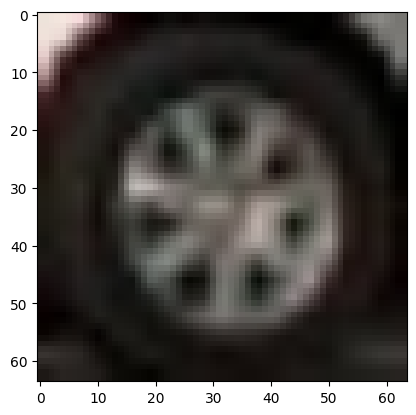

Истинный класс: Book, Предсказанный класс: House


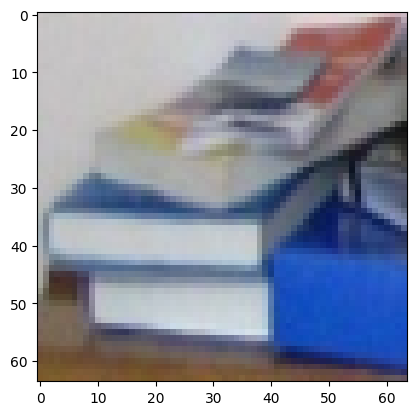

Истинный класс: Human face, Предсказанный класс: Footwear


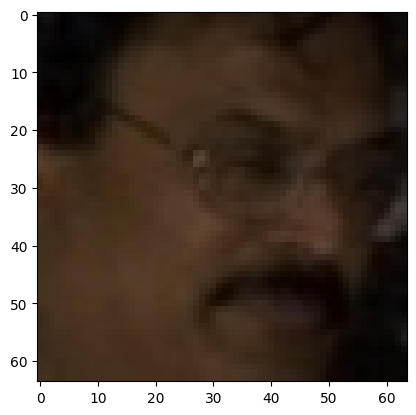

Истинный класс: Tree, Предсказанный класс: Tree


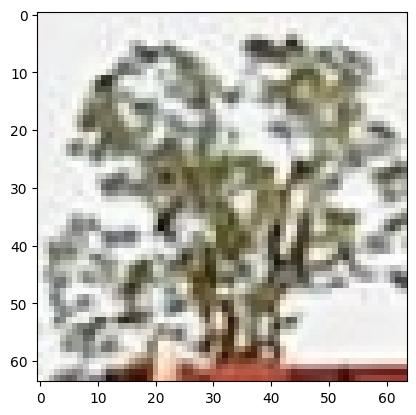

labels ---> tensor([ 63, 164,  79,  75])
predicted ---> tensor([ 25, 164, 164, 164])
total ---> 32
correct ---> 6
Истинный класс: Furniture, Предсказанный класс: Building


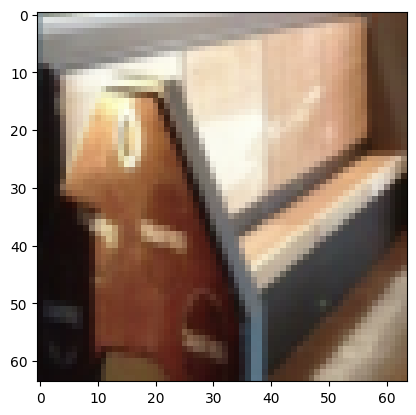

Истинный класс: Window, Предсказанный класс: Window


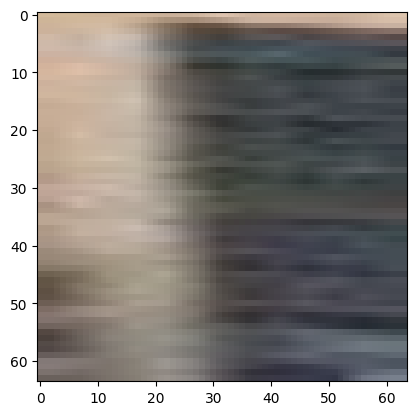

Истинный класс: Human leg, Предсказанный класс: Window


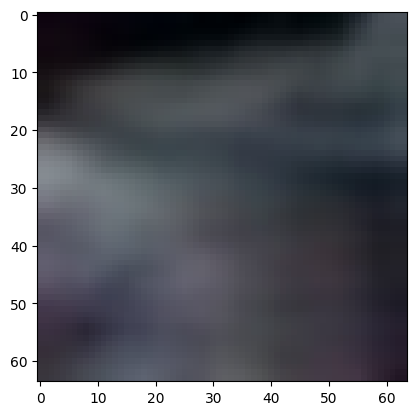

Истинный класс: Human face, Предсказанный класс: Window


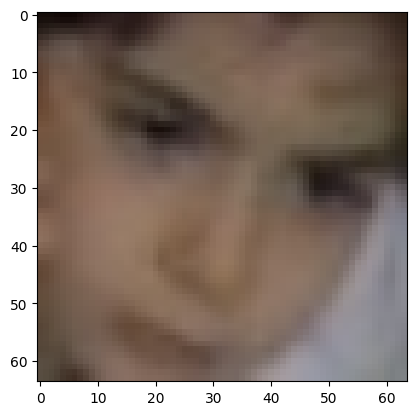

labels ---> tensor([105,  83,  29,  89])
predicted ---> tensor([164,  61,  61, 164])
total ---> 36
correct ---> 6
Истинный класс: Office supplies, Предсказанный класс: Window


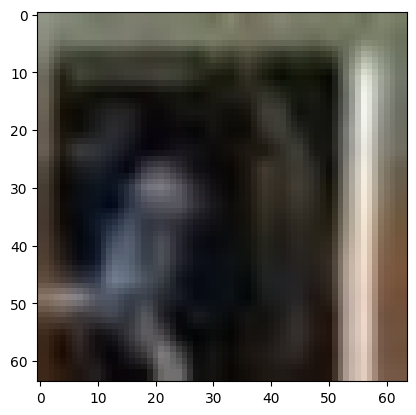

Истинный класс: Jeans, Предсказанный класс: Footwear


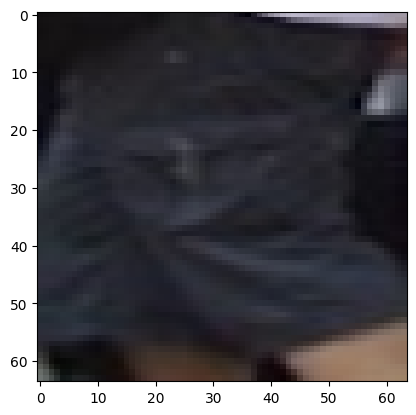

Истинный класс: Car, Предсказанный класс: Footwear


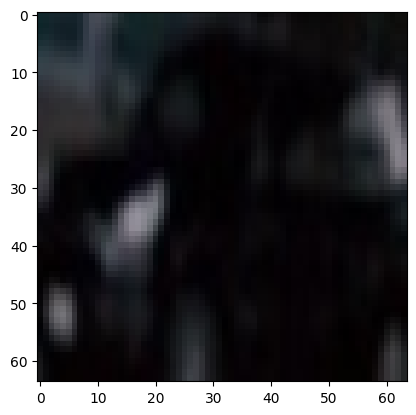

Истинный класс: Land vehicle, Предсказанный класс: Window


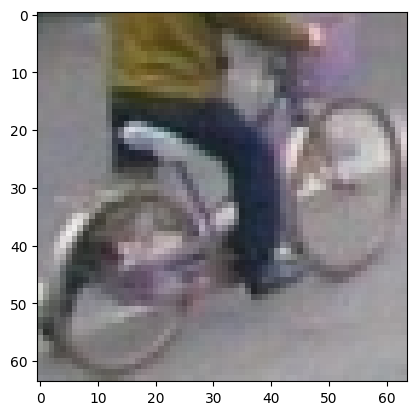

labels ---> tensor([ 47,  69, 164, 164])
predicted ---> tensor([164, 108, 164, 150])
total ---> 40
correct ---> 7
Истинный класс: Door, Предсказанный класс: Window


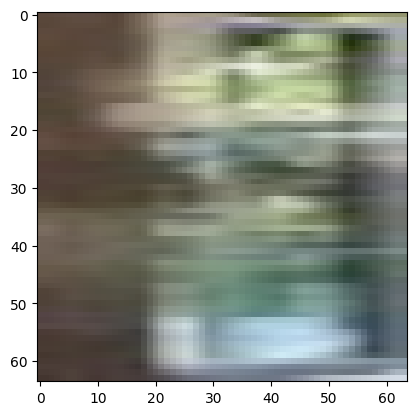

Истинный класс: House, Предсказанный класс: Person


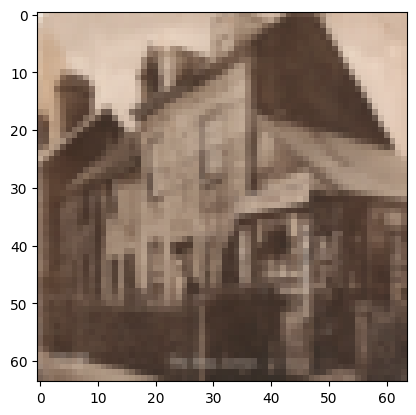

Истинный класс: Window, Предсказанный класс: Window


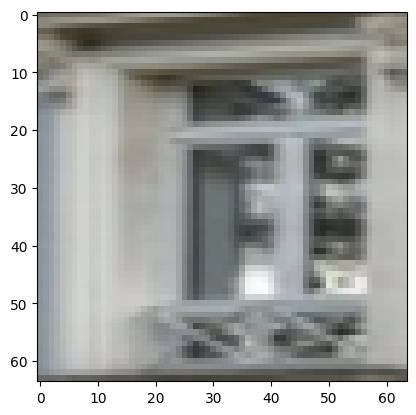

Истинный класс: Window, Предсказанный класс: Tree


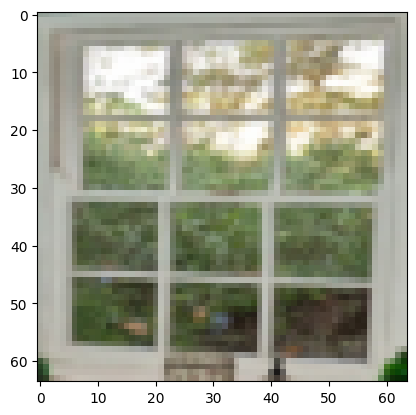

labels ---> tensor([29, 69, 83, 92])
predicted ---> tensor([108,  25, 164,  92])
total ---> 44
correct ---> 8
Истинный класс: Car, Предсказанный класс: Person


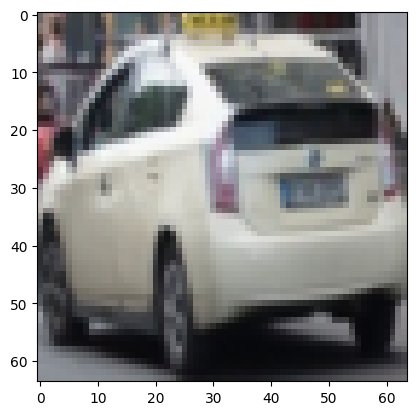

Истинный класс: House, Предсказанный класс: Building


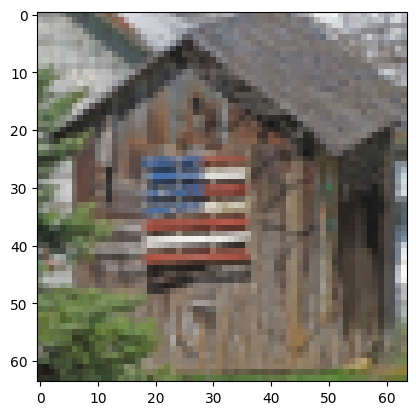

Истинный класс: Jeans, Предсказанный класс: Window


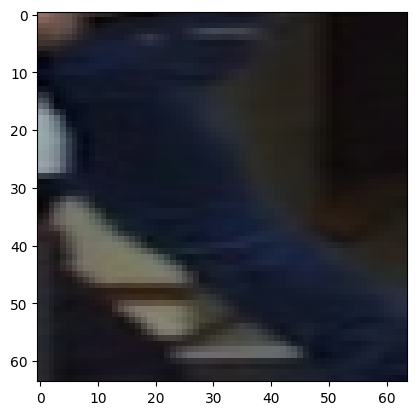

Истинный класс: Light bulb, Предсказанный класс: Light bulb


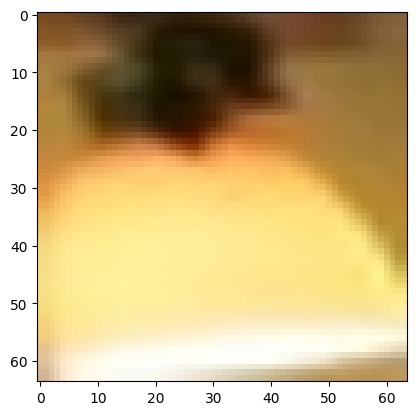

labels ---> tensor([ 47, 164,  96,  75])
predicted ---> tensor([ 29, 164, 108, 108])
total ---> 48
correct ---> 9
Истинный класс: Door, Предсказанный класс: Car


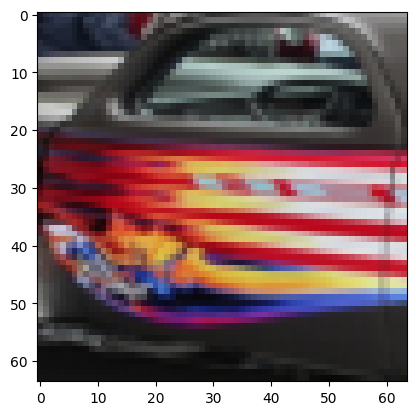

Истинный класс: Window, Предсказанный класс: Window


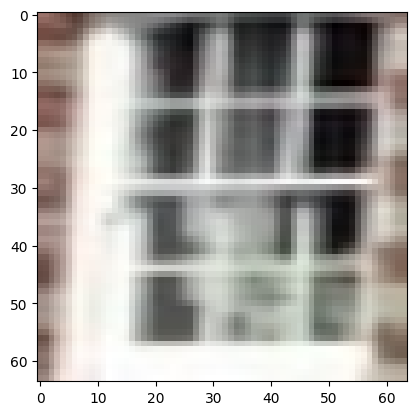

Истинный класс: Man, Предсказанный класс: Person


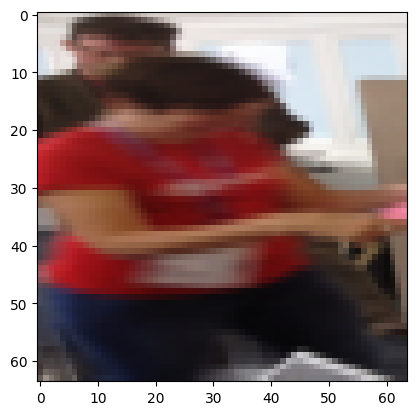

Истинный класс: Human face, Предсказанный класс: Person


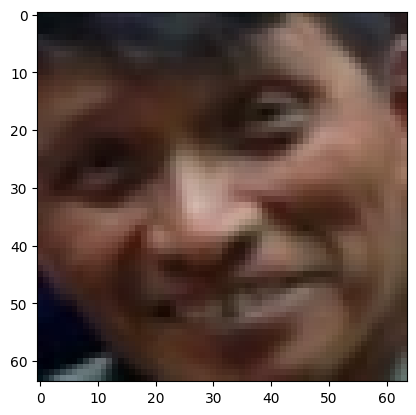

labels ---> tensor([ 69,  17, 150,  91])
predicted ---> tensor([108,  61, 150, 108])
total ---> 52
correct ---> 10
Истинный класс: House, Предсказанный класс: Person


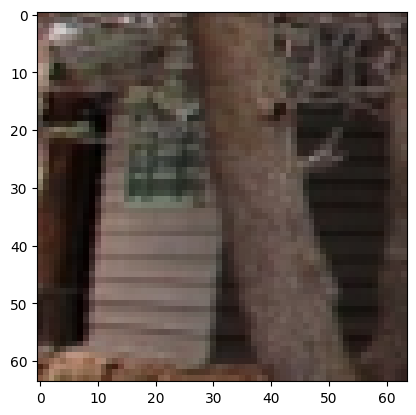

Истинный класс: Book, Предсказанный класс: Footwear


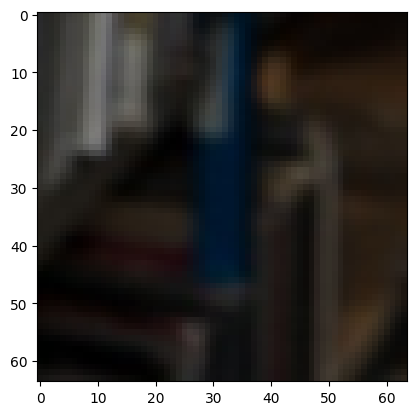

Истинный класс: Tree, Предсказанный класс: Tree


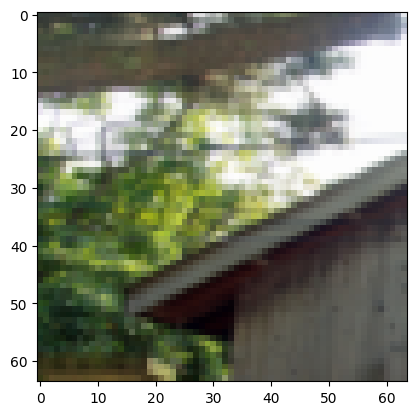

Истинный класс: Laptop, Предсказанный класс: Person


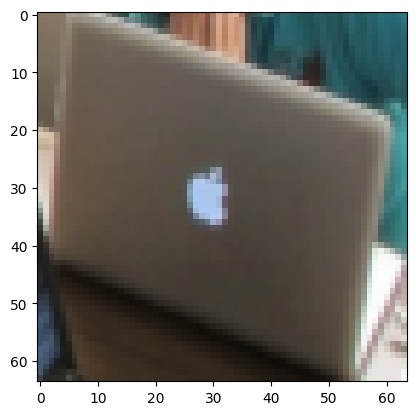

labels ---> tensor([108,  69,  63,  68])
predicted ---> tensor([108,  69,  25, 164])
total ---> 56
correct ---> 12
Истинный класс: Person, Предсказанный класс: Person


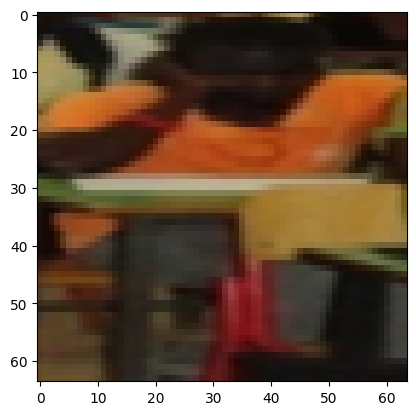

Истинный класс: House, Предсказанный класс: House


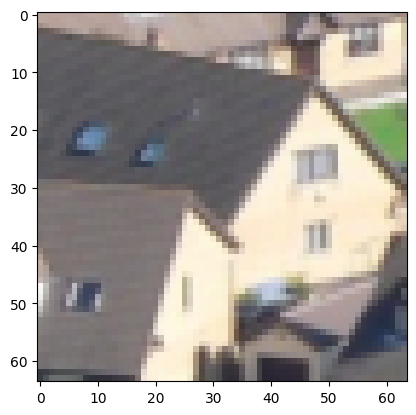

Истинный класс: Furniture, Предсказанный класс: Building


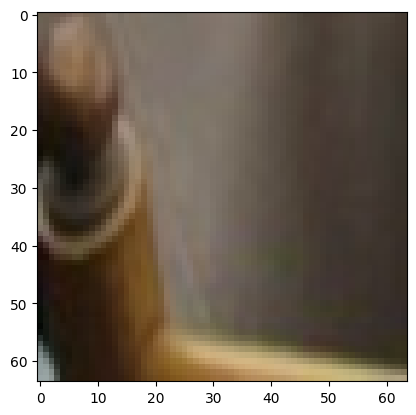

Истинный класс: Home appliance, Предсказанный класс: Window


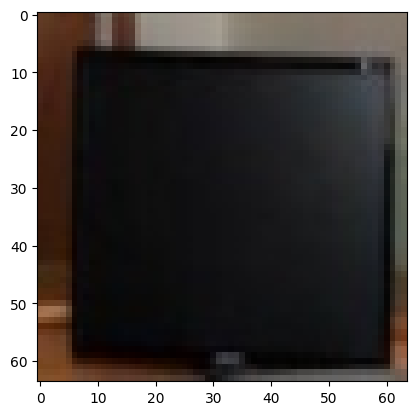

labels ---> tensor([164,  25, 164,  25])
predicted ---> tensor([ 69,  25, 164,  69])
total ---> 60
correct ---> 14
Истинный класс: Window, Предсказанный класс: House


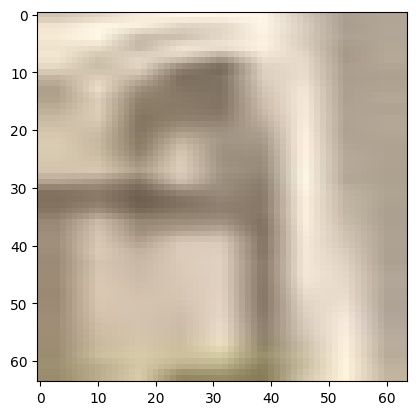

Истинный класс: Building, Предсказанный класс: Building


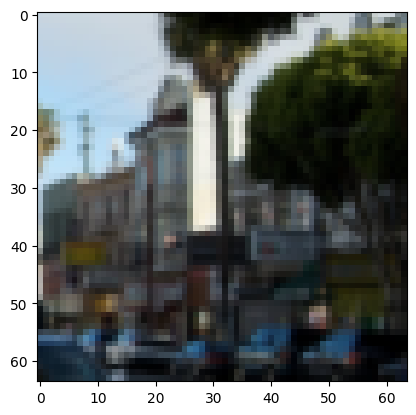

Истинный класс: Window, Предсказанный класс: Window


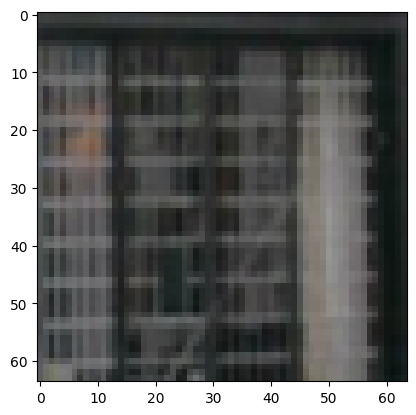

Истинный класс: Building, Предсказанный класс: House


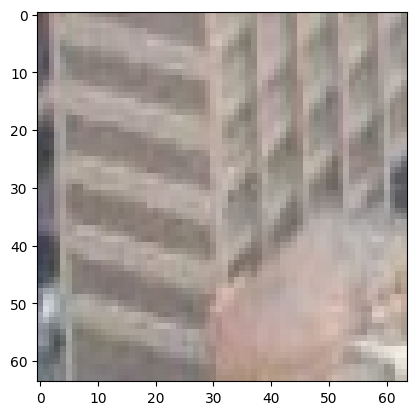

labels ---> tensor([ 25, 164, 148,  85])
predicted ---> tensor([ 25,  25, 164, 164])
total ---> 64
correct ---> 15
Истинный класс: Building, Предсказанный класс: Building


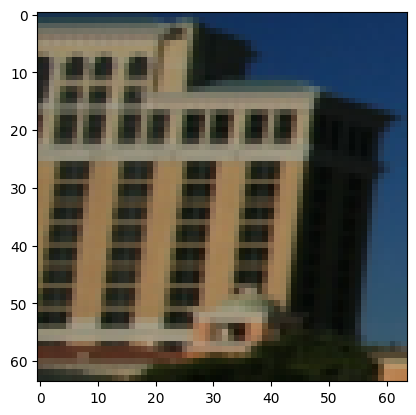

Истинный класс: Window, Предсказанный класс: Building


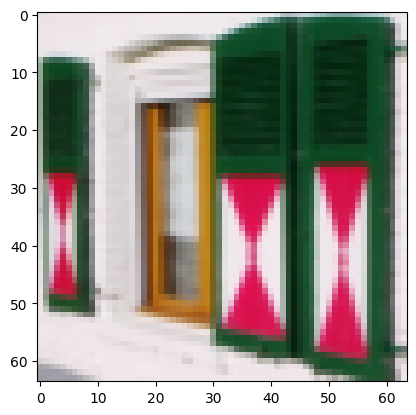

Истинный класс: Traffic light, Предсказанный класс: Window


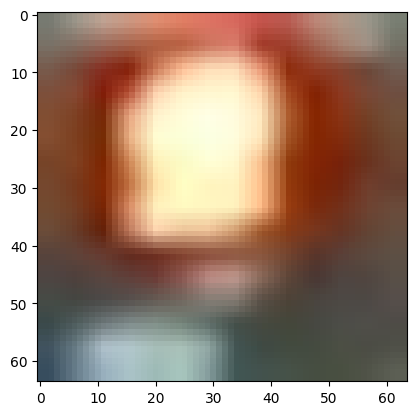

Истинный класс: Kitchen & dining room table, Предсказанный класс: Window


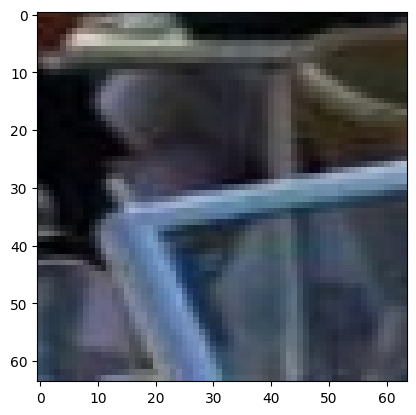

labels ---> tensor([ 25, 114,  70, 108])
predicted ---> tensor([108, 150, 150,  25])
total ---> 68
correct ---> 15
Истинный класс: Building, Предсказанный класс: Person


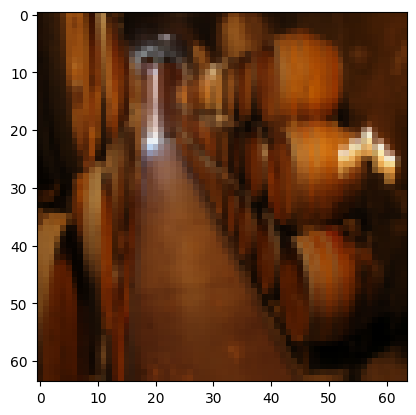

Истинный класс: Poster, Предсказанный класс: Tree


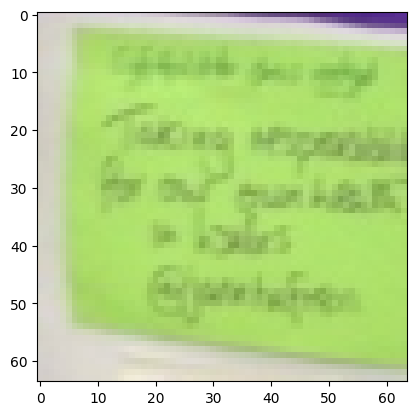

Истинный класс: Houseplant, Предсказанный класс: Tree


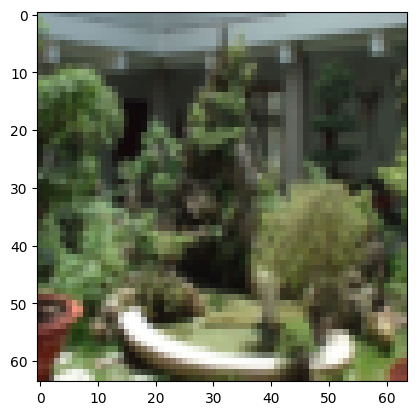

Истинный класс: Person, Предсказанный класс: Building


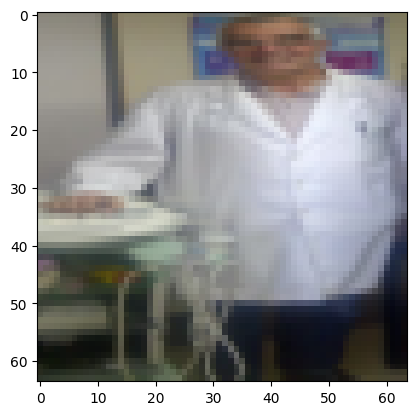

labels ---> tensor([ 29, 108,  77, 164])
predicted ---> tensor([164,  61,  75, 164])
total ---> 72
correct ---> 16
Истинный класс: Car, Предсказанный класс: Window


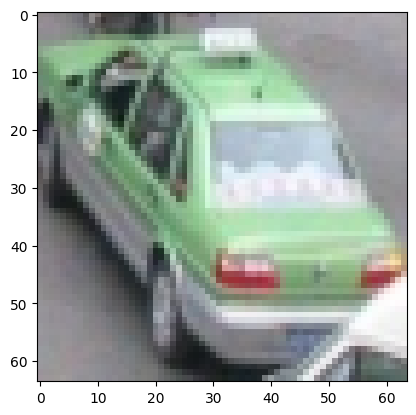

Истинный класс: Person, Предсказанный класс: Footwear


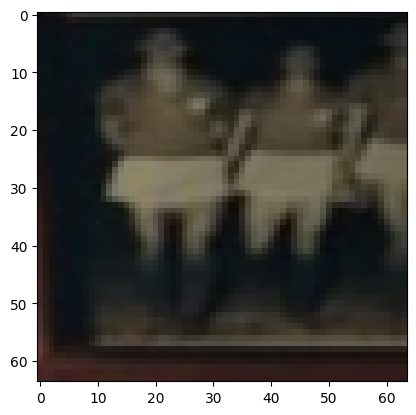

Истинный класс: Human hand, Предсказанный класс: Human face


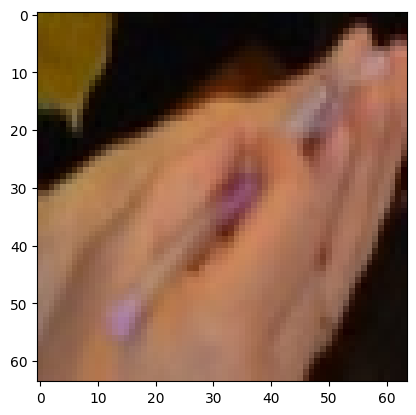

Истинный класс: Window, Предсказанный класс: Window


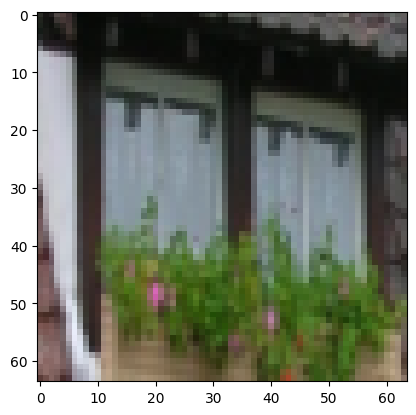

labels ---> tensor([ 44, 164,  95,  25])
predicted ---> tensor([164, 164,  25,  25])
total ---> 76
correct ---> 18
Истинный класс: Curtain, Предсказанный класс: Window


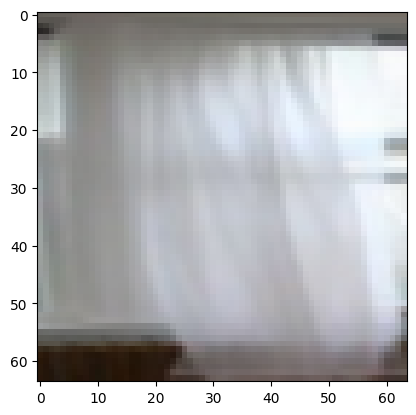

Истинный класс: Window, Предсказанный класс: Window


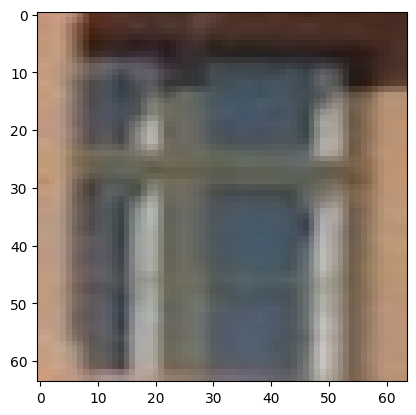

Истинный класс: Mammal, Предсказанный класс: Building


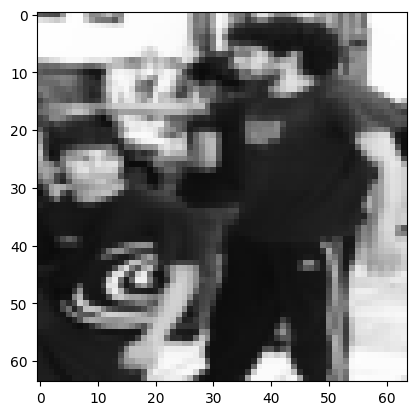

Истинный класс: Building, Предсказанный класс: Building


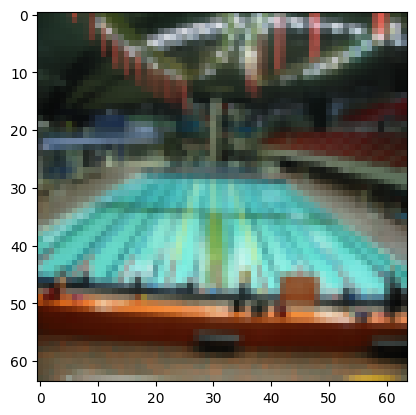

labels ---> tensor([107, 164,  23, 164])
predicted ---> tensor([150, 164, 108, 164])
total ---> 80
correct ---> 20
Истинный класс: Palm tree, Предсказанный класс: Tree


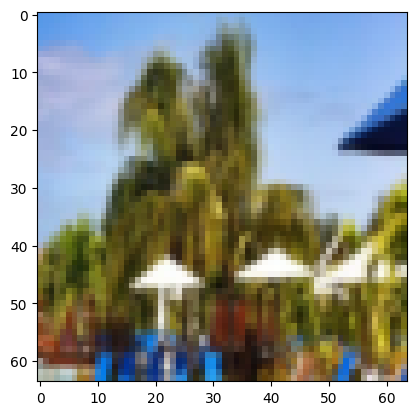

Истинный класс: Window, Предсказанный класс: Window


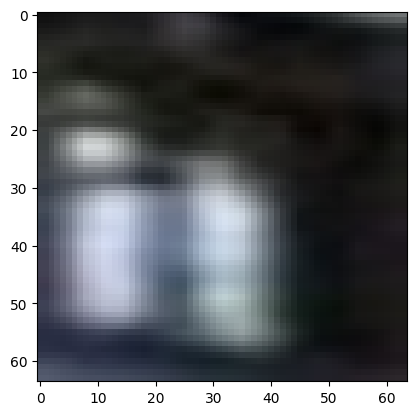

Истинный класс: Boy, Предсказанный класс: Person


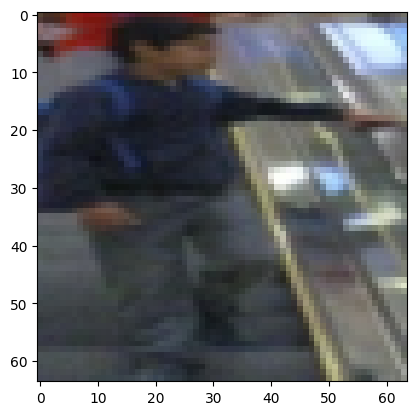

Истинный класс: Window, Предсказанный класс: Window


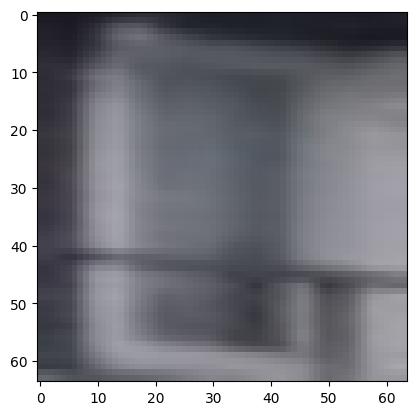

labels ---> tensor([164, 164, 164,  96])
predicted ---> tensor([164,  69,  69, 108])
total ---> 84
correct ---> 21
Истинный класс: Window, Предсказанный класс: Window


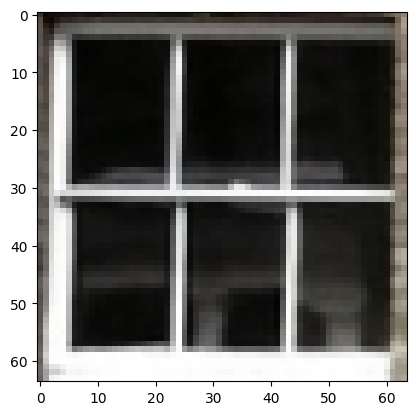

Истинный класс: Window, Предсказанный класс: House


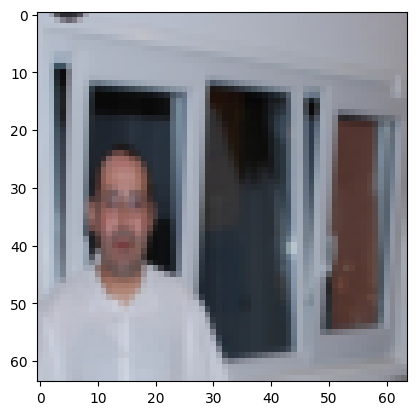

Истинный класс: Window, Предсказанный класс: House


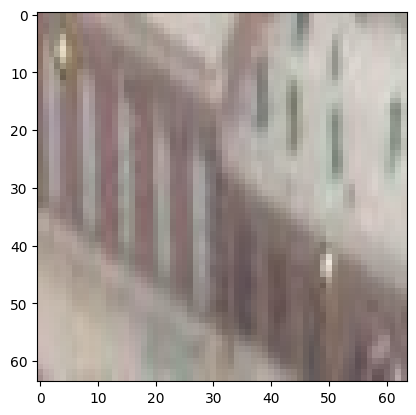

Истинный класс: Man, Предсказанный класс: Person


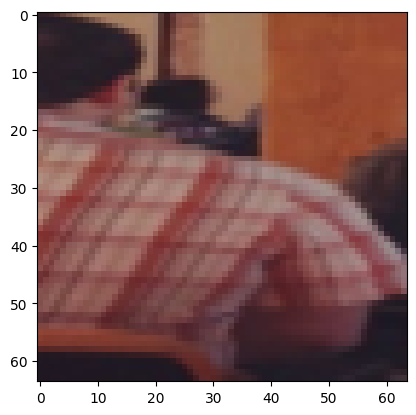

labels ---> tensor([164,  29, 136, 108])
predicted ---> tensor([164,  61,  69, 164])
total ---> 88
correct ---> 22
Истинный класс: Window, Предсказанный класс: Window


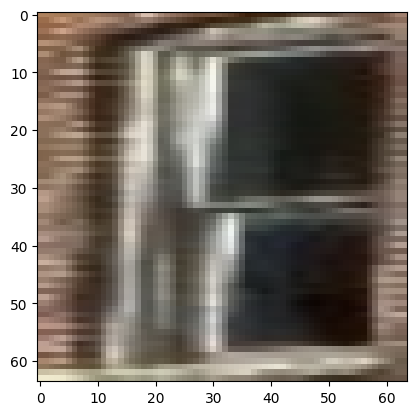

Истинный класс: Car, Предсказанный класс: Footwear


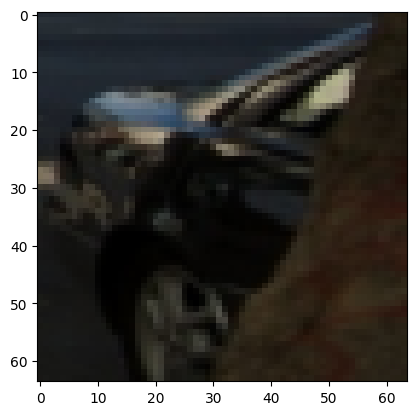

Истинный класс: Table, Предсказанный класс: House


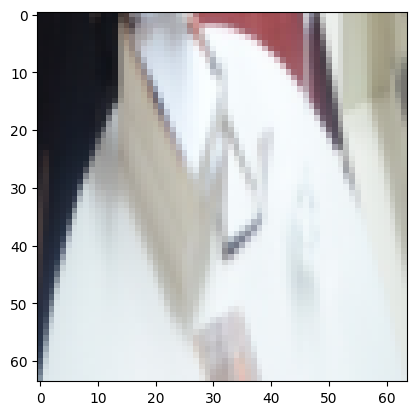

Истинный класс: Person, Предсказанный класс: Window


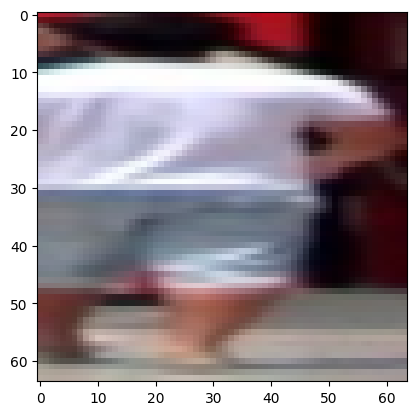

labels ---> tensor([ 13, 168, 164,  65])
predicted ---> tensor([108,  61, 164,  69])
total ---> 92
correct ---> 23
Истинный класс: Bicycle wheel, Предсказанный класс: Person


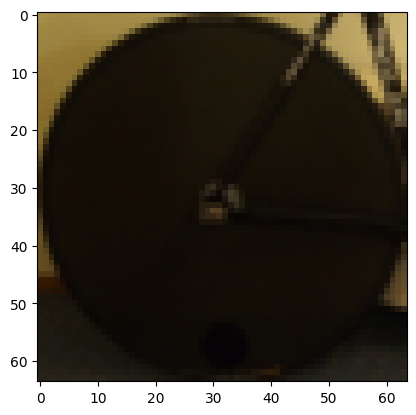

Истинный класс: Woman, Предсказанный класс: Footwear


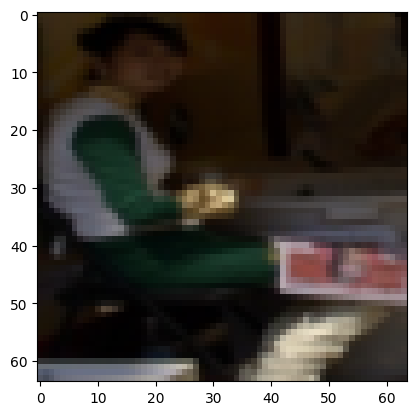

Истинный класс: Window, Предсказанный класс: Window


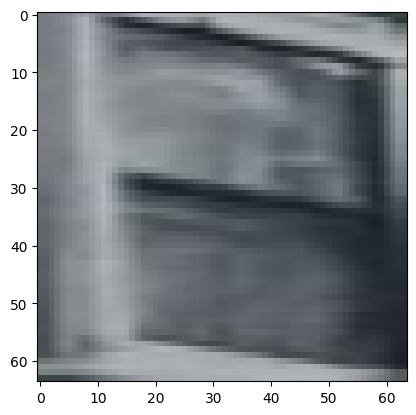

Истинный класс: Girl, Предсказанный класс: House


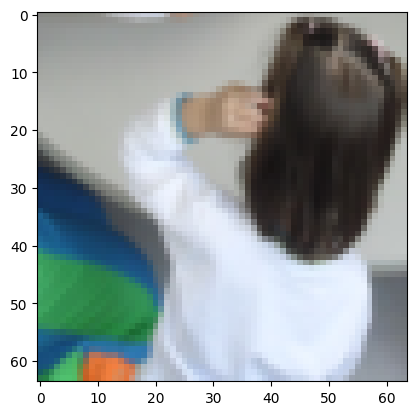

labels ---> tensor([112,  61,  17,  69])
predicted ---> tensor([150, 164,  25,  69])
total ---> 96
correct ---> 24
Истинный класс: Plant, Предсказанный класс: Tree


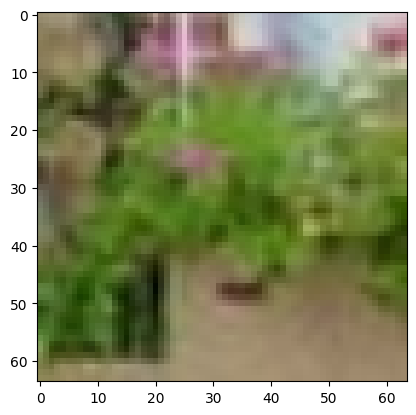

Истинный класс: Footwear, Предсказанный класс: Window


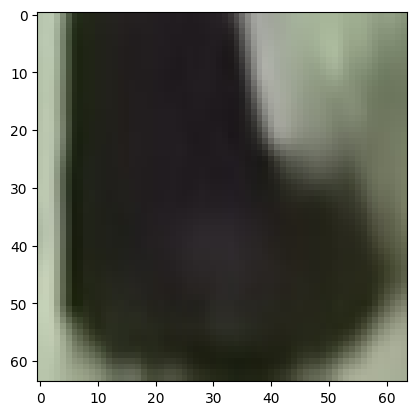

Истинный класс: Book, Предсказанный класс: Building


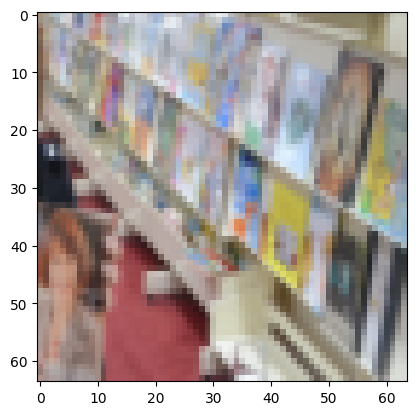

Истинный класс: House, Предсказанный класс: House


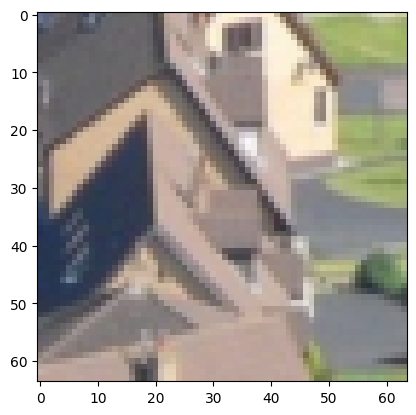

labels ---> tensor([112, 164,  69,  38])
predicted ---> tensor([150, 164, 164,  61])
total ---> 100
correct ---> 25
Истинный класс: Plant, Предсказанный класс: Tree


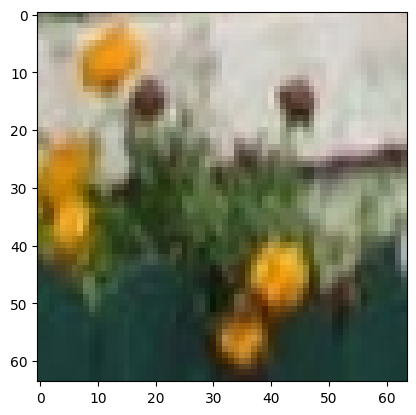

Истинный класс: Window, Предсказанный класс: Window


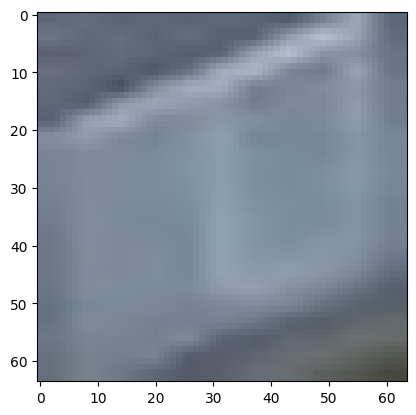

Истинный класс: House, Предсказанный класс: Window


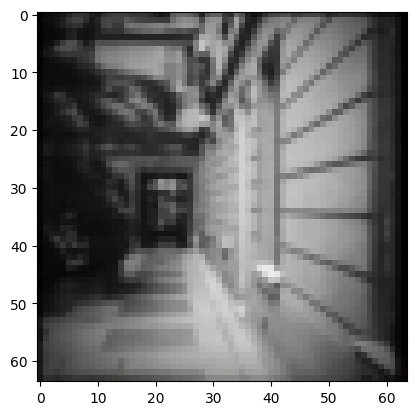

Истинный класс: Computer keyboard, Предсказанный класс: Footwear


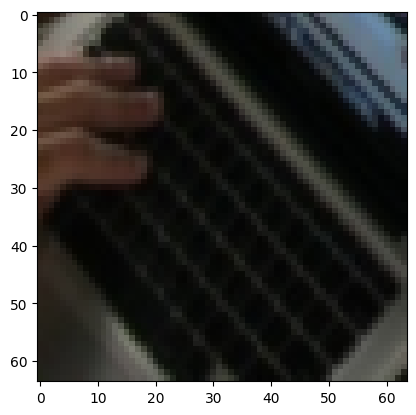

labels ---> tensor([29, 71, 49, 78])
predicted ---> tensor([108,  25, 164,  76])
total ---> 104
correct ---> 25
Истинный класс: Car, Предсказанный класс: Person


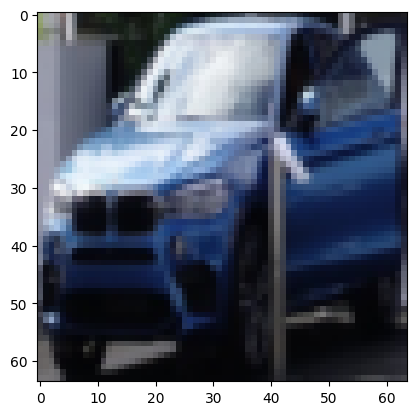

Истинный класс: Human arm, Предсказанный класс: Building


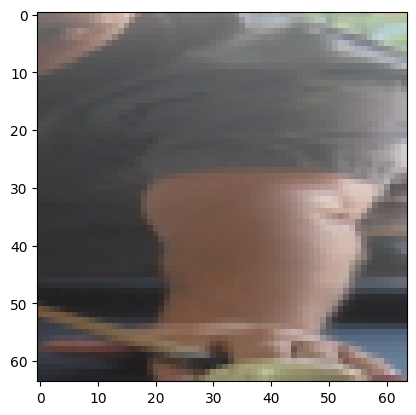

Истинный класс: Drawer, Предсказанный класс: Window


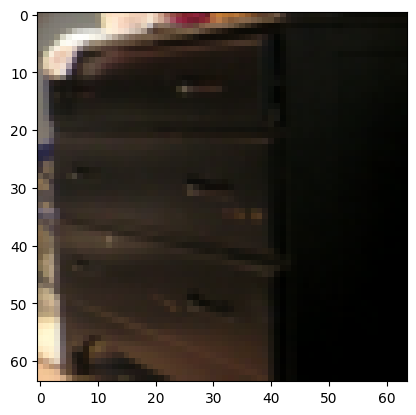

Истинный класс: Human head, Предсказанный класс: Human hair


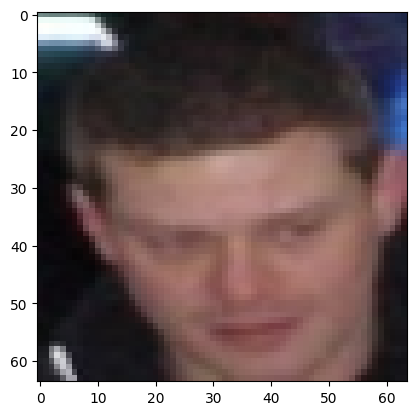

labels ---> tensor([164,  63,  38, 108])
predicted ---> tensor([164,  61,  61,  69])
total ---> 108
correct ---> 26
Истинный класс: Window, Предсказанный класс: Window


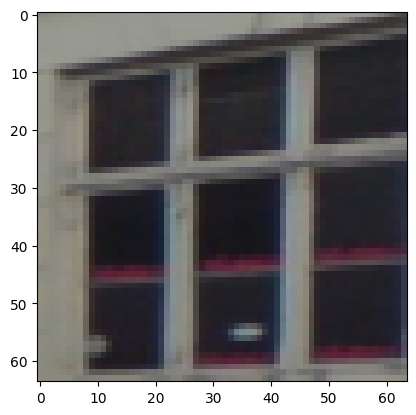

Истинный класс: Furniture, Предсказанный класс: Footwear


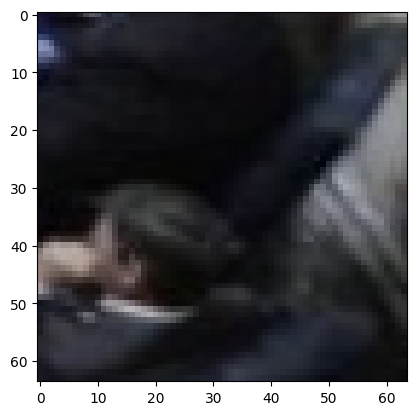

Истинный класс: Computer keyboard, Предсказанный класс: Footwear


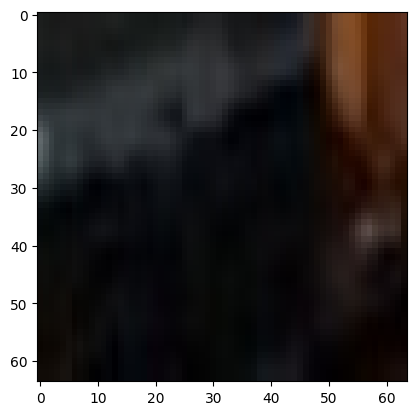

Истинный класс: Person, Предсказанный класс: House


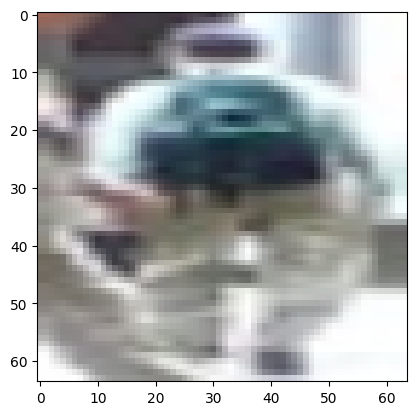

labels ---> tensor([ 59, 108,  69, 108])
predicted ---> tensor([ 25, 108, 108, 164])
total ---> 112
correct ---> 27
Истинный класс: Flowerpot, Предсказанный класс: Building


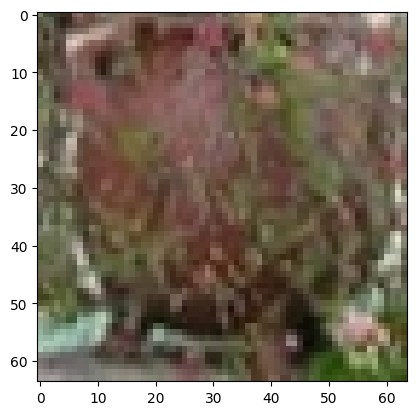

Истинный класс: Person, Предсказанный класс: Person


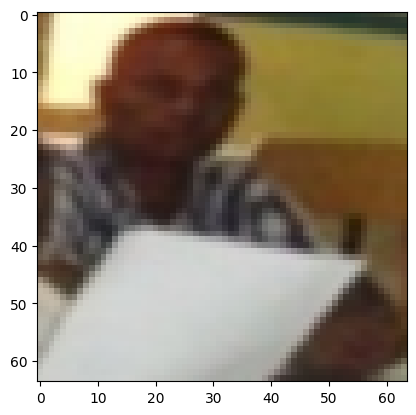

Истинный класс: House, Предсказанный класс: Person


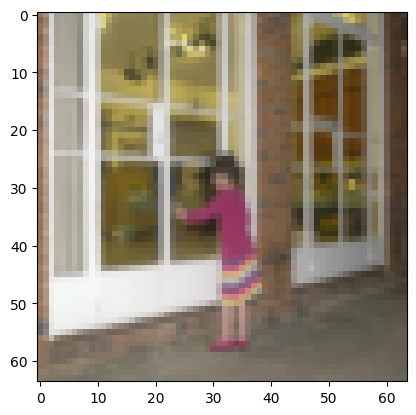

Истинный класс: Person, Предсказанный класс: Window


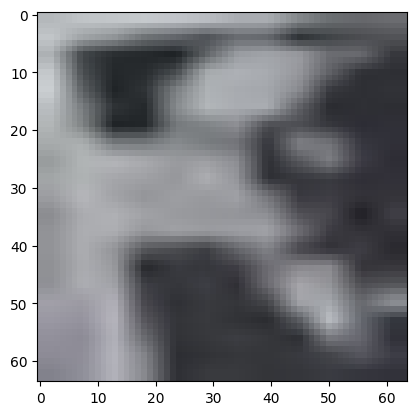

labels ---> tensor([112, 150,  19,  65])
predicted ---> tensor([150,  61, 164, 108])
total ---> 116
correct ---> 27
Истинный класс: Plant, Предсказанный класс: Tree


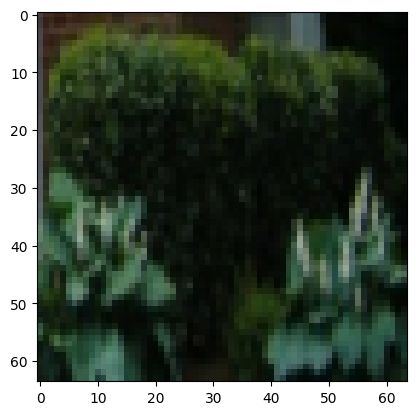

Истинный класс: Tree, Предсказанный класс: Footwear


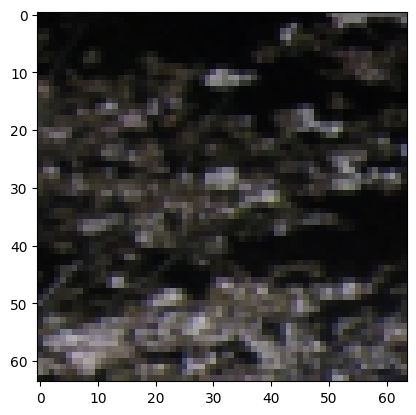

Истинный класс: Bottle, Предсказанный класс: Window


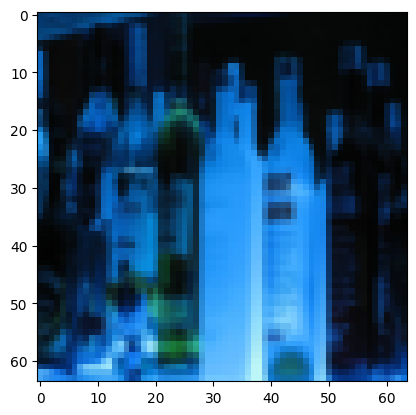

Истинный класс: Girl, Предсказанный класс: Person


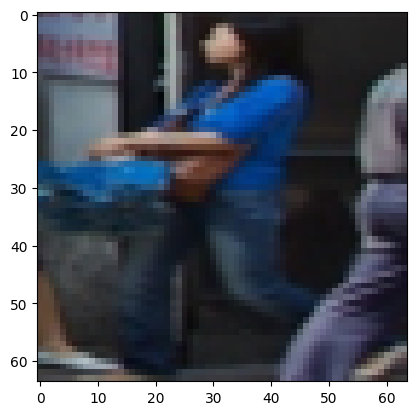

labels ---> tensor([128, 164,  77,  72])
predicted ---> tensor([108, 108,  77,  25])
total ---> 120
correct ---> 28
Истинный класс: Sports equipment, Предсказанный класс: Person


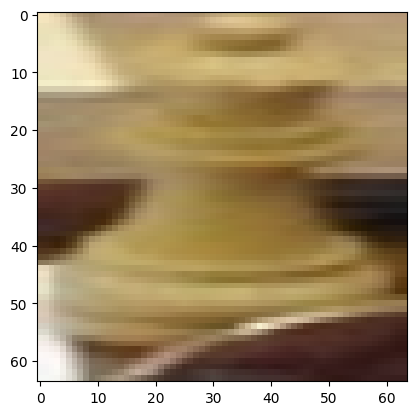

Истинный класс: Window, Предсказанный класс: Person


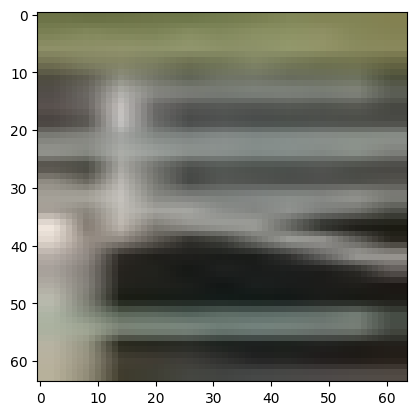

Истинный класс: Human hand, Предсказанный класс: Human hand


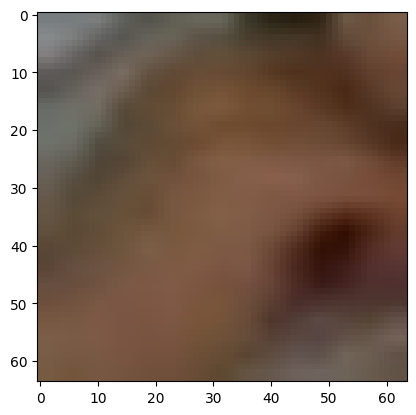

Истинный класс: Human body, Предсказанный класс: Building


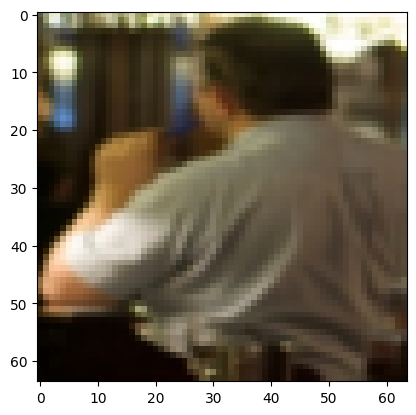

labels ---> tensor([ 56,  75,  25, 164])
predicted ---> tensor([108,  76,  25, 164])
total ---> 124
correct ---> 30
Истинный класс: Fireplace, Предсказанный класс: Person


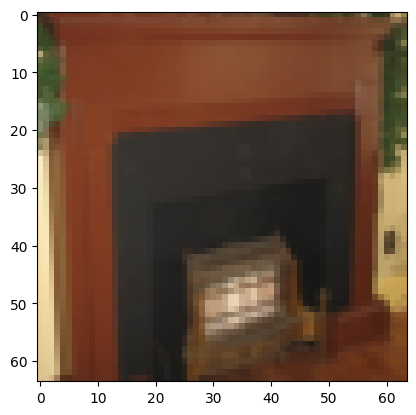

Истинный класс: Human face, Предсказанный класс: Human hair


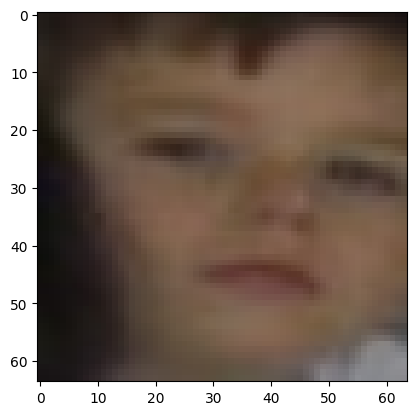

Истинный класс: Building, Предсказанный класс: Building


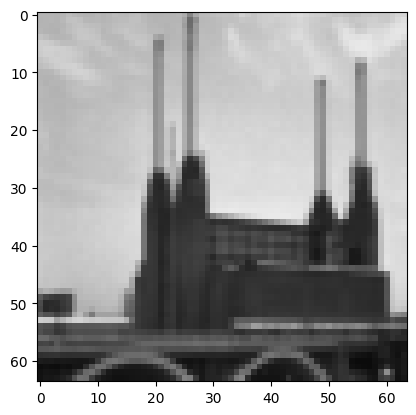

Истинный класс: Window, Предсказанный класс: Window


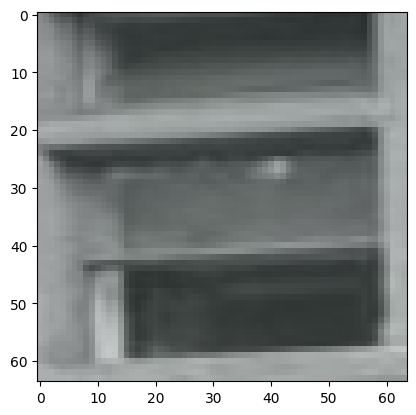

labels ---> tensor([ 36, 140,  71,  74])
predicted ---> tensor([164, 164, 108,  74])
total ---> 128
correct ---> 31
Истинный класс: Clothing, Предсказанный класс: Window


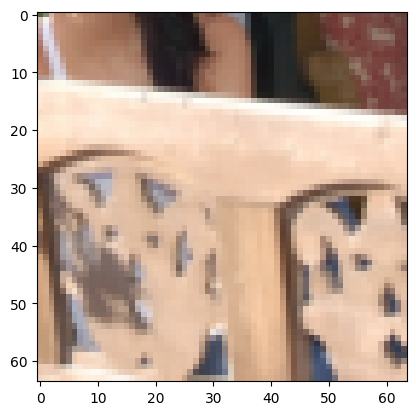

Истинный класс: Taxi, Предсказанный класс: Window


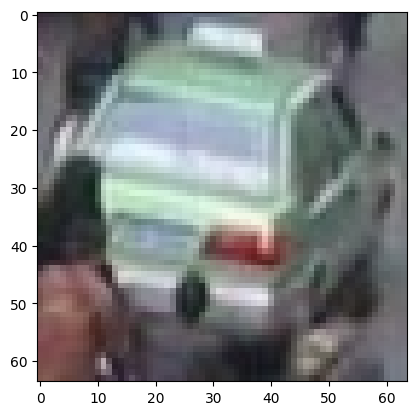

Истинный класс: Human arm, Предсказанный класс: Person


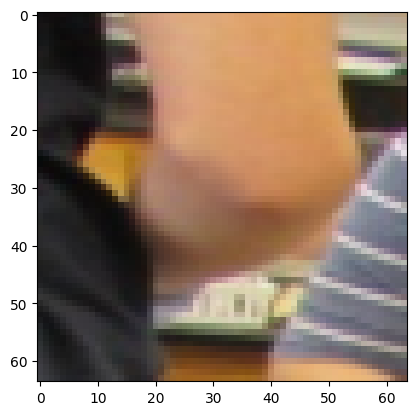

Истинный класс: Human eye, Предсказанный класс: Human eye


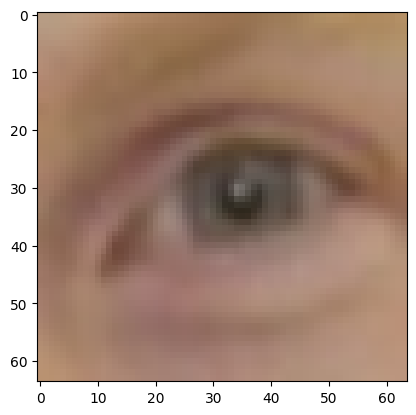

labels ---> tensor([108, 164, 162, 164])
predicted ---> tensor([108, 164,  61, 164])
total ---> 132
correct ---> 34
Истинный класс: Person, Предсказанный класс: Person


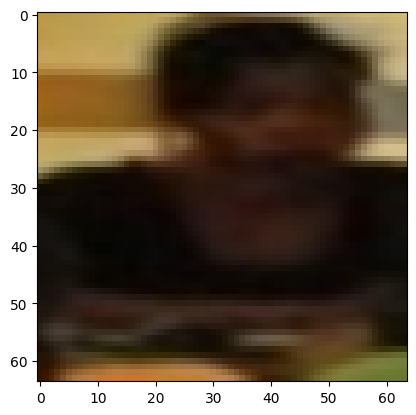

Истинный класс: Window, Предсказанный класс: Window


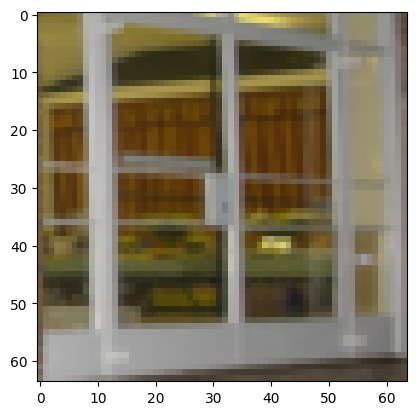

Истинный класс: Wheel, Предсказанный класс: Footwear


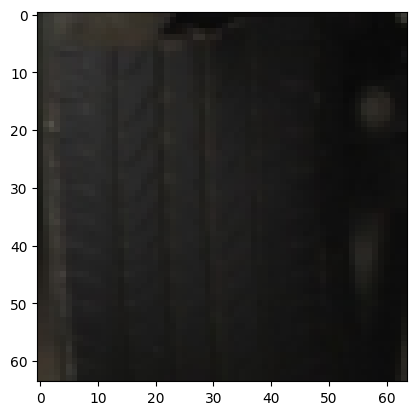

Истинный класс: Window, Предсказанный класс: Window


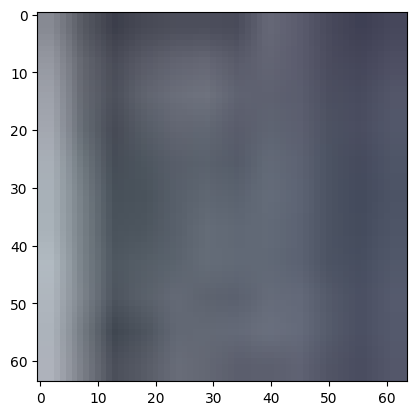

labels ---> tensor([ 76,  71,  75, 136])
predicted ---> tensor([108, 164,  75,  61])
total ---> 136
correct ---> 35
Истинный класс: Human hair, Предсказанный класс: Person


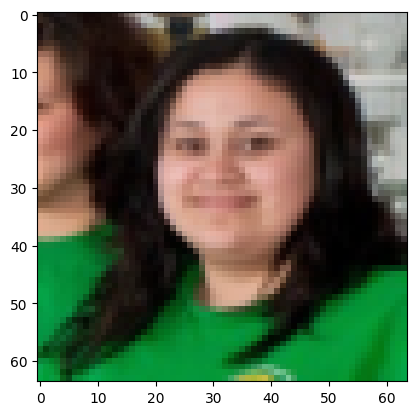

Истинный класс: Human arm, Предсказанный класс: Window


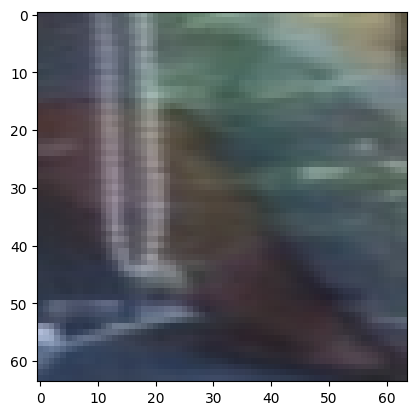

Истинный класс: Human face, Предсказанный класс: Human face


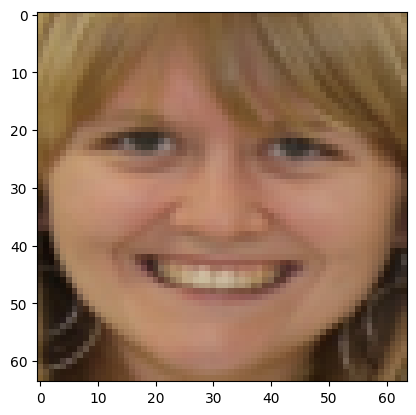

Истинный класс: Table, Предсказанный класс: Footwear


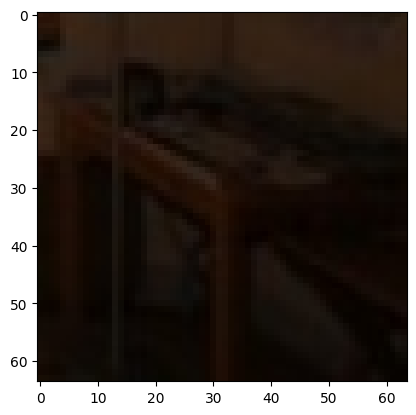

labels ---> tensor([ 69, 112, 162,  25])
predicted ---> tensor([108, 150, 164, 108])
total ---> 140
correct ---> 35
Истинный класс: House, Предсказанный класс: Person


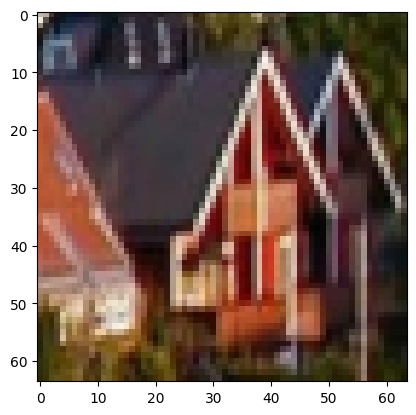

Истинный класс: Plant, Предсказанный класс: Tree


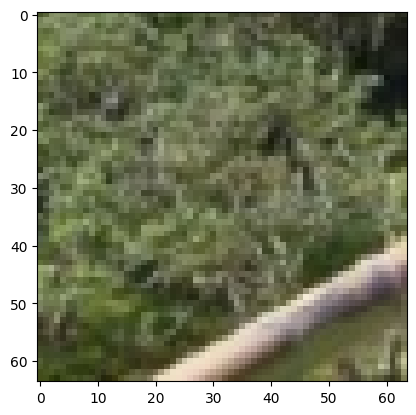

Истинный класс: Wheel, Предсказанный класс: Window


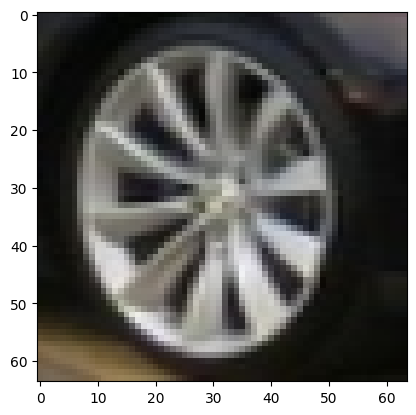

Истинный класс: Building, Предсказанный класс: Person


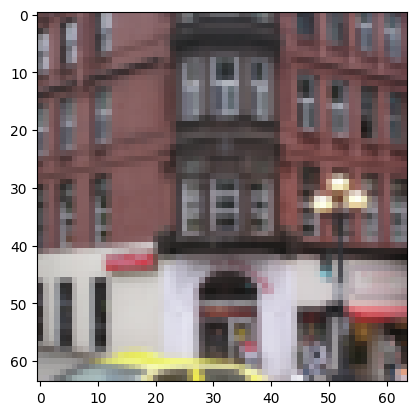

labels ---> tensor([162, 138,  36, 108])
predicted ---> tensor([108,  69, 164,  76])
total ---> 144
correct ---> 35
Истинный класс: Wheel, Предсказанный класс: Person


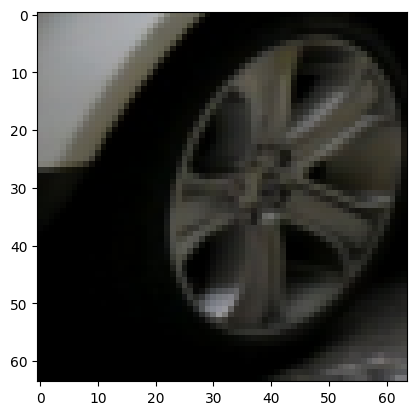

Истинный класс: Tableware, Предсказанный класс: House


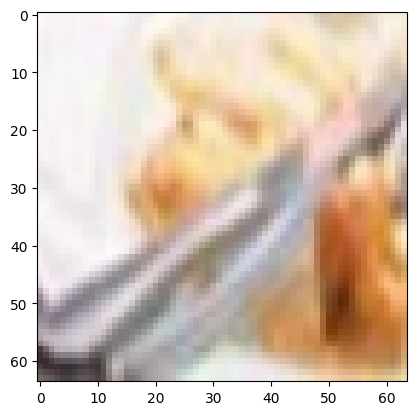

Истинный класс: Clothing, Предсказанный класс: Window


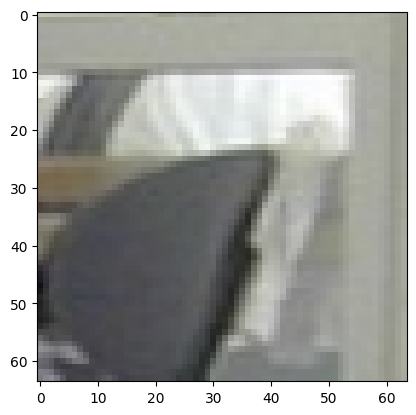

Истинный класс: Person, Предсказанный класс: Human hair


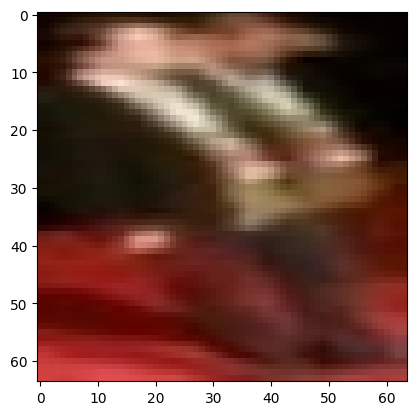

labels ---> tensor([157, 169,  68,  25])
predicted ---> tensor([108, 164,  25,  25])
total ---> 148
correct ---> 36
Истинный класс: Vehicle registration plate, Предсказанный класс: Person


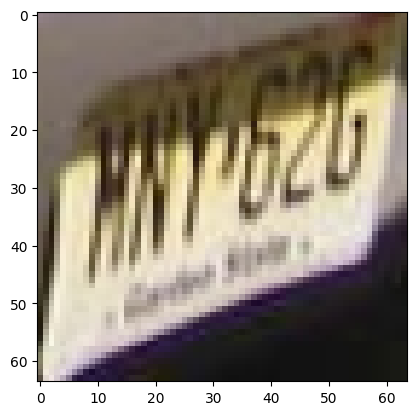

Истинный класс: Wood-burning stove, Предсказанный класс: Window


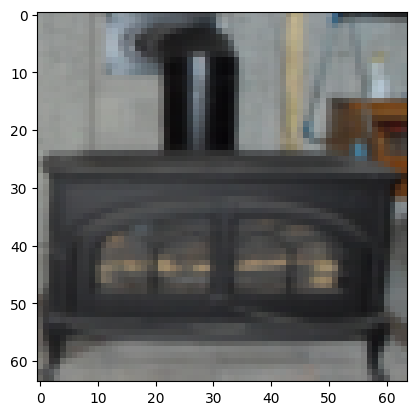

Истинный класс: Home appliance, Предсказанный класс: Building


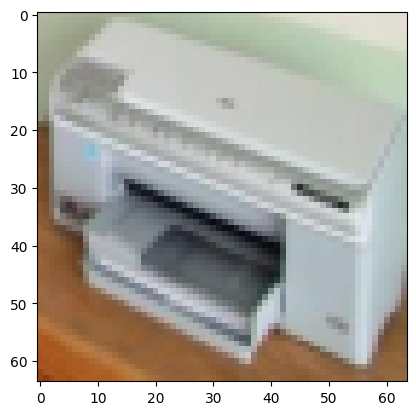

Истинный класс: Building, Предсказанный класс: Building


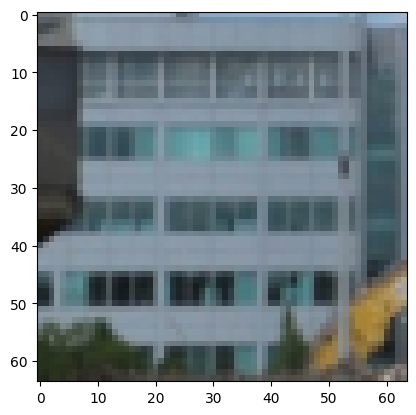

labels ---> tensor([ 36,  29, 164, 114])
predicted ---> tensor([164, 108,  61, 108])
total ---> 152
correct ---> 36
Истинный класс: Clothing, Предсказанный класс: Window


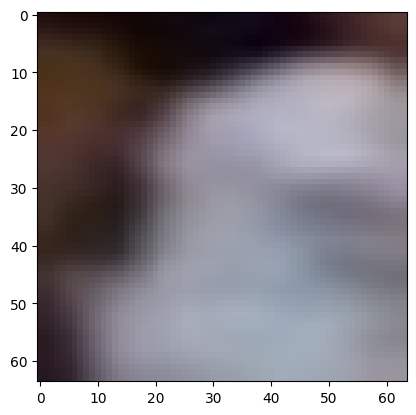

Истинный класс: Car, Предсказанный класс: Person


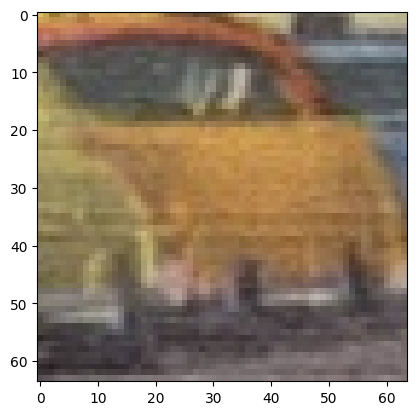

Истинный класс: Window, Предсказанный класс: Footwear


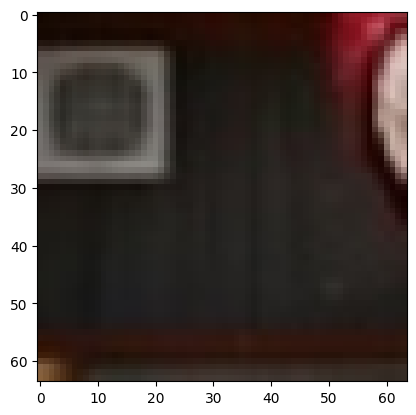

Истинный класс: Poster, Предсказанный класс: Person


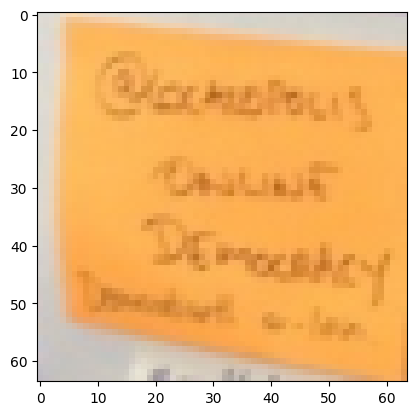

labels ---> tensor([32, 92, 96, 61])
predicted ---> tensor([108,  92,  25,  25])
total ---> 156
correct ---> 37
Истинный класс: Chair, Предсказанный класс: Person


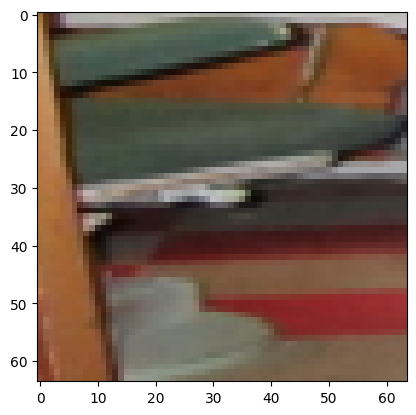

Истинный класс: Light bulb, Предсказанный класс: Light bulb


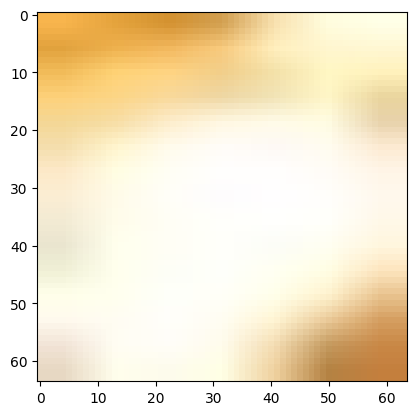

Истинный класс: Man, Предсказанный класс: Building


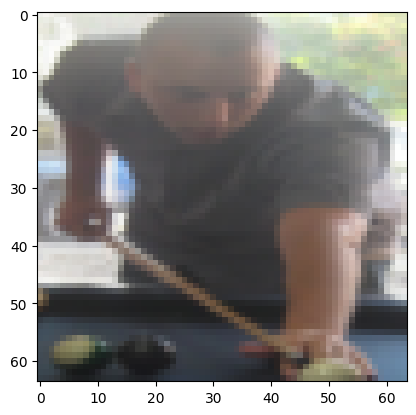

Истинный класс: Footwear, Предсказанный класс: Building


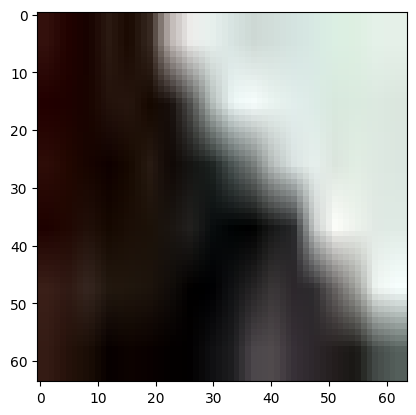

labels ---> tensor([150, 151,  49,  72])
predicted ---> tensor([150,  78, 108, 108])
total ---> 160
correct ---> 38
Истинный класс: Tree, Предсказанный класс: Tree


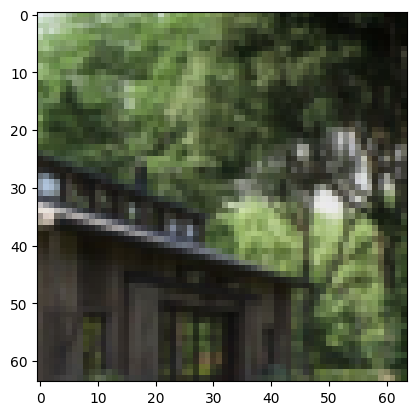

Истинный класс: Trousers, Предсказанный класс: Human head


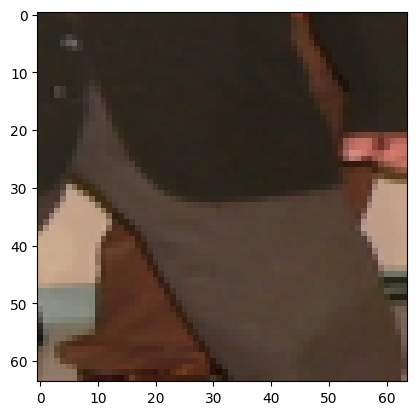

Истинный класс: Drawer, Предсказанный класс: Person


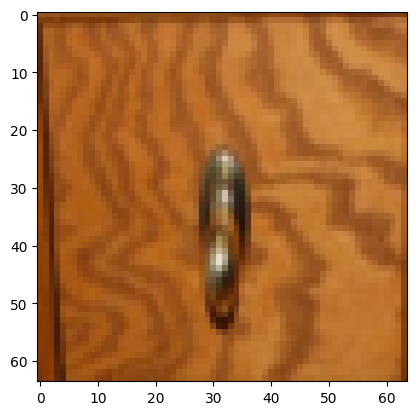

Истинный класс: Human body, Предсказанный класс: Person


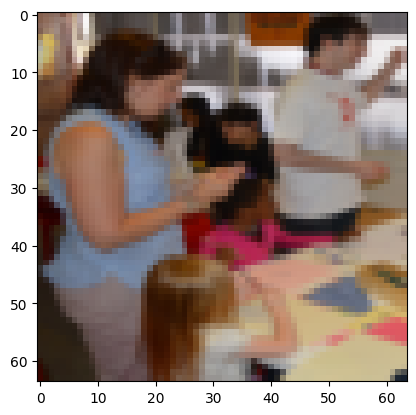

labels ---> tensor([164, 108,  96, 108])
predicted ---> tensor([164,  61, 108, 108])
total ---> 164
correct ---> 40
Истинный класс: Window, Предсказанный класс: Window


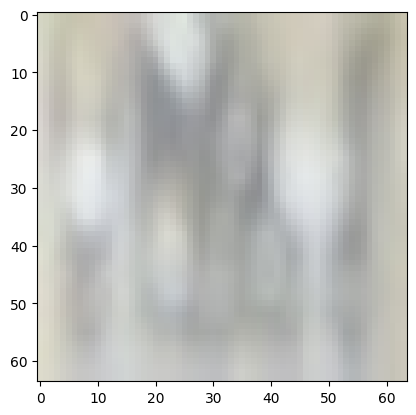

Истинный класс: Person, Предсказанный класс: Footwear


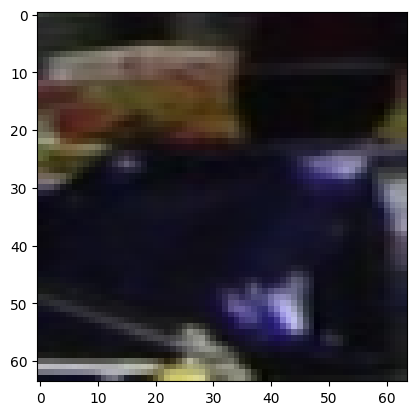

Истинный класс: Man, Предсказанный класс: Person


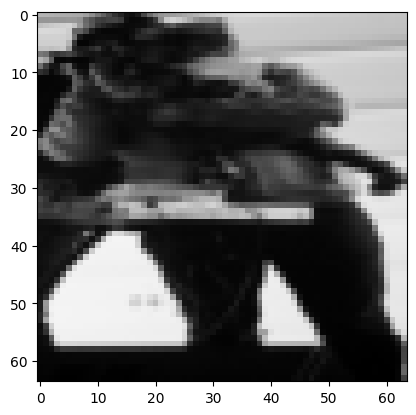

Истинный класс: Person, Предсказанный класс: Person


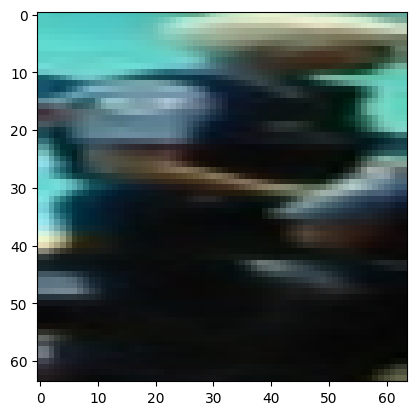

labels ---> tensor([164,  23, 157, 136])
predicted ---> tensor([164,  69, 108, 164])
total ---> 168
correct ---> 41
Истинный класс: Window, Предсказанный класс: Window


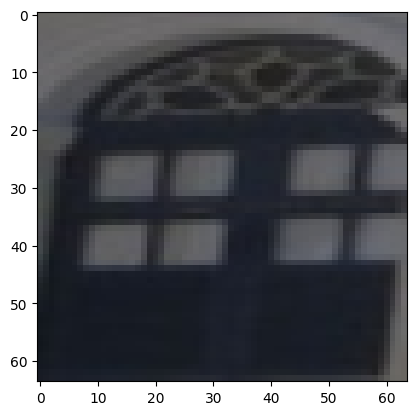

Истинный класс: Boy, Предсказанный класс: House


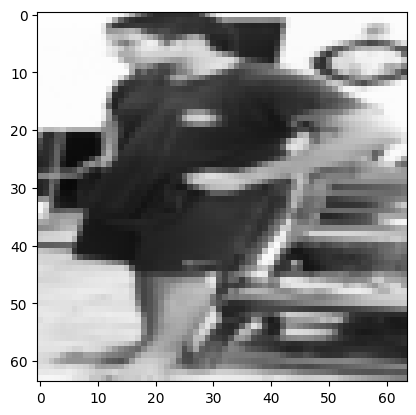

Истинный класс: Vehicle registration plate, Предсказанный класс: Person


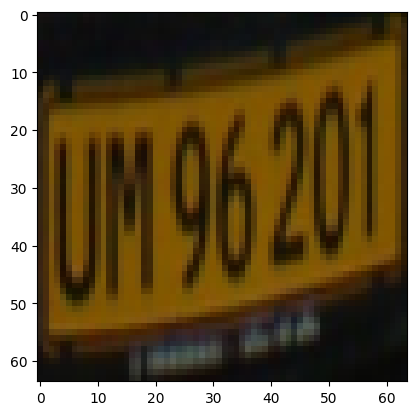

Истинный класс: Table, Предсказанный класс: Window


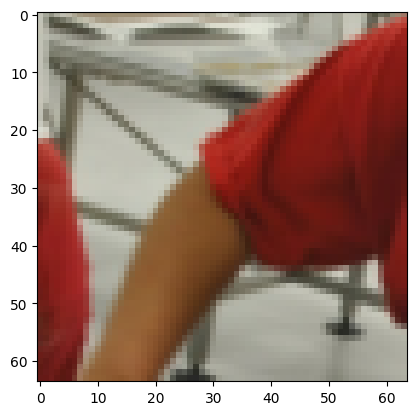

labels ---> tensor([ 92,  96, 164, 157])
predicted ---> tensor([ 92, 164, 164, 164])
total ---> 172
correct ---> 43
Истинный класс: Light bulb, Предсказанный класс: Light bulb


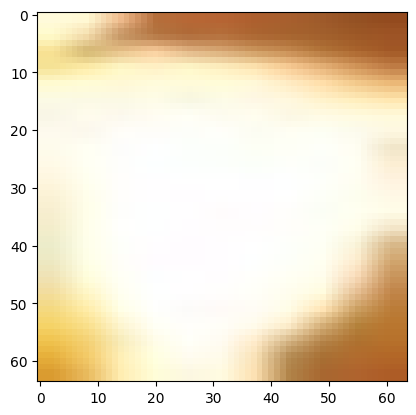

Истинный класс: Man, Предсказанный класс: Window


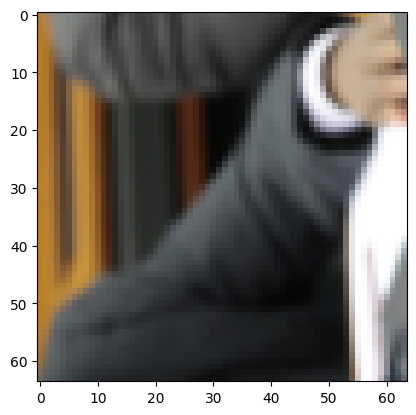

Истинный класс: Window, Предсказанный класс: Window


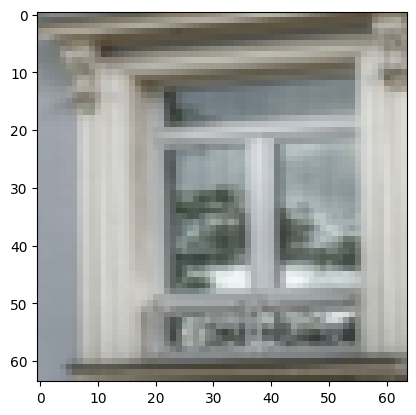

Истинный класс: Vehicle registration plate, Предсказанный класс: Window


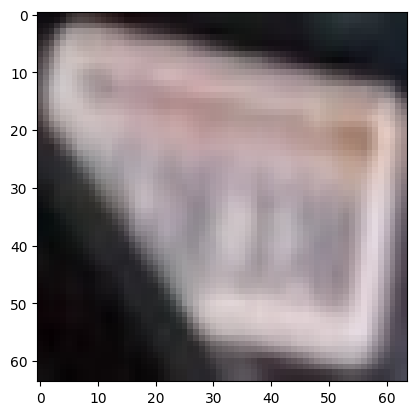

labels ---> tensor([138,  25,  25, 150])
predicted ---> tensor([108,  69, 108, 162])
total ---> 176
correct ---> 43
Истинный класс: Tableware, Предсказанный класс: Person


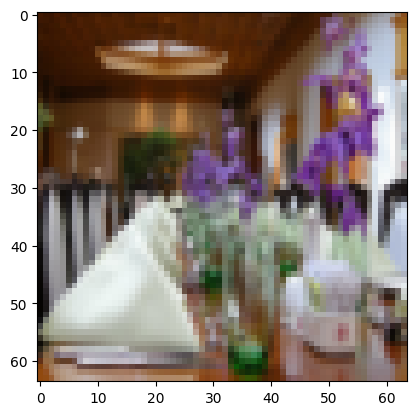

Истинный класс: Building, Предсказанный класс: House


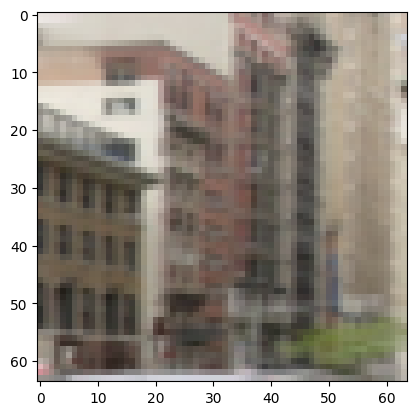

Истинный класс: Building, Предсказанный класс: Person


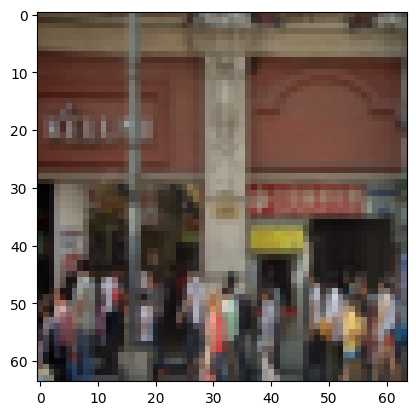

Истинный класс: Tree, Предсказанный класс: Wheel


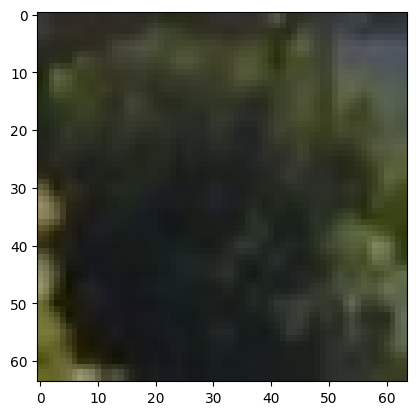

labels ---> tensor([164,  32, 156,  17])
predicted ---> tensor([164, 108,  25,  61])
total ---> 180
correct ---> 44
Истинный класс: Window, Предсказанный класс: Window


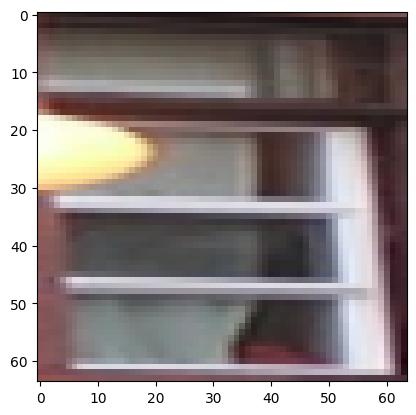

Истинный класс: Chair, Предсказанный класс: Person


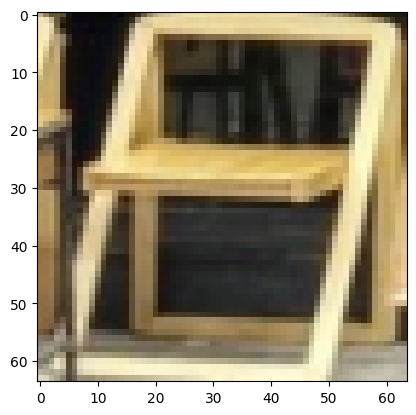

Истинный класс: Vehicle, Предсказанный класс: Building


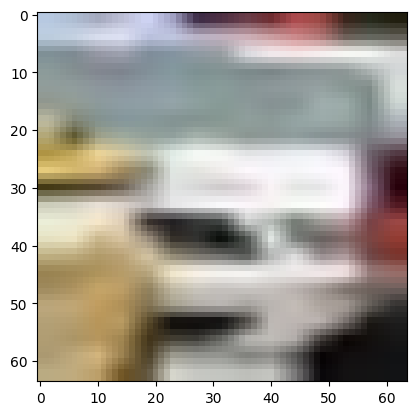

Истинный класс: Book, Предсказанный класс: Footwear


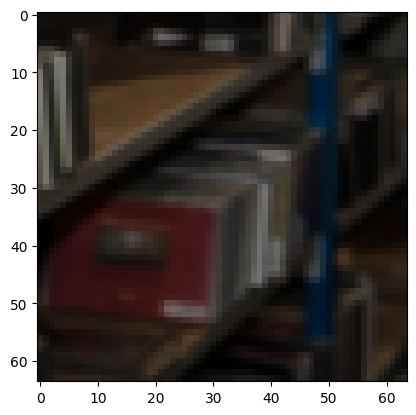

labels ---> tensor([ 71, 164, 164, 112])
predicted ---> tensor([164, 164, 164, 150])
total ---> 184
correct ---> 46
Истинный класс: Human arm, Предсказанный класс: Window


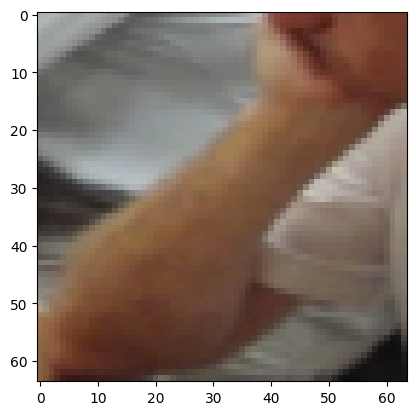

Истинный класс: Window, Предсказанный класс: Window


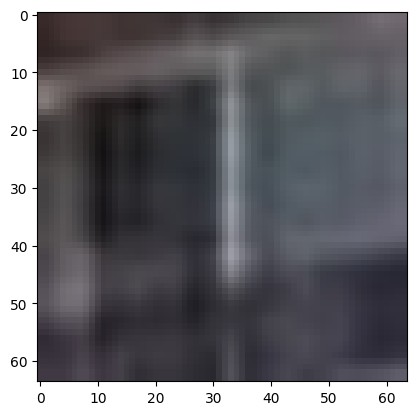

Истинный класс: Window, Предсказанный класс: Window


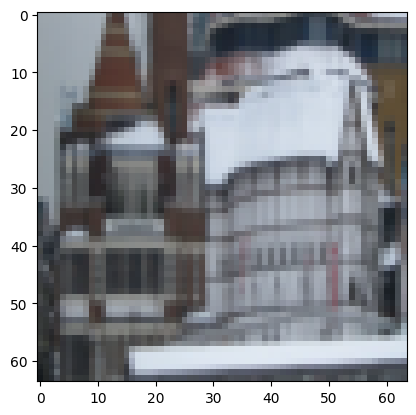

Истинный класс: Plant, Предсказанный класс: Tree


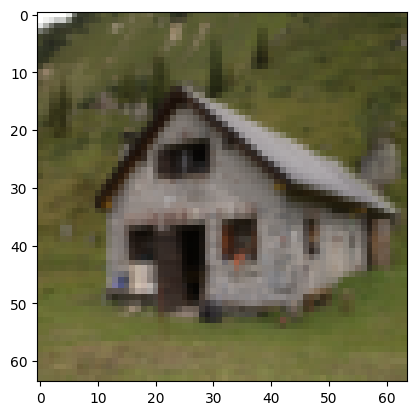

labels ---> tensor([164,  80, 164,  61])
predicted ---> tensor([164,  74, 150, 164])
total ---> 188
correct ---> 47
Истинный класс: Window, Предсказанный класс: Window


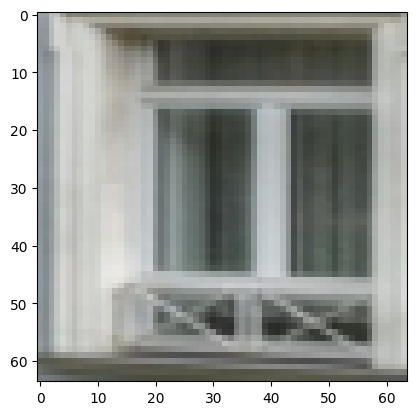

Истинный класс: Human mouth, Предсказанный класс: Human eye


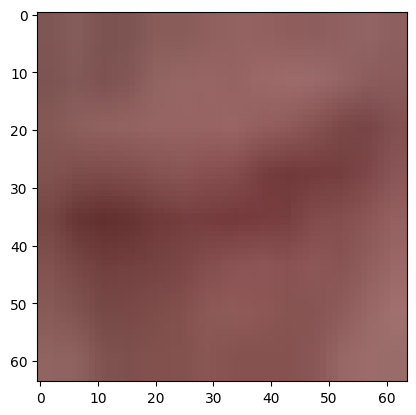

Истинный класс: Window, Предсказанный класс: Tree


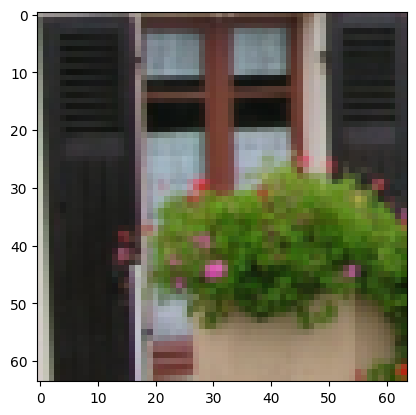

Истинный класс: Footwear, Предсказанный класс: Window


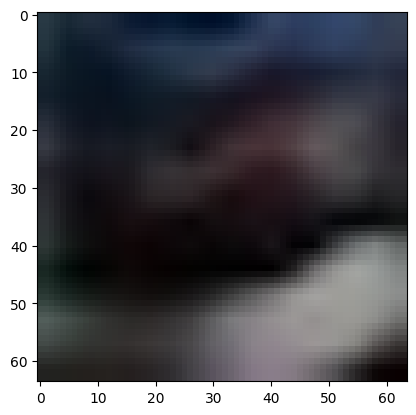

labels ---> tensor([128, 108,  53,  76])
predicted ---> tensor([164, 108, 164,  69])
total ---> 192
correct ---> 48
Истинный класс: Sports equipment, Предсказанный класс: Window


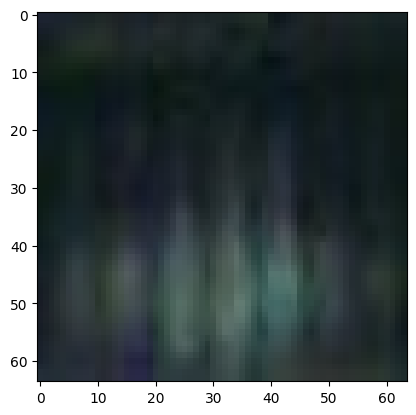

Истинный класс: Person, Предсказанный класс: Person


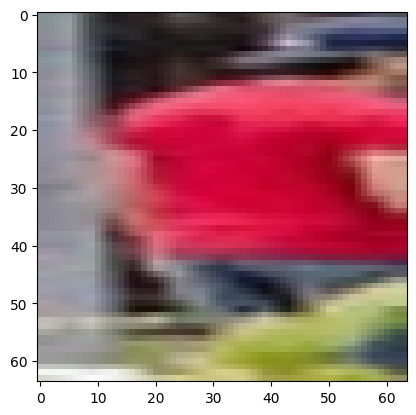

Истинный класс: Fashion accessory, Предсказанный класс: Window


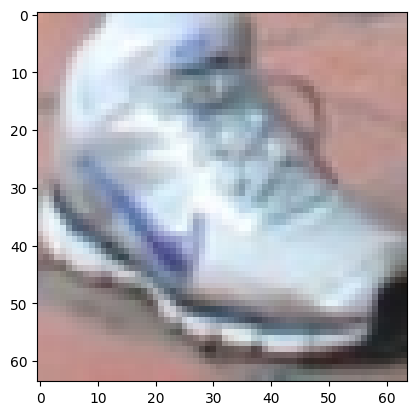

Истинный класс: Human hair, Предсказанный класс: House


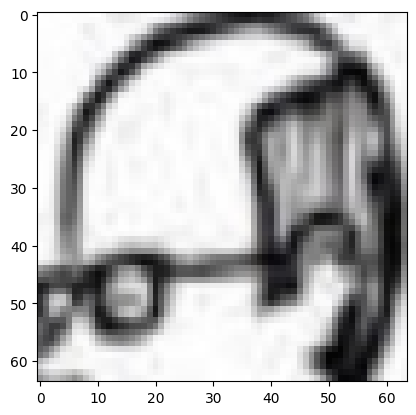

labels ---> tensor([ 69, 138,  63, 105])
predicted ---> tensor([164, 108,  25, 164])
total ---> 196
correct ---> 48
Истинный класс: House, Предсказанный класс: Window


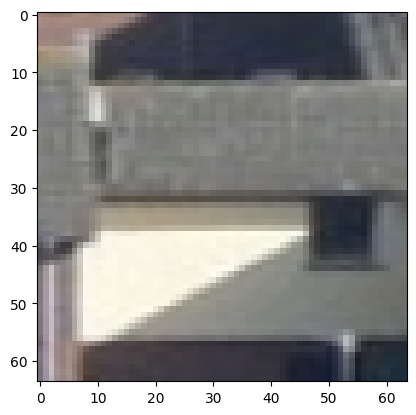

Истинный класс: Tableware, Предсказанный класс: Person


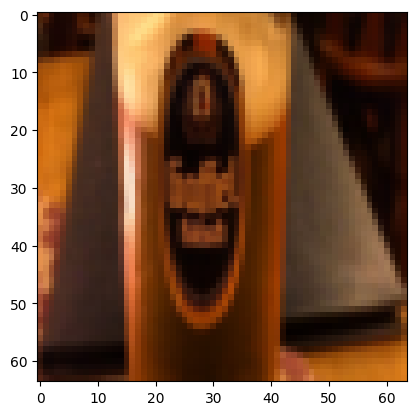

Истинный класс: Furniture, Предсказанный класс: Building


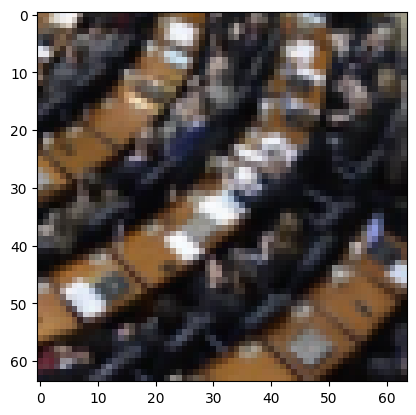

Истинный класс: Office supplies, Предсказанный класс: Window


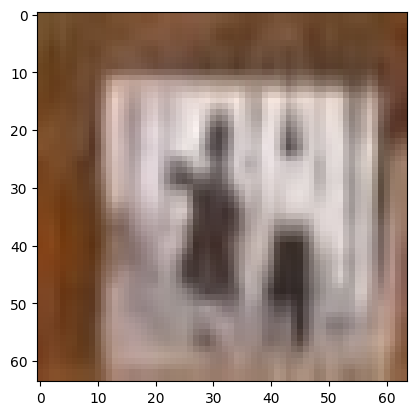

labels ---> tensor([108,  25, 164, 117])
predicted ---> tensor([108,  25, 164,  69])
total ---> 200
correct ---> 51
Истинный класс: Person, Предсказанный класс: Person


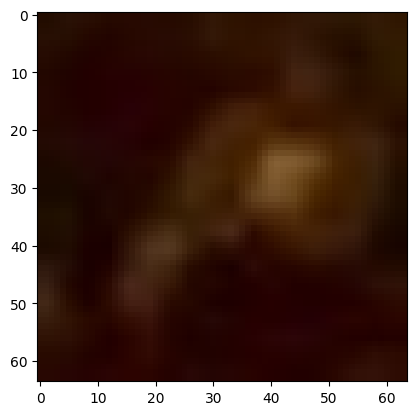

Истинный класс: Building, Предсказанный класс: Building


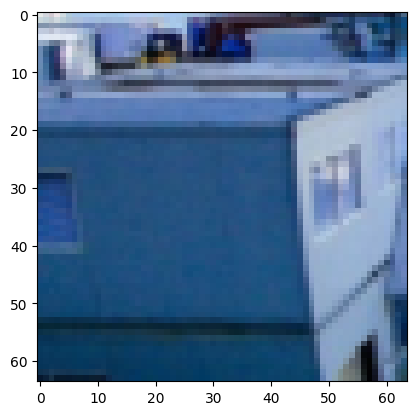

Истинный класс: Window, Предсказанный класс: Window


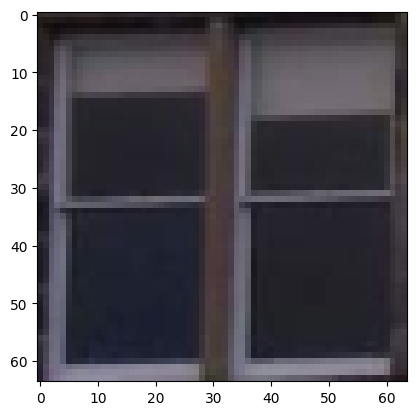

Истинный класс: Sculpture, Предсказанный класс: House


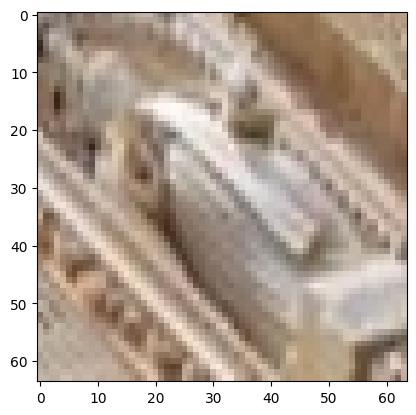

labels ---> tensor([108, 164, 154,  60])
predicted ---> tensor([108, 164,  25,  75])
total ---> 204
correct ---> 53
Истинный класс: Person, Предсказанный класс: Person


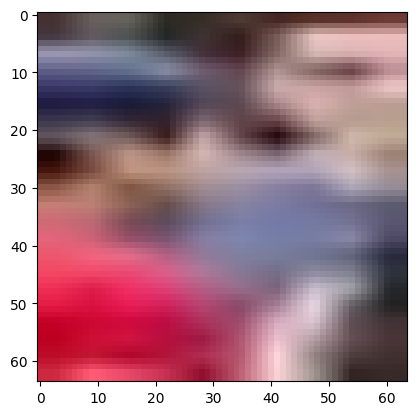

Истинный класс: Window, Предсказанный класс: Window


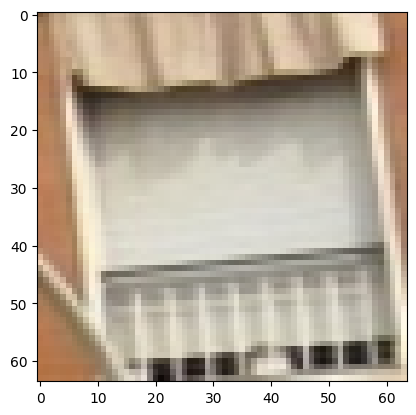

Истинный класс: Van, Предсказанный класс: Building


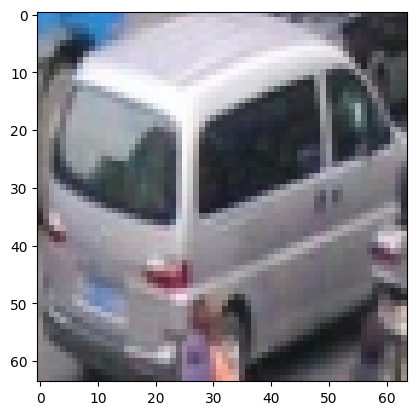

Истинный класс: Food, Предсказанный класс: Human face


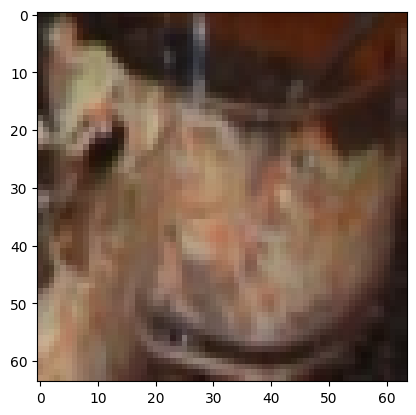

labels ---> tensor([150, 168, 164, 108])
predicted ---> tensor([150, 108, 164, 164])
total ---> 208
correct ---> 55
Истинный класс: Tree, Предсказанный класс: Tree


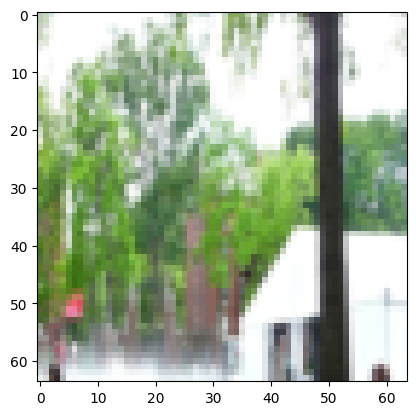

Истинный класс: Woman, Предсказанный класс: Person


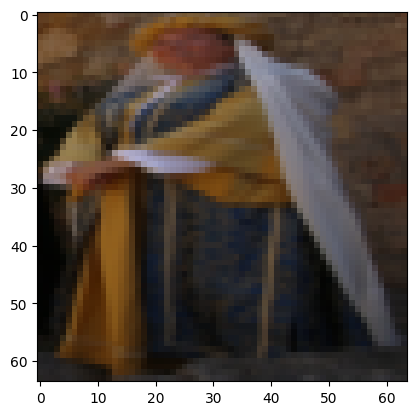

Истинный класс: Window, Предсказанный класс: Window


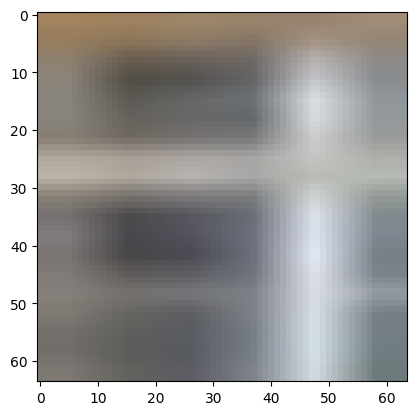

Истинный класс: Person, Предсказанный класс: Window


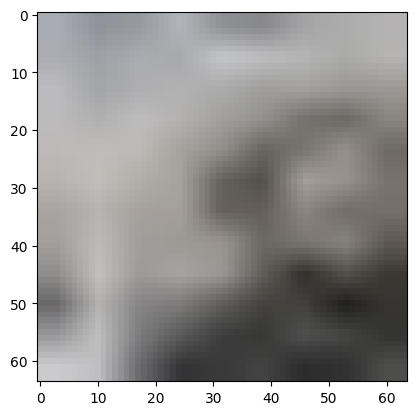

labels ---> tensor([162,  29,  25, 108])
predicted ---> tensor([164,  25,  69,  61])
total ---> 212
correct ---> 55
Истинный класс: Wheel, Предсказанный класс: Window


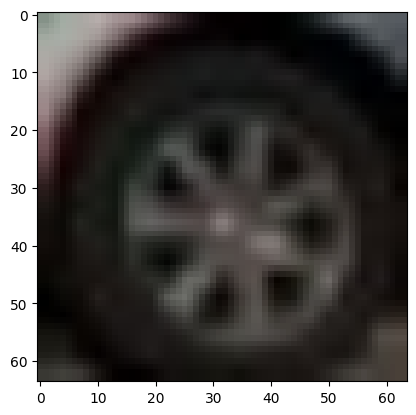

Истинный класс: Car, Предсказанный класс: Building


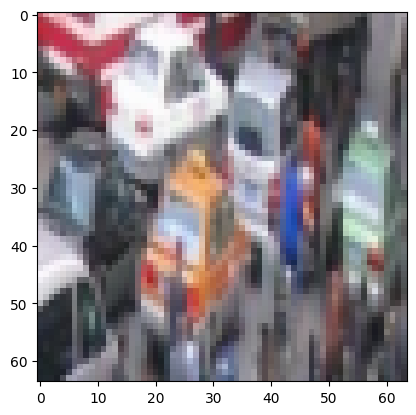

Истинный класс: Building, Предсказанный класс: House


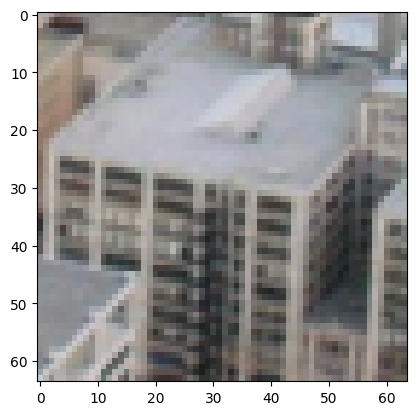

Истинный класс: Person, Предсказанный класс: Footwear


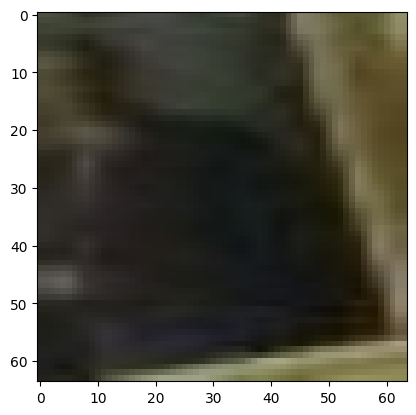

labels ---> tensor([150,  29, 104, 136])
predicted ---> tensor([150,  25, 164,  69])
total ---> 216
correct ---> 56
Истинный класс: Tree, Предсказанный класс: Tree


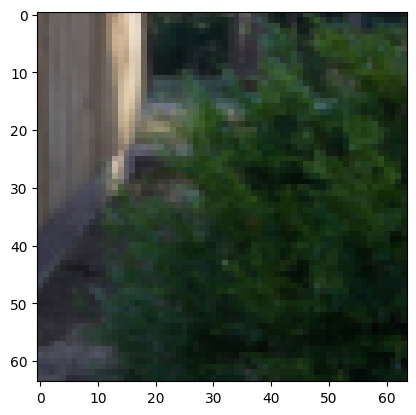

Истинный класс: Car, Предсказанный класс: Building


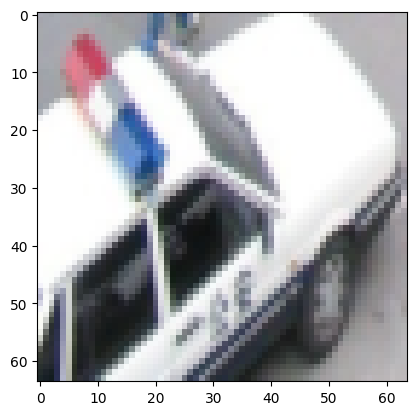

Истинный класс: Office building, Предсказанный класс: Window


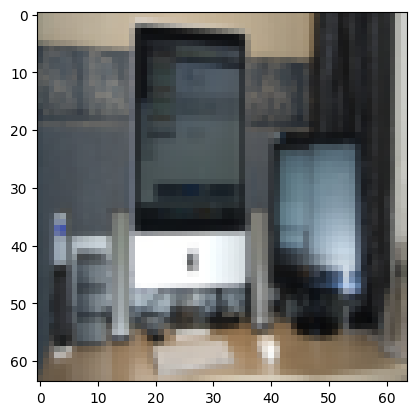

Истинный класс: Table, Предсказанный класс: House


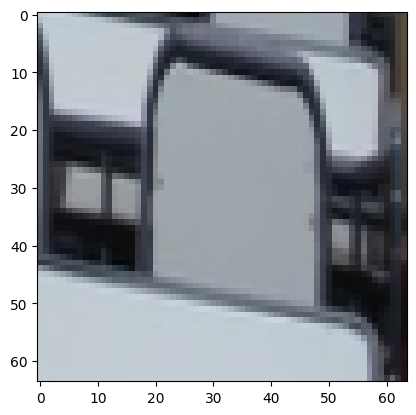

labels ---> tensor([ 69, 108, 136, 117])
predicted ---> tensor([ 69, 108, 108,  25])
total ---> 220
correct ---> 58
Истинный класс: House, Предсказанный класс: House


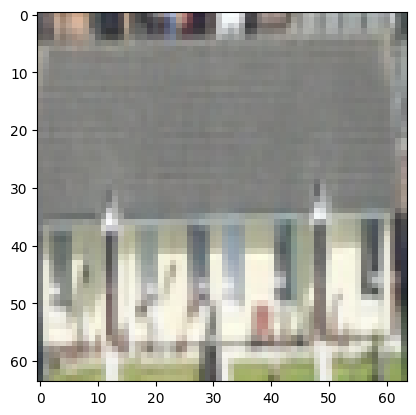

Истинный класс: Person, Предсказанный класс: Person


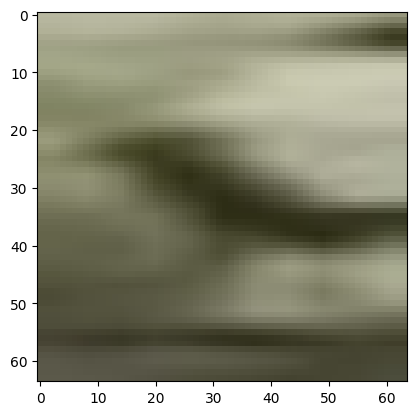

Истинный класс: Table, Предсказанный класс: Person


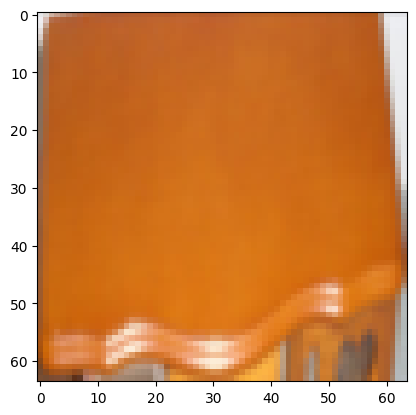

Истинный класс: Sculpture, Предсказанный класс: Building


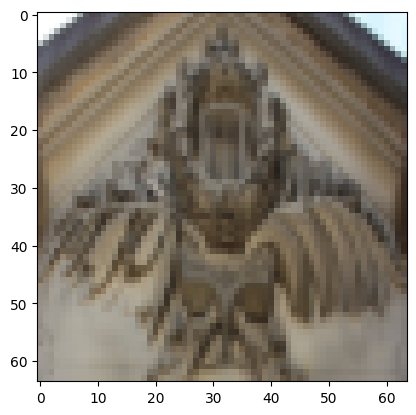

labels ---> tensor([ 25,  69,  25, 164])
predicted ---> tensor([108,  25,  25, 164])
total ---> 224
correct ---> 60
Истинный класс: Building, Предсказанный класс: Person


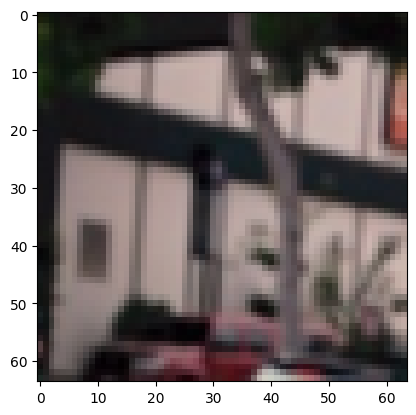

Истинный класс: House, Предсказанный класс: Building


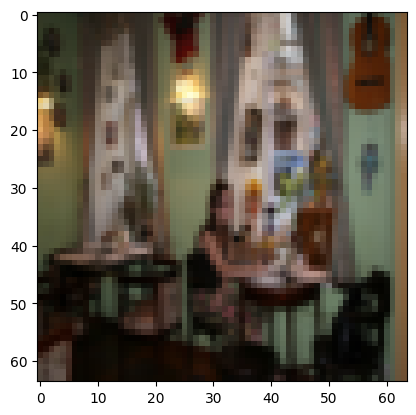

Истинный класс: Building, Предсказанный класс: Building


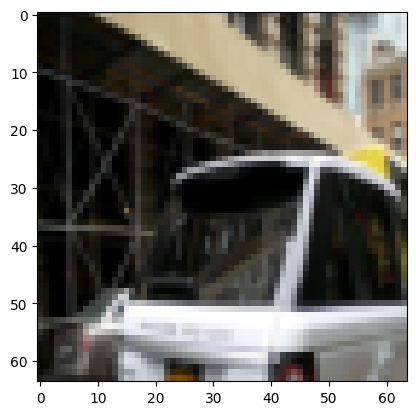

Истинный класс: Window, Предсказанный класс: Window


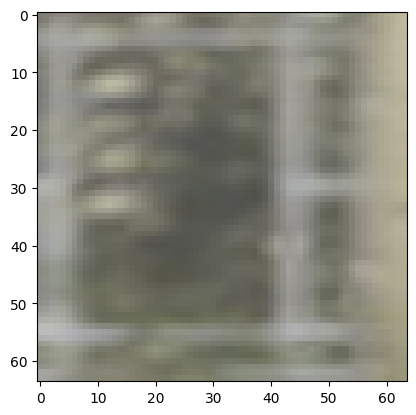

labels ---> tensor([128,  69, 119, 108])
predicted ---> tensor([ 76, 108,  25,  61])
total ---> 228
correct ---> 60
Истинный класс: Sports equipment, Предсказанный класс: Human hair


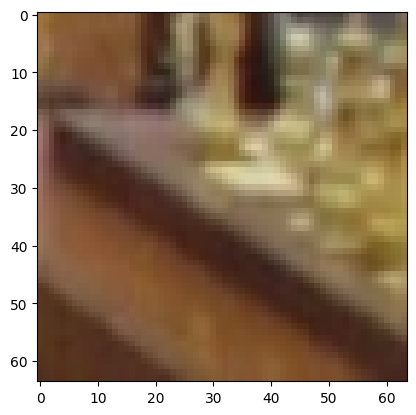

Истинный класс: House, Предсказанный класс: Person


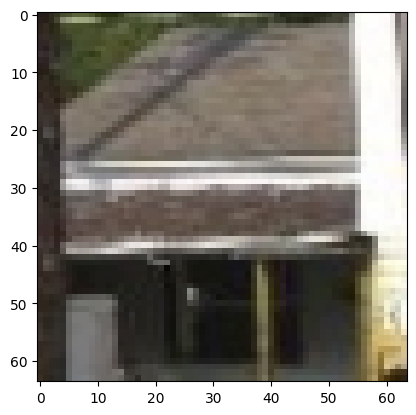

Истинный класс: Shelf, Предсказанный класс: Building


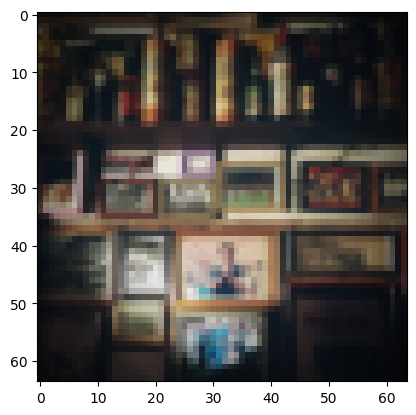

Истинный класс: Person, Предсказанный класс: Footwear


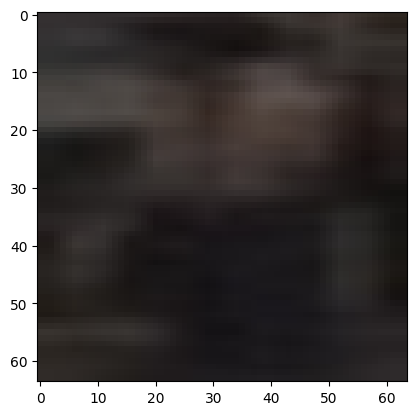

labels ---> tensor([164, 156,  36,  77])
predicted ---> tensor([ 25,  69, 108, 164])
total ---> 232
correct ---> 60
Истинный класс: Window, Предсказанный класс: Building


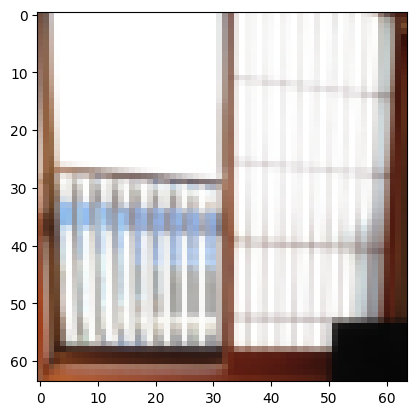

Истинный класс: Vehicle, Предсказанный класс: House


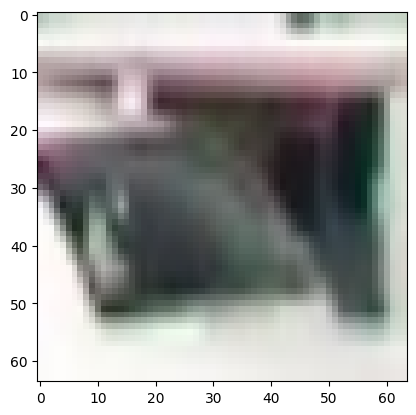

Истинный класс: Clothing, Предсказанный класс: Person


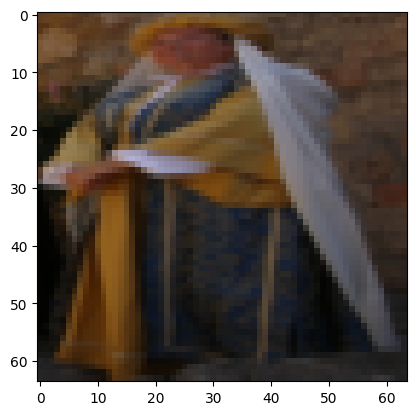

Истинный класс: Human hand, Предсказанный класс: Window


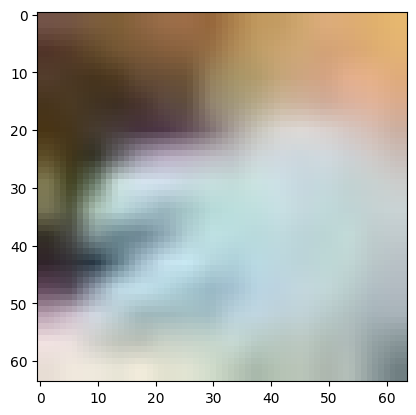

labels ---> tensor([162, 164,  45, 136])
predicted ---> tensor([164, 164,  75, 164])
total ---> 236
correct ---> 61
Истинный класс: Wheel, Предсказанный класс: Window


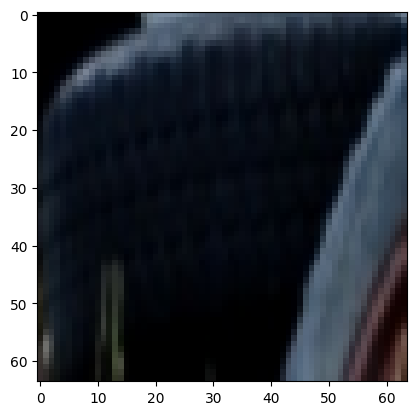

Истинный класс: Window, Предсказанный класс: Window


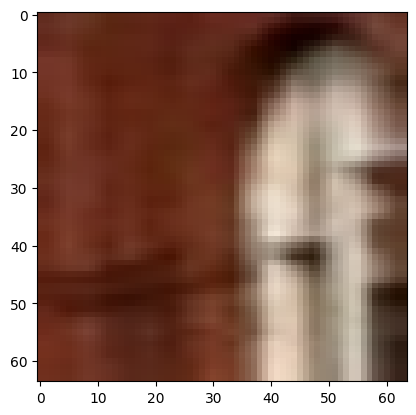

Истинный класс: Desk, Предсказанный класс: Human face


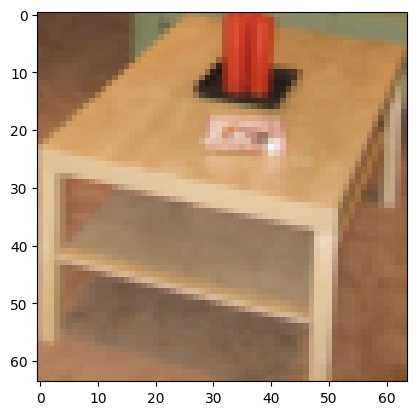

Истинный класс: Table, Предсказанный класс: Window


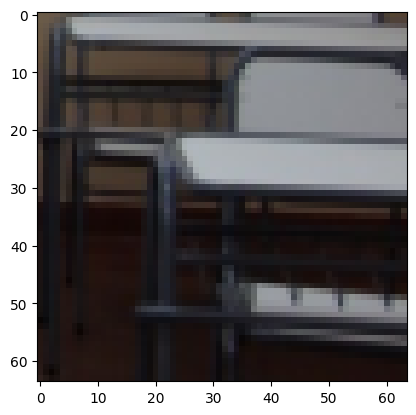

labels ---> tensor([155, 112, 150, 148])
predicted ---> tensor([150, 150, 164, 108])
total ---> 240
correct ---> 61
Истинный класс: Vegetable, Предсказанный класс: Tree


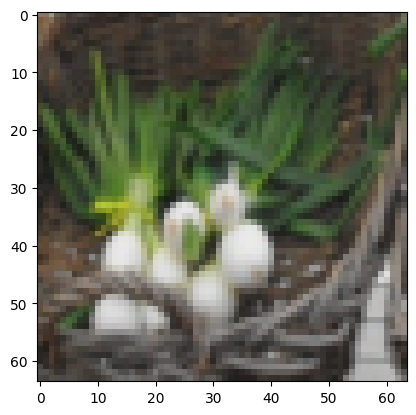

Истинный класс: Plant, Предсказанный класс: Tree


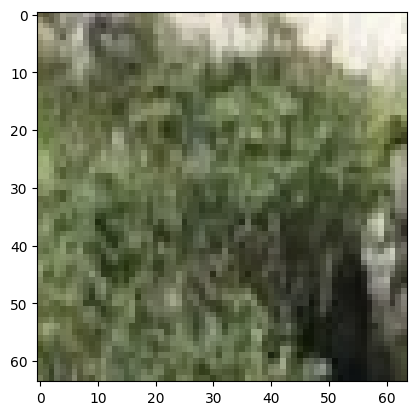

Истинный класс: Tree, Предсказанный класс: Window


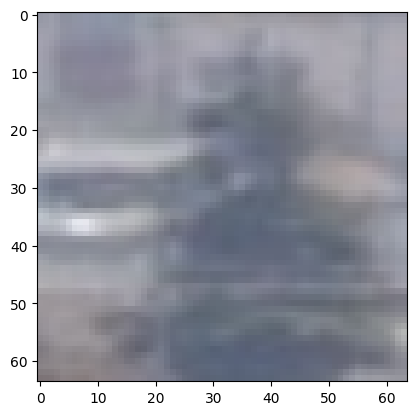

Истинный класс: Traffic light, Предсказанный класс: Person


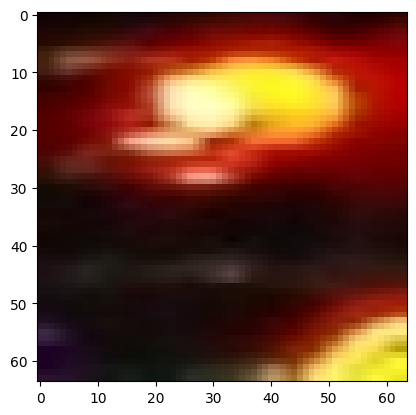

labels ---> tensor([ 69, 164, 138,  61])
predicted ---> tensor([ 25, 164, 164, 164])
total ---> 244
correct ---> 62
Истинный класс: House, Предсказанный класс: Building


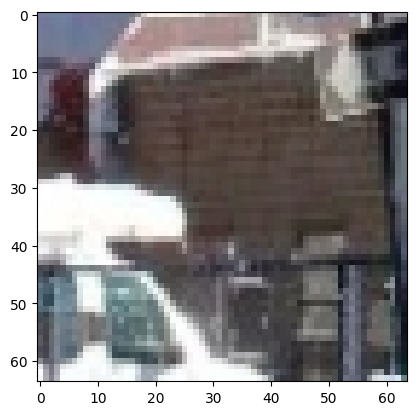

Истинный класс: Window, Предсказанный класс: Window


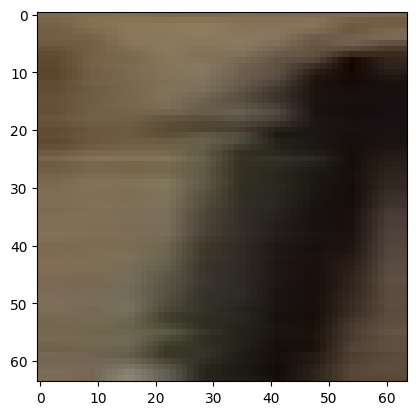

Истинный класс: Tableware, Предсказанный класс: Window


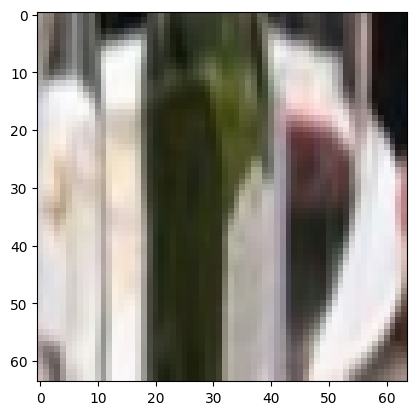

Истинный класс: Footwear, Предсказанный класс: Window


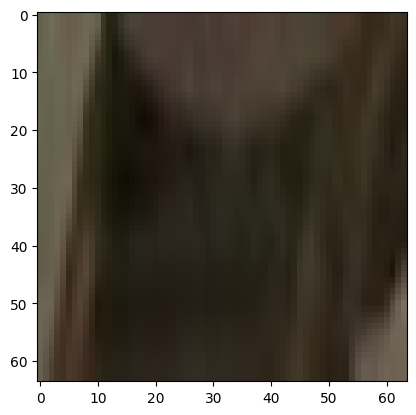

labels ---> tensor([136, 164,  70,  52])
predicted ---> tensor([108, 164, 112, 108])
total ---> 248
correct ---> 63
Истинный класс: Table, Предсказанный класс: Person


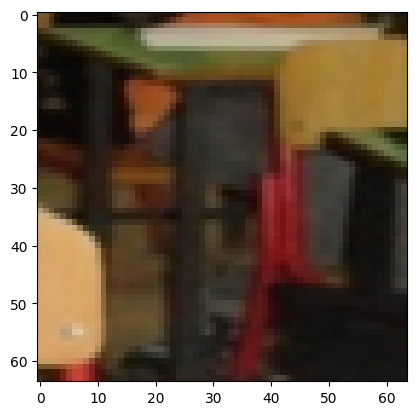

Истинный класс: Window, Предсказанный класс: Window


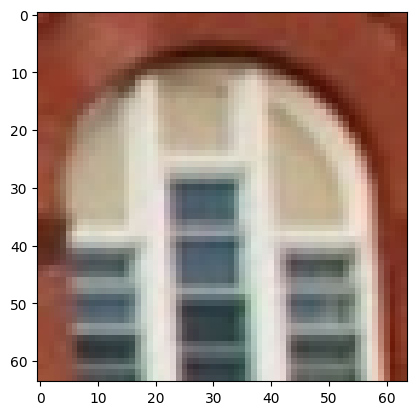

Истинный класс: Houseplant, Предсказанный класс: Plant


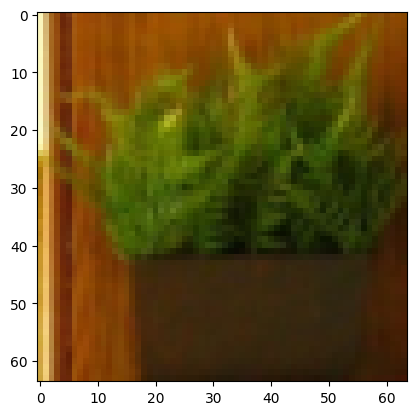

Истинный класс: Drum, Предсказанный класс: Person


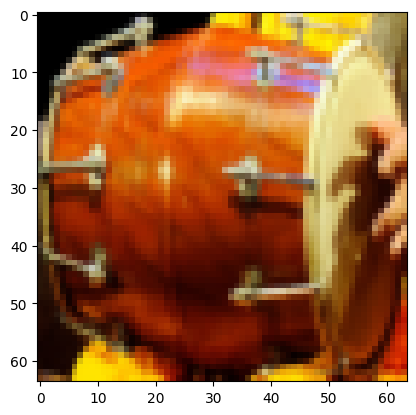

labels ---> tensor([ 27, 151,  25, 127])
predicted ---> tensor([108, 164,  25,  25])
total ---> 252
correct ---> 64
Истинный класс: Cabinetry, Предсказанный класс: Person


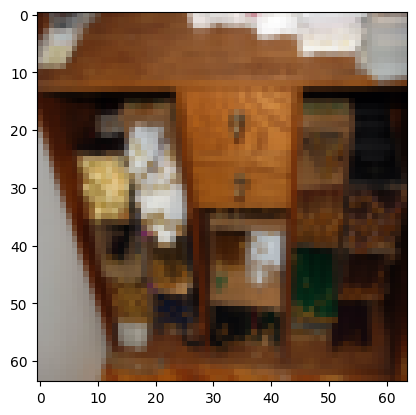

Истинный класс: Trousers, Предсказанный класс: Window


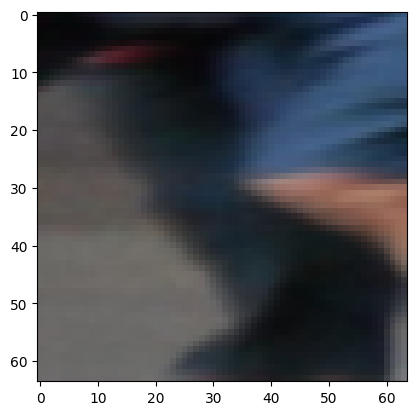

Истинный класс: Building, Предсказанный класс: Building


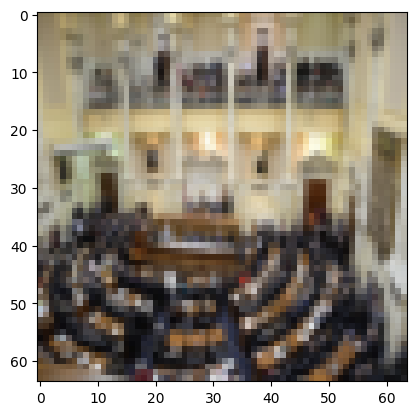

Истинный класс: Sofa bed, Предсказанный класс: Building


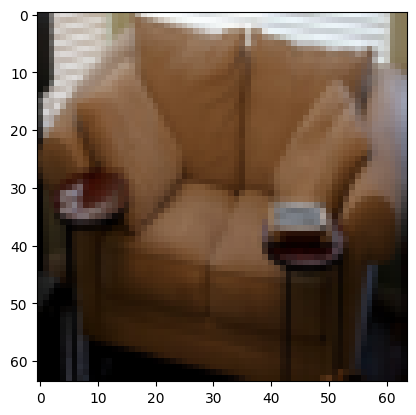

labels ---> tensor([ 96,  75, 108,  75])
predicted ---> tensor([164, 164, 108,  76])
total ---> 256
correct ---> 65
Истинный класс: Man, Предсказанный класс: Window


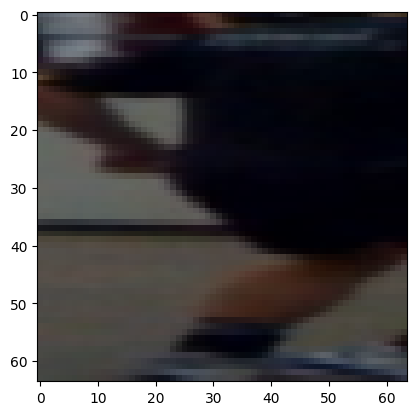

Истинный класс: Human face, Предсказанный класс: Window


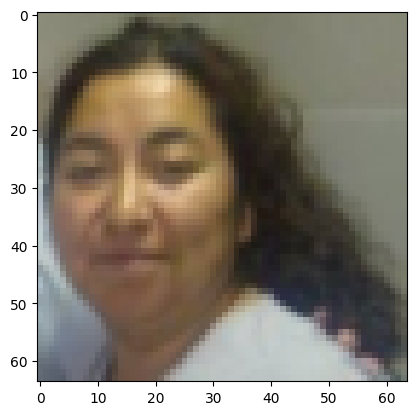

Истинный класс: Person, Предсказанный класс: Person


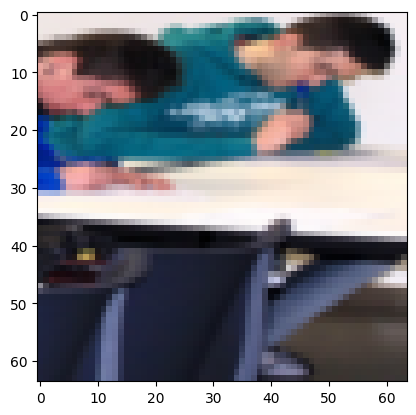

Истинный класс: Human face, Предсказанный класс: Human hair


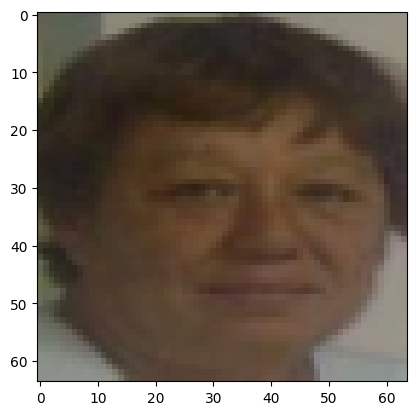

labels ---> tensor([64, 78, 95, 30])
predicted ---> tensor([108,  76, 164,  25])
total ---> 260
correct ---> 65
Истинный класс: Gas stove, Предсказанный класс: Person


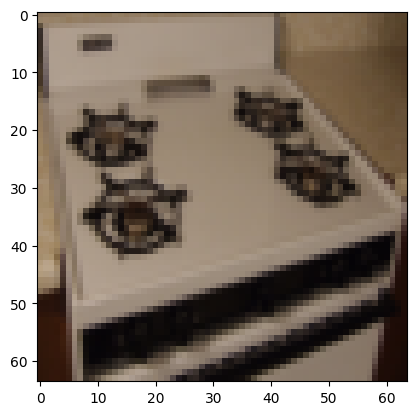

Истинный класс: Human head, Предсказанный класс: Human hair


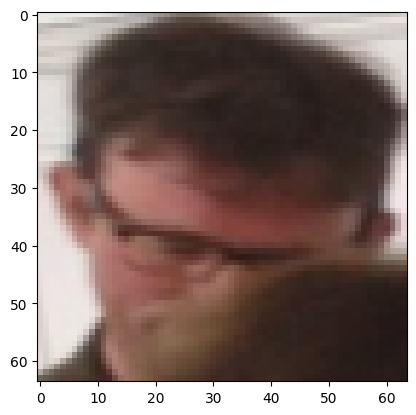

Истинный класс: Mammal, Предсказанный класс: Window


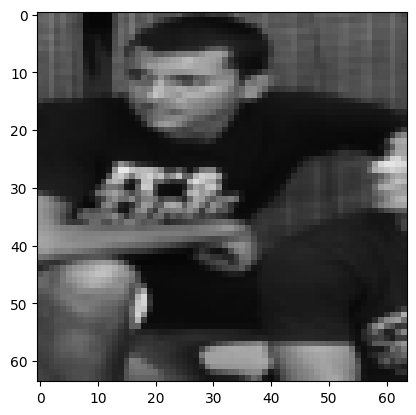

Истинный класс: Carnivore, Предсказанный класс: Building


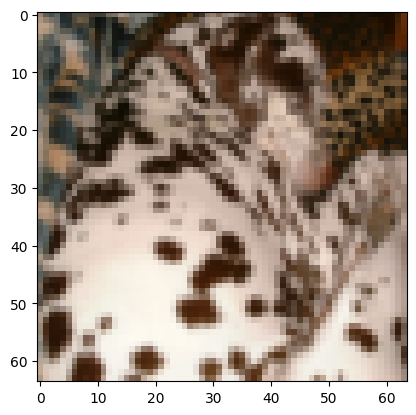

labels ---> tensor([136,  36,  69,  25])
predicted ---> tensor([162,  61,  25,  69])
total ---> 264
correct ---> 65
Истинный класс: Table, Предсказанный класс: Wheel


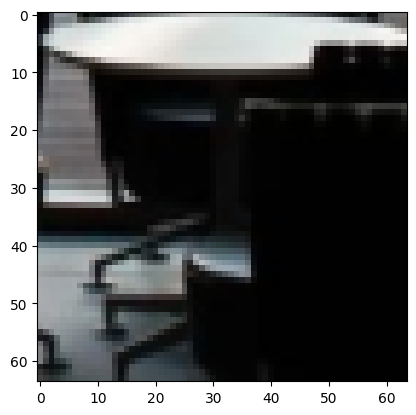

Истинный класс: Clothing, Предсказанный класс: Footwear


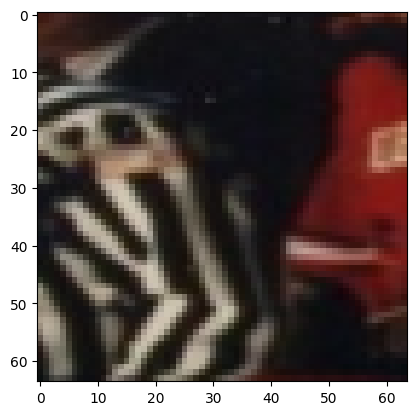

Истинный класс: House, Предсказанный класс: Building


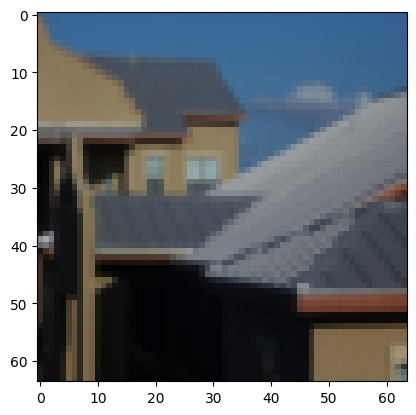

Истинный класс: Building, Предсказанный класс: House


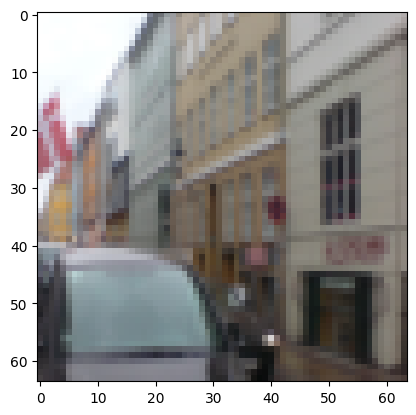

labels ---> tensor([168, 136,  61,  41])
predicted ---> tensor([108, 108,  61,  25])
total ---> 268
correct ---> 66
Истинный класс: Woman, Предсказанный класс: Person


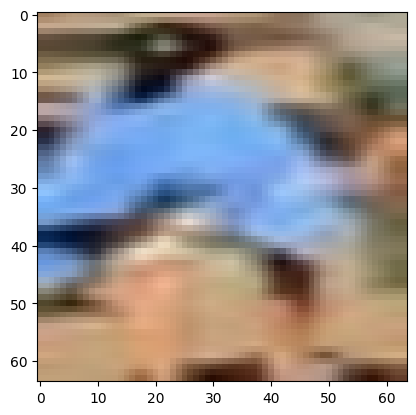

Истинный класс: Table, Предсказанный класс: Person


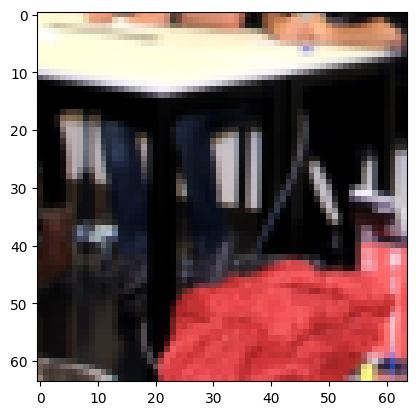

Истинный класс: Footwear, Предсказанный класс: Footwear


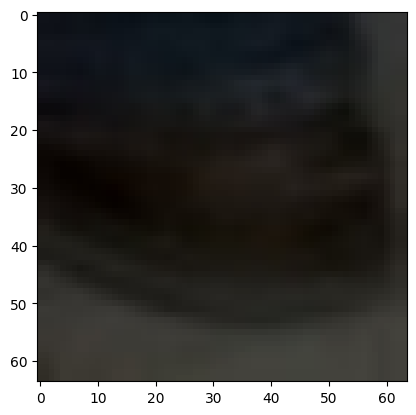

Истинный класс: Couch, Предсказанный класс: Building


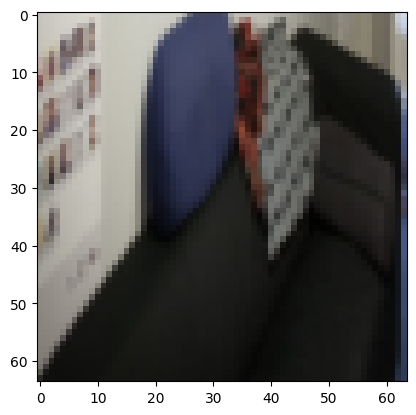

labels ---> tensor([43, 25, 11, 78])
predicted ---> tensor([164,  25, 164,  77])
total ---> 272
correct ---> 67
Истинный класс: Cupboard, Предсказанный класс: Window


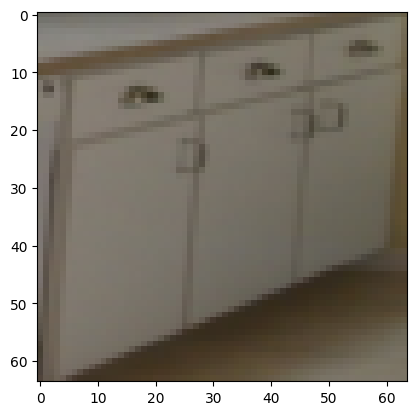

Истинный класс: Building, Предсказанный класс: Building


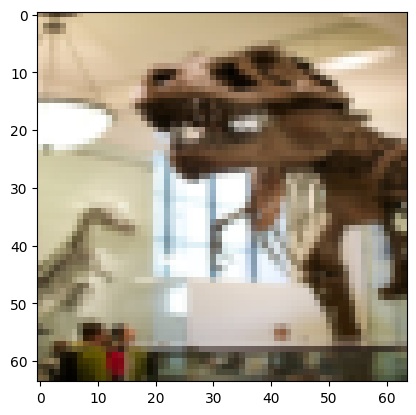

Истинный класс: Bench, Предсказанный класс: Window


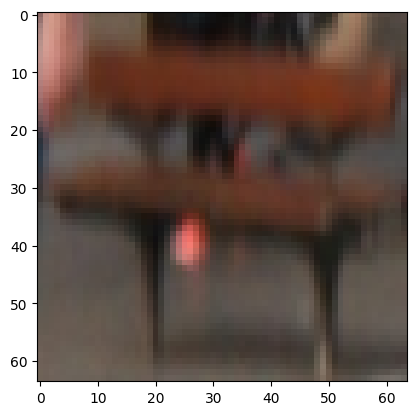

Истинный класс: Human head, Предсказанный класс: Human hand


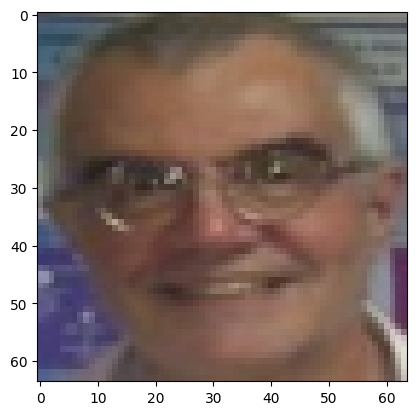

labels ---> tensor([45, 85, 69, 79])
predicted ---> tensor([108, 108,  69, 164])
total ---> 276
correct ---> 68
Истинный класс: Desk, Предсказанный класс: Person


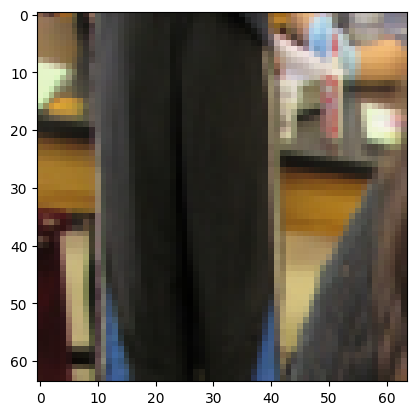

Истинный класс: Kitchen & dining room table, Предсказанный класс: Person


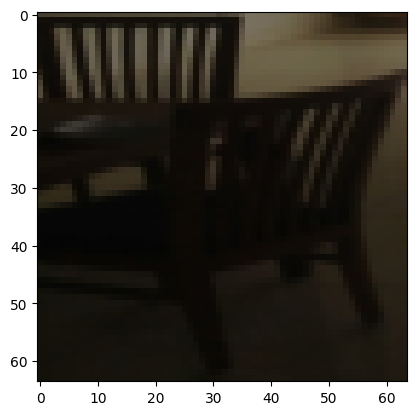

Истинный класс: House, Предсказанный класс: House


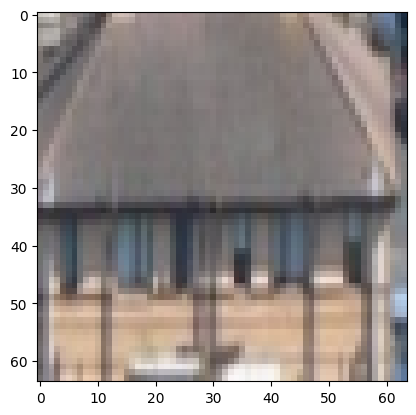

Истинный класс: Human leg, Предсказанный класс: Window


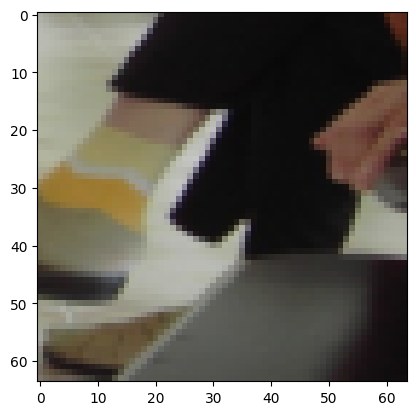

labels ---> tensor([ 32, 147, 164,  80])
predicted ---> tensor([108, 108, 164, 108])
total ---> 280
correct ---> 69
Истинный класс: Chair, Предсказанный класс: Person


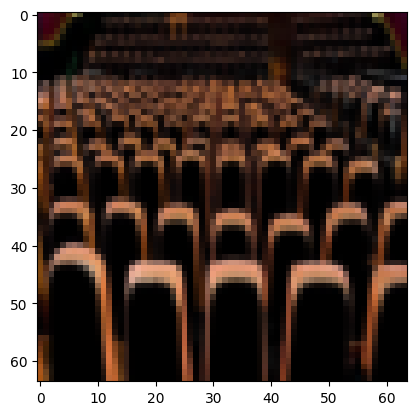

Истинный класс: Toy, Предсказанный класс: Person


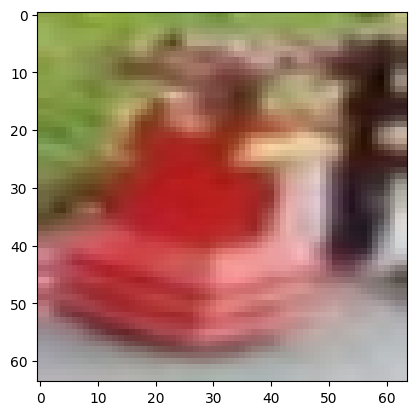

Истинный класс: Window, Предсказанный класс: Window


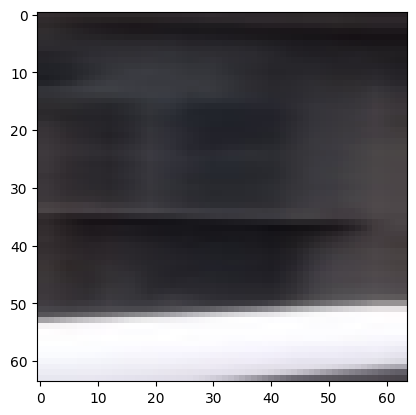

Истинный класс: Human mouth, Предсказанный класс: Person


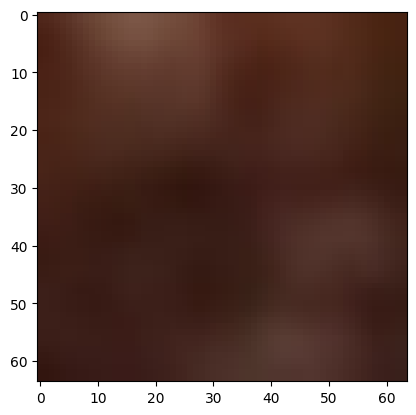

labels ---> tensor([132, 108, 164, 164])
predicted ---> tensor([ 25,  77,  76, 164])
total ---> 284
correct ---> 70
Истинный класс: Stretcher, Предсказанный класс: Building


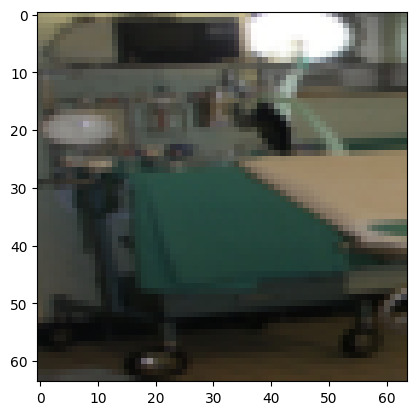

Истинный класс: Person, Предсказанный класс: Human hand


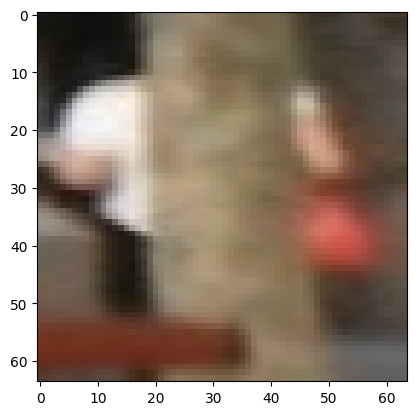

Истинный класс: Window, Предсказанный класс: Human hair


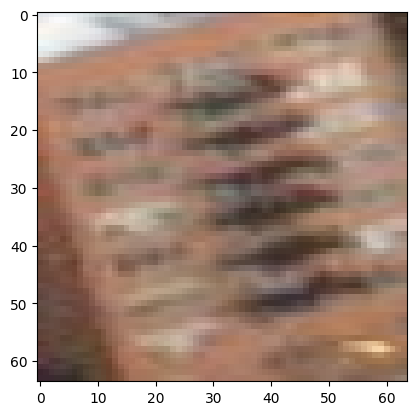

Истинный класс: Window, Предсказанный класс: Window


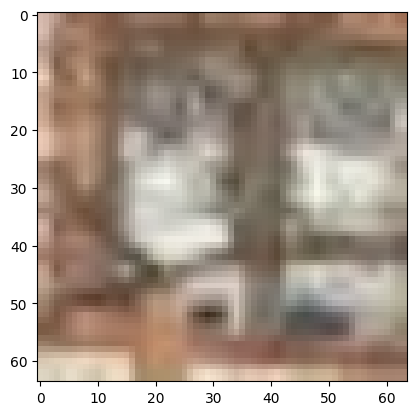

labels ---> tensor([150,  78,  72,  65])
predicted ---> tensor([162, 150, 108, 164])
total ---> 288
correct ---> 70
Истинный класс: Tree, Предсказанный класс: Wheel


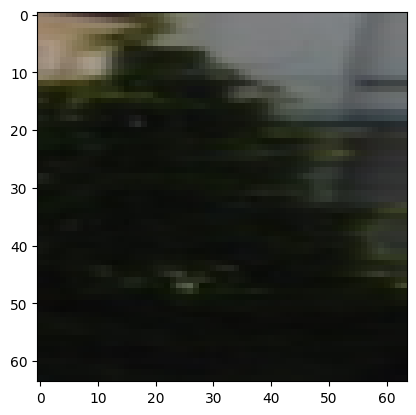

Истинный класс: Human head, Предсказанный класс: Tree


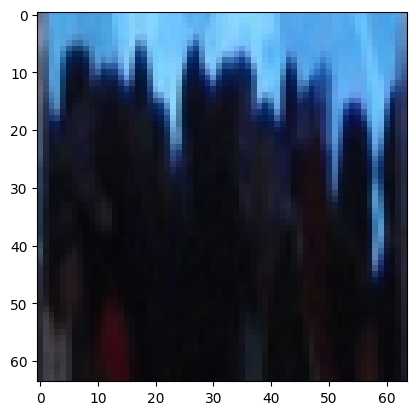

Истинный класс: Human body, Предсказанный класс: Person


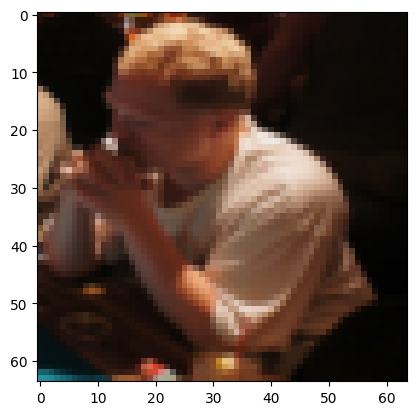

Истинный класс: Girl, Предсказанный класс: Window


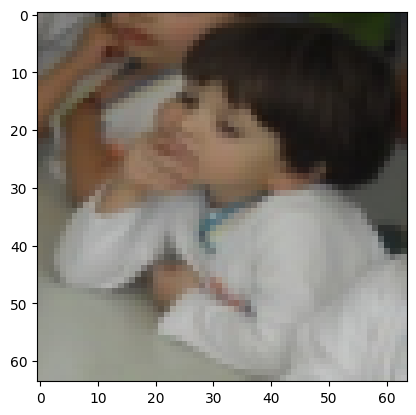

labels ---> tensor([164,  71,  47,  79])
predicted ---> tensor([164, 164,  25, 164])
total ---> 292
correct ---> 71
Истинный класс: Window, Предсказанный класс: Window


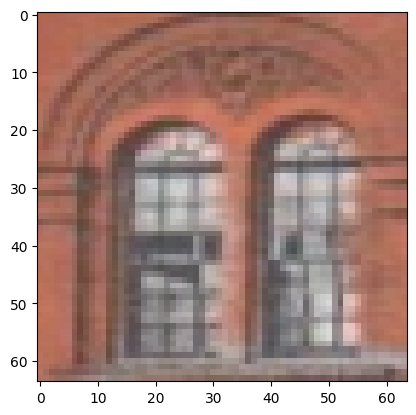

Истинный класс: Human arm, Предсказанный класс: Window


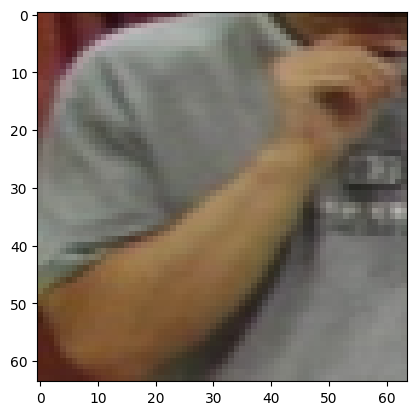

Истинный класс: Door, Предсказанный класс: Building


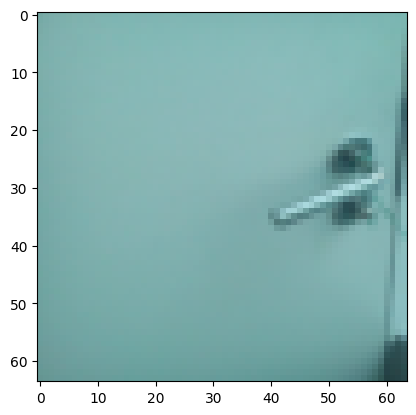

Истинный класс: Human leg, Предсказанный класс: Window


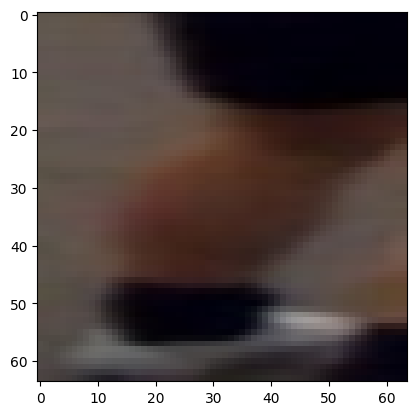

labels ---> tensor([32, 25, 92, 92])
predicted ---> tensor([108,  25,  92,  92])
total ---> 296
correct ---> 74
Истинный класс: Chair, Предсказанный класс: Person


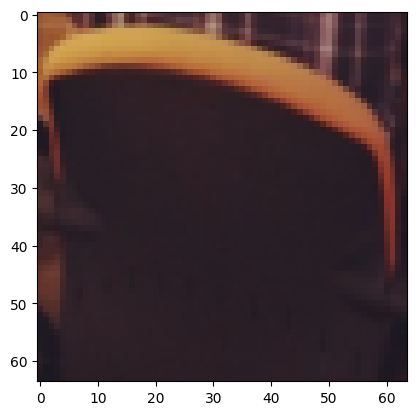

Истинный класс: Building, Предсказанный класс: Building


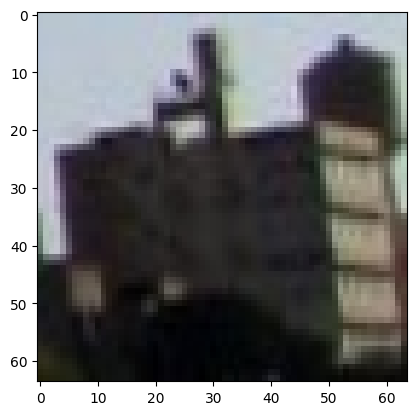

Истинный класс: Light bulb, Предсказанный класс: Light bulb


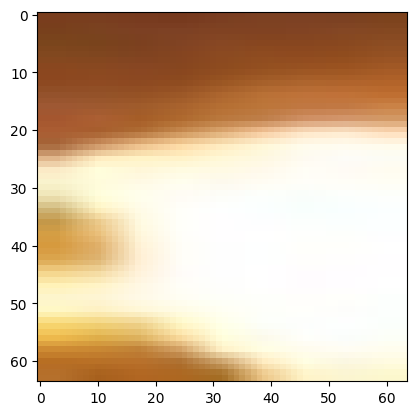

Истинный класс: Light bulb, Предсказанный класс: Light bulb


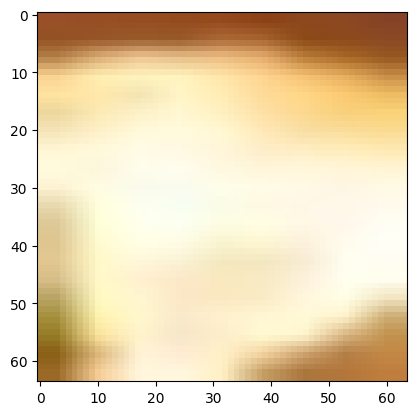

labels ---> tensor([114, 104, 157,  36])
predicted ---> tensor([ 76,  25, 164, 164])
total ---> 300
correct ---> 74
Истинный класс: Poster, Предсказанный класс: Human hair


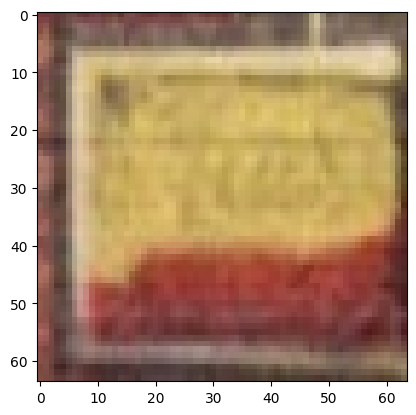

Истинный класс: Office building, Предсказанный класс: Building


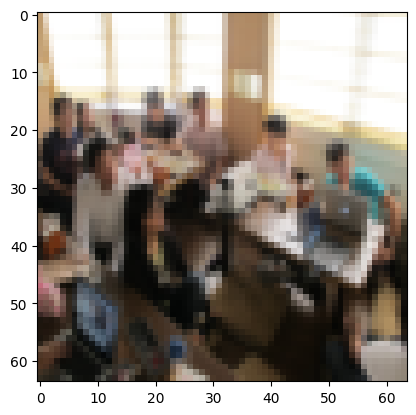

Истинный класс: Vehicle registration plate, Предсказанный класс: Window


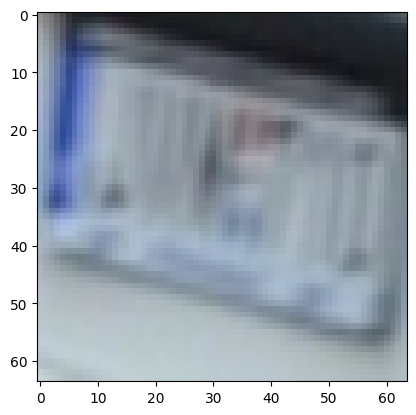

Истинный класс: Clothing, Предсказанный класс: Window


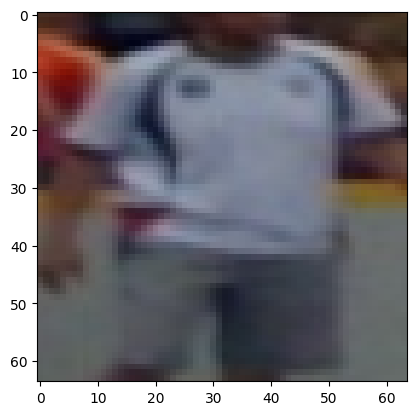

labels ---> tensor([89, 69, 76, 96])
predicted ---> tensor([108,  69,  76, 108])
total ---> 304
correct ---> 76
Истинный класс: Land vehicle, Предсказанный класс: Person


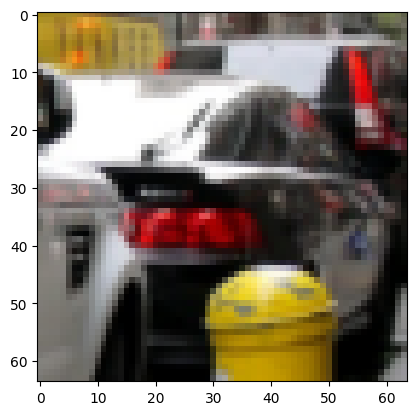

Истинный класс: House, Предсказанный класс: House


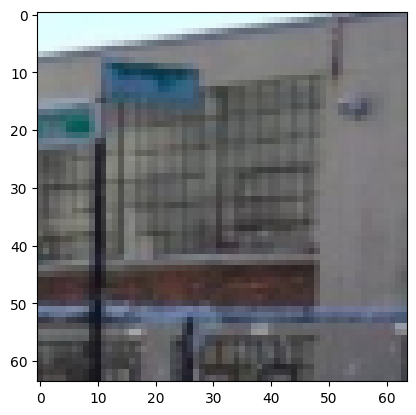

Истинный класс: Human hair, Предсказанный класс: Human hair


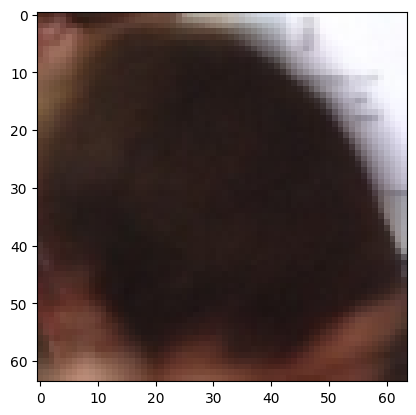

Истинный класс: Man, Предсказанный класс: Person


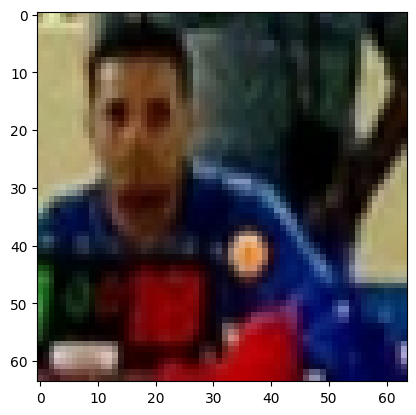

labels ---> tensor([ 76,  96, 108, 144])
predicted ---> tensor([164,  61, 164,  69])
total ---> 308
correct ---> 76
Истинный класс: Human hair, Предсказанный класс: Window


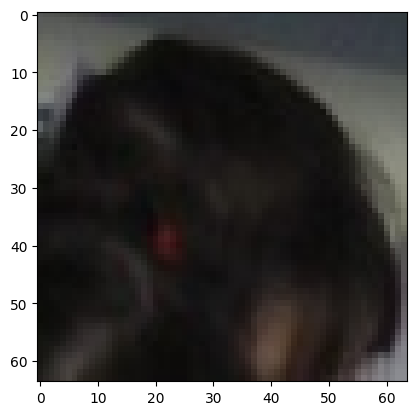

Истинный класс: Man, Предсказанный класс: Footwear


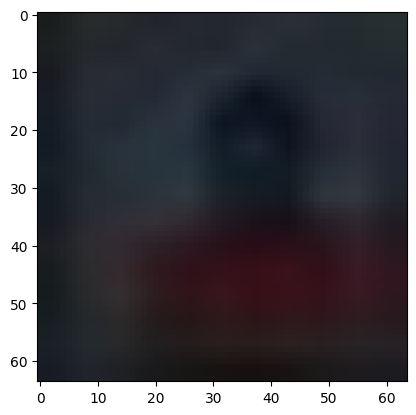

Истинный класс: Person, Предсказанный класс: Window


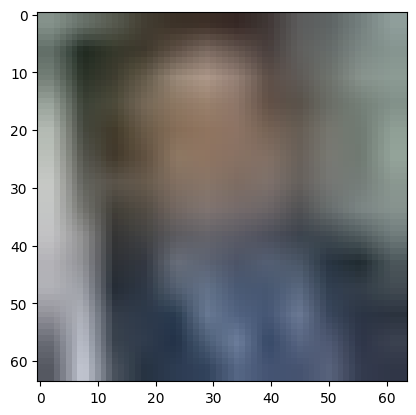

Истинный класс: Tire, Предсказанный класс: House


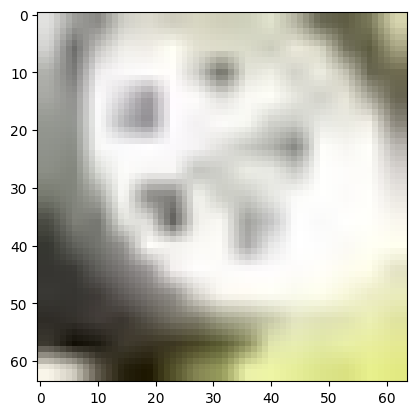

labels ---> tensor([128,  95,  69, 108])
predicted ---> tensor([ 25, 164,  69,  25])
total ---> 312
correct ---> 77
Истинный класс: Sports equipment, Предсказанный класс: Building


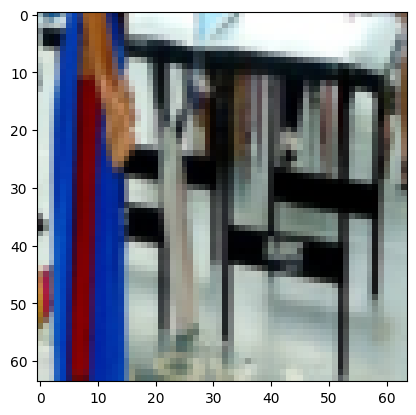

Истинный класс: Mammal, Предсказанный класс: Window


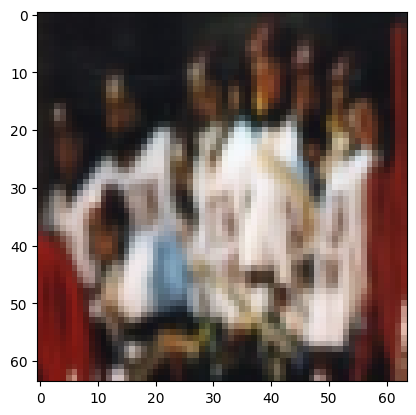

Истинный класс: House, Предсказанный класс: House


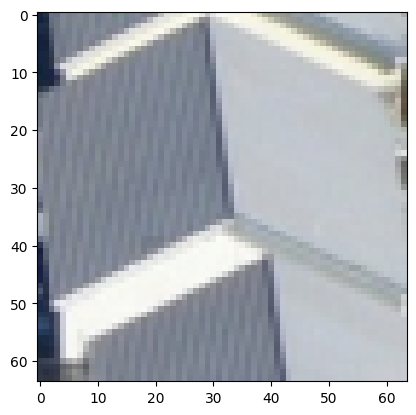

Истинный класс: Person, Предсказанный класс: Building


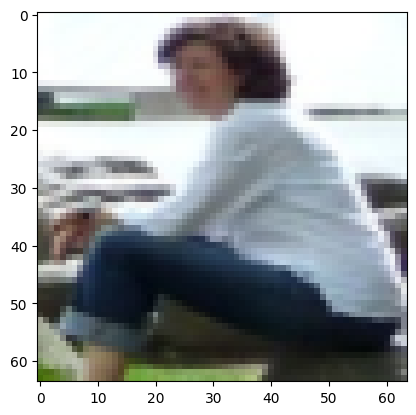

labels ---> tensor([ 36, 136,  25,  76])
predicted ---> tensor([ 25, 108, 164,  76])
total ---> 316
correct ---> 78
Истинный класс: Clothing, Предсказанный класс: Building


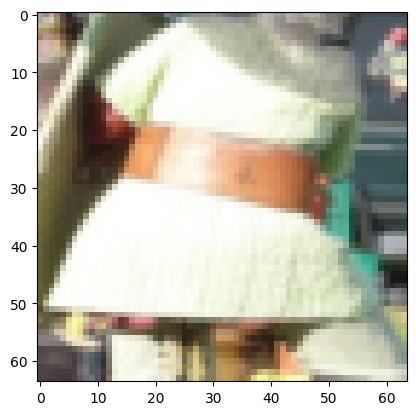

Истинный класс: Table, Предсказанный класс: Person


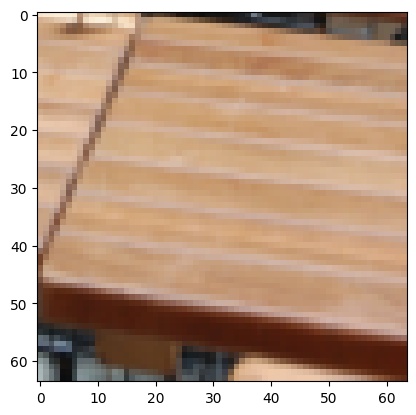

Истинный класс: Building, Предсказанный класс: Window


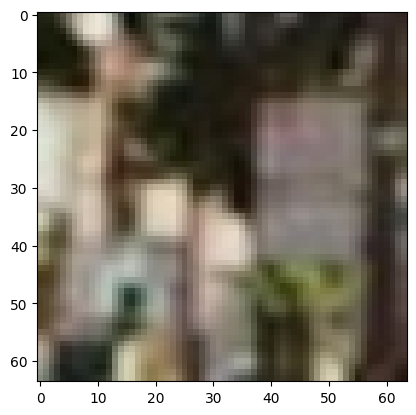

Истинный класс: Human hair, Предсказанный класс: Human hair


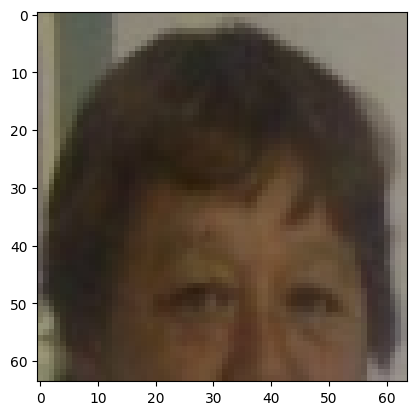

labels ---> tensor([ 45, 131, 164, 164])
predicted ---> tensor([ 25, 164,  69, 164])
total ---> 320
correct ---> 79
Истинный класс: Desk, Предсказанный класс: Building


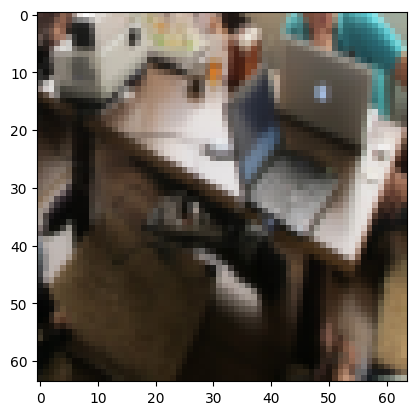

Истинный класс: Street light, Предсказанный класс: Window


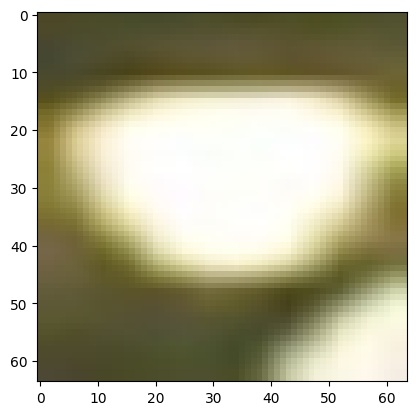

Истинный класс: Window, Предсказанный класс: House


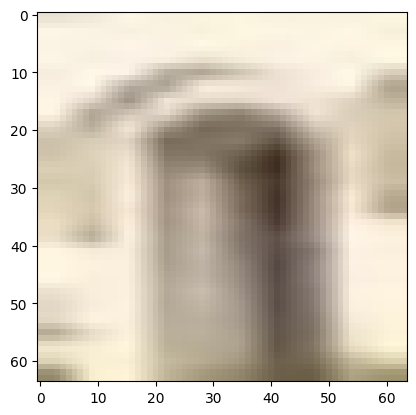

Истинный класс: Window, Предсказанный класс: Window


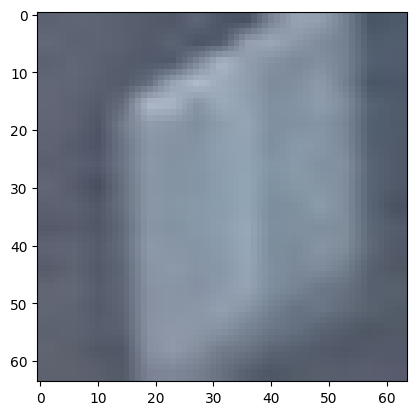

labels ---> tensor([162,  47, 164, 164])
predicted ---> tensor([ 69, 164, 164, 164])
total ---> 324
correct ---> 81
Истинный класс: Wheel, Предсказанный класс: House


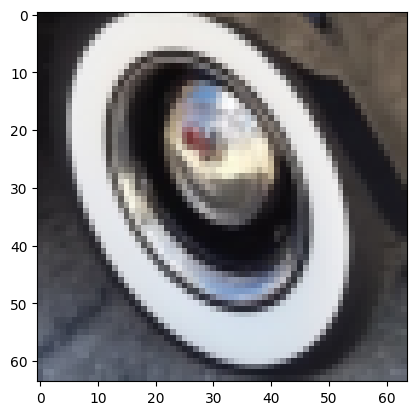

Истинный класс: Door, Предсказанный класс: Window


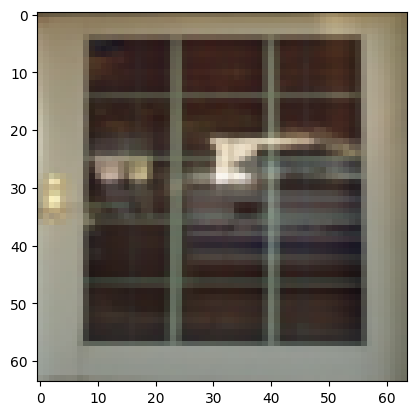

Истинный класс: Window, Предсказанный класс: Window


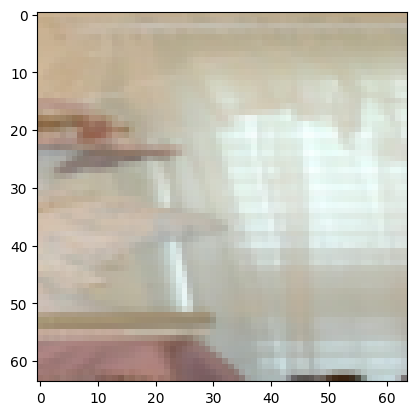

Истинный класс: Window, Предсказанный класс: Window


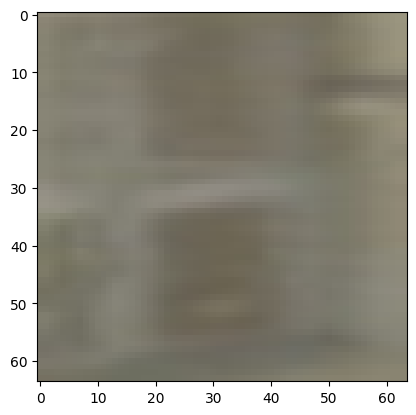

labels ---> tensor([69, 29, 45, 36])
predicted ---> tensor([ 69, 108, 164, 108])
total ---> 328
correct ---> 82
Истинный класс: House, Предсказанный класс: House


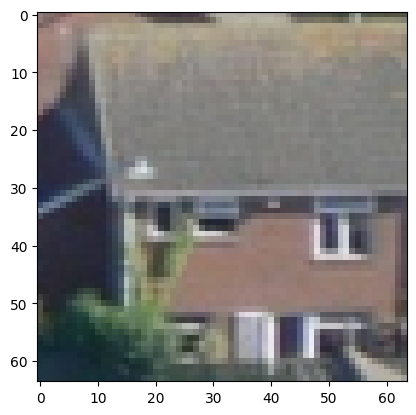

Истинный класс: Car, Предсказанный класс: Person


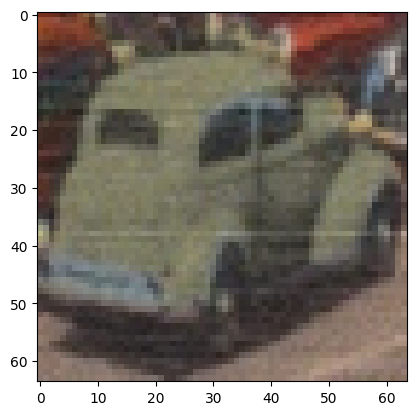

Истинный класс: Desk, Предсказанный класс: Window


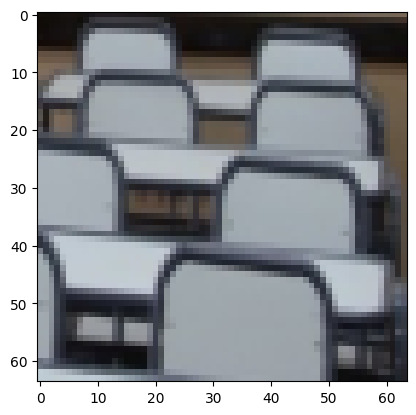

Истинный класс: Clothing, Предсказанный класс: Person


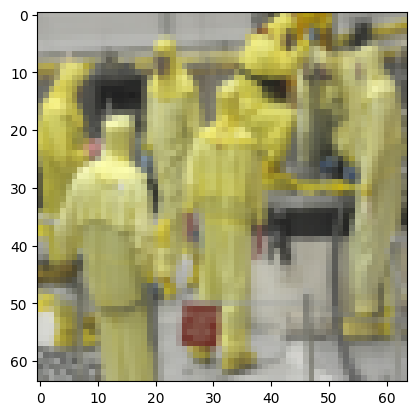

labels ---> tensor([ 29,  25, 136, 108])
predicted ---> tensor([108,  25, 108,  25])
total ---> 332
correct ---> 83
Истинный класс: Car, Предсказанный класс: Person


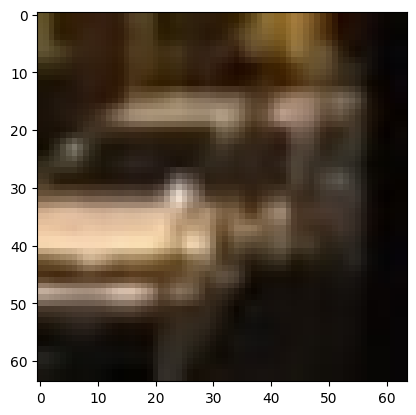

Истинный класс: Building, Предсказанный класс: Building


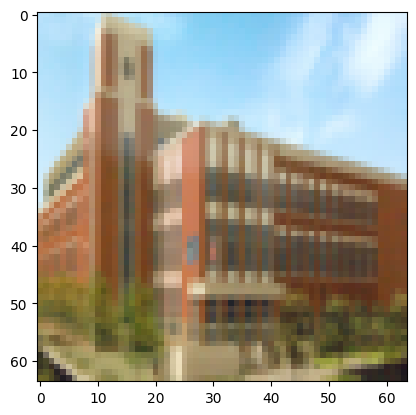

Истинный класс: Table, Предсказанный класс: Person


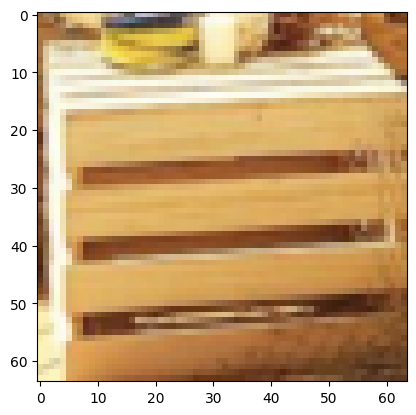

Истинный класс: Person, Предсказанный класс: Building


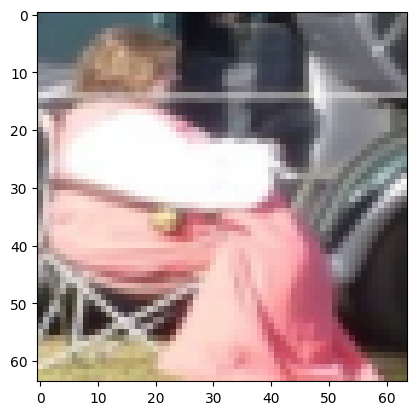

labels ---> tensor([ 36, 156, 164, 168])
predicted ---> tensor([ 61, 164, 164, 150])
total ---> 336
correct ---> 84
Истинный класс: Clothing, Предсказанный класс: Footwear


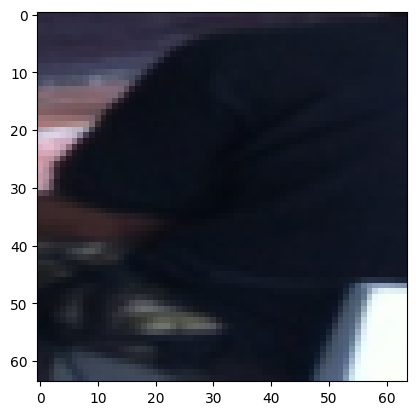

Истинный класс: Vehicle, Предсказанный класс: Window


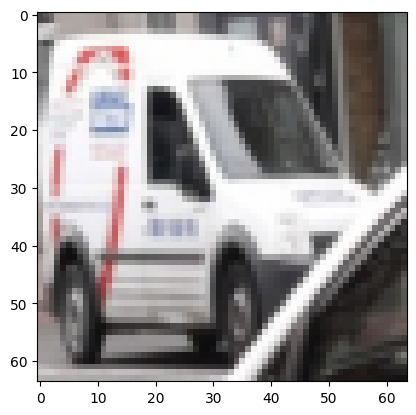

Истинный класс: Window, Предсказанный класс: Window


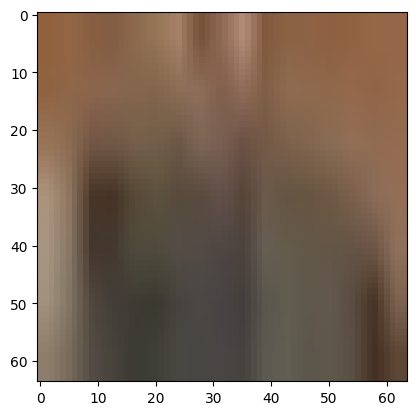

Истинный класс: Woman, Предсказанный класс: Tree


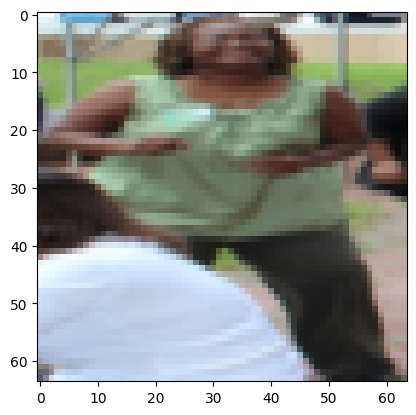

labels ---> tensor([ 61,  86, 107, 156])
predicted ---> tensor([164, 164, 108, 164])
total ---> 340
correct ---> 84
Истинный класс: Footwear, Предсказанный класс: Window


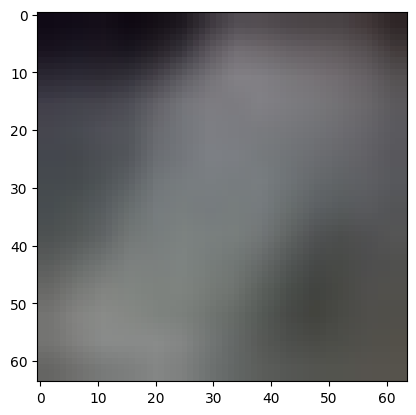

Истинный класс: Kitchen appliance, Предсказанный класс: Window


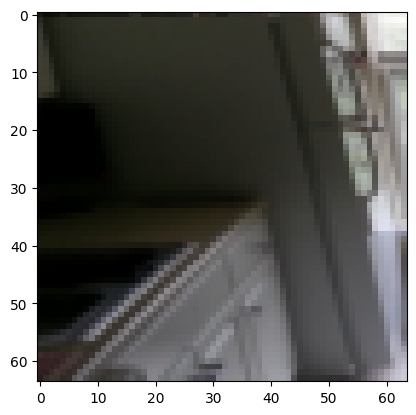

Истинный класс: Palm tree, Предсказанный класс: Person


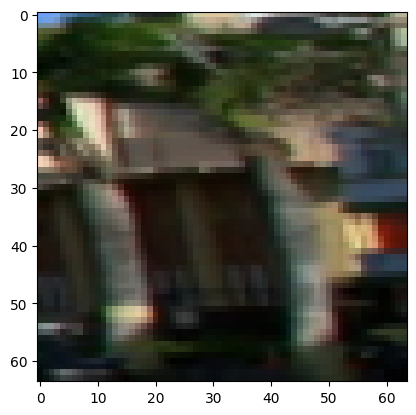

Истинный класс: Vehicle, Предсказанный класс: Window


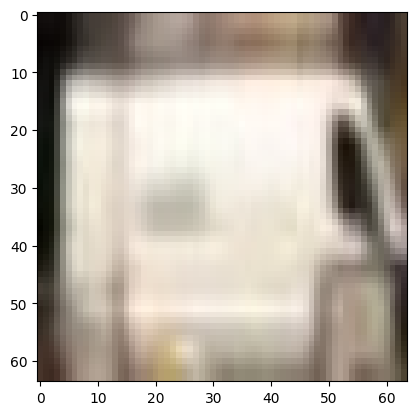

labels ---> tensor([ 69,  69,  71, 164])
predicted ---> tensor([164, 164, 108, 164])
total ---> 344
correct ---> 85
Истинный класс: House, Предсказанный класс: Window


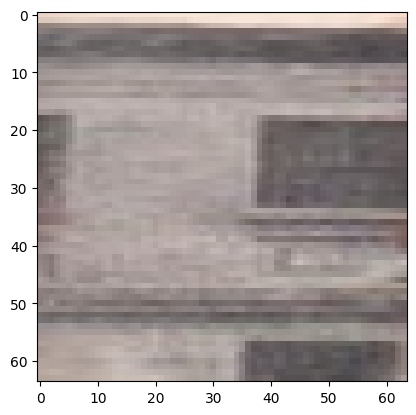

Истинный класс: House, Предсказанный класс: Window


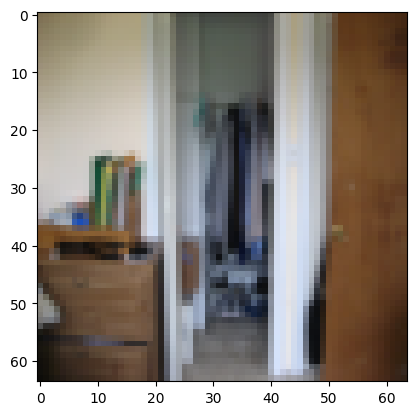

Истинный класс: Human arm, Предсказанный класс: Person


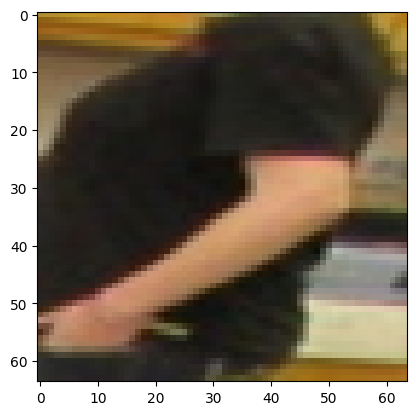

Истинный класс: Window, Предсказанный класс: Window


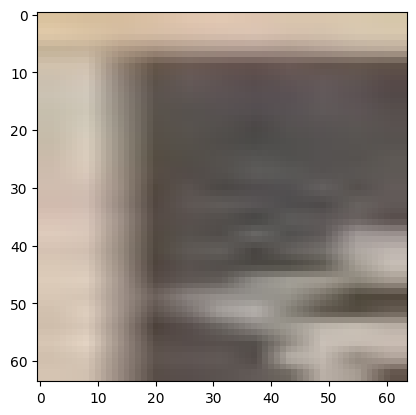

labels ---> tensor([164,  96,  32, 166])
predicted ---> tensor([ 25, 108, 108, 164])
total ---> 348
correct ---> 85
Истинный класс: Window, Предсказанный класс: Building


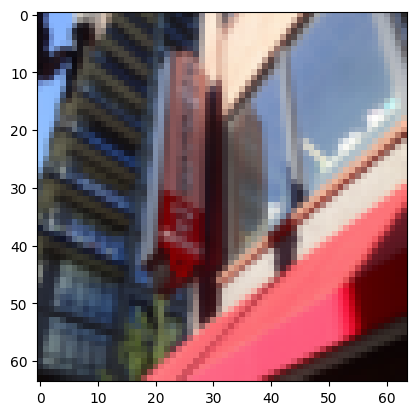

Истинный класс: Man, Предсказанный класс: Person


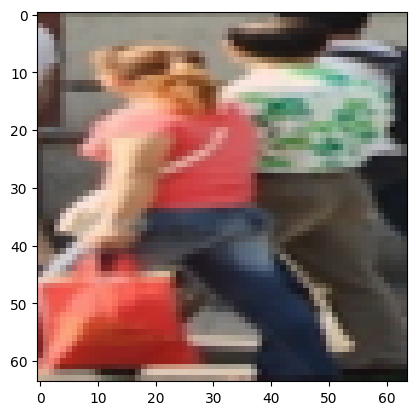

Истинный класс: Chair, Предсказанный класс: Person


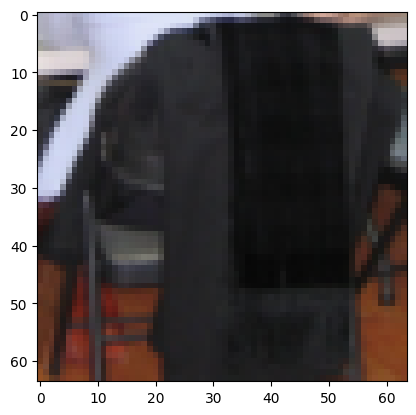

Истинный класс: Wine glass, Предсказанный класс: Window


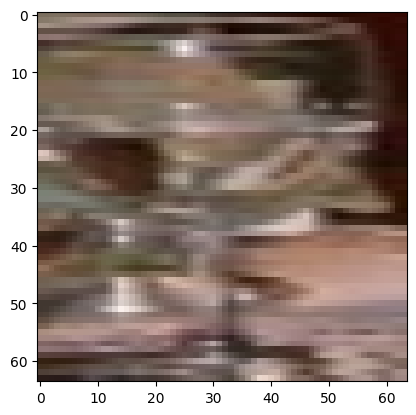

labels ---> tensor([ 63,  36, 108,  79])
predicted ---> tensor([ 76, 108,  61, 164])
total ---> 352
correct ---> 85
Истинный класс: Furniture, Предсказанный класс: Human hair


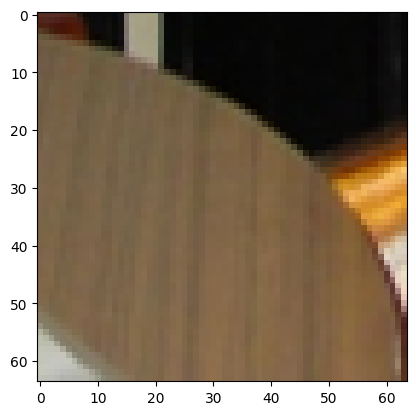

Истинный класс: Clothing, Предсказанный класс: Person


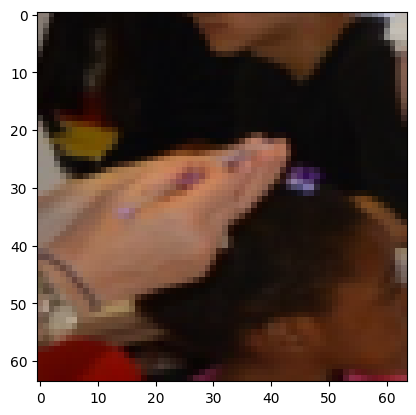

Истинный класс: Person, Предсказанный класс: Footwear


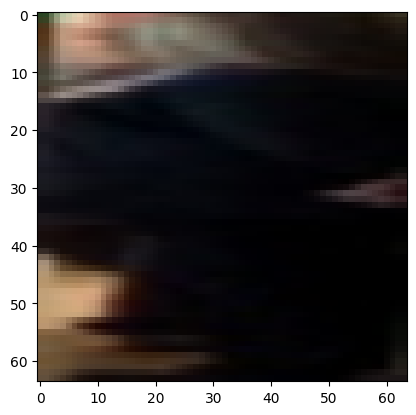

Истинный класс: Human leg, Предсказанный класс: Window


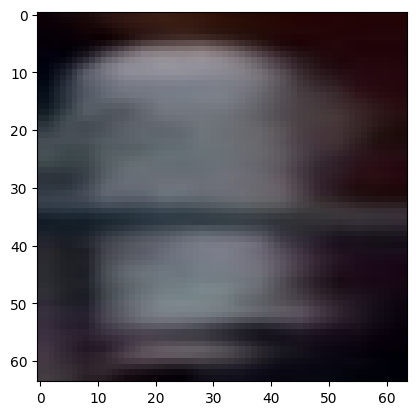

labels ---> tensor([ 25,  47, 164, 150])
predicted ---> tensor([108, 108,  69, 108])
total ---> 356
correct ---> 85
Истинный класс: Building, Предсказанный класс: Person


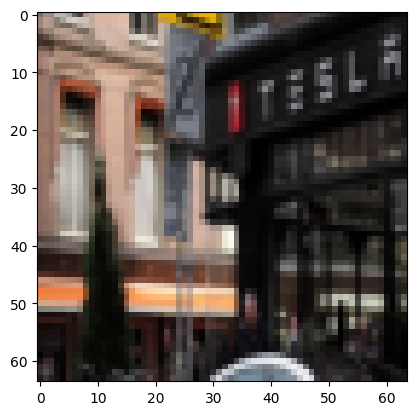

Истинный класс: Door, Предсказанный класс: Person


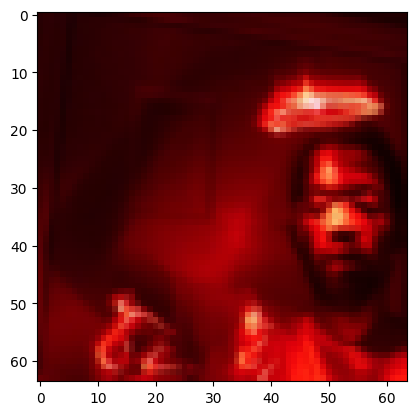

Истинный класс: Window, Предсказанный класс: House


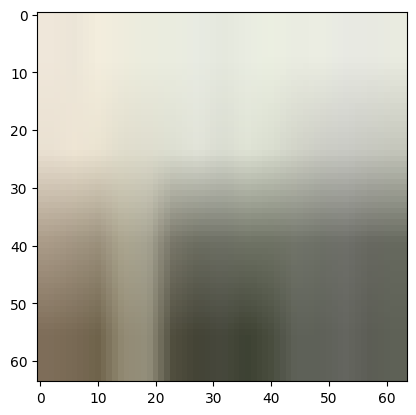

Истинный класс: Tree, Предсказанный класс: Person


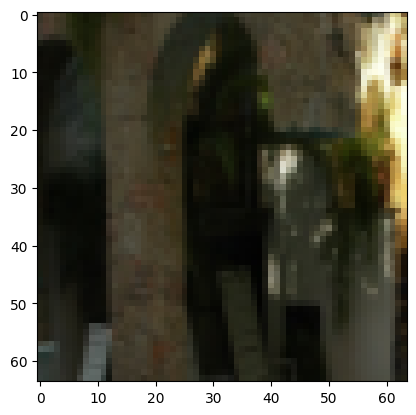

labels ---> tensor([ 25, 108, 146, 164])
predicted ---> tensor([108, 164,  25, 108])
total ---> 360
correct ---> 85
Истинный класс: Building, Предсказанный класс: Person


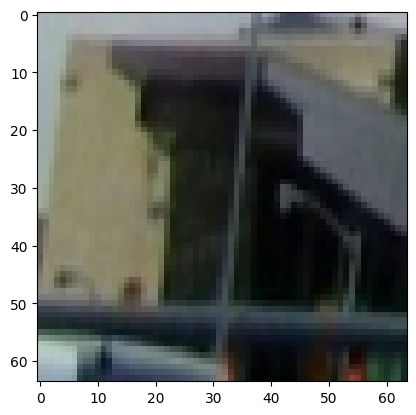

Истинный класс: Person, Предсказанный класс: Window


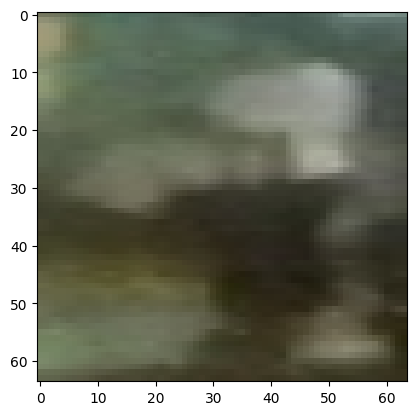

Истинный класс: Tower, Предсказанный класс: Building


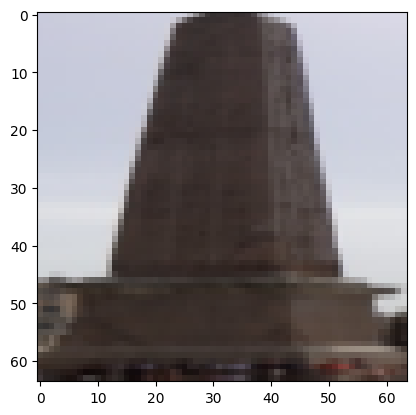

Истинный класс: Window, Предсказанный класс: Person


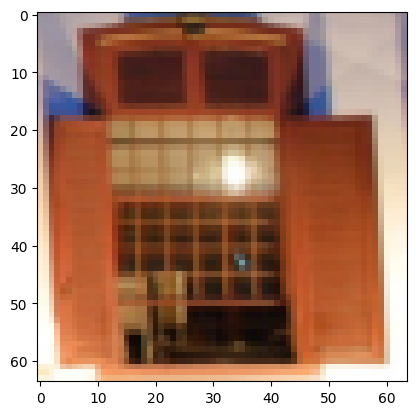

labels ---> tensor([108, 150, 164,  25])
predicted ---> tensor([ 69, 150,  25,  25])
total ---> 364
correct ---> 87
Истинный класс: Person, Предсказанный класс: House


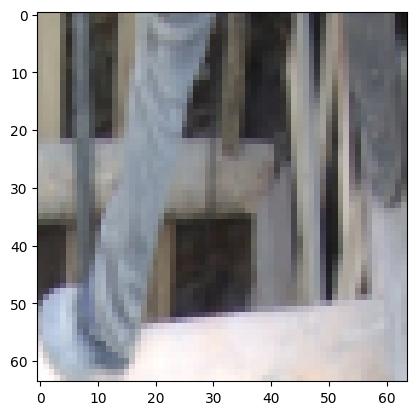

Истинный класс: Tree, Предсказанный класс: Tree


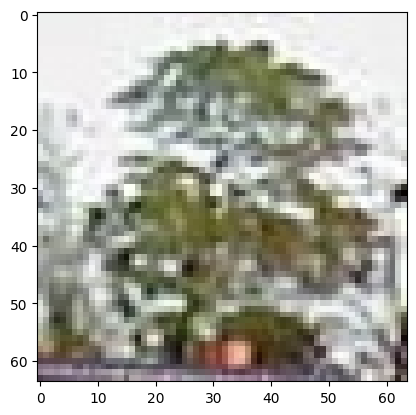

Истинный класс: Window, Предсказанный класс: Building


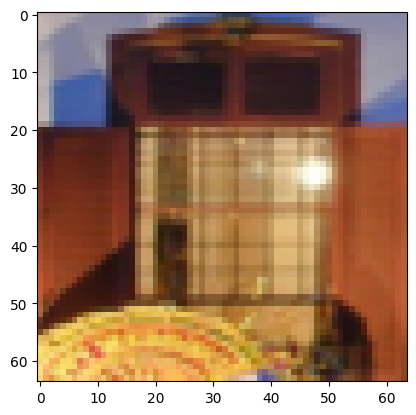

Истинный класс: Building, Предсказанный класс: Building


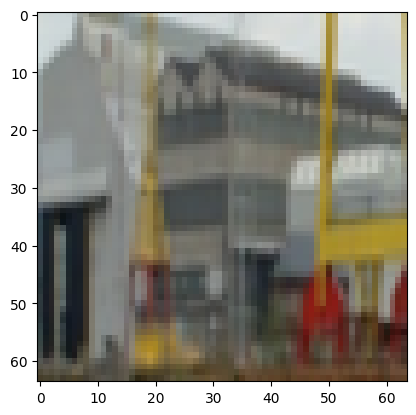

labels ---> tensor([  5,  71, 150,  36])
predicted ---> tensor([108, 164, 150, 164])
total ---> 368
correct ---> 88
Истинный класс: Barrel, Предсказанный класс: Person


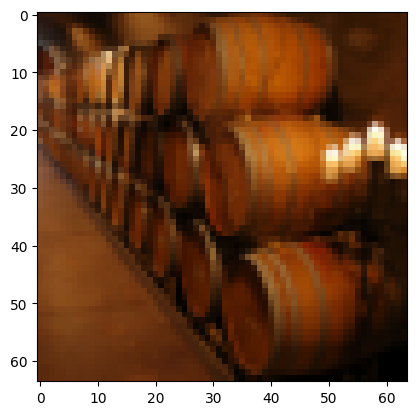

Истинный класс: Human arm, Предсказанный класс: Window


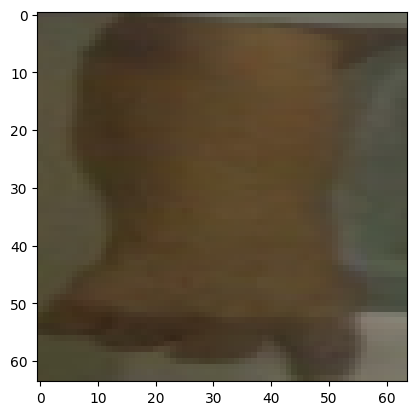

Истинный класс: Tree, Предсказанный класс: Tree


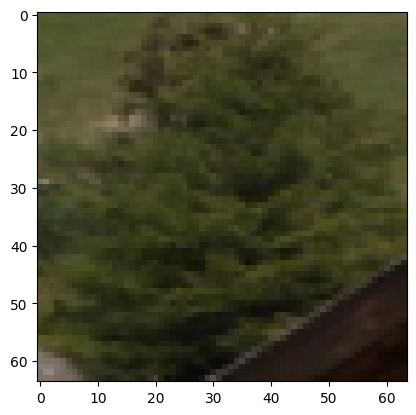

Истинный класс: Clothing, Предсказанный класс: Window


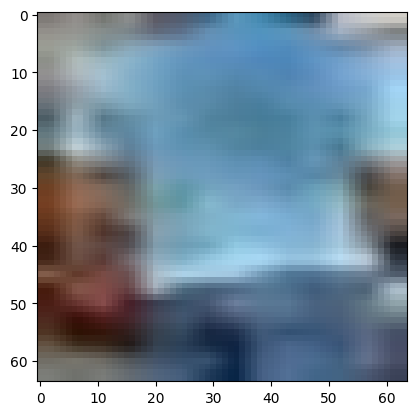

labels ---> tensor([164, 164,  17,  90])
predicted ---> tensor([164,  69, 164, 150])
total ---> 372
correct ---> 89
Истинный класс: Window, Предсказанный класс: Window


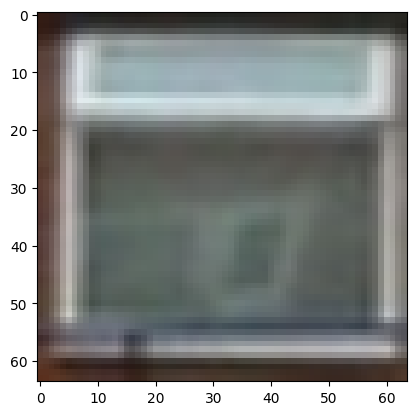

Истинный класс: Window, Предсказанный класс: House


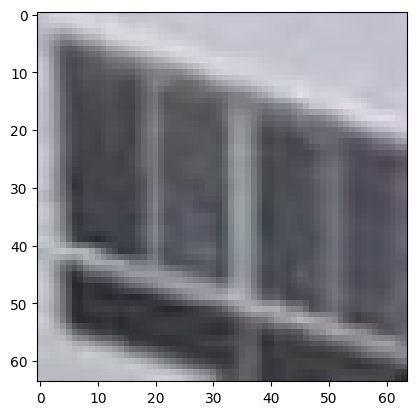

Истинный класс: Book, Предсказанный класс: Window


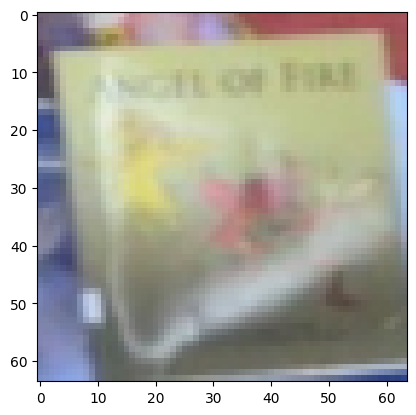

Истинный класс: Lantern, Предсказанный класс: Tree


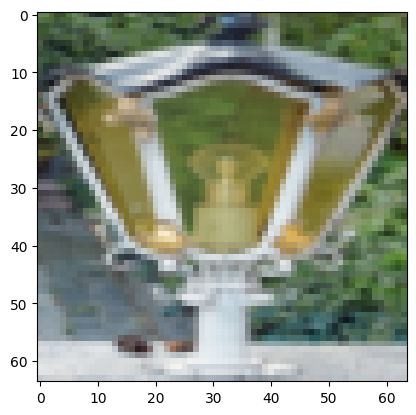

labels ---> tensor([162,  59, 164,  69])
predicted ---> tensor([ 61, 108, 164,  25])
total ---> 376
correct ---> 90
Истинный класс: Wheel, Предсказанный класс: Footwear


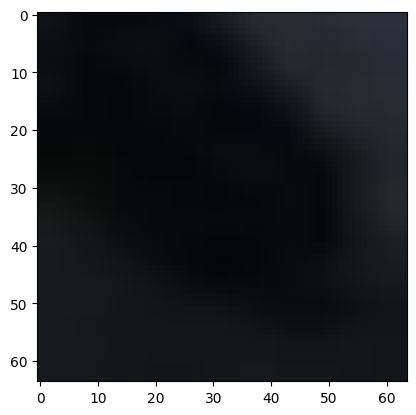

Истинный класс: Flowerpot, Предсказанный класс: Person


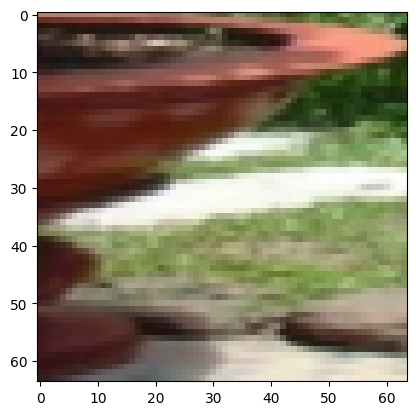

Истинный класс: Window, Предсказанный класс: Window


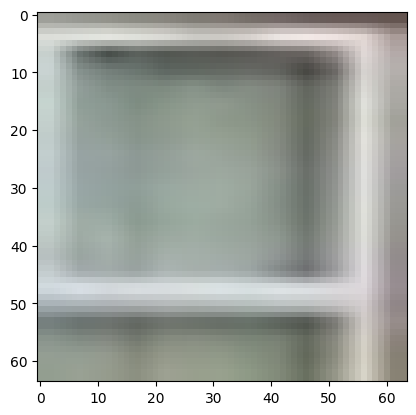

Истинный класс: House, Предсказанный класс: Building


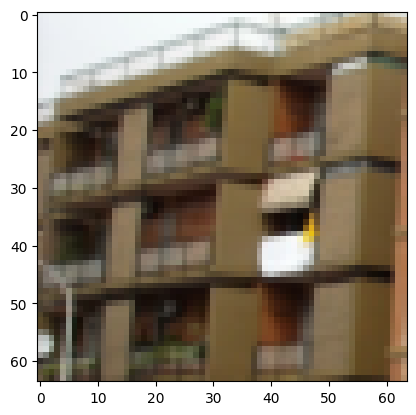

labels ---> tensor([ 77,  68, 164,  61])
predicted ---> tensor([ 77, 164, 108, 108])
total ---> 380
correct ---> 91
Истинный класс: Human hand, Предсказанный класс: Human hand


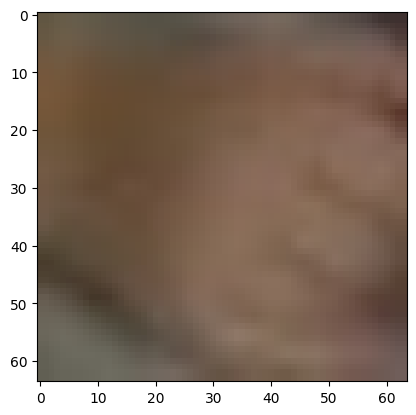

Истинный класс: Home appliance, Предсказанный класс: Window


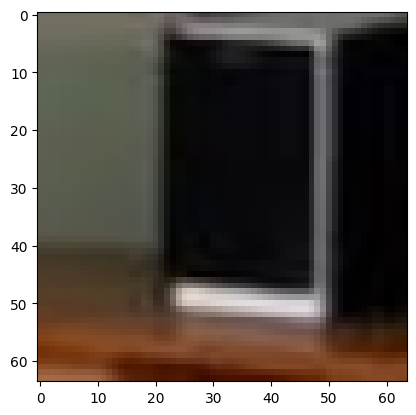

Истинный класс: Window, Предсказанный класс: Person


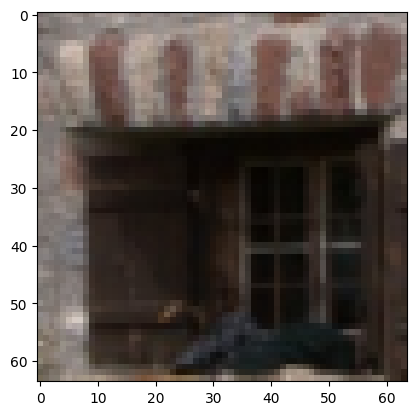

Истинный класс: Footwear, Предсказанный класс: Person


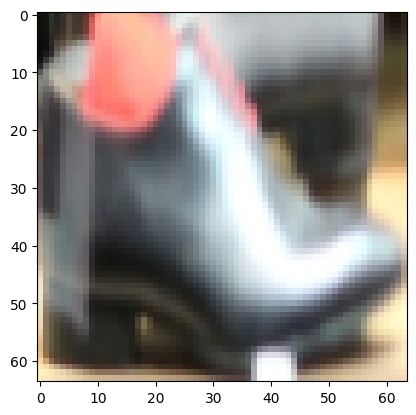

labels ---> tensor([ 32,  78, 108, 164])
predicted ---> tensor([ 25, 164, 108,  69])
total ---> 384
correct ---> 92
Истинный класс: Chair, Предсказанный класс: Building


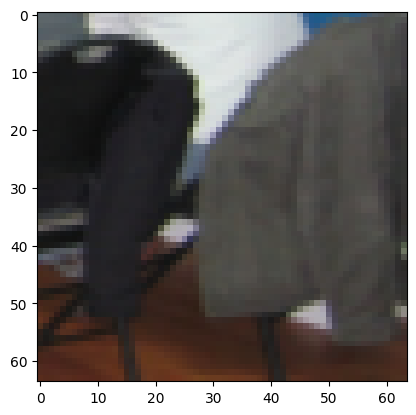

Истинный класс: Human head, Предсказанный класс: Window


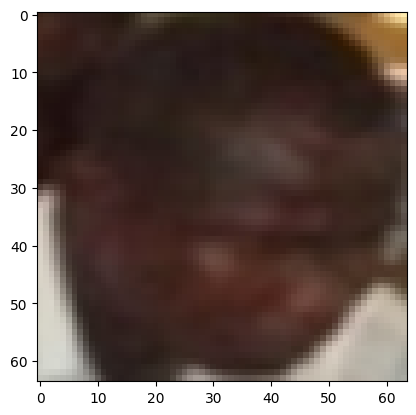

Истинный класс: Person, Предсказанный класс: Person


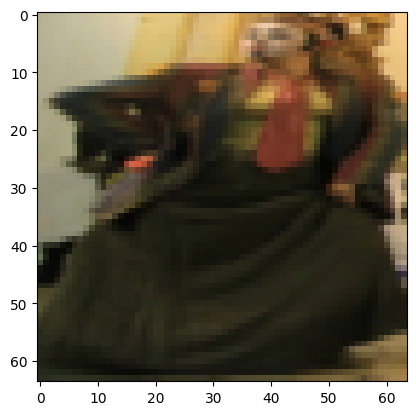

Истинный класс: Window, Предсказанный класс: House


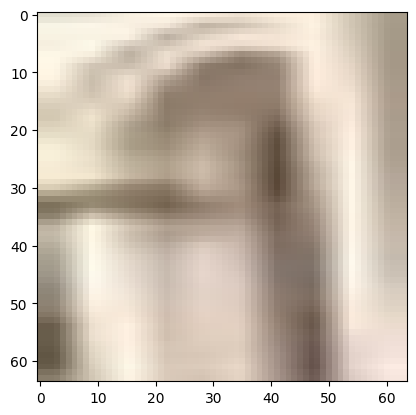

labels ---> tensor([ 78, 119,  69,  25])
predicted ---> tensor([ 76,  25,  25, 108])
total ---> 388
correct ---> 92
Истинный класс: Human head, Предсказанный класс: Human hair


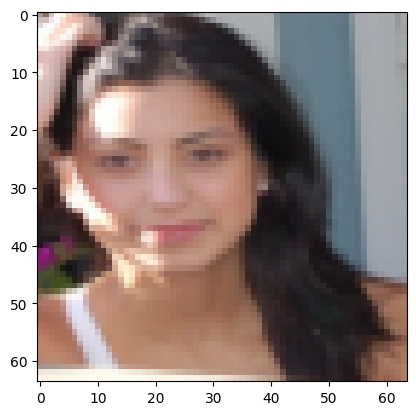

Истинный класс: Shelf, Предсказанный класс: Building


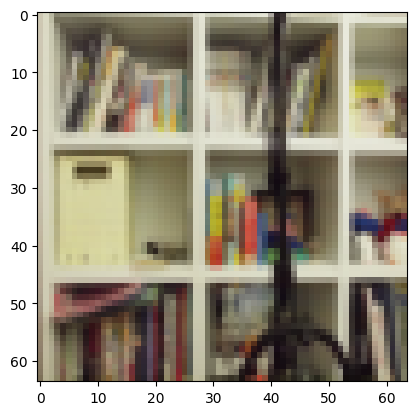

Истинный класс: House, Предсказанный класс: Building


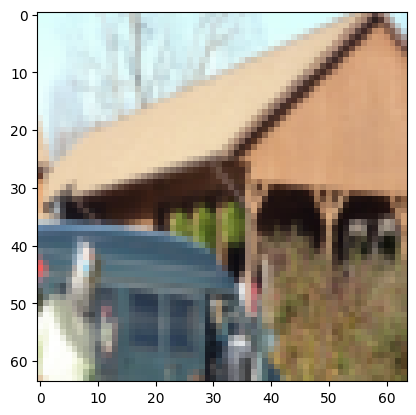

Истинный класс: Building, Предсказанный класс: Person


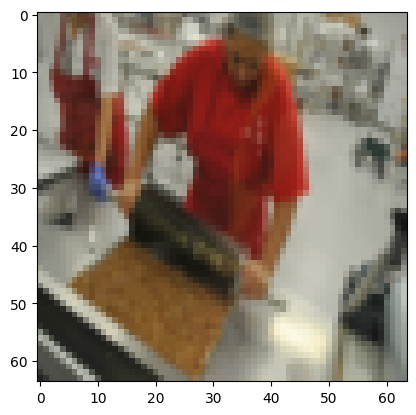

labels ---> tensor([ 29,  39, 164, 164])
predicted ---> tensor([108, 108, 108, 164])
total ---> 392
correct ---> 93
Истинный класс: Car, Предсказанный класс: Person


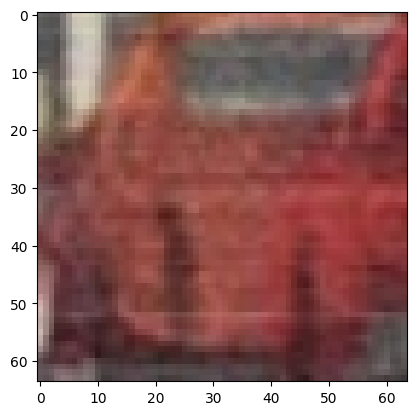

Истинный класс: Computer monitor, Предсказанный класс: Person


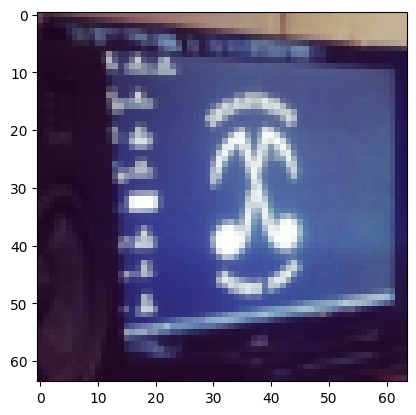

Истинный класс: Window, Предсказанный класс: Person


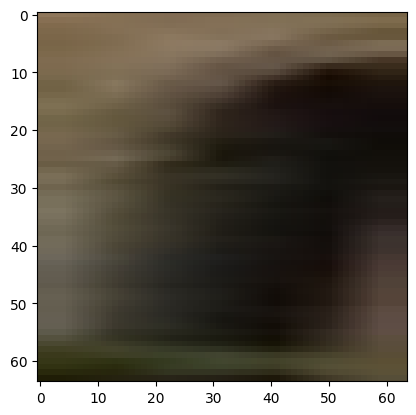

Истинный класс: Window, Предсказанный класс: Window


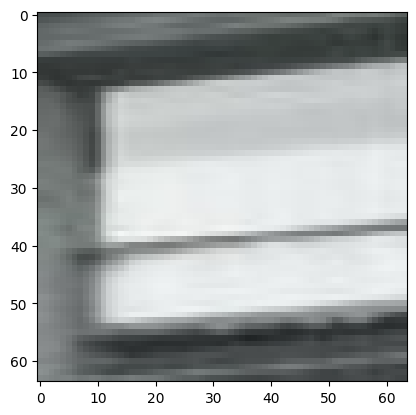

labels ---> tensor([164,  71,  32,  36])
predicted ---> tensor([164, 164,  61, 164])
total ---> 396
correct ---> 94
Истинный класс: Window, Предсказанный класс: Window


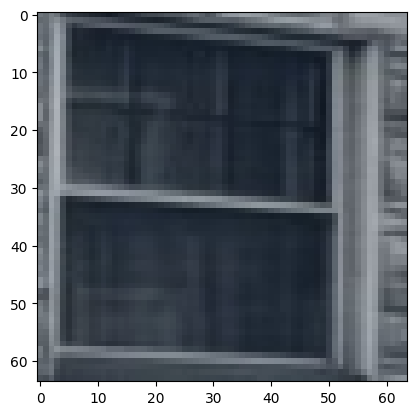

Истинный класс: Human arm, Предсказанный класс: Window


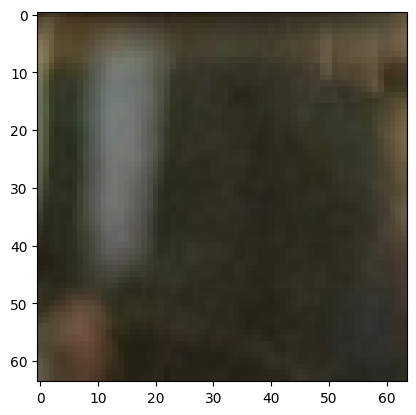

Истинный класс: Chair, Предсказанный класс: Footwear


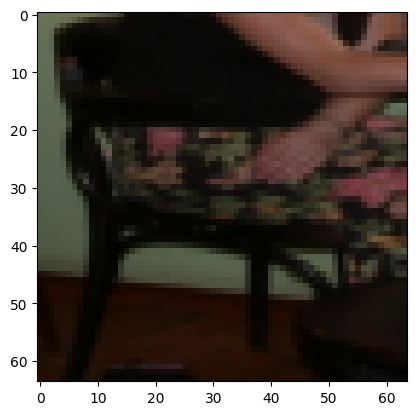

Истинный класс: Clothing, Предсказанный класс: Window


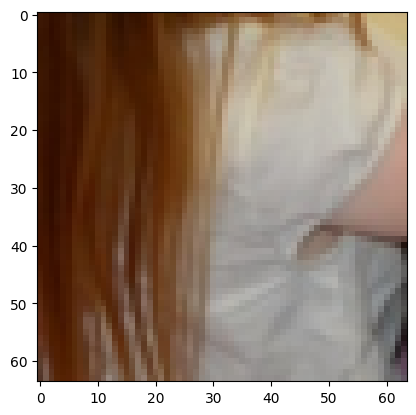

labels ---> tensor([108,  79,  61,  71])
predicted ---> tensor([164, 164, 164, 108])
total ---> 400
correct ---> 94
Истинный класс: Person, Предсказанный класс: Window


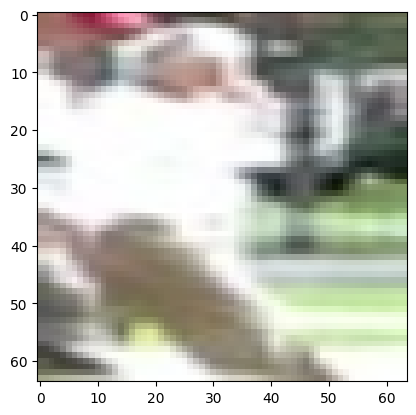

Истинный класс: Human leg, Предсказанный класс: Window


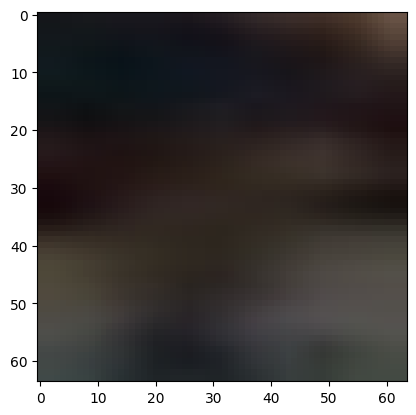

Истинный класс: Footwear, Предсказанный класс: Window


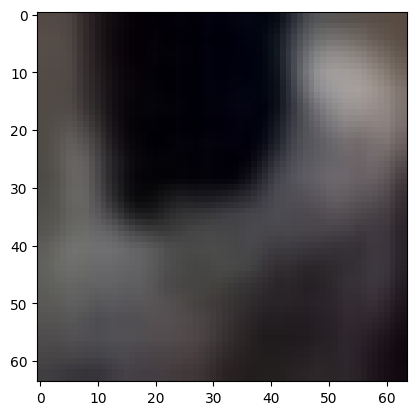

Истинный класс: Human arm, Предсказанный класс: Person


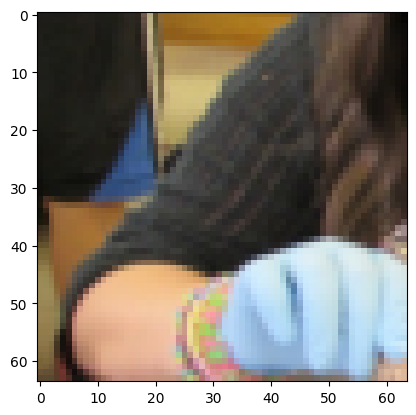

labels ---> tensor([ 96, 141,  25,  25])
predicted ---> tensor([108,  61, 150, 108])
total ---> 404
correct ---> 94
Истинный класс: Man, Предсказанный класс: Person


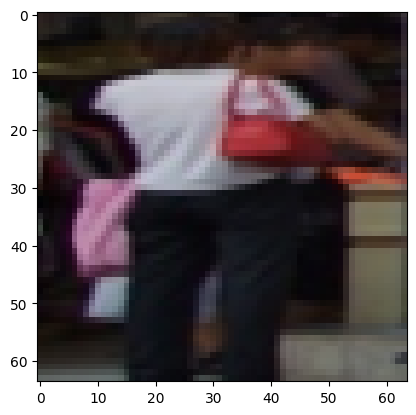

Истинный класс: Television, Предсказанный класс: Footwear


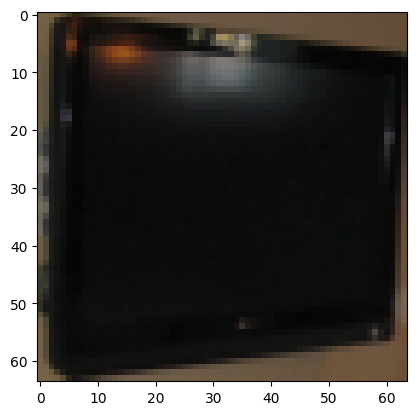

Истинный класс: Building, Предсказанный класс: Tree


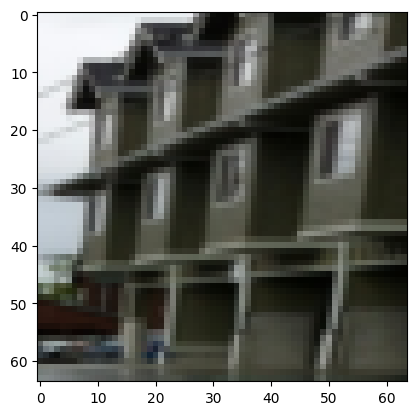

Истинный класс: Building, Предсказанный класс: Person


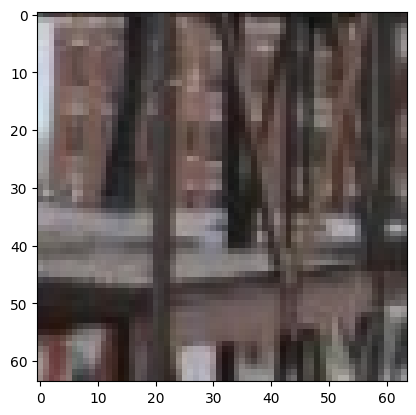

labels ---> tensor([72, 69, 69, 36])
predicted ---> tensor([164, 164,  69,  61])
total ---> 408
correct ---> 95
Истинный класс: Human body, Предсказанный класс: Window


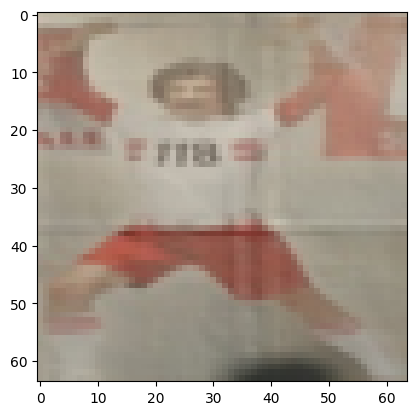

Истинный класс: House, Предсказанный класс: Window


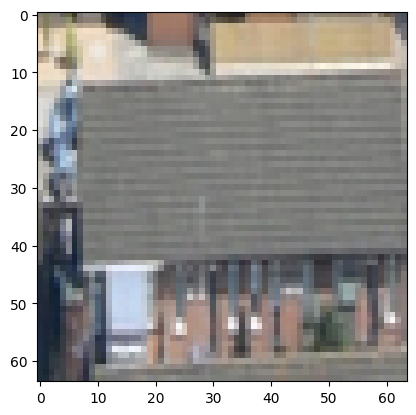

Истинный класс: House, Предсказанный класс: House


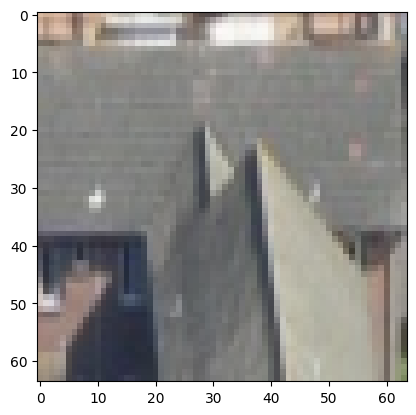

Истинный класс: Clothing, Предсказанный класс: Footwear


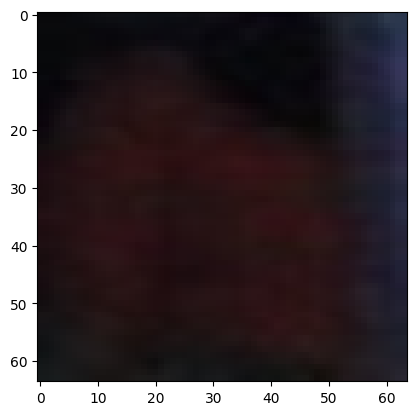

labels ---> tensor([92, 95, 92, 29])
predicted ---> tensor([ 92,  61,  92, 164])
total ---> 412
correct ---> 97
Истинный класс: Light bulb, Предсказанный класс: Light bulb


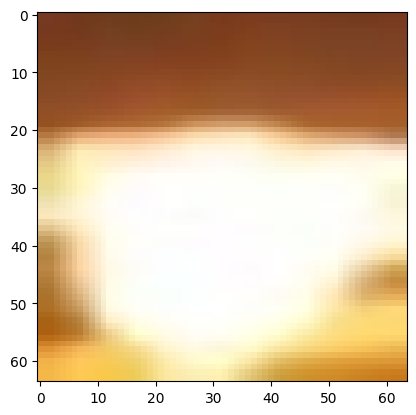

Истинный класс: Mammal, Предсказанный класс: Footwear


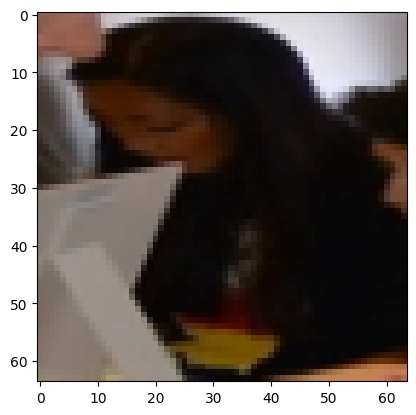

Истинный класс: Light bulb, Предсказанный класс: Light bulb


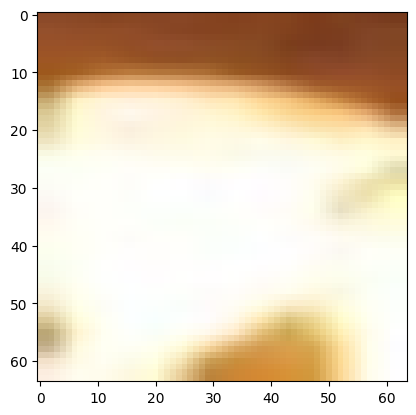

Истинный класс: Car, Предсказанный класс: Window


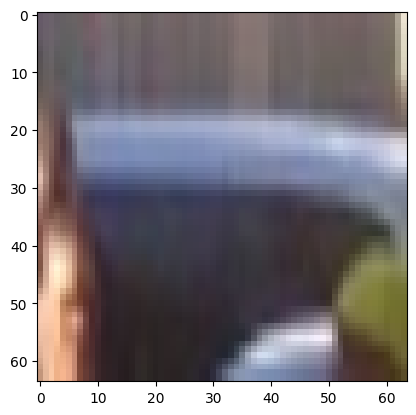

labels ---> tensor([164, 150, 136,  78])
predicted ---> tensor([ 25, 150, 108,  76])
total ---> 416
correct ---> 98
Истинный класс: Window, Предсказанный класс: Building


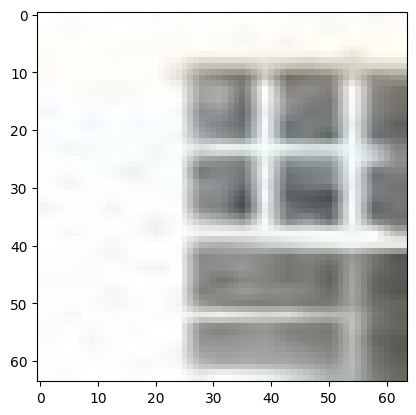

Истинный класс: Tree, Предсказанный класс: Tree


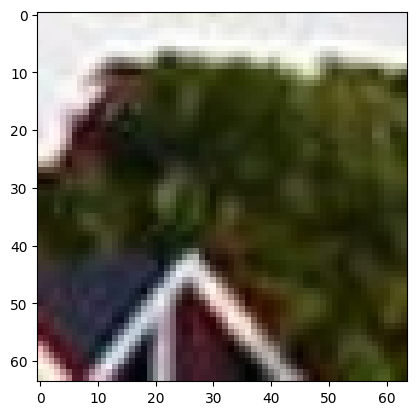

Истинный класс: Table, Предсказанный класс: Person


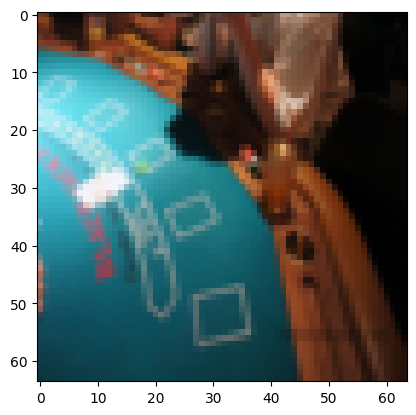

Истинный класс: Human head, Предсказанный класс: Human hair


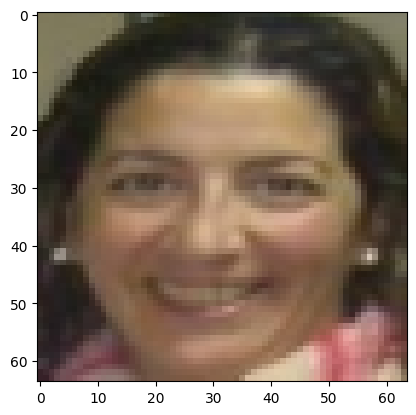

labels ---> tensor([150, 164,  66,  25])
predicted ---> tensor([150, 164, 164, 164])
total ---> 420
correct ---> 100
Истинный класс: Tree, Предсказанный класс: Tree


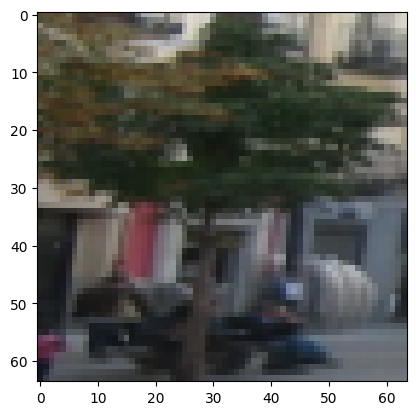

Истинный класс: Window, Предсказанный класс: Window


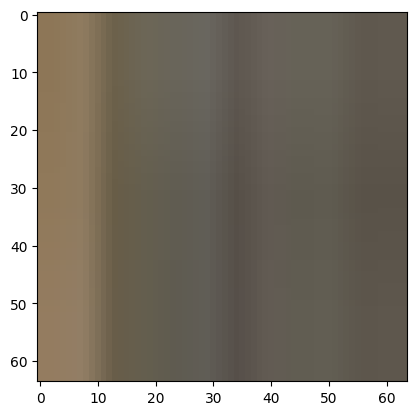

Истинный класс: Glasses, Предсказанный класс: Window


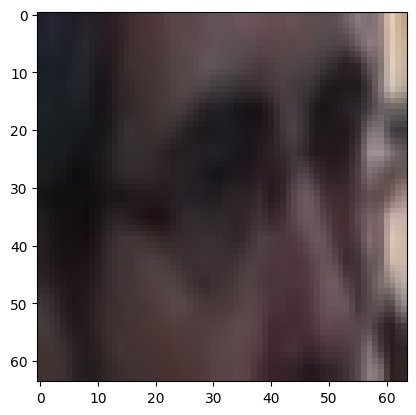

Истинный класс: Building, Предсказанный класс: Window


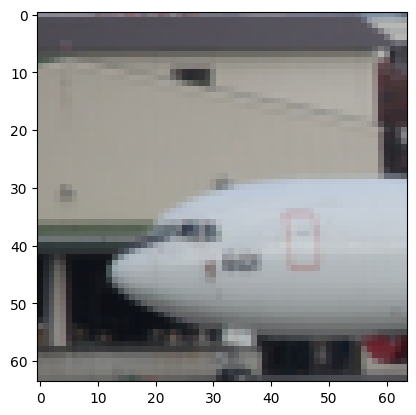

labels ---> tensor([ 95, 164,  27,  71])
predicted ---> tensor([108, 164,  63, 108])
total ---> 424
correct ---> 101
Истинный класс: Mammal, Предсказанный класс: Person


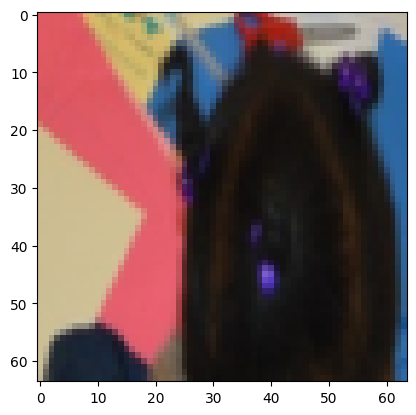

Истинный класс: Window, Предсказанный класс: Window


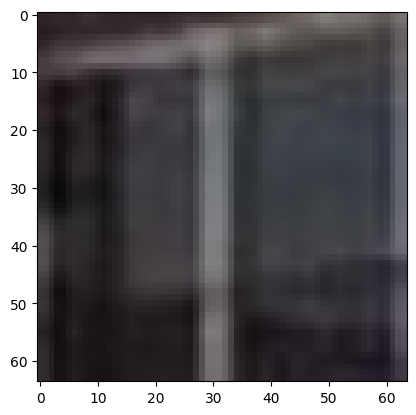

Истинный класс: Cabinetry, Предсказанный класс: Furniture


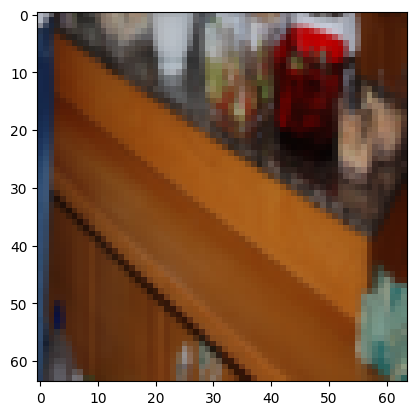

Истинный класс: Human arm, Предсказанный класс: Person


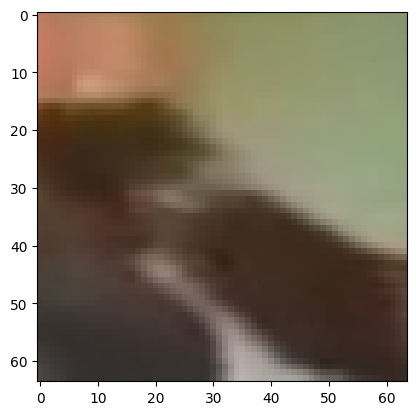

labels ---> tensor([ 61,  61,  92, 164])
predicted ---> tensor([ 78, 164,  92,  69])
total ---> 428
correct ---> 102
Истинный класс: Footwear, Предсказанный класс: Human head


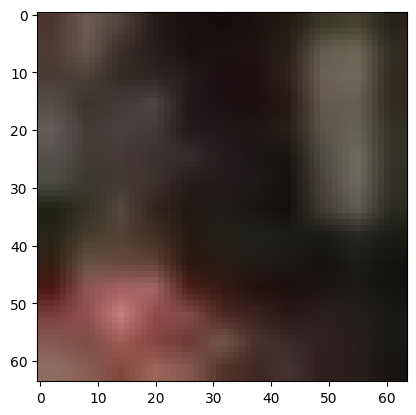

Истинный класс: Footwear, Предсказанный класс: Window


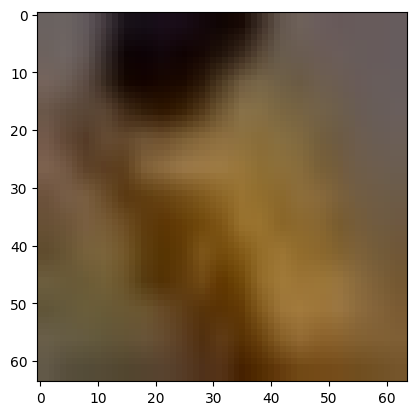

Истинный класс: Light bulb, Предсказанный класс: Light bulb


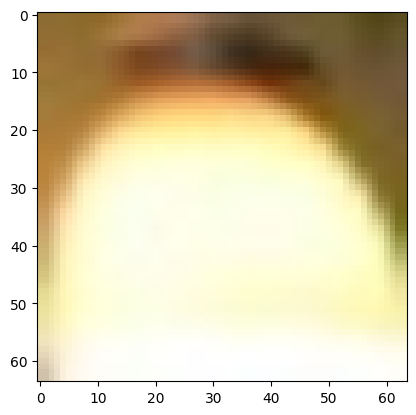

Истинный класс: Window, Предсказанный класс: House


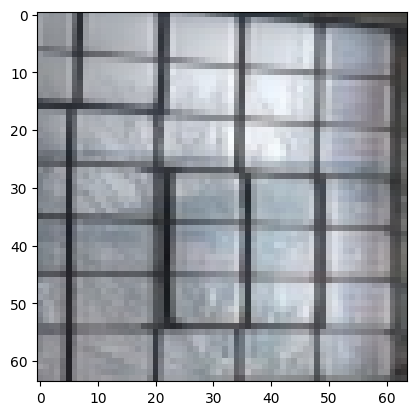

labels ---> tensor([ 63, 128,  65,  95])
predicted ---> tensor([108, 108, 108, 108])
total ---> 432
correct ---> 102
Истинный класс: Furniture, Предсказанный класс: Person


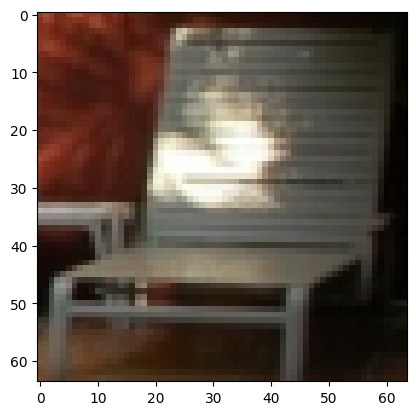

Истинный класс: Sports equipment, Предсказанный класс: Person


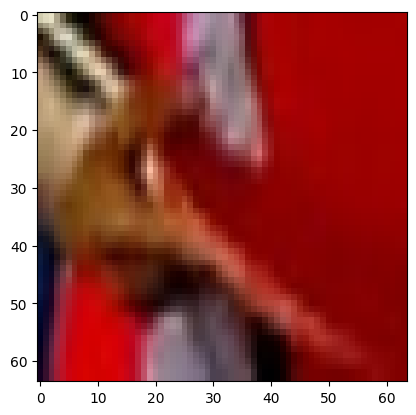

Истинный класс: Girl, Предсказанный класс: Person


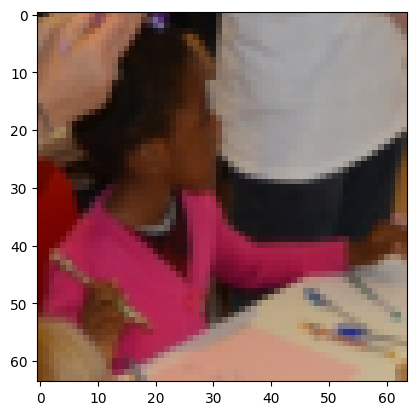

Истинный класс: Mammal, Предсказанный класс: Person


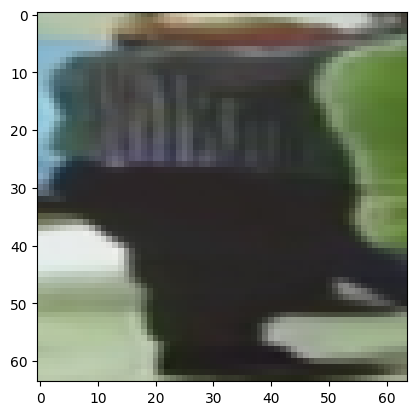

labels ---> tensor([157,  25,  47,  83])
predicted ---> tensor([108,  69, 164, 108])
total ---> 436
correct ---> 102
Истинный класс: Vehicle registration plate, Предсказанный класс: Person


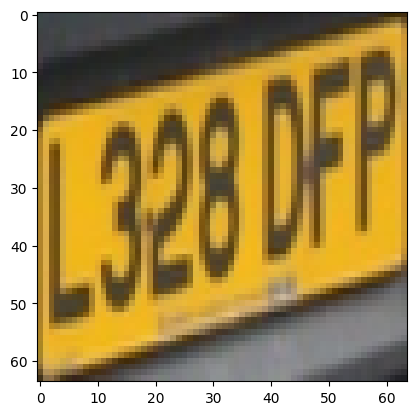

Истинный класс: Building, Предсказанный класс: House


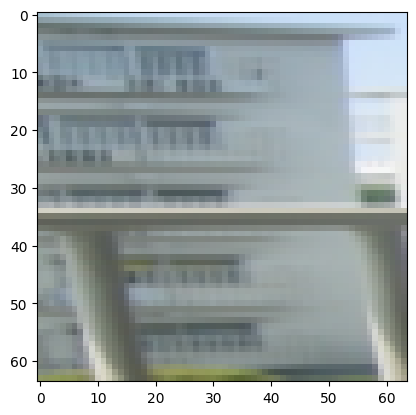

Истинный класс: Door, Предсказанный класс: Window


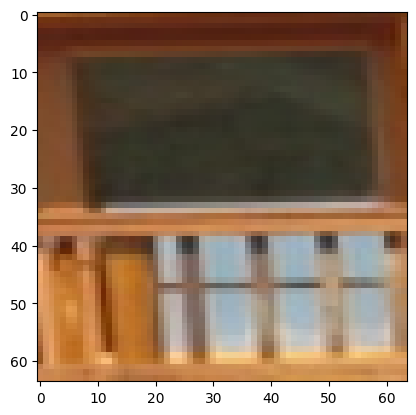

Истинный класс: Jeans, Предсказанный класс: Person


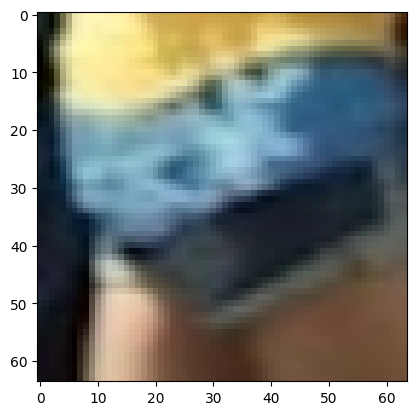

labels ---> tensor([ 78,  36, 164, 164])
predicted ---> tensor([ 76, 108, 164, 164])
total ---> 440
correct ---> 104
Истинный класс: Human head, Предсказанный класс: Human hair


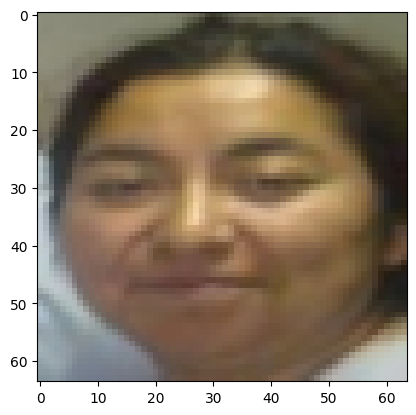

Истинный класс: Clothing, Предсказанный класс: Person


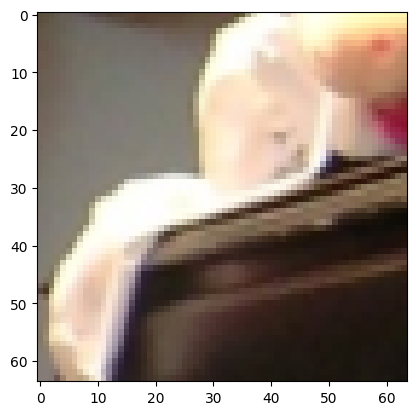

Истинный класс: Window, Предсказанный класс: Window


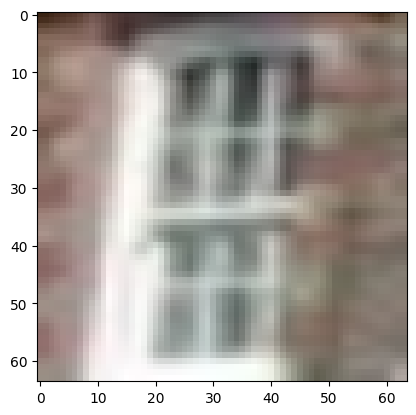

Истинный класс: Window, Предсказанный класс: Window


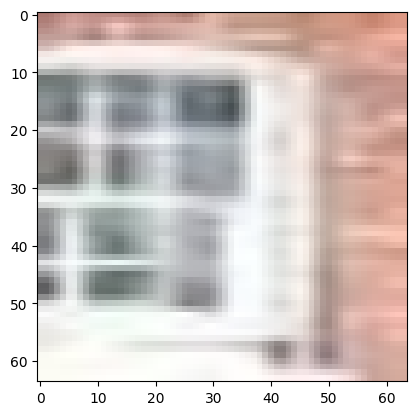

labels ---> tensor([95, 32, 96, 29])
predicted ---> tensor([108, 164, 164, 164])
total ---> 444
correct ---> 104
Истинный класс: Mammal, Предсказанный класс: Person


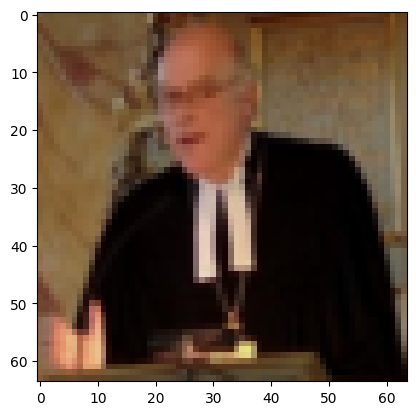

Истинный класс: Chair, Предсказанный класс: Window


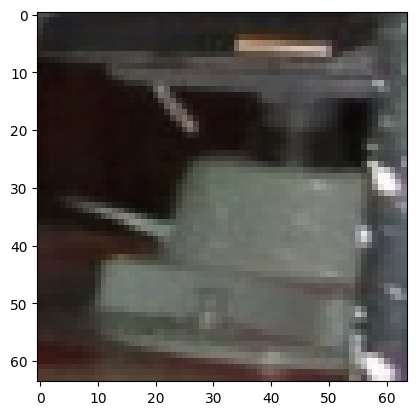

Истинный класс: Man, Предсказанный класс: Window


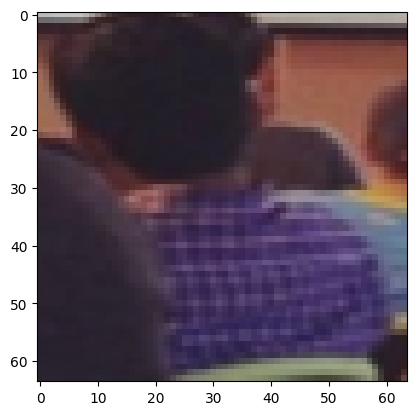

Истинный класс: Car, Предсказанный класс: Window


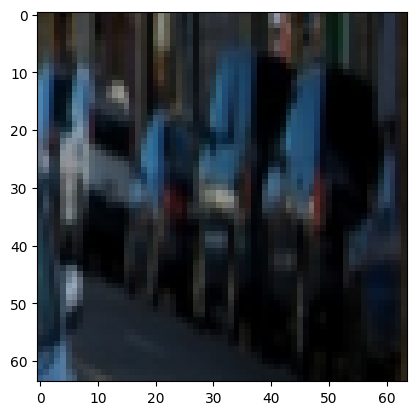

labels ---> tensor([61, 72, 89, 36])
predicted ---> tensor([164, 164, 164, 108])
total ---> 448
correct ---> 104
Истинный класс: Footwear, Предсказанный класс: Window


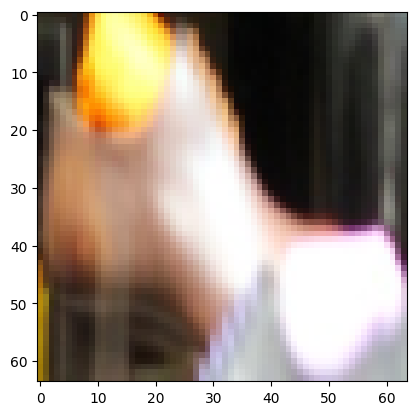

Истинный класс: Human body, Предсказанный класс: Window


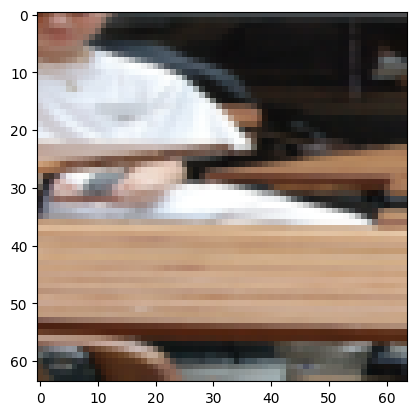

Истинный класс: Land vehicle, Предсказанный класс: Window


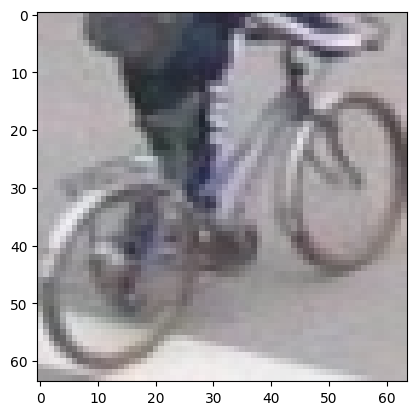

Истинный класс: Clothing, Предсказанный класс: Person


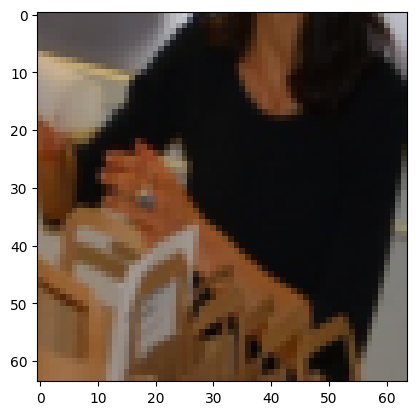

labels ---> tensor([ 58,  78, 164,   4])
predicted ---> tensor([108,  76, 164, 108])
total ---> 452
correct ---> 105
Истинный класс: Flower, Предсказанный класс: Person


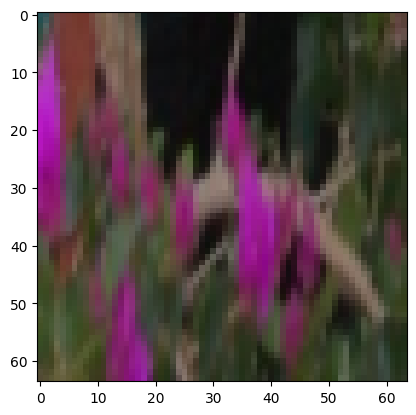

Истинный класс: Human head, Предсказанный класс: Human hair


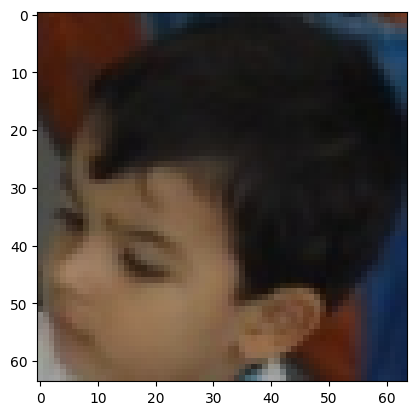

Истинный класс: Window, Предсказанный класс: Window


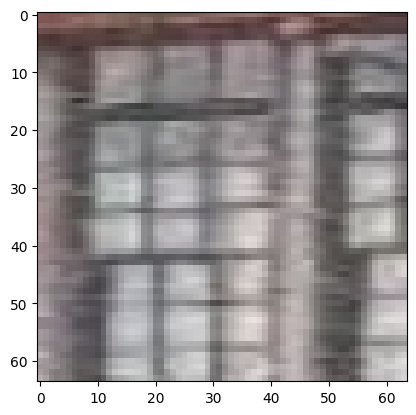

Истинный класс: Ball, Предсказанный класс: Person


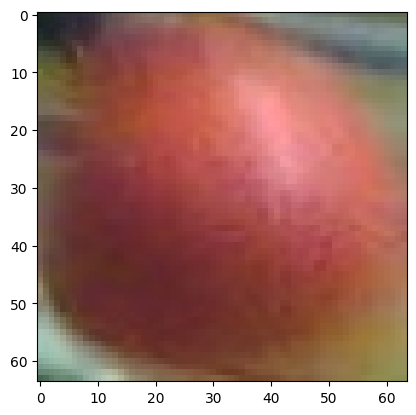

labels ---> tensor([ 36, 164,  25,  53])
predicted ---> tensor([164,  77, 108, 164])
total ---> 456
correct ---> 105
Истинный класс: Clothing, Предсказанный класс: Window


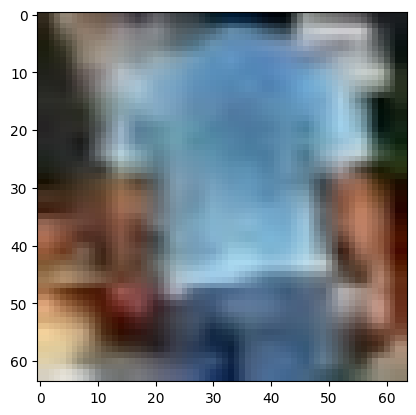

Истинный класс: Window, Предсказанный класс: Human hand


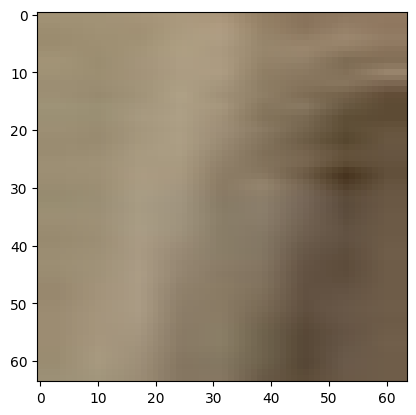

Истинный класс: Building, Предсказанный класс: Person


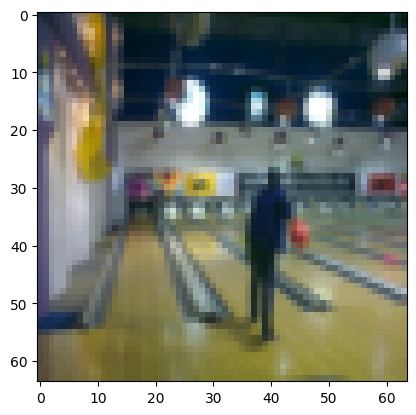

Истинный класс: Fashion accessory, Предсказанный класс: Window


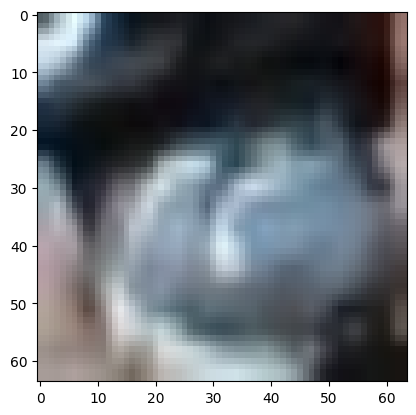

labels ---> tensor([ 25, 164, 150,  96])
predicted ---> tensor([164, 164,  25, 164])
total ---> 460
correct ---> 106
Истинный класс: Building, Предсказанный класс: Window


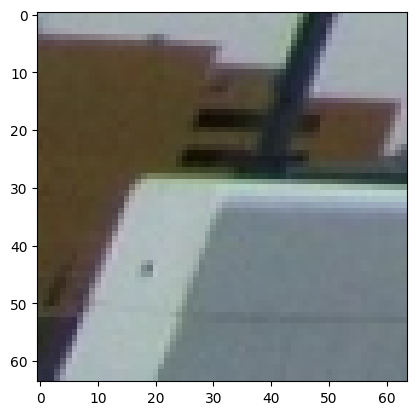

Истинный класс: Window, Предсказанный класс: Window


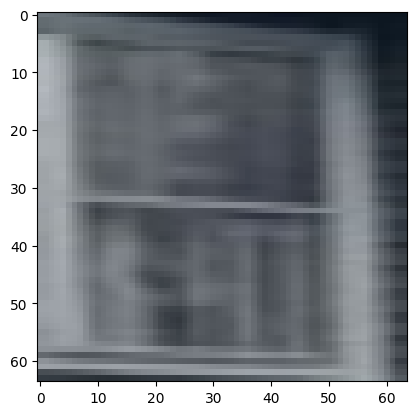

Истинный класс: Tree, Предсказанный класс: Building


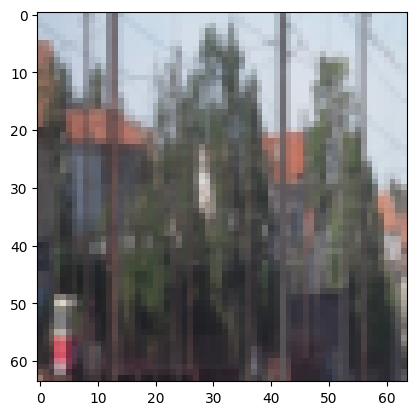

Истинный класс: Man, Предсказанный класс: Window


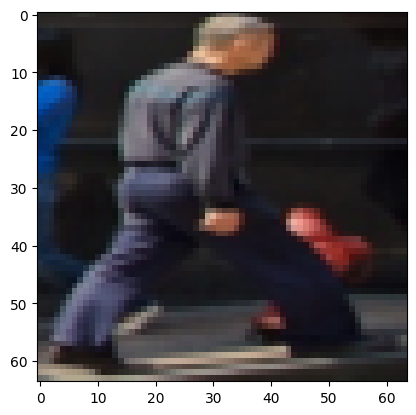

labels ---> tensor([138,  25, 164, 168])
predicted ---> tensor([164,  25, 164, 164])
total ---> 464
correct ---> 108
Истинный класс: Tableware, Предсказанный класс: Window


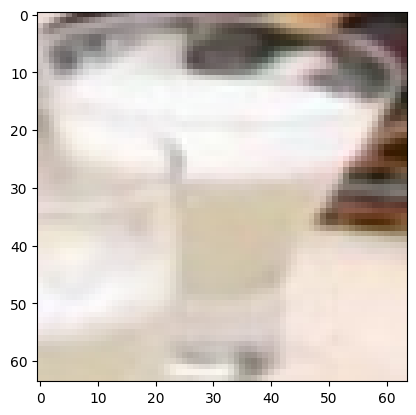

Истинный класс: Building, Предсказанный класс: Building


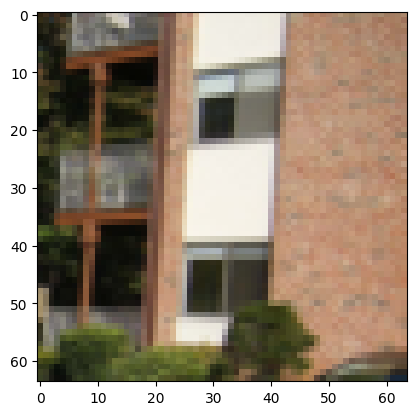

Истинный класс: Window, Предсказанный класс: Window


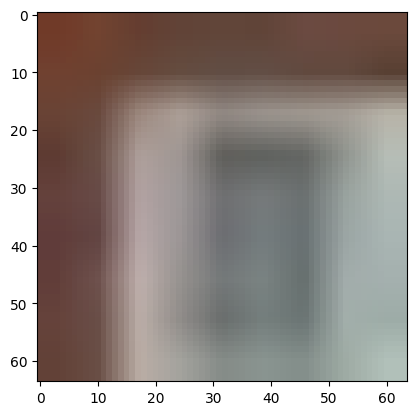

Истинный класс: Woman, Предсказанный класс: Window


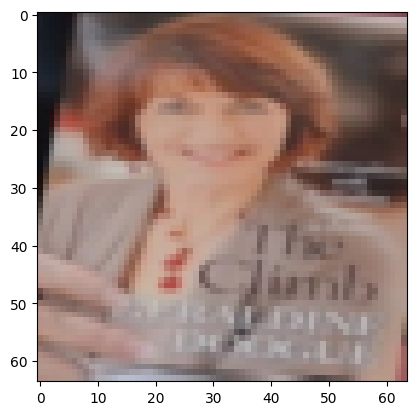

labels ---> tensor([45, 63, 69, 61])
predicted ---> tensor([ 78, 164,  25, 108])
total ---> 468
correct ---> 108
Истинный класс: Desk, Предсказанный класс: Human head


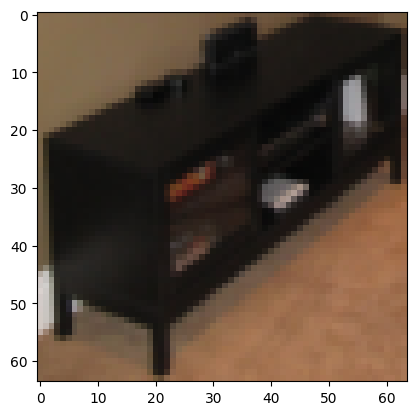

Истинный класс: Furniture, Предсказанный класс: Window


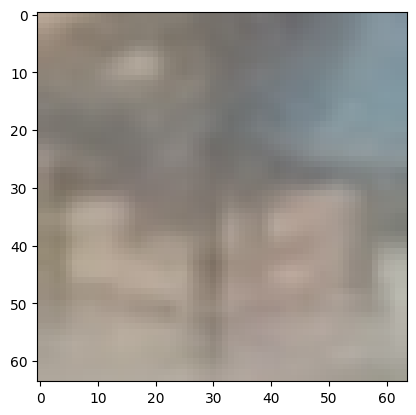

Истинный класс: House, Предсказанный класс: Building


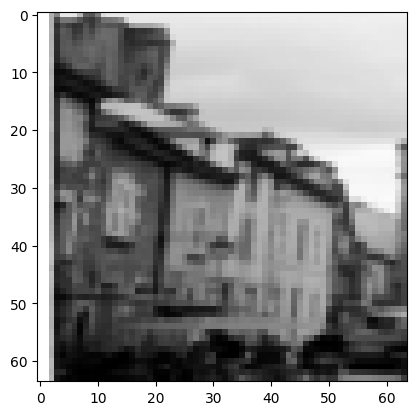

Истинный класс: Footwear, Предсказанный класс: Person


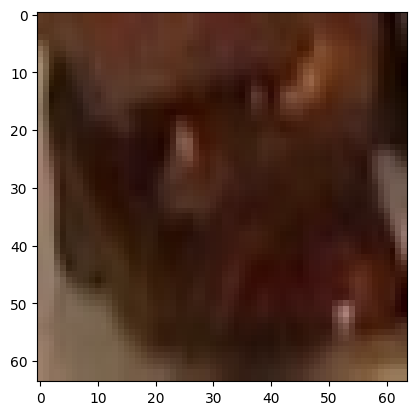

labels ---> tensor([150, 108, 108,  86])
predicted ---> tensor([164, 108, 108, 164])
total ---> 472
correct ---> 110
Истинный класс: Tree, Предсказанный класс: Window


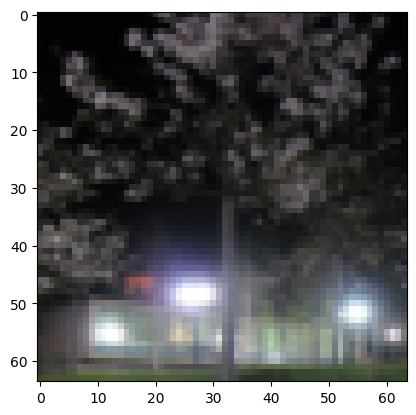

Истинный класс: Person, Предсказанный класс: Person


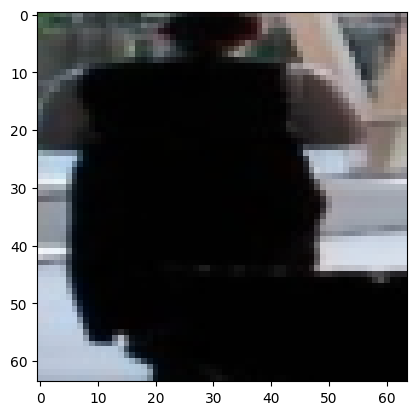

Истинный класс: Person, Предсказанный класс: Person


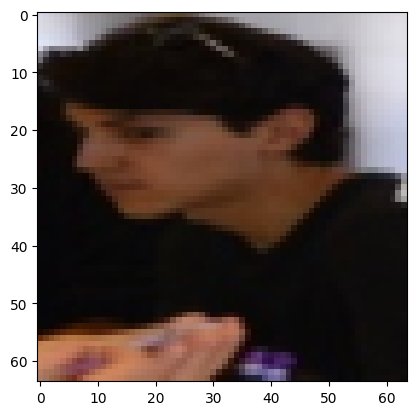

Истинный класс: Kitchen appliance, Предсказанный класс: Window


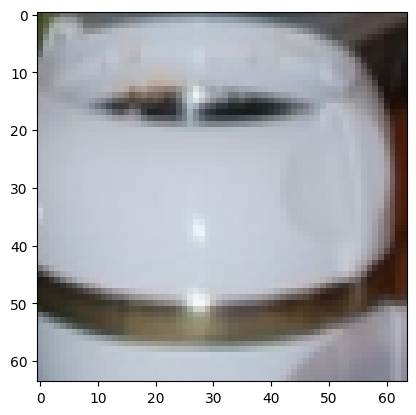

labels ---> tensor([164,  36, 136, 134])
predicted ---> tensor([164,  69,  61, 164])
total ---> 476
correct ---> 111
Истинный класс: Window, Предсказанный класс: Window


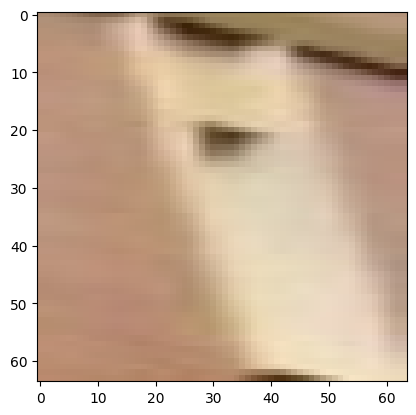

Истинный класс: Clothing, Предсказанный класс: House


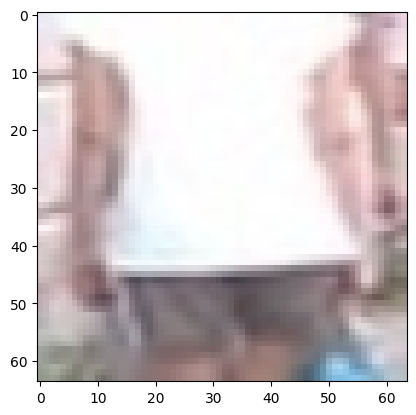

Истинный класс: Table, Предсказанный класс: Footwear


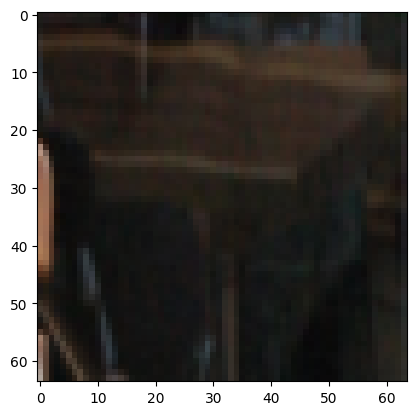

Истинный класс: Suit, Предсказанный класс: Window


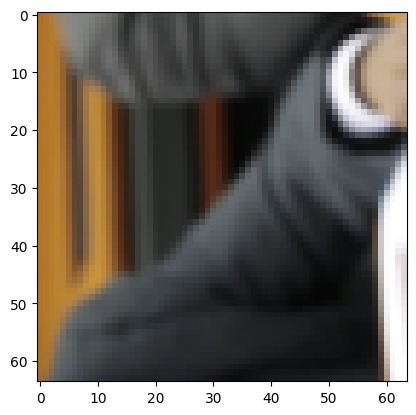

labels ---> tensor([125, 108, 164, 164])
predicted ---> tensor([ 25, 164, 164, 164])
total ---> 480
correct ---> 113
Истинный класс: Skyscraper, Предсказанный класс: Building


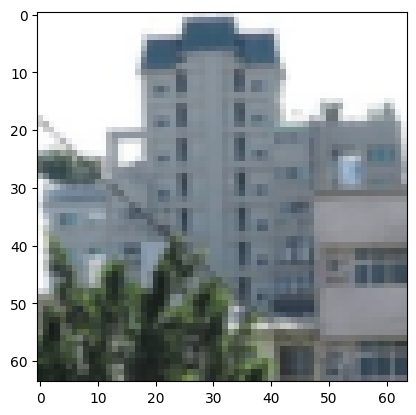

Истинный класс: Person, Предсказанный класс: Window


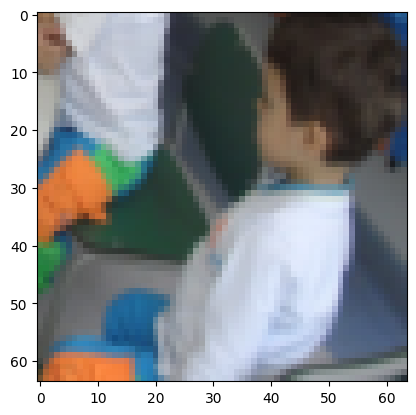

Истинный класс: Window, Предсказанный класс: Window


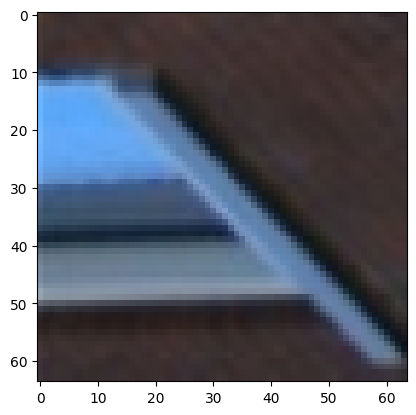

Истинный класс: Window, Предсказанный класс: Window


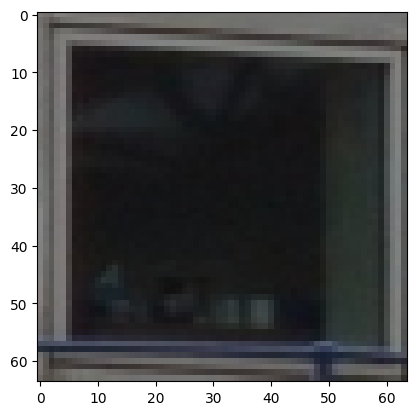

labels ---> tensor([164,  61, 164, 105])
predicted ---> tensor([164, 164, 164,  69])
total ---> 484
correct ---> 115
Истинный класс: Window, Предсказанный класс: Window


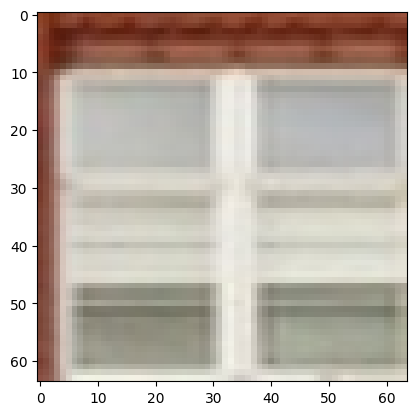

Истинный класс: Footwear, Предсказанный класс: Window


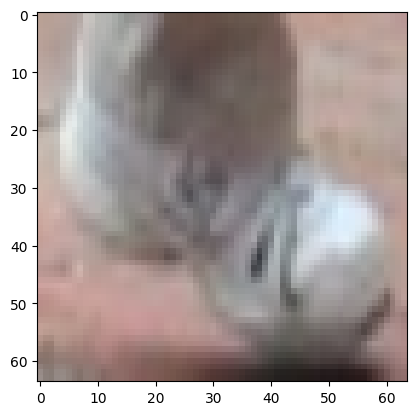

Истинный класс: Window, Предсказанный класс: Window


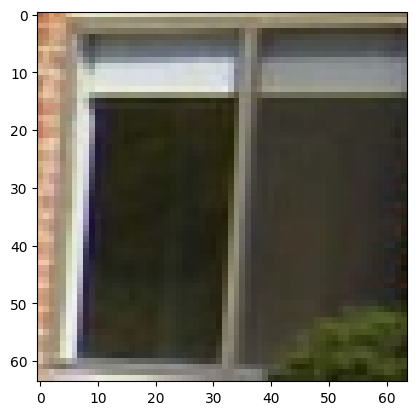

Истинный класс: Office supplies, Предсказанный класс: House


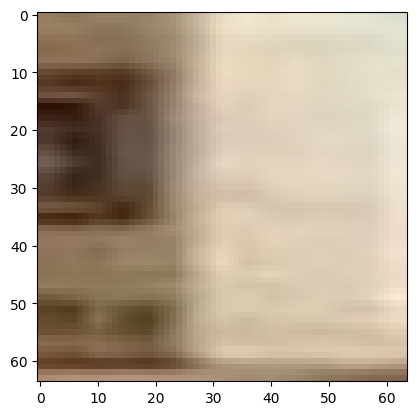

labels ---> tensor([162,  61, 136, 164])
predicted ---> tensor([164, 164, 108, 164])
total ---> 488
correct ---> 116
Истинный класс: Wheel, Предсказанный класс: Window


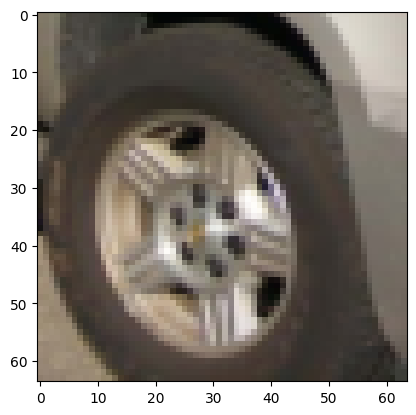

Истинный класс: Footwear, Предсказанный класс: Window


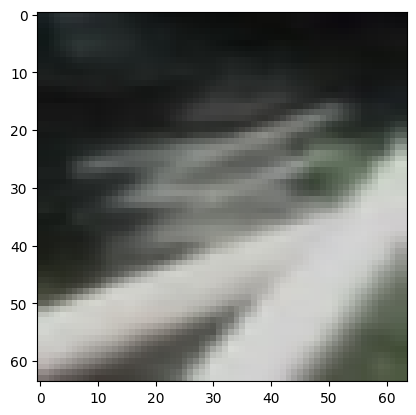

Истинный класс: Table, Предсказанный класс: Person


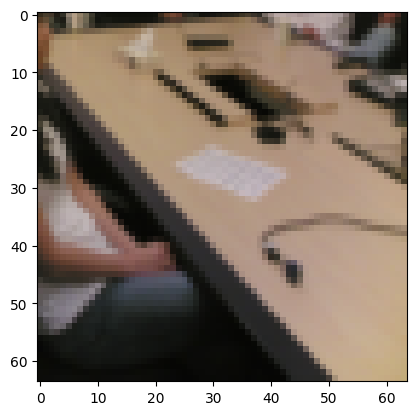

Истинный класс: Window, Предсказанный класс: Window


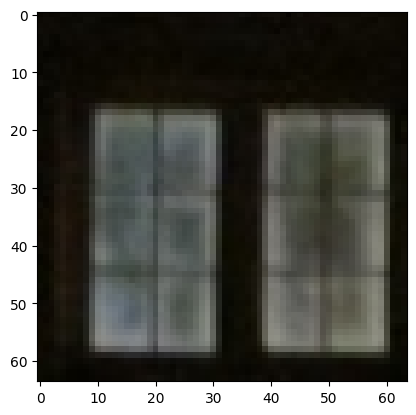

labels ---> tensor([108, 108,  36,  36])
predicted ---> tensor([ 69, 108,  25, 164])
total ---> 492
correct ---> 117
Истинный класс: Person, Предсказанный класс: House


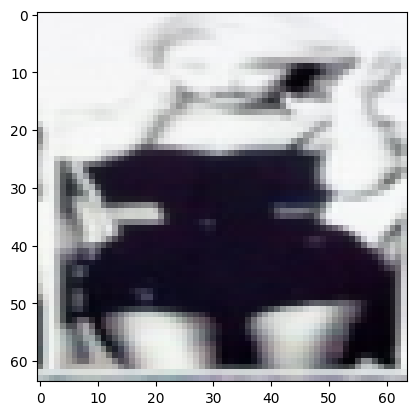

Истинный класс: Person, Предсказанный класс: Person


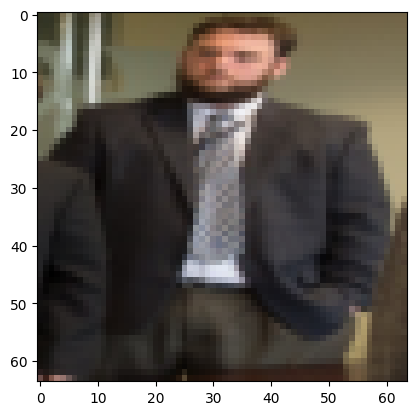

Истинный класс: Clothing, Предсказанный класс: Building


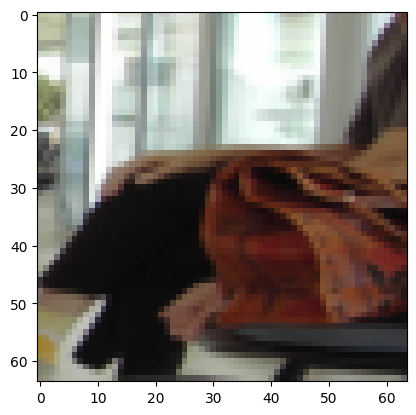

Истинный класс: Clothing, Предсказанный класс: Window


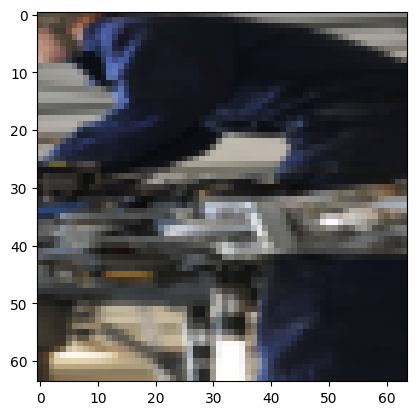

labels ---> tensor([ 25,  29,  25, 164])
predicted ---> tensor([ 25, 164, 108, 164])
total ---> 496
correct ---> 119
Истинный класс: Building, Предсказанный класс: Building


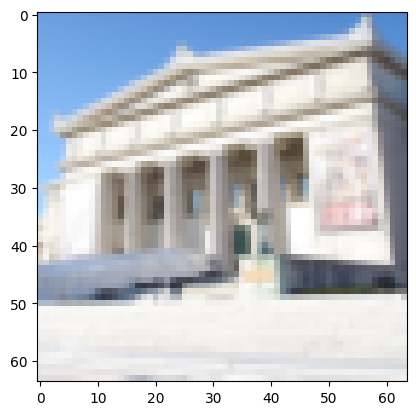

Истинный класс: Car, Предсказанный класс: Window


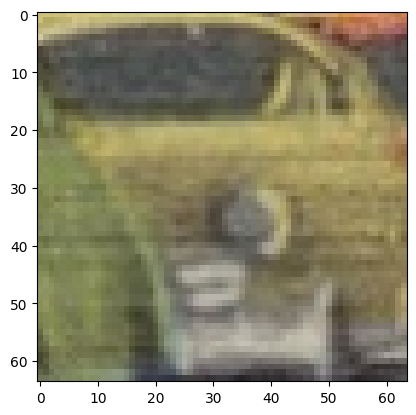

Истинный класс: Building, Предсказанный класс: Person


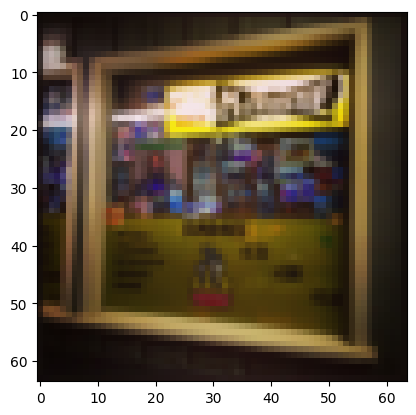

Истинный класс: Window, Предсказанный класс: Window


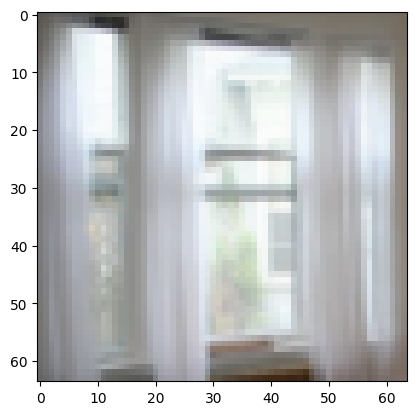

labels ---> tensor([ 76, 164,  95, 168])
predicted ---> tensor([ 76, 164, 108, 108])
total ---> 500
correct ---> 121
Истинный класс: Human hair, Предсказанный класс: Human hair


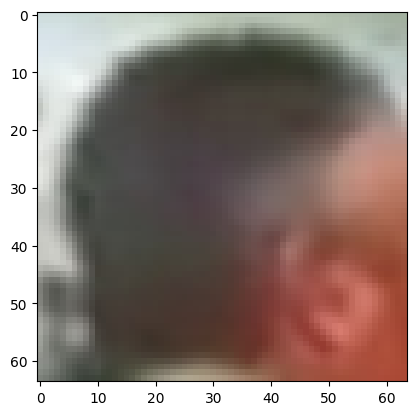

Истинный класс: Window, Предсказанный класс: Window


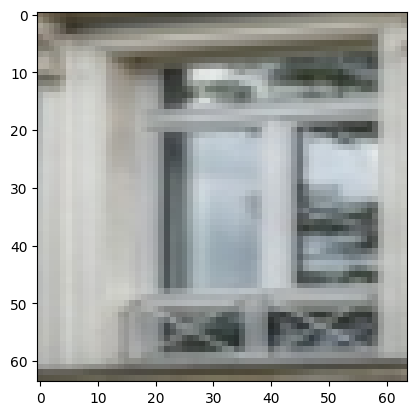

Истинный класс: Mammal, Предсказанный класс: Person


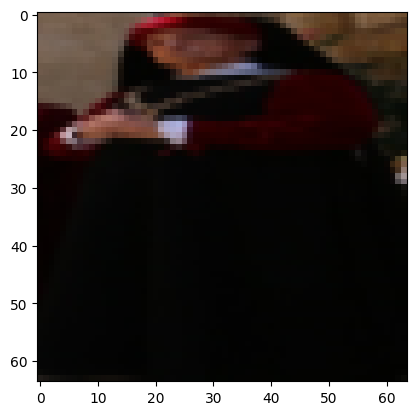

Истинный класс: Woman, Предсказанный класс: Person


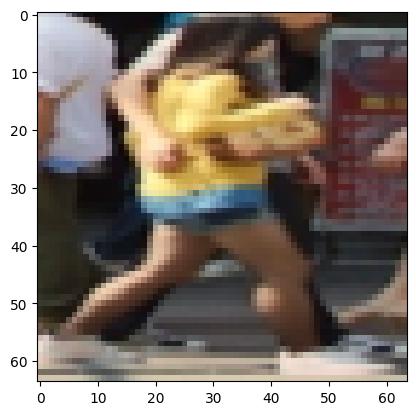

labels ---> tensor([164,  63,  69,  25])
predicted ---> tensor([164, 164,  69, 108])
total ---> 504
correct ---> 123
Истинный класс: Window, Предсказанный класс: Window


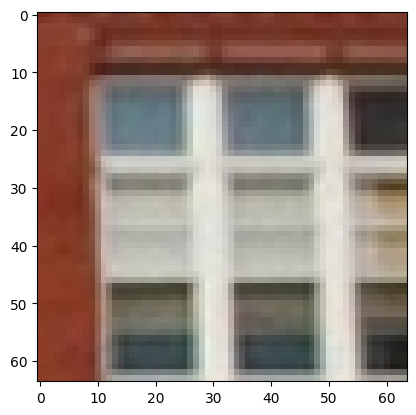

Истинный класс: Furniture, Предсказанный класс: Window


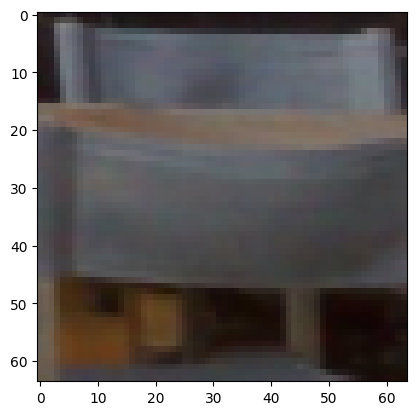

Истинный класс: House, Предсказанный класс: House


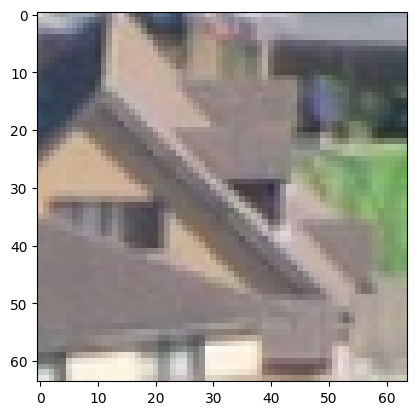

Истинный класс: Building, Предсказанный класс: Person


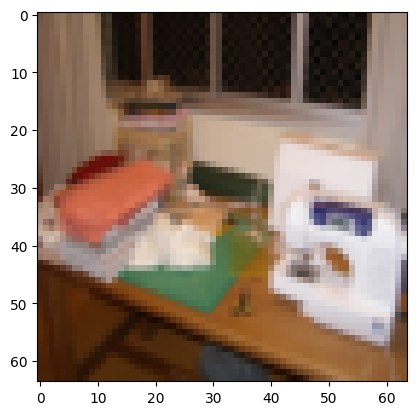

labels ---> tensor([36, 25, 25, 36])
predicted ---> tensor([ 61, 150,  25,  76])
total ---> 508
correct ---> 124
Истинный класс: Clothing, Предсказанный класс: Footwear


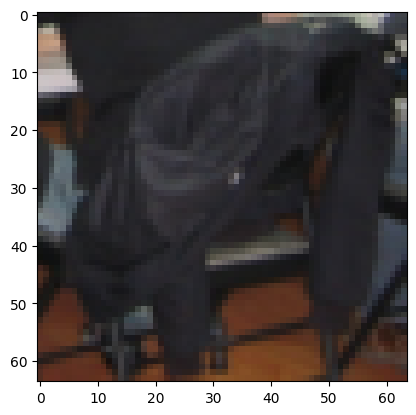

Истинный класс: Building, Предсказанный класс: Tree


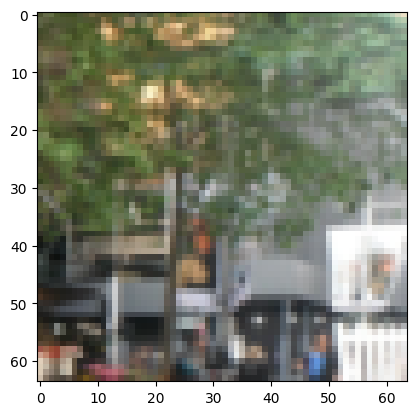

Истинный класс: Building, Предсказанный класс: Building


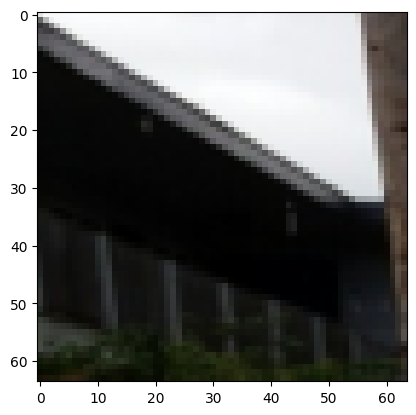

Истинный класс: Clothing, Предсказанный класс: Human hair


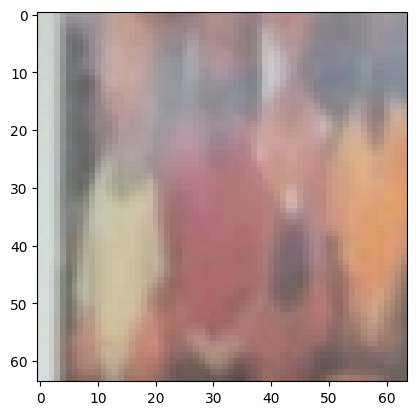

labels ---> tensor([150,  36, 164,  76])
predicted ---> tensor([150, 164, 164,  76])
total ---> 512
correct ---> 127
Истинный класс: Tree, Предсказанный класс: Tree


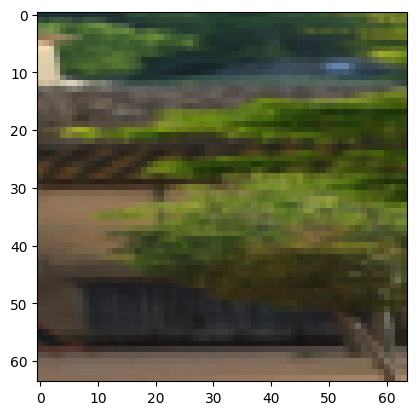

Истинный класс: Clothing, Предсказанный класс: Window


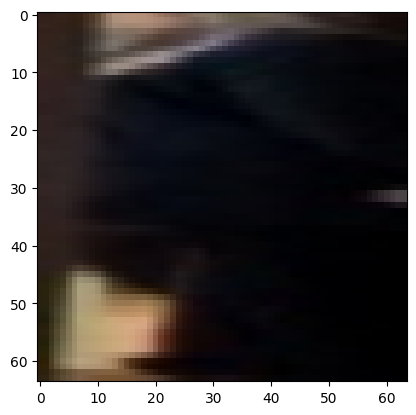

Истинный класс: Window, Предсказанный класс: Window


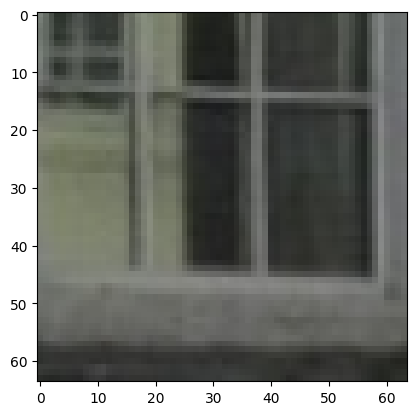

Истинный класс: Human hair, Предсказанный класс: Human hair


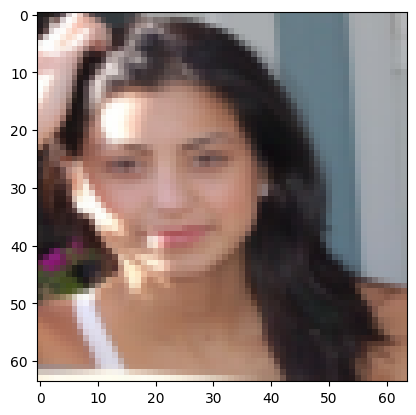

labels ---> tensor([ 96, 137,  25, 164])
predicted ---> tensor([ 25, 108,  69, 164])
total ---> 516
correct ---> 128
Истинный класс: Man, Предсказанный класс: Building


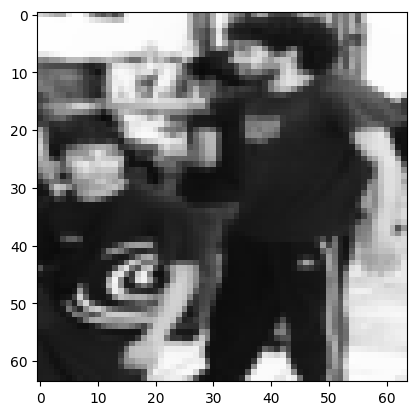

Истинный класс: Table tennis racket, Предсказанный класс: Person


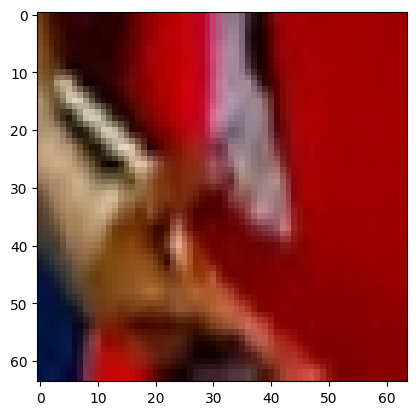

Истинный класс: Building, Предсказанный класс: House


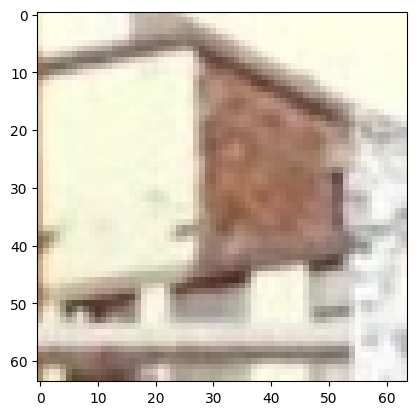

Истинный класс: Window, Предсказанный класс: Window


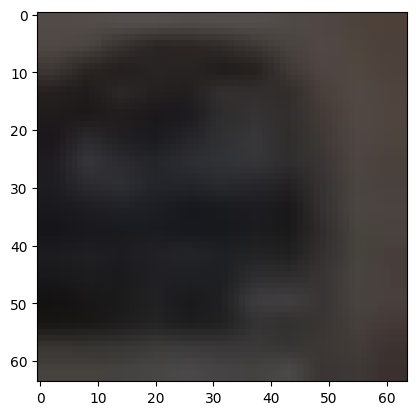

labels ---> tensor([164, 157,  75, 164])
predicted ---> tensor([164, 108,  76, 164])
total ---> 520
correct ---> 130
Истинный класс: Window, Предсказанный класс: Window


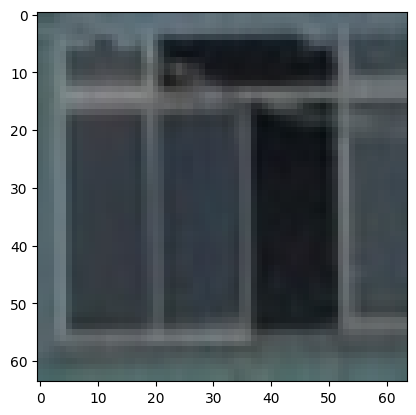

Истинный класс: Vehicle registration plate, Предсказанный класс: Person


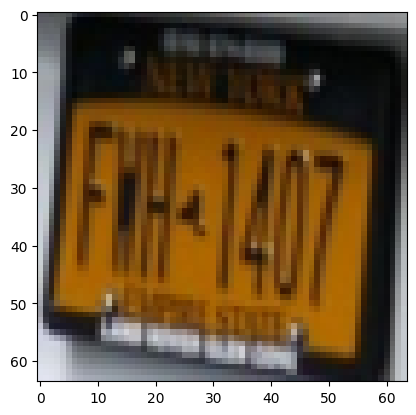

Истинный класс: Human face, Предсказанный класс: Human hair


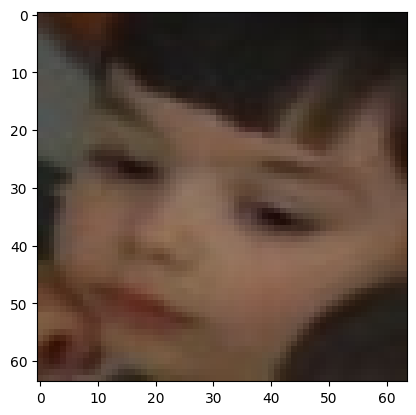

Истинный класс: Window, Предсказанный класс: Window


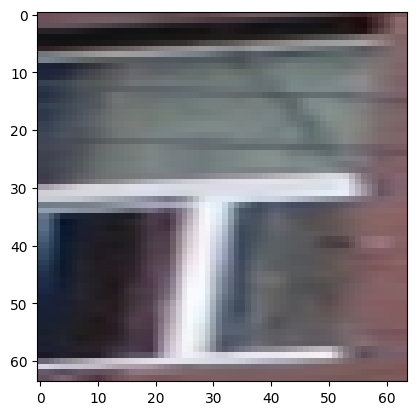

labels ---> tensor([ 69, 108, 164, 108])
predicted ---> tensor([108, 108, 164, 164])
total ---> 524
correct ---> 132
Истинный класс: House, Предсказанный класс: Person


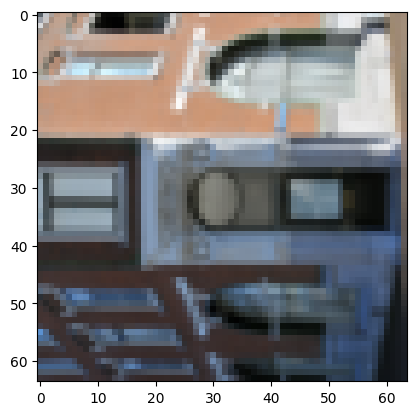

Истинный класс: Person, Предсказанный класс: Person


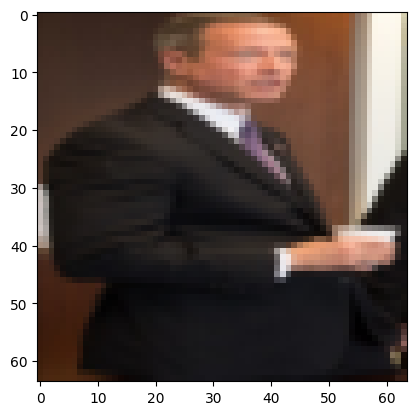

Истинный класс: Window, Предсказанный класс: Window


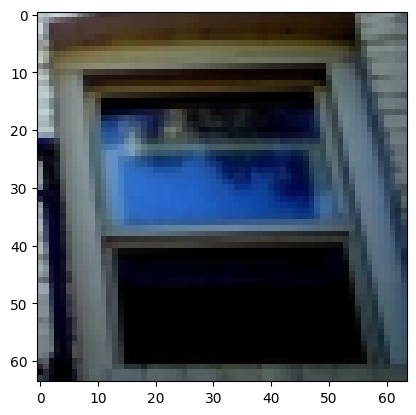

Истинный класс: Person, Предсказанный класс: Window


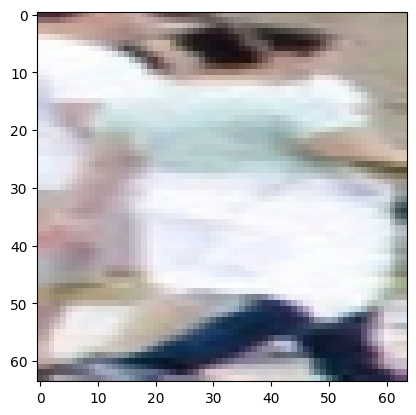

labels ---> tensor([164,  78,  92,  96])
predicted ---> tensor([164, 108,  92, 164])
total ---> 528
correct ---> 134
Истинный класс: Window, Предсказанный класс: Window


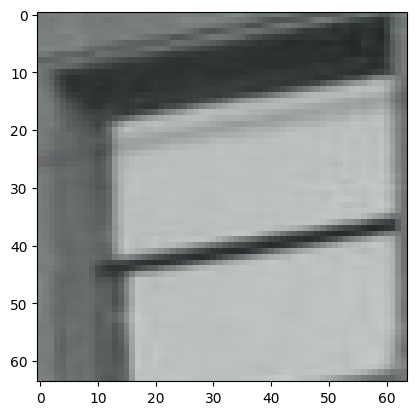

Истинный класс: Human head, Предсказанный класс: Person


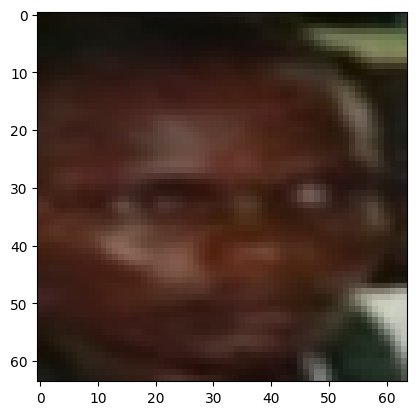

Истинный класс: Light bulb, Предсказанный класс: Light bulb


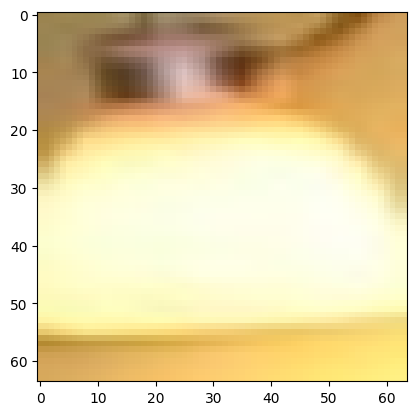

Истинный класс: Man, Предсказанный класс: Window


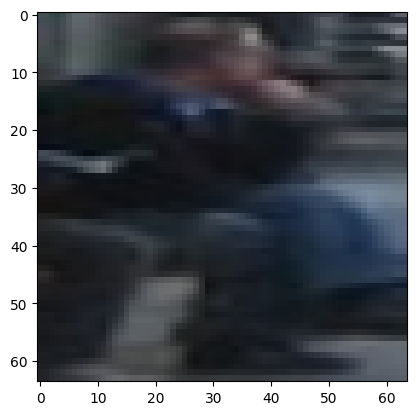

labels ---> tensor([114, 164, 150, 131])
predicted ---> tensor([108, 164, 150, 108])
total ---> 532
correct ---> 136
Истинный класс: Poster, Предсказанный класс: Person


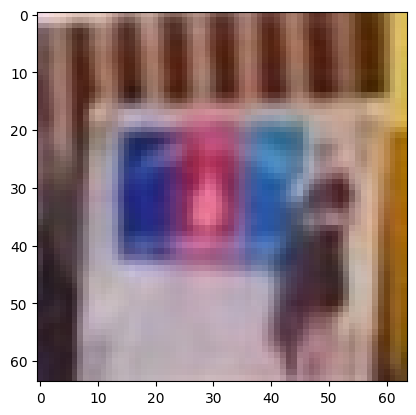

Истинный класс: Window, Предсказанный класс: Window


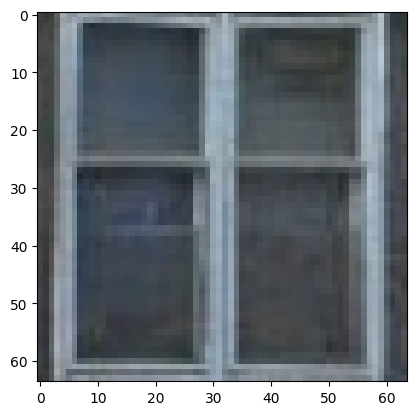

Истинный класс: Tree, Предсказанный класс: Tree


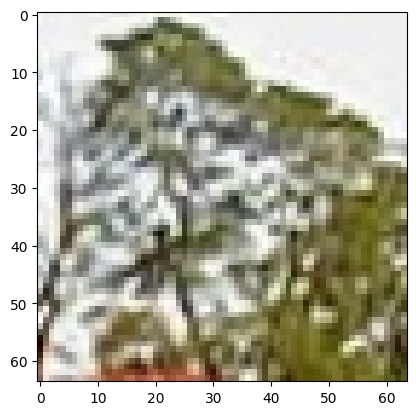

Истинный класс: Street light, Предсказанный класс: Person


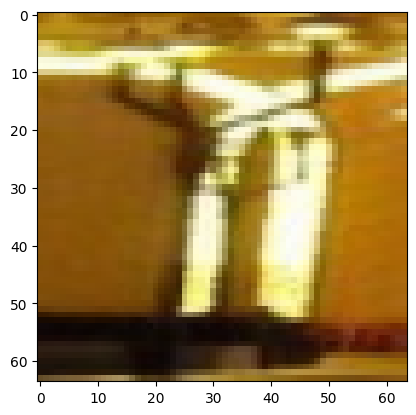

labels ---> tensor([164, 117, 164, 112])
predicted ---> tensor([164,  69,  25, 150])
total ---> 536
correct ---> 137
Истинный класс: Window, Предсказанный класс: Window


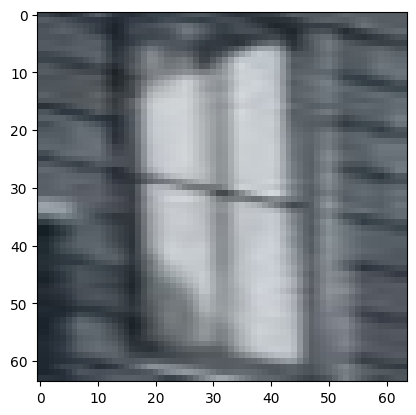

Истинный класс: Sculpture, Предсказанный класс: House


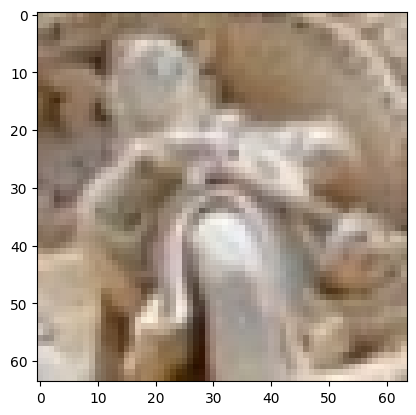

Истинный класс: Window, Предсказанный класс: Building


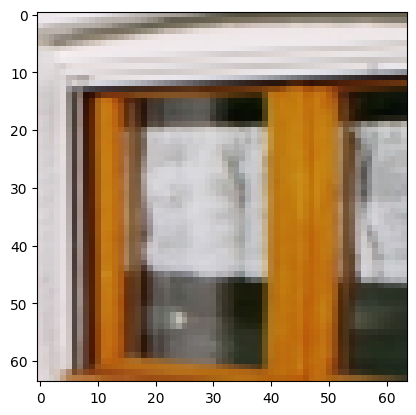

Истинный класс: Plant, Предсказанный класс: Tree


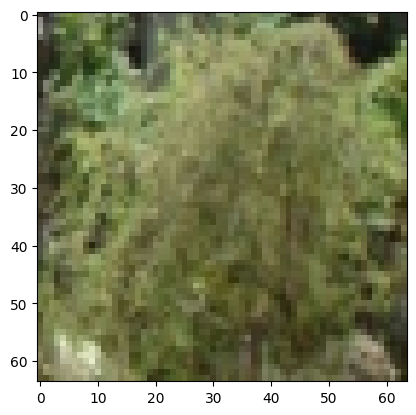

labels ---> tensor([136, 113,  65,  47])
predicted ---> tensor([108,  25, 164, 164])
total ---> 540
correct ---> 137
Истинный класс: Table, Предсказанный класс: Person


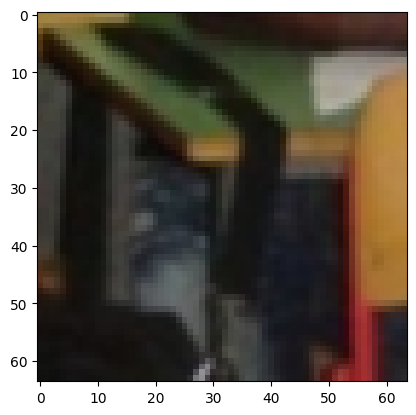

Истинный класс: Porch, Предсказанный класс: Building


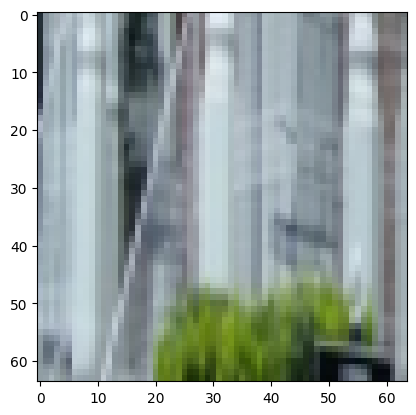

Истинный класс: Girl, Предсказанный класс: Window


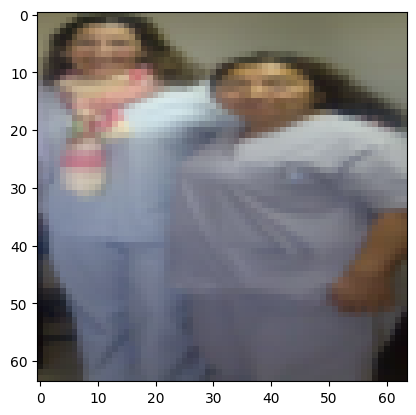

Истинный класс: Door, Предсказанный класс: Window


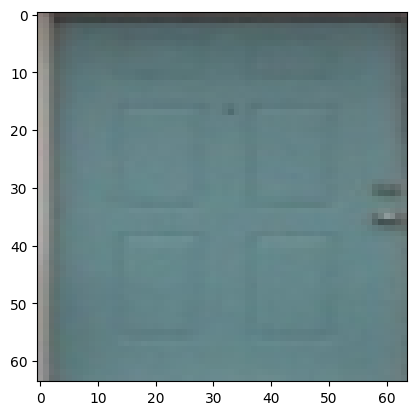

labels ---> tensor([29, 71, 69, 71])
predicted ---> tensor([108, 108,  63,  25])
total ---> 544
correct ---> 137
Истинный класс: Car, Предсказанный класс: Person


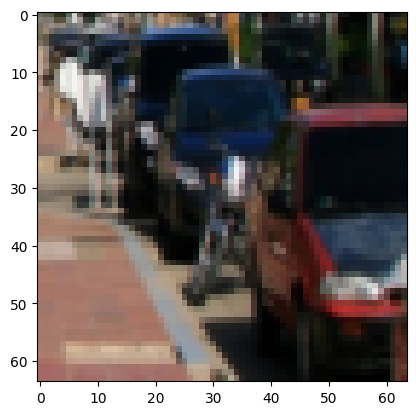

Истинный класс: Human arm, Предсказанный класс: Person


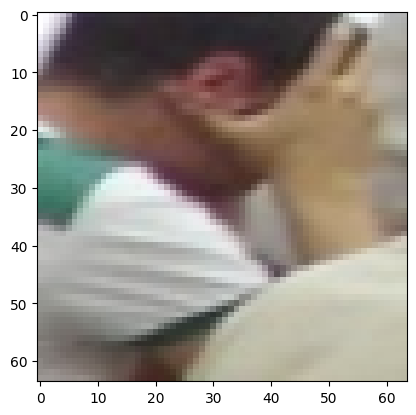

Истинный класс: House, Предсказанный класс: Furniture


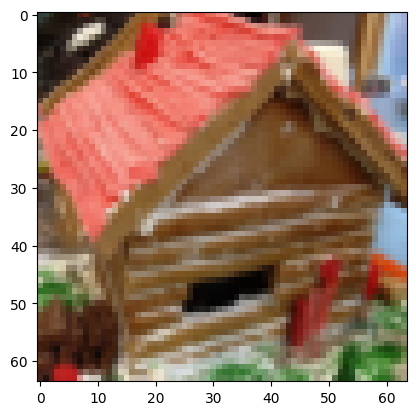

Истинный класс: Human arm, Предсказанный класс: Building


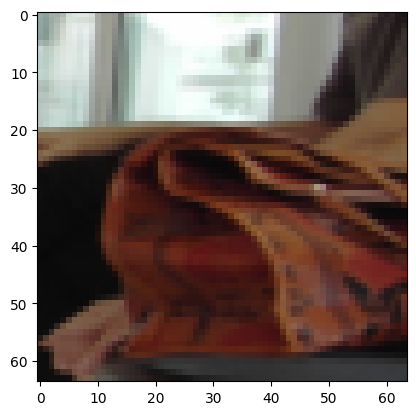

labels ---> tensor([ 69, 108, 162, 108])
predicted ---> tensor([150, 164,  61, 108])
total ---> 548
correct ---> 138
Истинный класс: House, Предсказанный класс: Tree


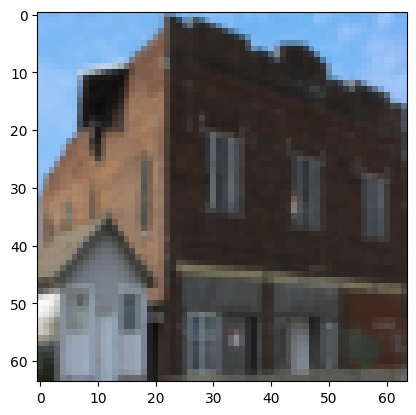

Истинный класс: Person, Предсказанный класс: Window


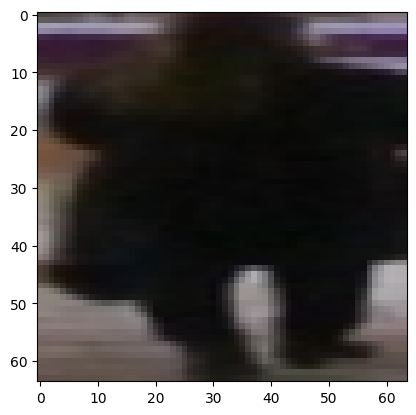

Истинный класс: Wheel, Предсказанный класс: Footwear


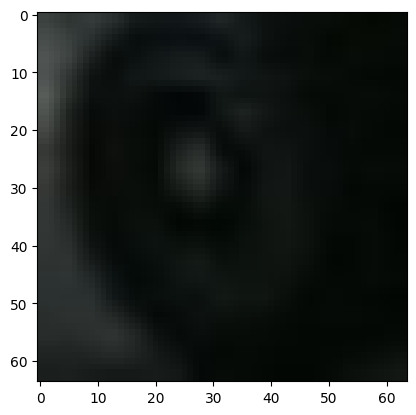

Истинный класс: Person, Предсказанный класс: Person


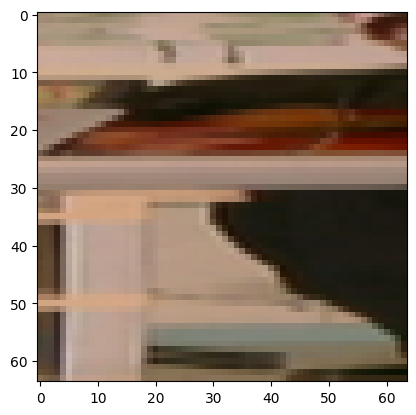

labels ---> tensor([ 61, 136, 136, 108])
predicted ---> tensor([164, 150,  25, 108])
total ---> 552
correct ---> 139
Истинный класс: Footwear, Предсказанный класс: Window


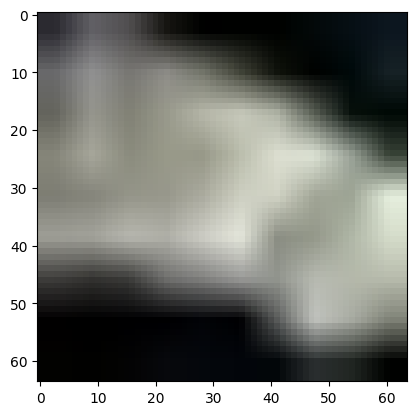

Истинный класс: Table, Предсказанный класс: Tree


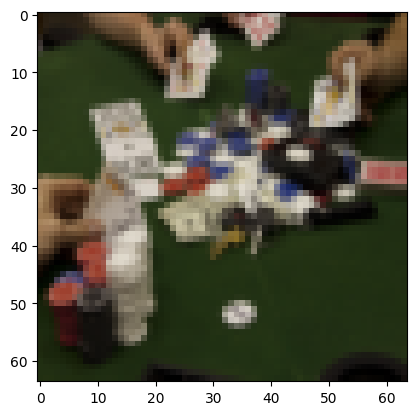

Истинный класс: Table, Предсказанный класс: Building


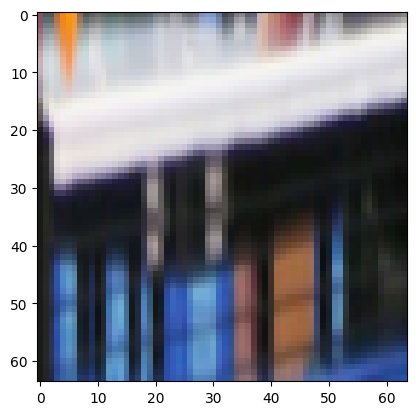

Истинный класс: Person, Предсказанный класс: Person


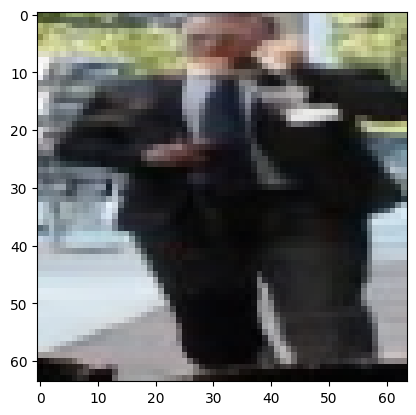

labels ---> tensor([136,  78, 164,  47])
predicted ---> tensor([ 69,  76, 164, 164])
total ---> 556
correct ---> 140
Истинный класс: Table, Предсказанный класс: House


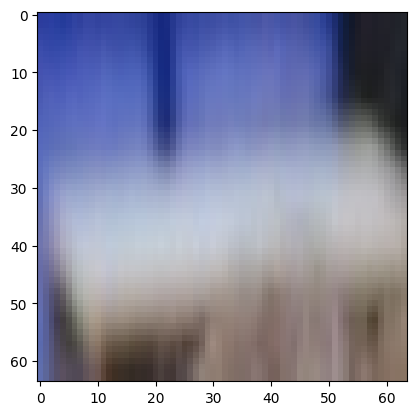

Истинный класс: Human head, Предсказанный класс: Human hair


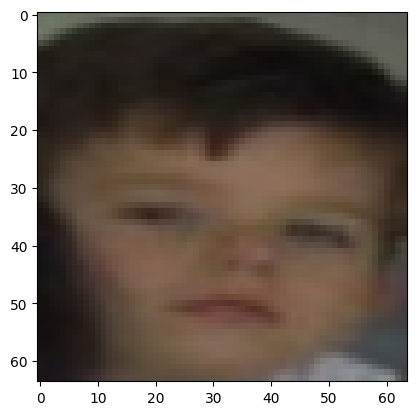

Истинный класс: Window, Предсказанный класс: Window


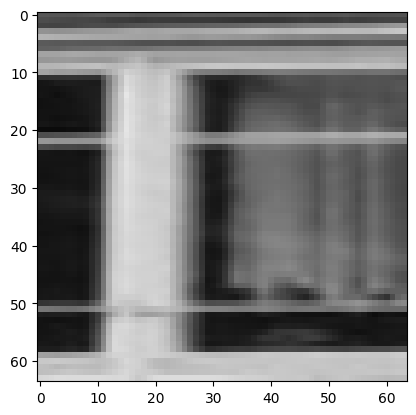

Истинный класс: Door, Предсказанный класс: Window


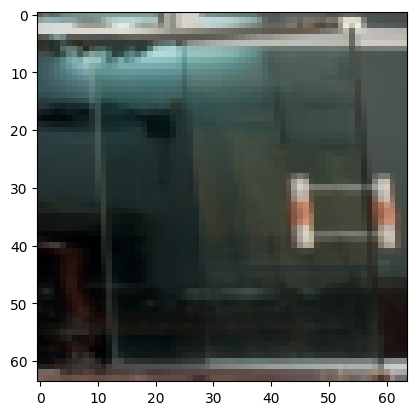

labels ---> tensor([ 95, 150,  95,  92])
predicted ---> tensor([ 76, 150, 108,  92])
total ---> 560
correct ---> 142
Истинный класс: Mammal, Предсказанный класс: Human hair


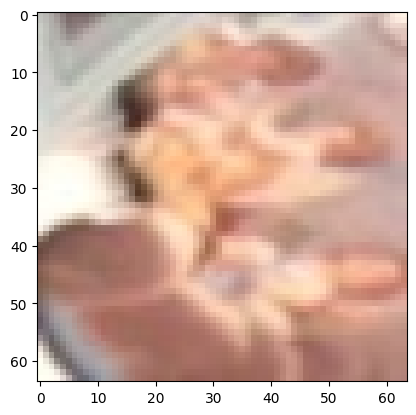

Истинный класс: Tree, Предсказанный класс: Tree


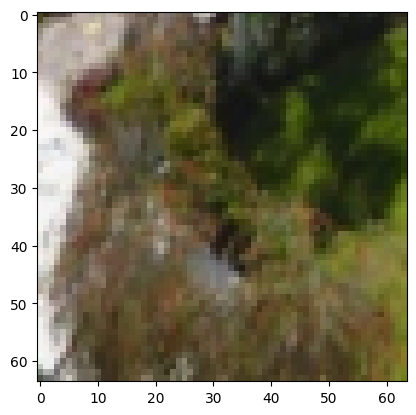

Истинный класс: Mammal, Предсказанный класс: Person


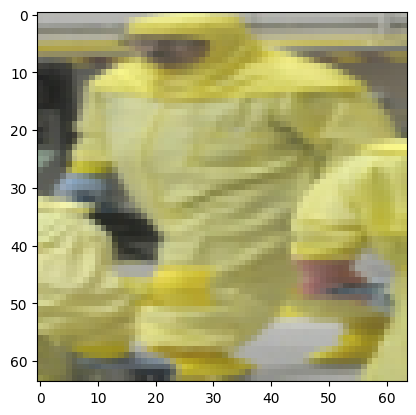

Истинный класс: Light bulb, Предсказанный класс: Light bulb


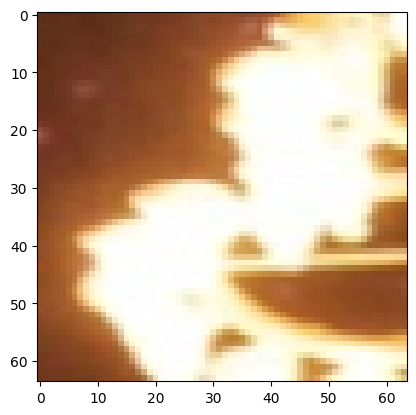

labels ---> tensor([136,  89,  53, 164])
predicted ---> tensor([108,  25, 164,  92])
total ---> 564
correct ---> 142
Истинный класс: Table, Предсказанный класс: Person


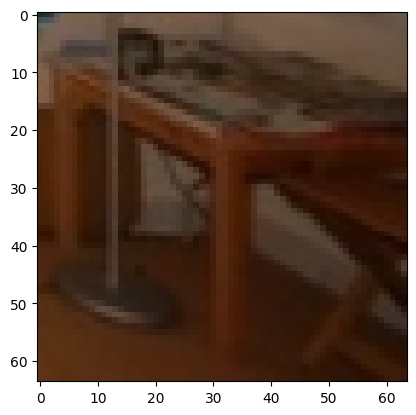

Истинный класс: Land vehicle, Предсказанный класс: Building


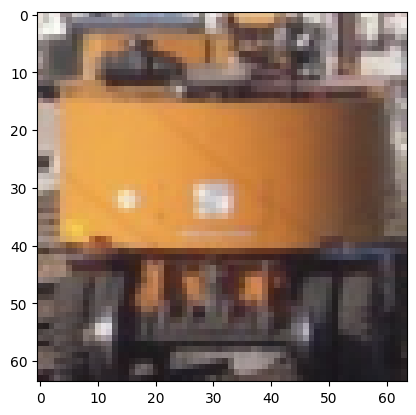

Истинный класс: Fashion accessory, Предсказанный класс: Window


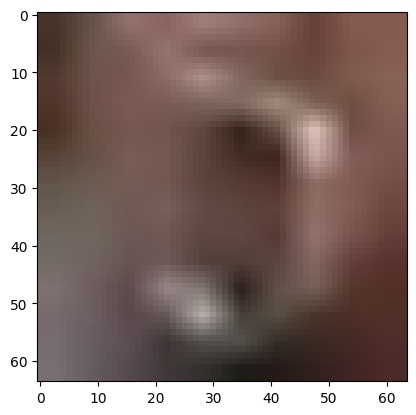

Истинный класс: Window, Предсказанный класс: Light bulb


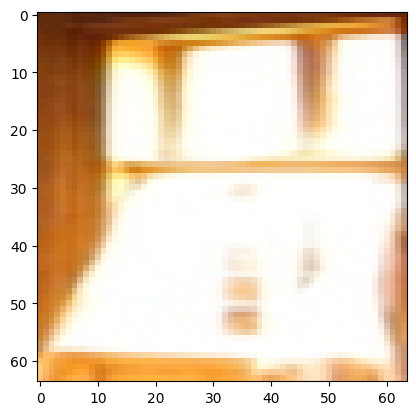

labels ---> tensor([146,  25, 164, 128])
predicted ---> tensor([150, 108, 164,  25])
total ---> 568
correct ---> 143
Истинный класс: Tower, Предсказанный класс: Tree


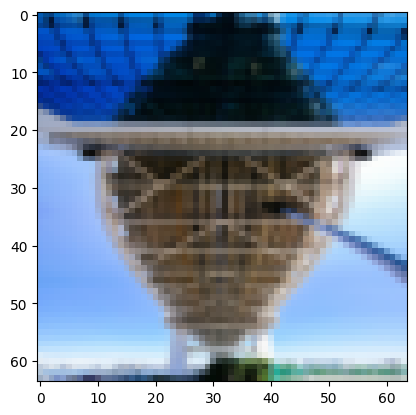

Истинный класс: Building, Предсказанный класс: Person


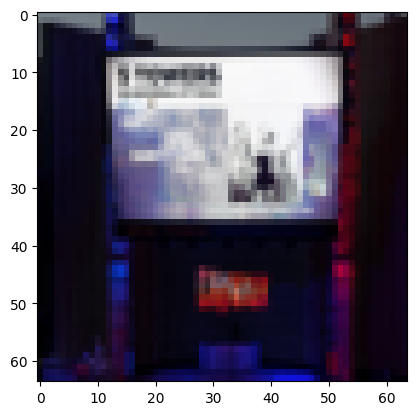

Истинный класс: Window, Предсказанный класс: Window


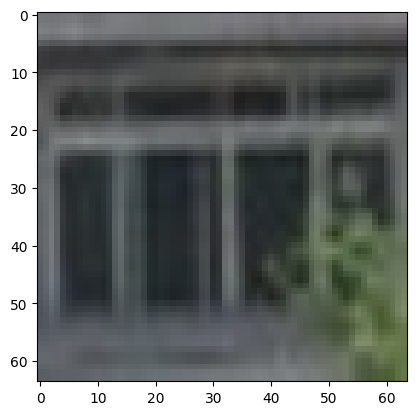

Истинный класс: Sports equipment, Предсказанный класс: Building


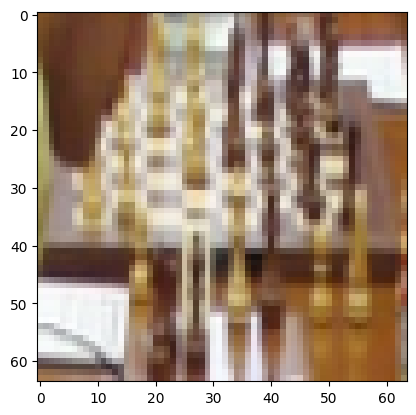

labels ---> tensor([164, 138, 164,  51])
predicted ---> tensor([164,  69, 164,  61])
total ---> 572
correct ---> 145
Истинный класс: Window, Предсказанный класс: Window


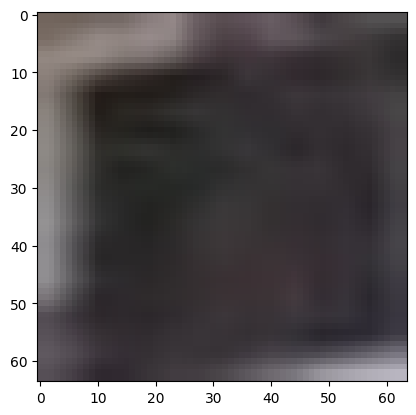

Истинный класс: Tableware, Предсказанный класс: House


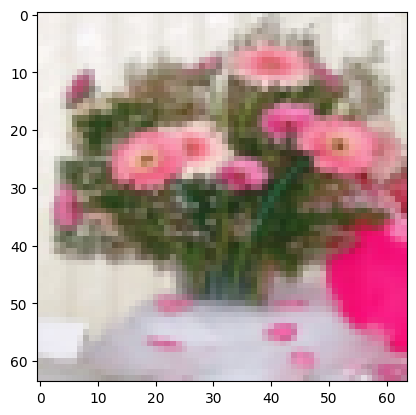

Истинный класс: Window, Предсказанный класс: Window


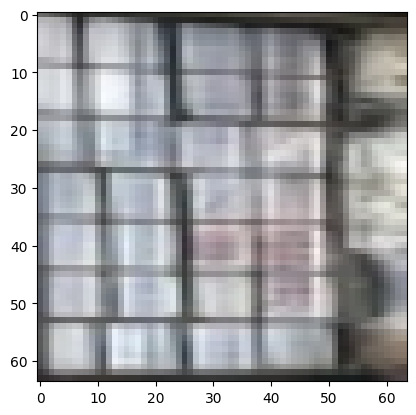

Истинный класс: Drink, Предсказанный класс: Footwear


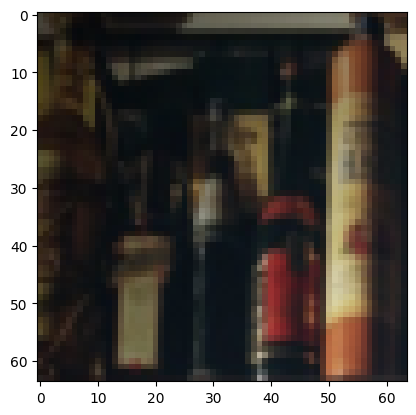

labels ---> tensor([78, 32, 25, 25])
predicted ---> tensor([ 61, 108, 164, 108])
total ---> 576
correct ---> 145
Истинный класс: Human head, Предсказанный класс: Footwear


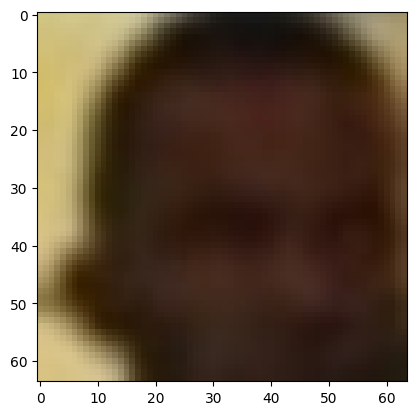

Истинный класс: Chair, Предсказанный класс: Person


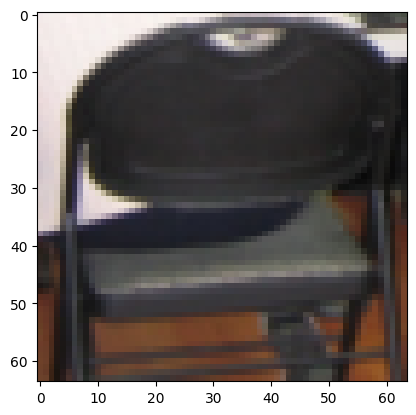

Истинный класс: Building, Предсказанный класс: Window


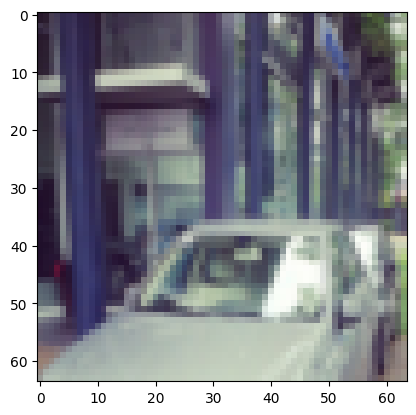

Истинный класс: Building, Предсказанный класс: Person


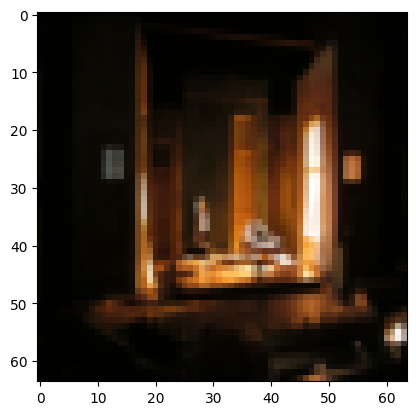

labels ---> tensor([162,  77,  89,  71])
predicted ---> tensor([164,  77, 108,  25])
total ---> 580
correct ---> 146
Истинный класс: Wheel, Предсказанный класс: Window


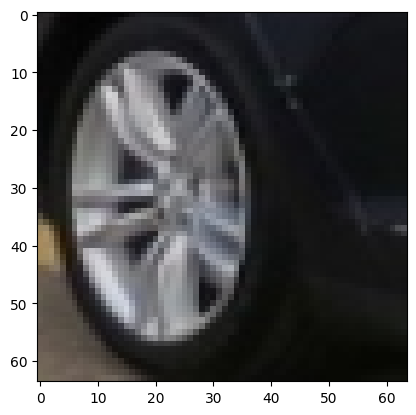

Истинный класс: Human hand, Предсказанный класс: Human hand


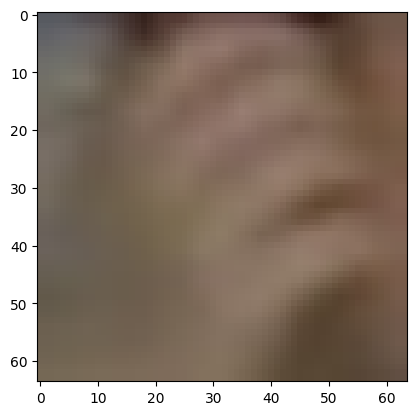

Истинный класс: Land vehicle, Предсказанный класс: Person


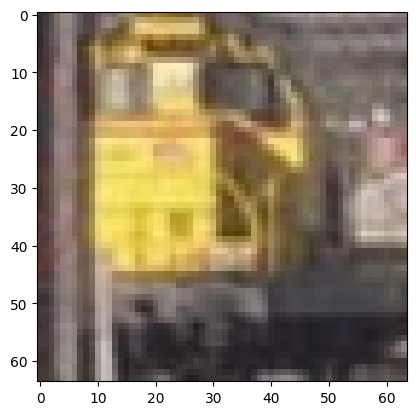

Истинный класс: Human arm, Предсказанный класс: Building


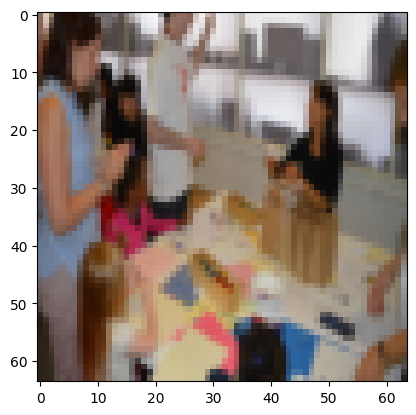

labels ---> tensor([ 85,  36, 108,  29])
predicted ---> tensor([108, 164,  69, 108])
total ---> 584
correct ---> 146
Истинный класс: Kitchen & dining room table, Предсказанный класс: Person


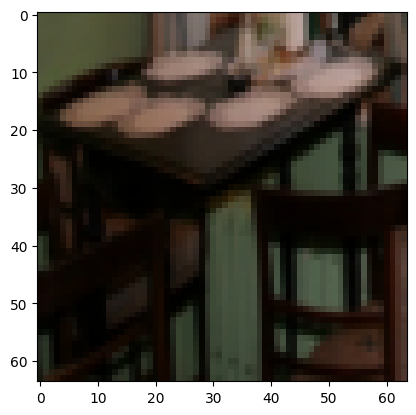

Истинный класс: Clothing, Предсказанный класс: Window


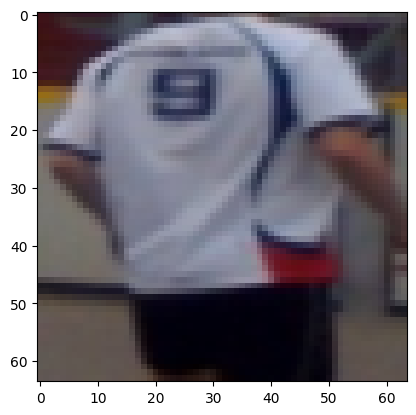

Истинный класс: Person, Предсказанный класс: House


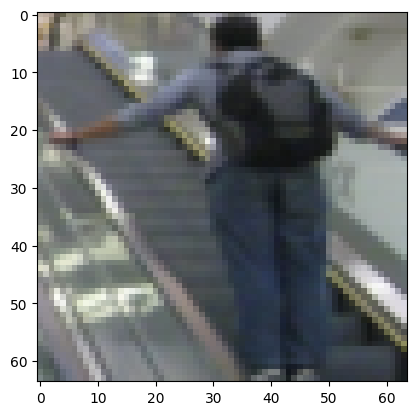

Истинный класс: Car, Предсказанный класс: Person


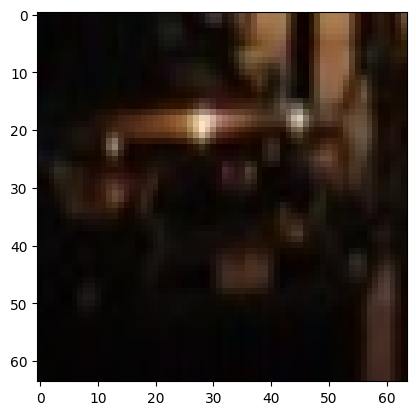

labels ---> tensor([ 58, 164,  69, 164])
predicted ---> tensor([ 69,  69, 164, 164])
total ---> 588
correct ---> 147
Истинный класс: Flower, Предсказанный класс: House


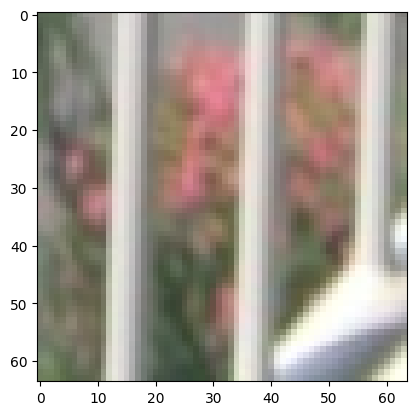

Истинный класс: Window, Предсказанный класс: House


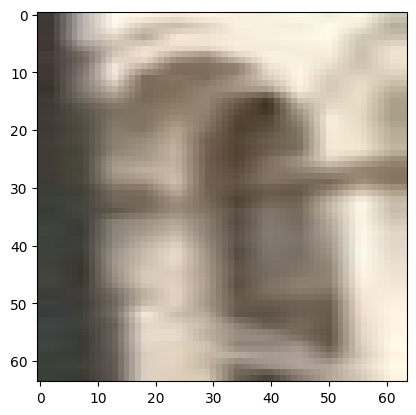

Истинный класс: House, Предсказанный класс: Window


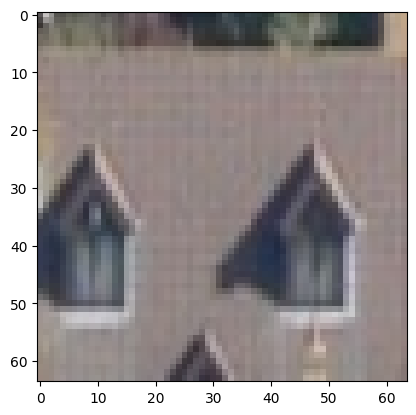

Истинный класс: Window, Предсказанный класс: Window


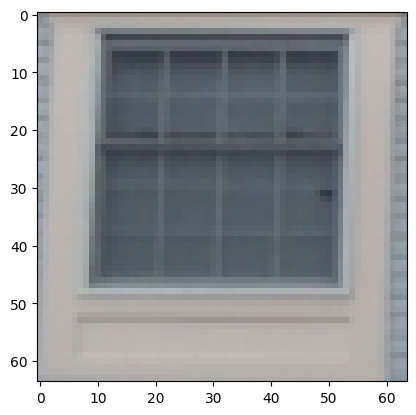

labels ---> tensor([ 61,  63, 147,  63])
predicted ---> tensor([108, 108,  69, 164])
total ---> 592
correct ---> 147
Истинный класс: Footwear, Предсказанный класс: Person


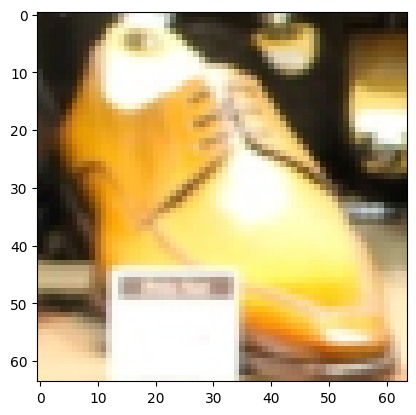

Истинный класс: Furniture, Предсказанный класс: Person


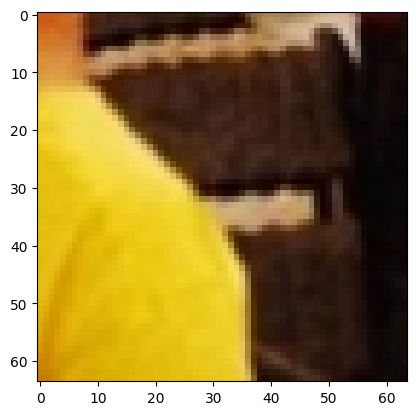

Истинный класс: Toy, Предсказанный класс: House


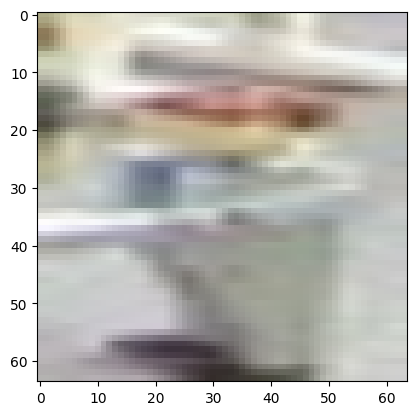

Истинный класс: Furniture, Предсказанный класс: Window


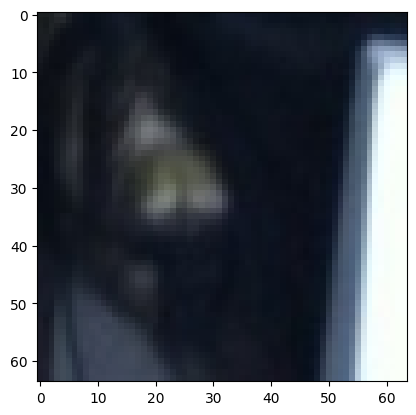

labels ---> tensor([29, 61, 36, 77])
predicted ---> tensor([108, 164, 164,  74])
total ---> 596
correct ---> 147
Истинный класс: Car, Предсказанный класс: Person


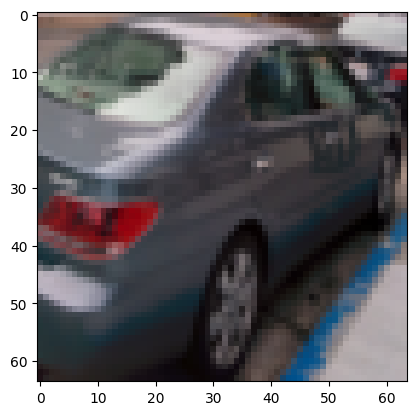

Истинный класс: Footwear, Предсказанный класс: Window


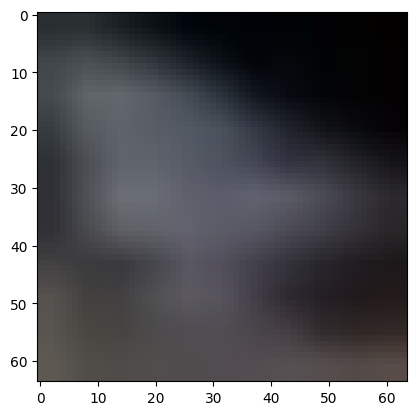

Истинный класс: Clothing, Предсказанный класс: Window


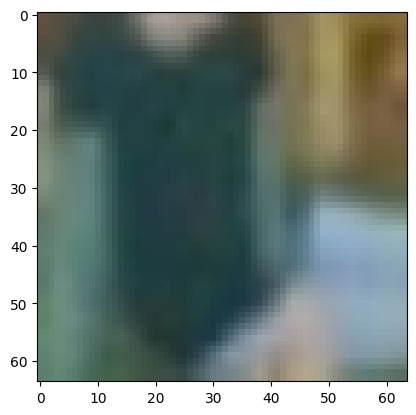

Истинный класс: Human hand, Предсказанный класс: Human eye


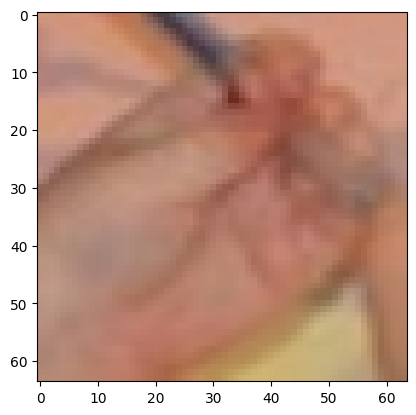

labels ---> tensor([17, 32, 43, 29])
predicted ---> tensor([108, 162, 112, 108])
total ---> 600
correct ---> 147
Истинный класс: Book, Предсказанный класс: Person


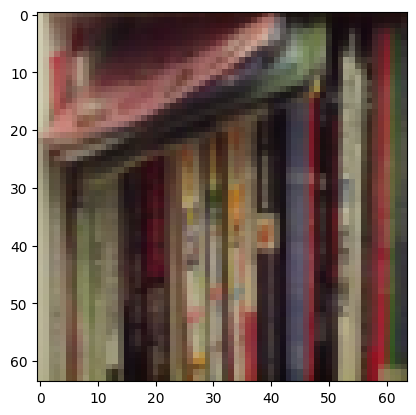

Истинный класс: Chair, Предсказанный класс: Wheel


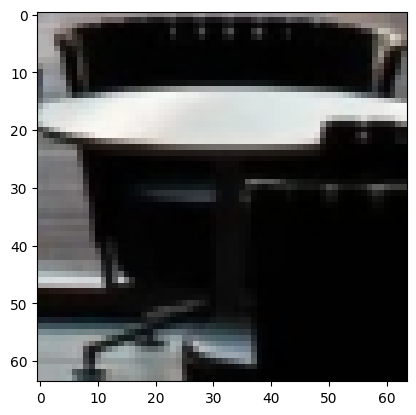

Истинный класс: Cupboard, Предсказанный класс: Plant


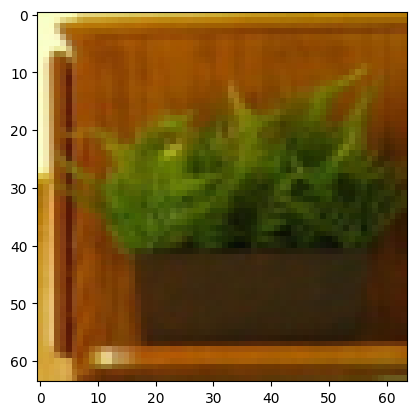

Истинный класс: Car, Предсказанный класс: Person


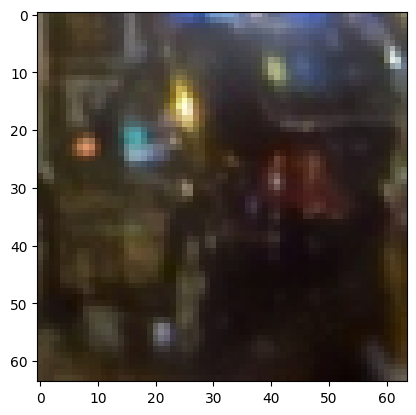

labels ---> tensor([ 61,  76, 150,  78])
predicted ---> tensor([108, 108, 150, 108])
total ---> 604
correct ---> 148
Истинный класс: Footwear, Предсказанный класс: Person


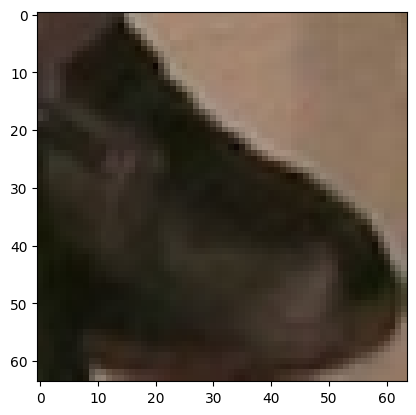

Истинный класс: Human hair, Предсказанный класс: Person


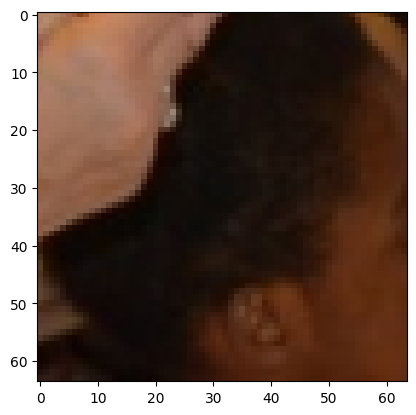

Истинный класс: Tree, Предсказанный класс: Tree


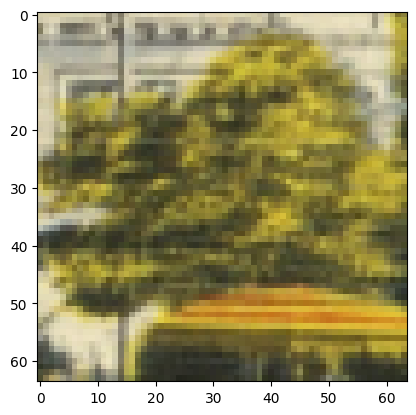

Истинный класс: Human head, Предсказанный класс: Person


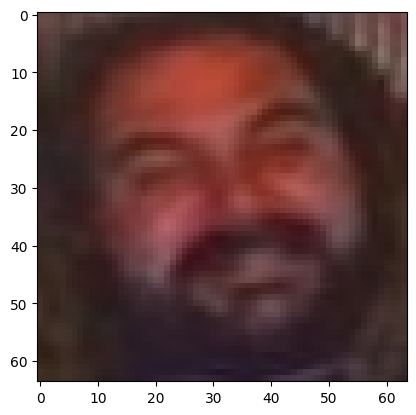

labels ---> tensor([ 25,  75, 136, 164])
predicted ---> tensor([108,  76, 108, 164])
total ---> 608
correct ---> 149
Истинный класс: Building, Предсказанный класс: Person


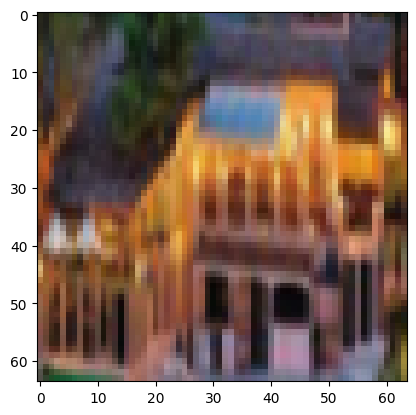

Истинный класс: Human face, Предсказанный класс: Human hair


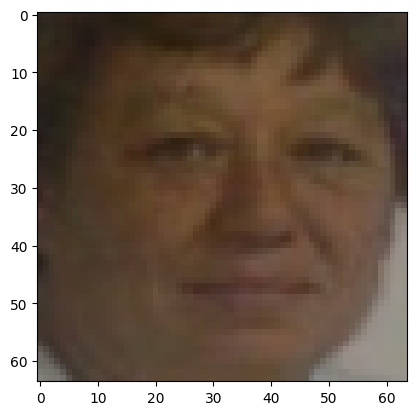

Истинный класс: Table, Предсказанный класс: Person


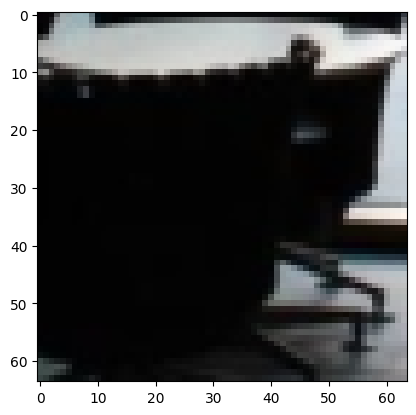

Истинный класс: Window, Предсказанный класс: Window


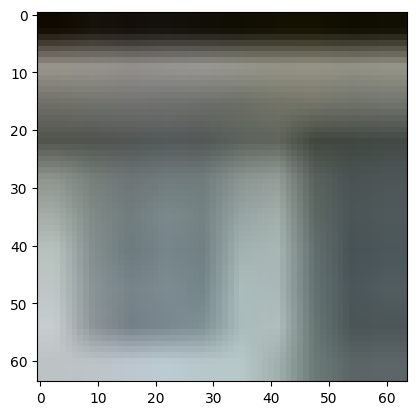

labels ---> tensor([ 36, 108,  96,  25])
predicted ---> tensor([164, 108,  61,  25])
total ---> 612
correct ---> 151
Истинный класс: Clothing, Предсказанный класс: Window


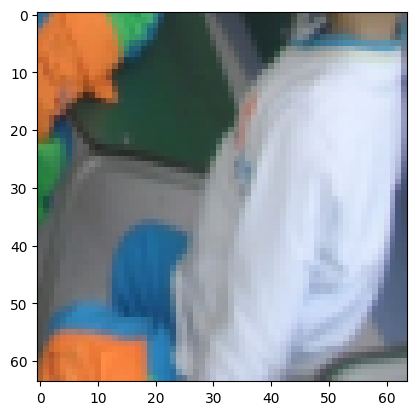

Истинный класс: Person, Предсказанный класс: Person


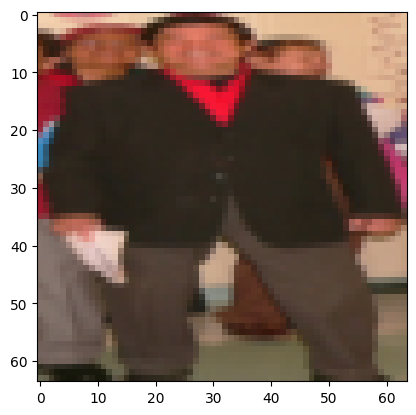

Истинный класс: Man, Предсказанный класс: Footwear


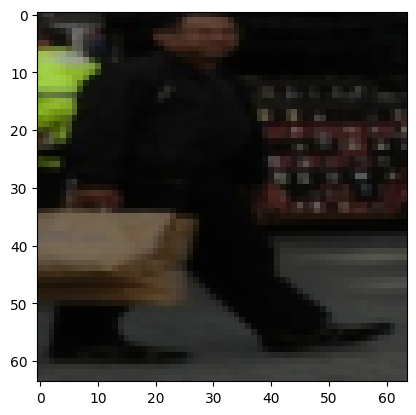

Истинный класс: Building, Предсказанный класс: Building


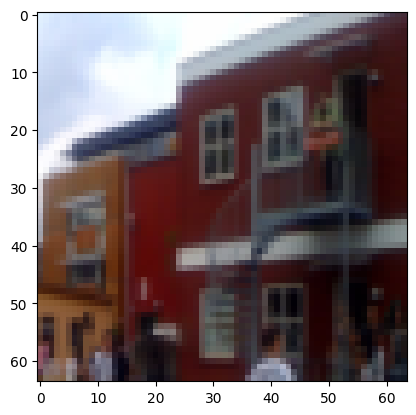

labels ---> tensor([164, 128, 164, 108])
predicted ---> tensor([164, 164, 164, 108])
total ---> 616
correct ---> 154
Истинный класс: Window, Предсказанный класс: Window


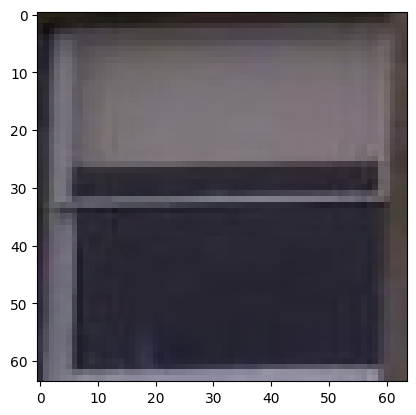

Истинный класс: Sports equipment, Предсказанный класс: Window


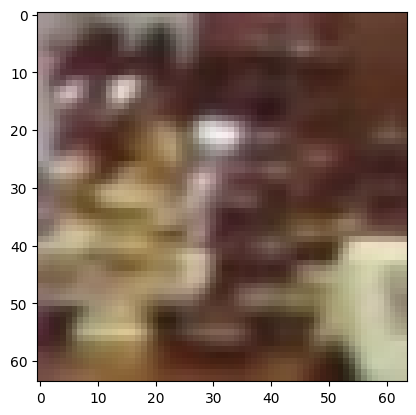

Истинный класс: Window, Предсказанный класс: Window


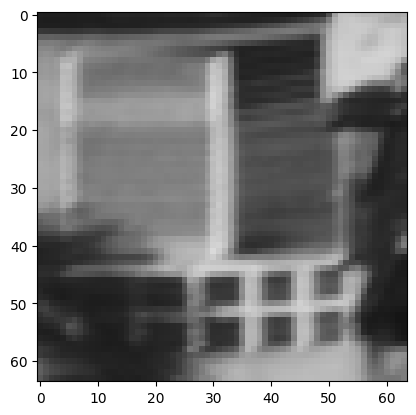

Истинный класс: Person, Предсказанный класс: Person


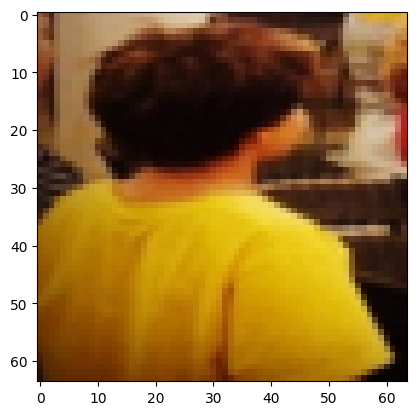

labels ---> tensor([136,  62, 164, 148])
predicted ---> tensor([108, 164, 164, 164])
total ---> 620
correct ---> 155
Истинный класс: Table, Предсказанный класс: Person


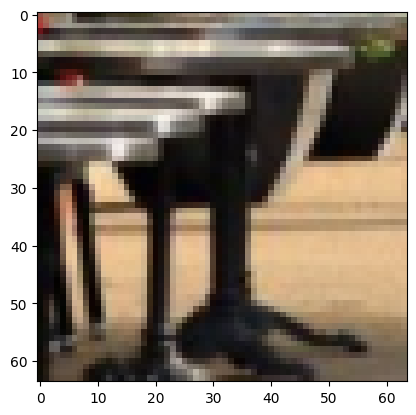

Истинный класс: Fountain, Предсказанный класс: Window


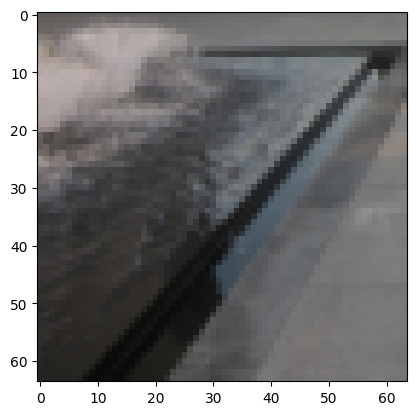

Истинный класс: Window, Предсказанный класс: Window


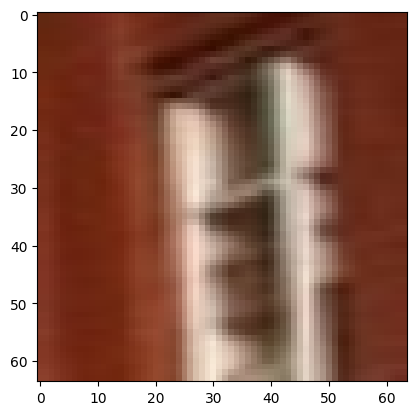

Истинный класс: Traffic light, Предсказанный класс: Window


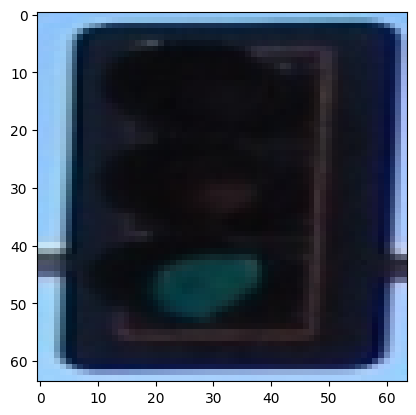

labels ---> tensor([59, 25, 79, 78])
predicted ---> tensor([108,  25, 164,  76])
total ---> 624
correct ---> 156
Истинный класс: Flowerpot, Предсказанный класс: Person


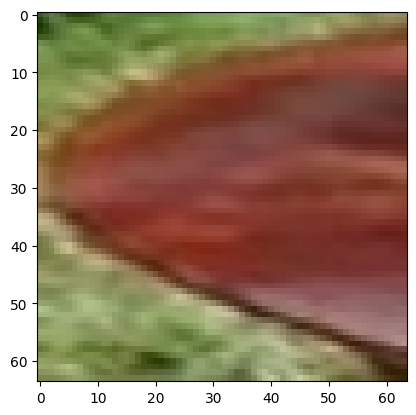

Истинный класс: Building, Предсказанный класс: Building


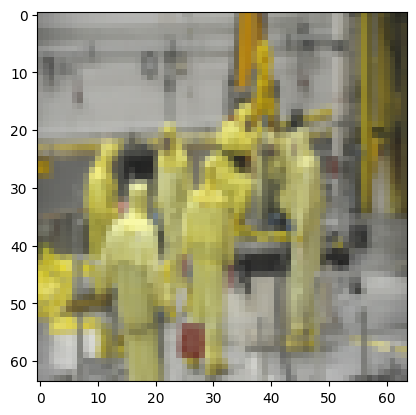

Истинный класс: Human leg, Предсказанный класс: Window


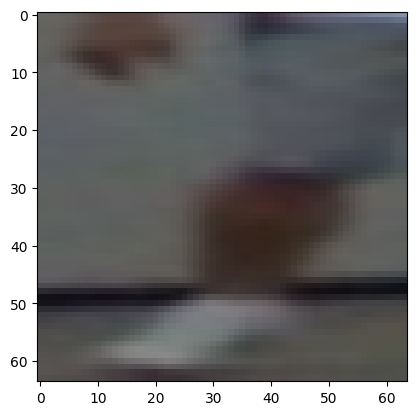

Истинный класс: Human head, Предсказанный класс: Human hair


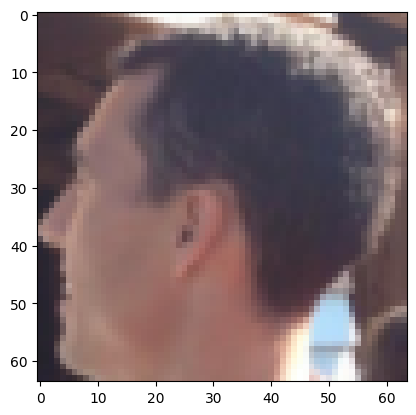

labels ---> tensor([150,  29, 164,  69])
predicted ---> tensor([150,  25, 164,  69])
total ---> 628
correct ---> 159
Истинный класс: Tree, Предсказанный класс: Tree


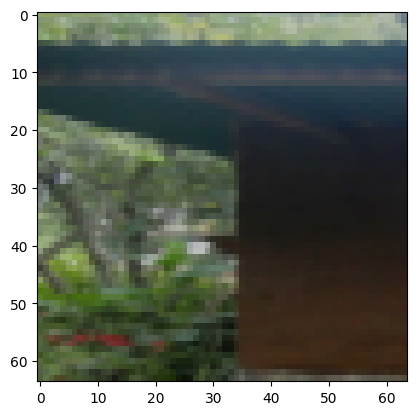

Истинный класс: Car, Предсказанный класс: Building


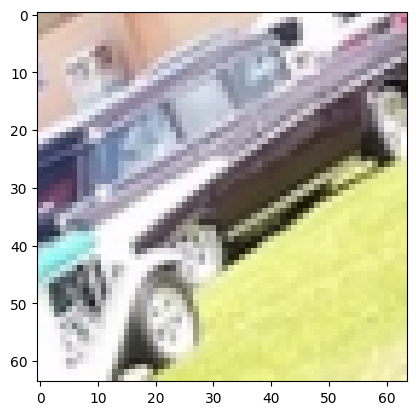

Истинный класс: Window, Предсказанный класс: Window


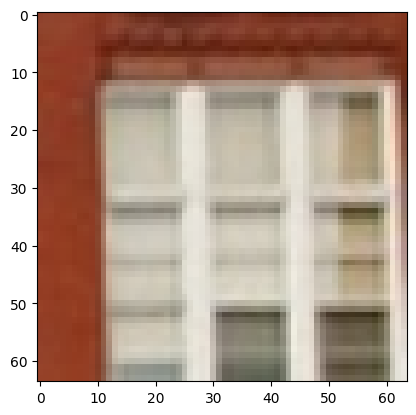

Истинный класс: House, Предсказанный класс: House


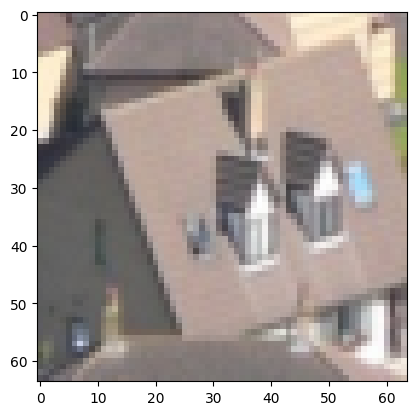

labels ---> tensor([133, 150,  36,  75])
predicted ---> tensor([108, 112, 108,  76])
total ---> 632
correct ---> 159
Истинный класс: Studio couch, Предсказанный класс: Person


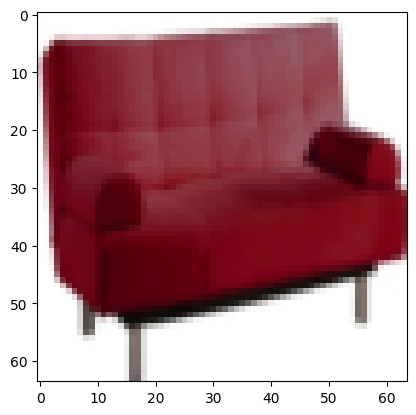

Истинный класс: Tree, Предсказанный класс: Plant


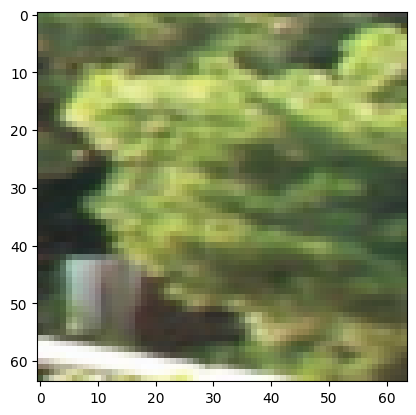

Истинный класс: Clothing, Предсказанный класс: Person


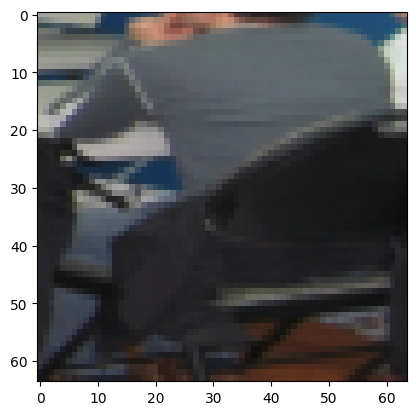

Истинный класс: Human face, Предсказанный класс: Human hair


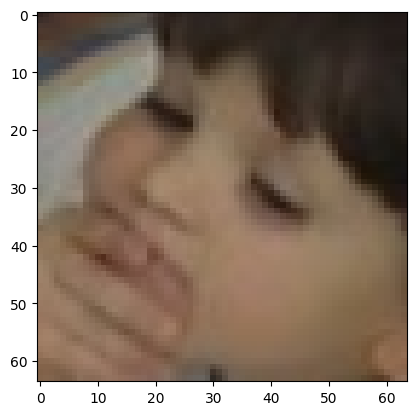

labels ---> tensor([ 45, 169,  45, 164])
predicted ---> tensor([108, 108, 108, 164])
total ---> 636
correct ---> 160
Истинный класс: Desk, Предсказанный класс: Person


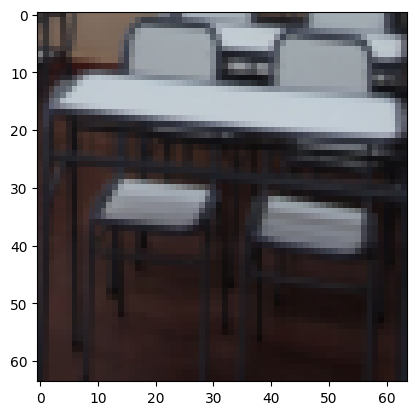

Истинный класс: Wood-burning stove, Предсказанный класс: Person


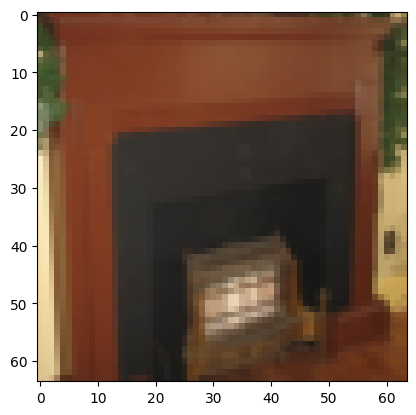

Истинный класс: Desk, Предсказанный класс: Person


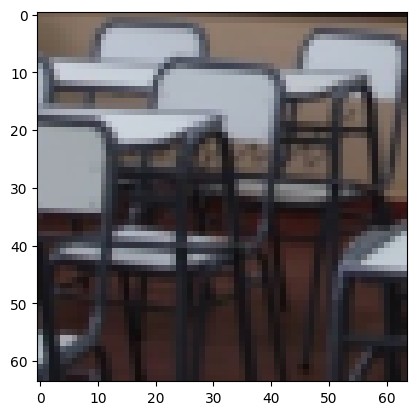

Истинный класс: Window, Предсказанный класс: Window


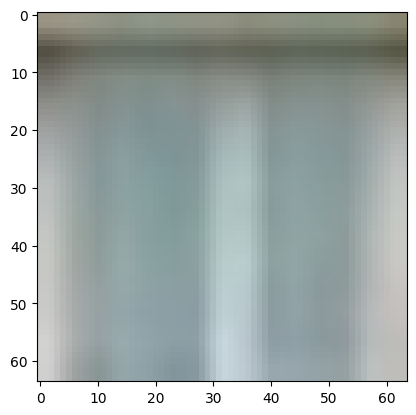

labels ---> tensor([ 83,  72, 164, 164])
predicted ---> tensor([164, 108, 164, 164])
total ---> 640
correct ---> 162
Истинный класс: Jeans, Предсказанный класс: Window


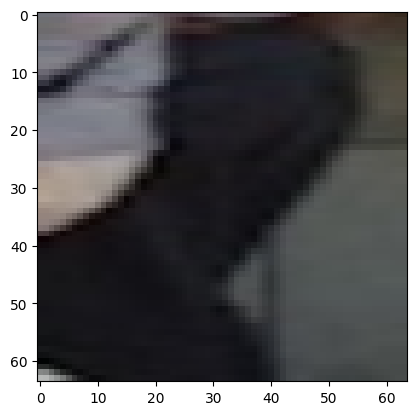

Истинный класс: Human body, Предсказанный класс: Person


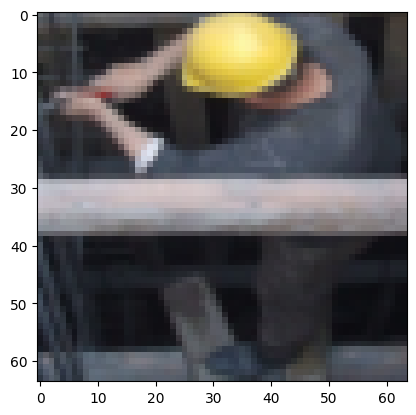

Истинный класс: Window, Предсказанный класс: Window


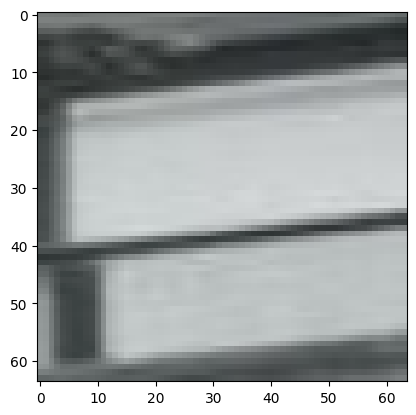

Истинный класс: Window, Предсказанный класс: Window


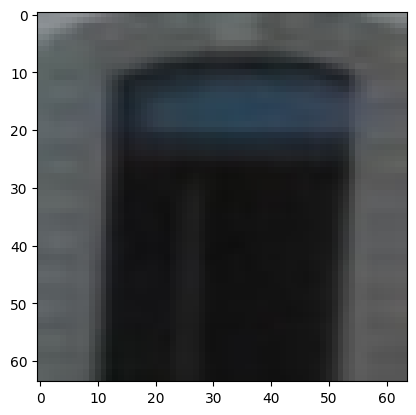

labels ---> tensor([138,  61,  61,  78])
predicted ---> tensor([ 69, 164, 108,  25])
total ---> 644
correct ---> 162
Истинный класс: Tableware, Предсказанный класс: House


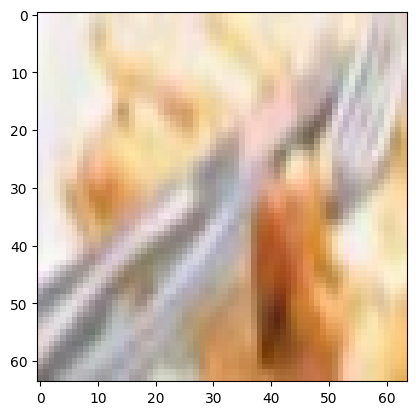

Истинный класс: Footwear, Предсказанный класс: Window


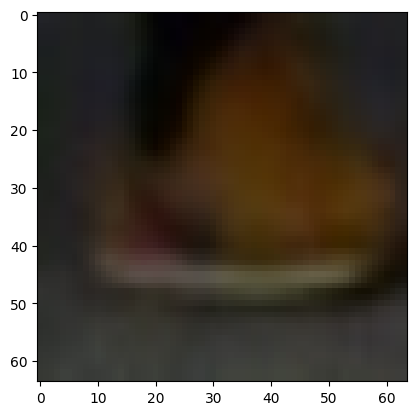

Истинный класс: Footwear, Предсказанный класс: Person


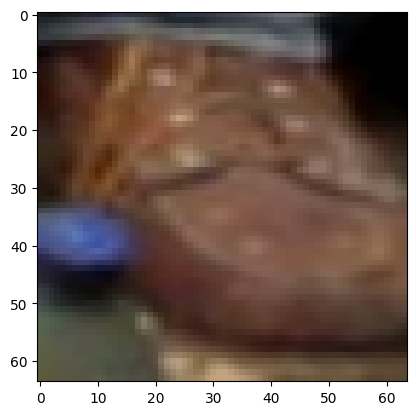

Истинный класс: Human head, Предсказанный класс: Building


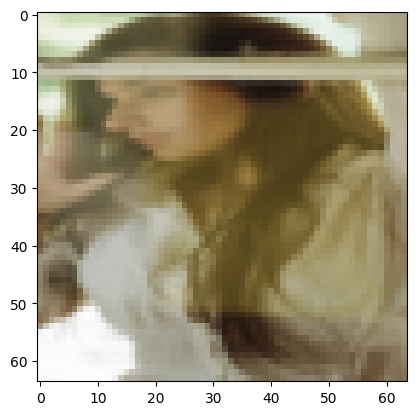

labels ---> tensor([ 32,  54, 108,  25])
predicted ---> tensor([164, 164,  25,  25])
total ---> 648
correct ---> 163
Истинный класс: Chair, Предсказанный класс: Window


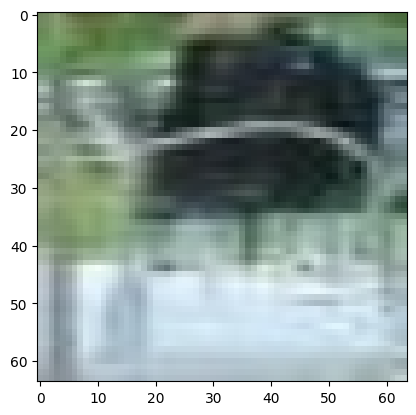

Истинный класс: Fast food, Предсказанный класс: Window


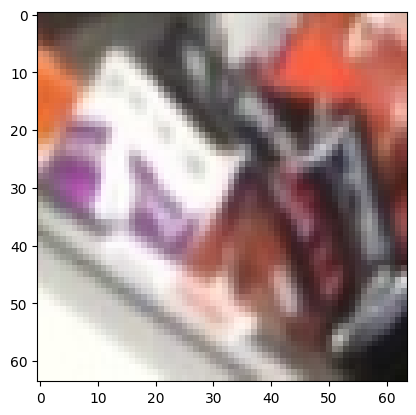

Истинный класс: Person, Предсказанный класс: Building


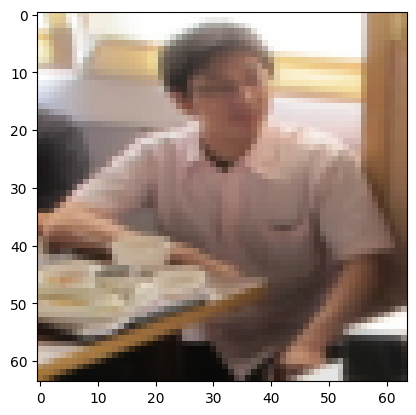

Истинный класс: Building, Предсказанный класс: Building


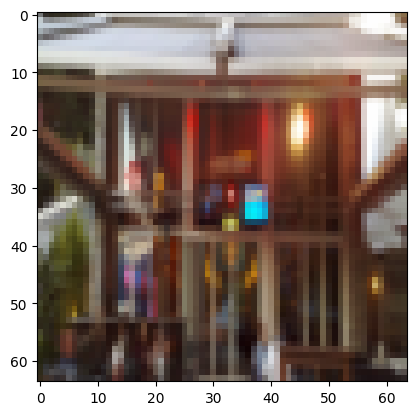

labels ---> tensor([ 61, 164,  61, 108])
predicted ---> tensor([164, 164, 164, 108])
total ---> 652
correct ---> 165
Истинный класс: Footwear, Предсказанный класс: Window


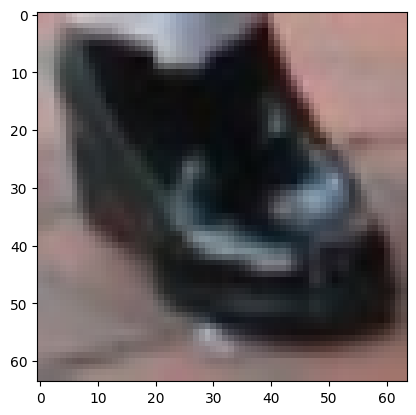

Истинный класс: Window, Предсказанный класс: Window


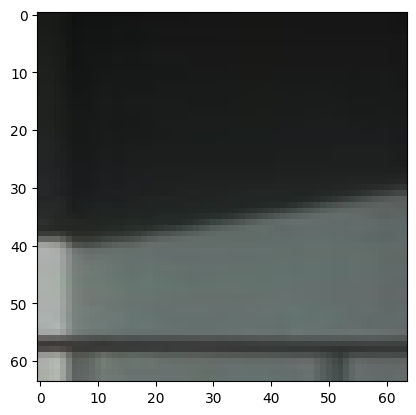

Истинный класс: Footwear, Предсказанный класс: Window


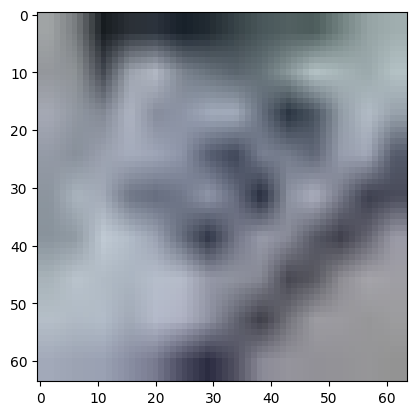

Истинный класс: Person, Предсказанный класс: Person


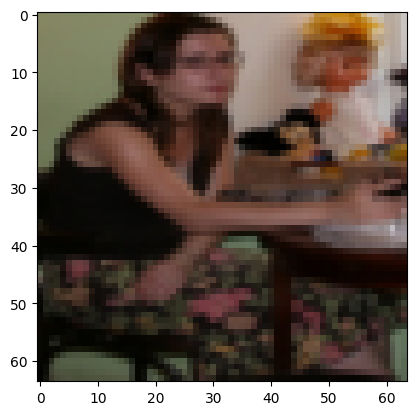

labels ---> tensor([164, 144,  59, 119])
predicted ---> tensor([164, 164, 150,  25])
total ---> 656
correct ---> 166
Истинный класс: Window, Предсказанный класс: Window


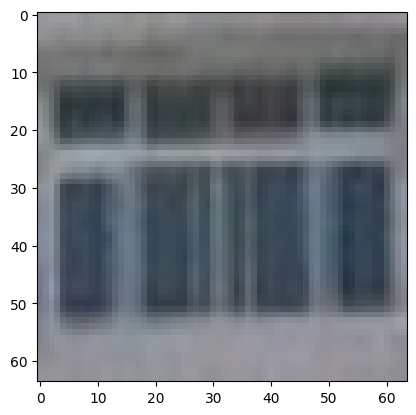

Истинный класс: Tire, Предсказанный класс: Window


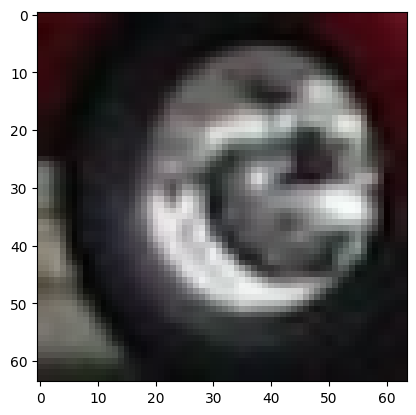

Истинный класс: Flowerpot, Предсказанный класс: Tree


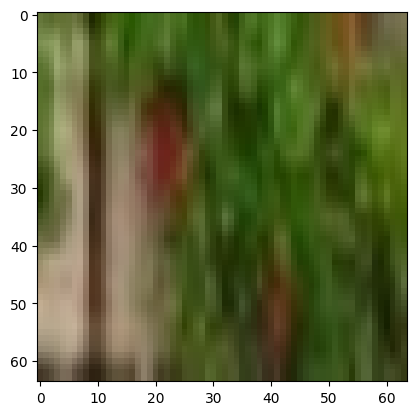

Истинный класс: Shelf, Предсказанный класс: Building


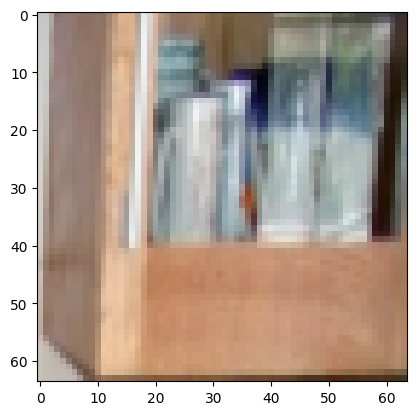

labels ---> tensor([ 78, 136, 150,  78])
predicted ---> tensor([76, 69, 69, 78])
total ---> 660
correct ---> 167
Истинный класс: Human head, Предсказанный класс: Human hair


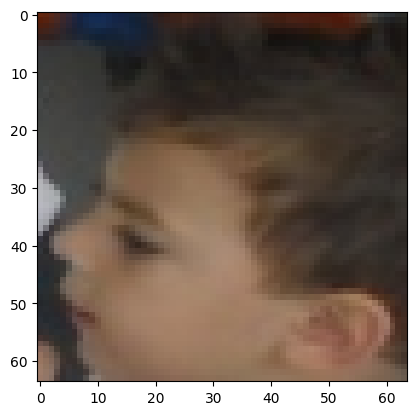

Истинный класс: Table, Предсказанный класс: House


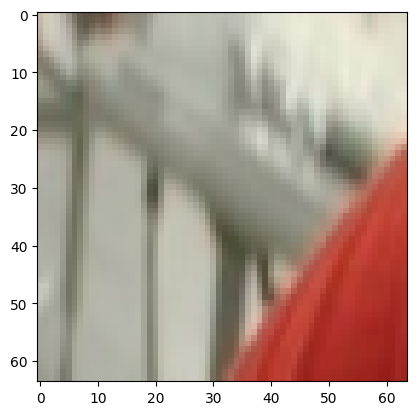

Истинный класс: Tree, Предсказанный класс: House


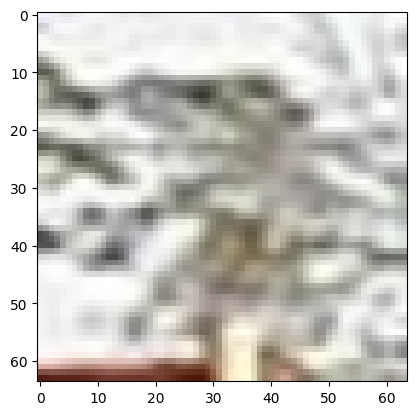

Истинный класс: Human head, Предсказанный класс: Human head


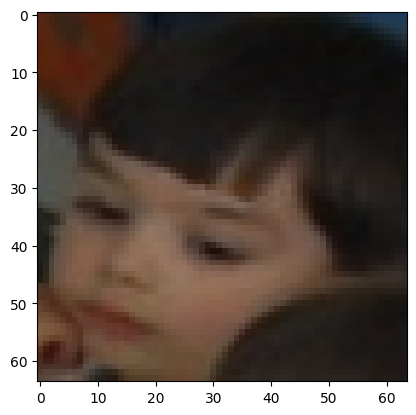

labels ---> tensor([ 29,  49, 108,  65])
predicted ---> tensor([108, 164, 164,  25])
total ---> 664
correct ---> 167
Истинный класс: Car, Предсказанный класс: Person


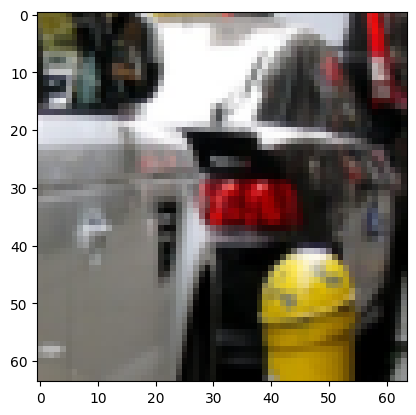

Истинный класс: Drawer, Предсказанный класс: Window


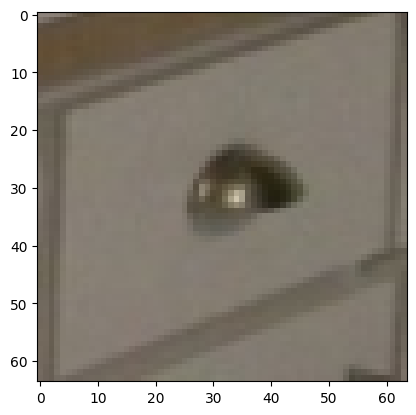

Истинный класс: Person, Предсказанный класс: Window


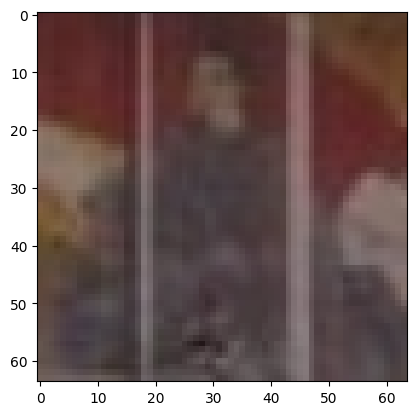

Истинный класс: Girl, Предсказанный класс: Building


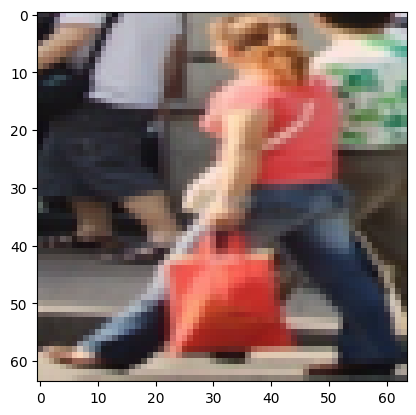

labels ---> tensor([119, 139, 164,  25])
predicted ---> tensor([108,  69, 164,  25])
total ---> 668
correct ---> 169
Истинный класс: Shelf, Предсказанный класс: Person


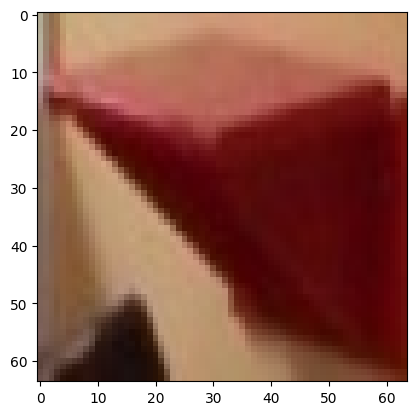

Истинный класс: Tap, Предсказанный класс: House


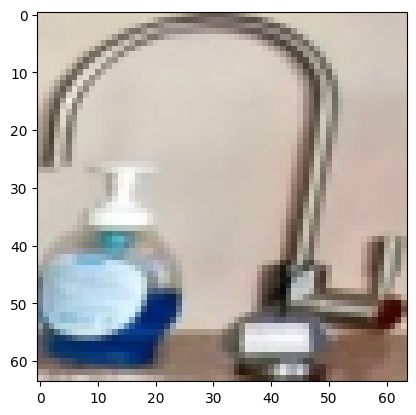

Истинный класс: Window, Предсказанный класс: Window


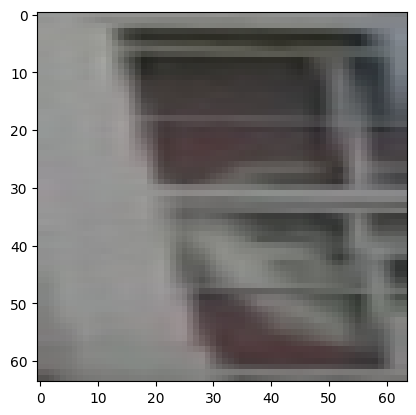

Истинный класс: Building, Предсказанный класс: Building


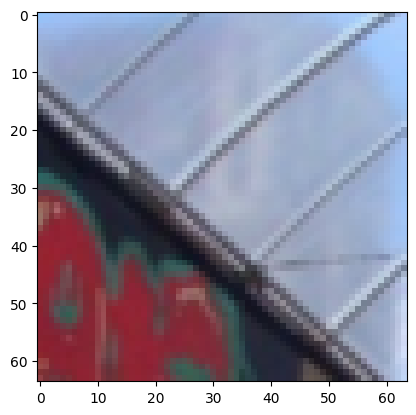

labels ---> tensor([164,  47, 164, 164])
predicted ---> tensor([164, 164, 164, 164])
total ---> 672
correct ---> 172
Истинный класс: Window, Предсказанный класс: Window


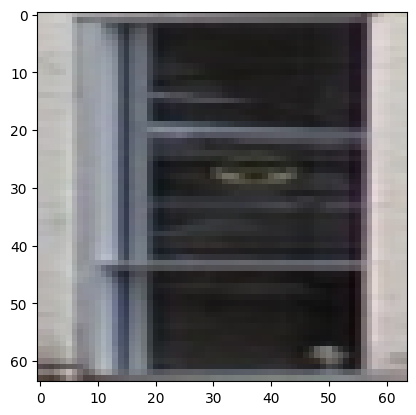

Истинный класс: Door, Предсказанный класс: Window


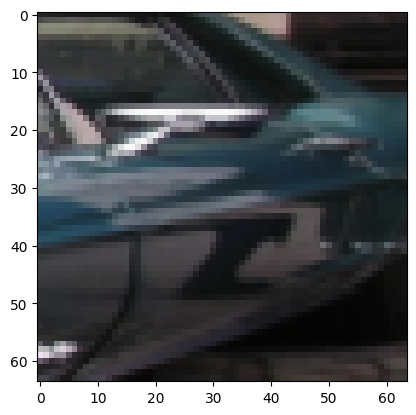

Истинный класс: Window, Предсказанный класс: Window


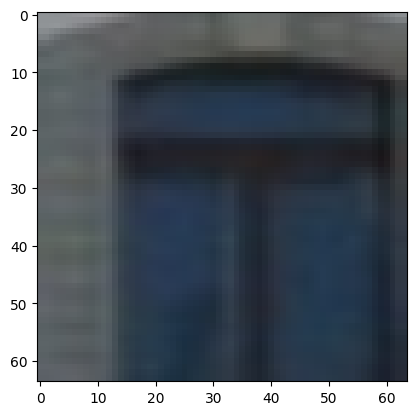

Истинный класс: Window, Предсказанный класс: Window


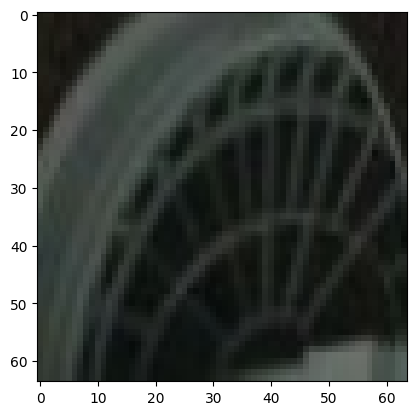

labels ---> tensor([ 69,  25,  71, 138])
predicted ---> tensor([164,  63,  63, 164])
total ---> 676
correct ---> 172
Истинный класс: House, Предсказанный класс: Window


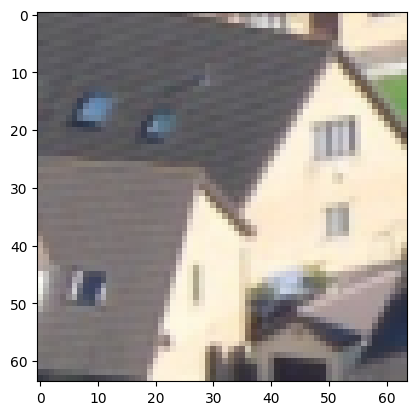

Истинный класс: Building, Предсказанный класс: Furniture


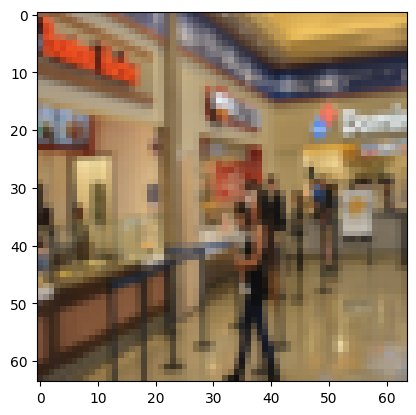

Истинный класс: Human arm, Предсказанный класс: Furniture


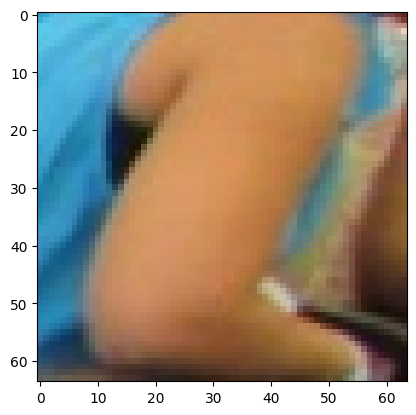

Истинный класс: Tableware, Предсказанный класс: Window


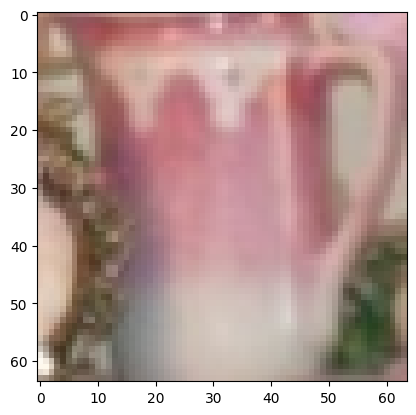

labels ---> tensor([108,  69,  96,  85])
predicted ---> tensor([164,  25, 108,  61])
total ---> 680
correct ---> 172
Истинный класс: Person, Предсказанный класс: Window


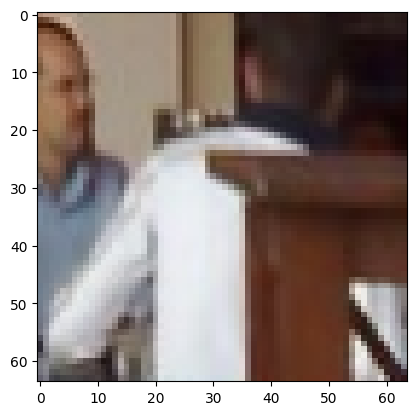

Истинный класс: House, Предсказанный класс: Building


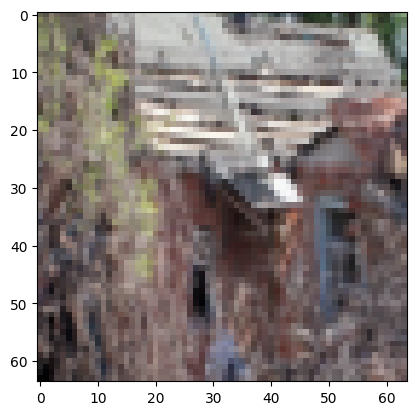

Истинный класс: Man, Предсказанный класс: Person


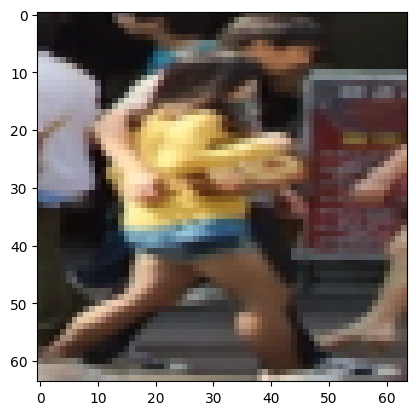

Истинный класс: Kitchen & dining room table, Предсказанный класс: Footwear


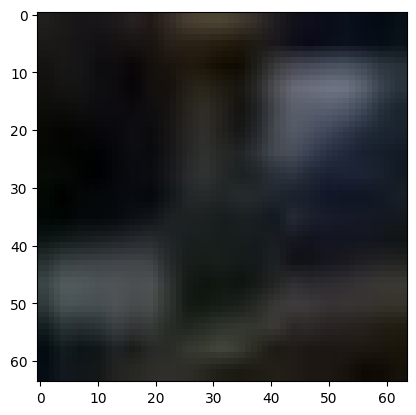

labels ---> tensor([108, 150,  25,  86])
predicted ---> tensor([164, 150,  25, 108])
total ---> 684
correct ---> 174
Истинный класс: Person, Предсказанный класс: Window


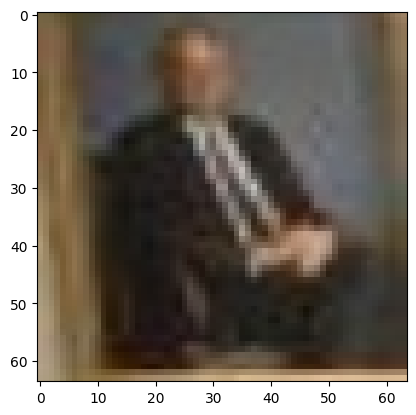

Истинный класс: Tree, Предсказанный класс: Tree


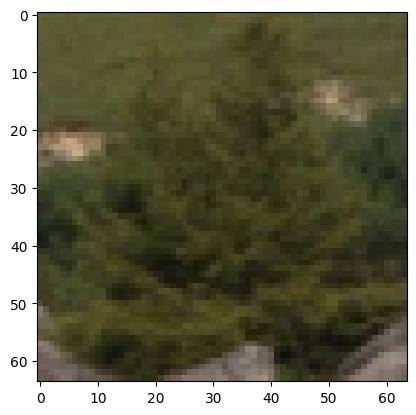

Истинный класс: Building, Предсказанный класс: Building


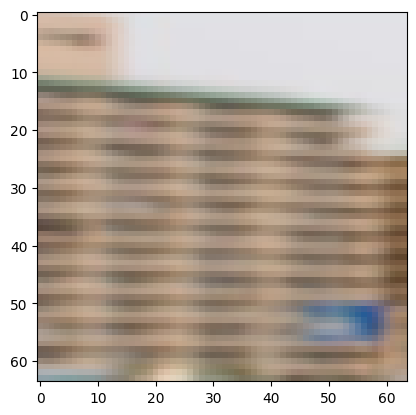

Истинный класс: Kitchen appliance, Предсказанный класс: Person


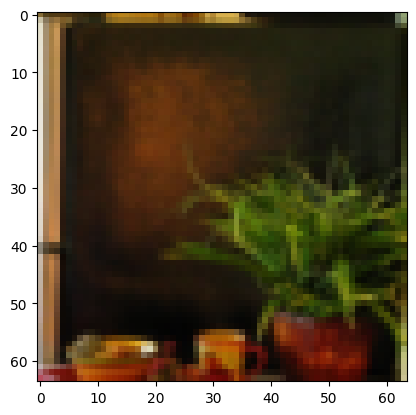

labels ---> tensor([108, 156, 136,  72])
predicted ---> tensor([108, 108, 108, 108])
total ---> 688
correct ---> 175
Истинный класс: Person, Предсказанный класс: Person


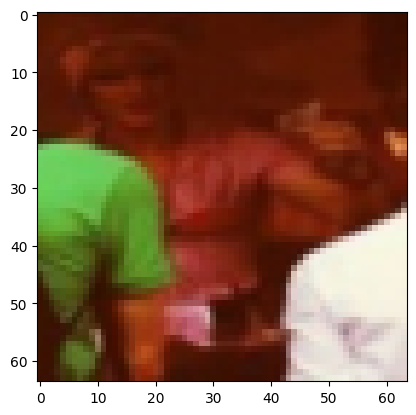

Истинный класс: Vehicle, Предсказанный класс: Person


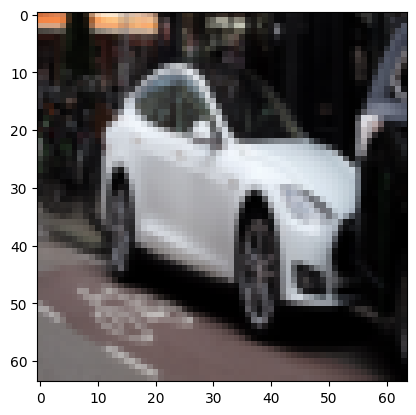

Истинный класс: Table, Предсказанный класс: Person


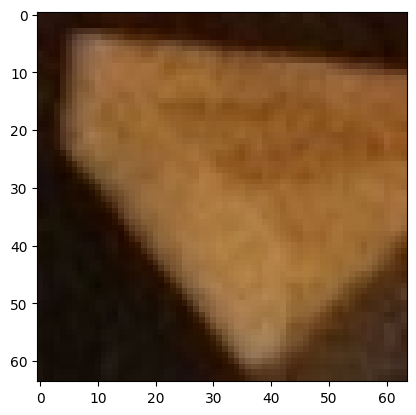

Истинный класс: Human body, Предсказанный класс: Person


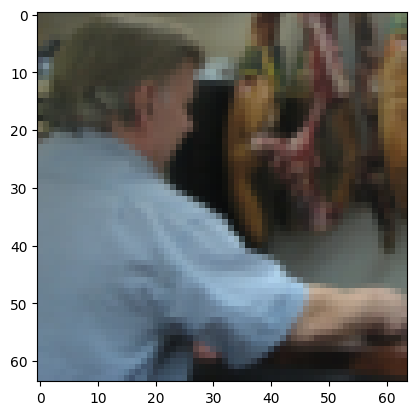

labels ---> tensor([136,  36,  63, 164])
predicted ---> tensor([ 25,  69, 164, 164])
total ---> 692
correct ---> 176
Истинный класс: Table, Предсказанный класс: Building


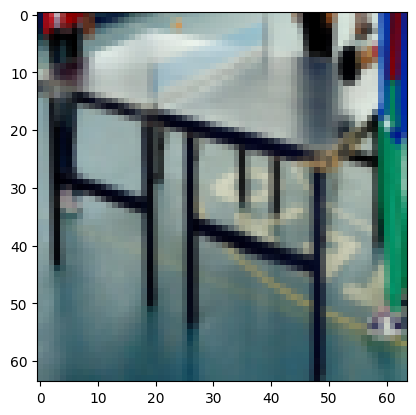

Истинный класс: Clothing, Предсказанный класс: House


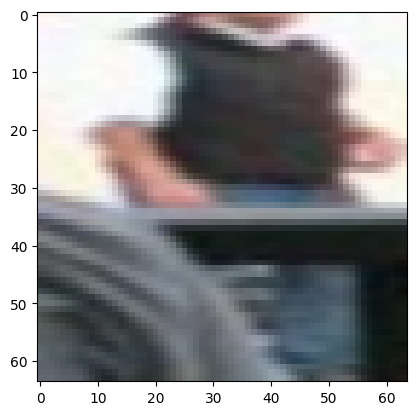

Истинный класс: Furniture, Предсказанный класс: Window


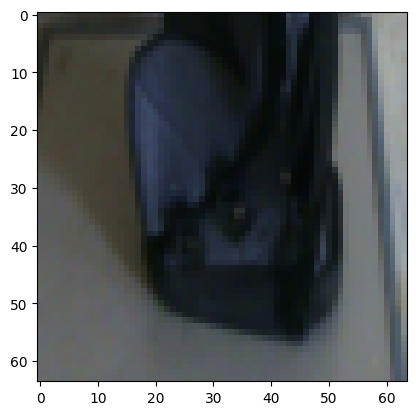

Истинный класс: Window, Предсказанный класс: Window


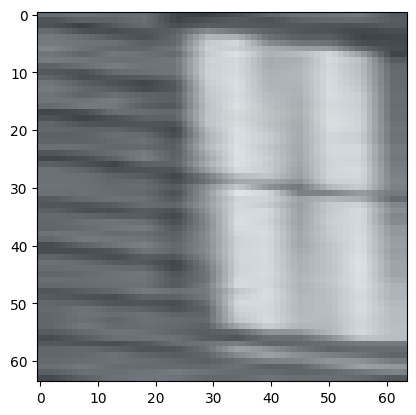

labels ---> tensor([ 68,  70, 162, 162])
predicted ---> tensor([162,  25, 162, 164])
total ---> 696
correct ---> 177
Истинный класс: Home appliance, Предсказанный класс: Wheel


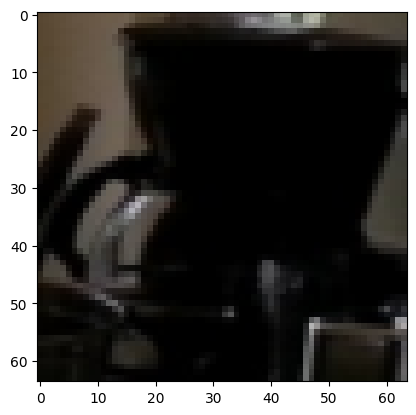

Истинный класс: Houseplant, Предсказанный класс: Building


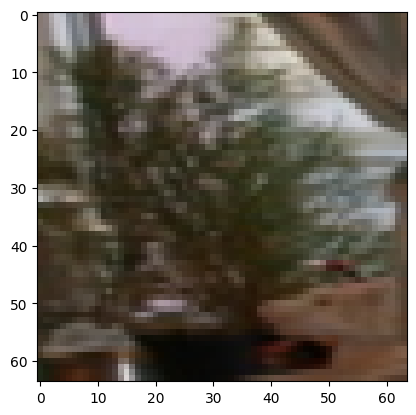

Истинный класс: Wheel, Предсказанный класс: Wheel


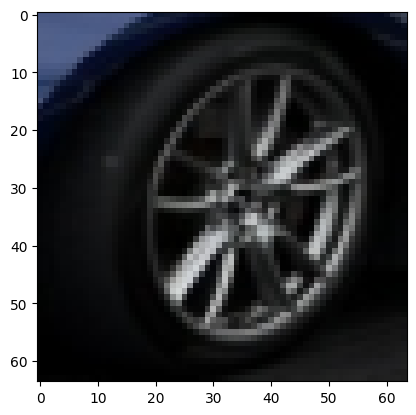

Истинный класс: Wheel, Предсказанный класс: Window


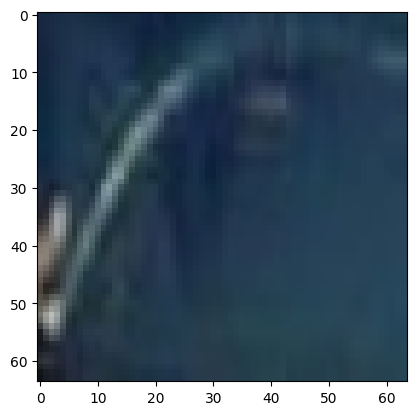

labels ---> tensor([162, 150,  25,  36])
predicted ---> tensor([ 61, 150,  25, 164])
total ---> 700
correct ---> 179
Истинный класс: Wheel, Предсказанный класс: Footwear


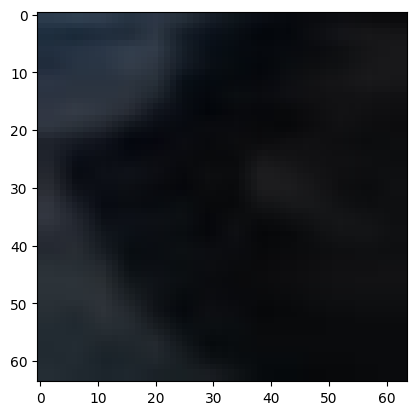

Истинный класс: Tree, Предсказанный класс: Tree


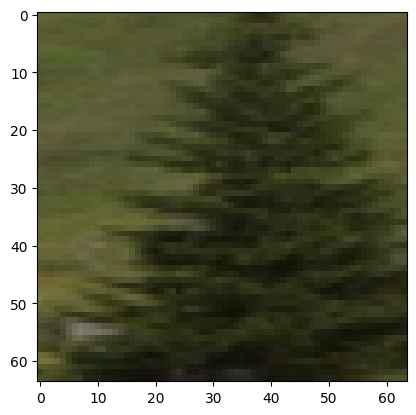

Истинный класс: Building, Предсказанный класс: Building


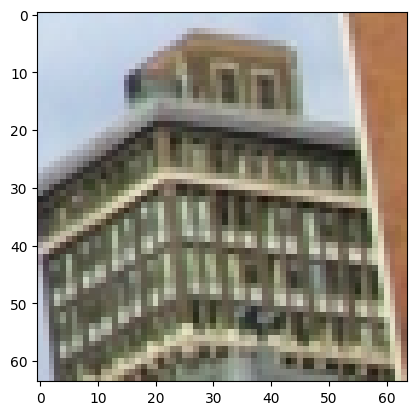

Истинный класс: Clothing, Предсказанный класс: Window


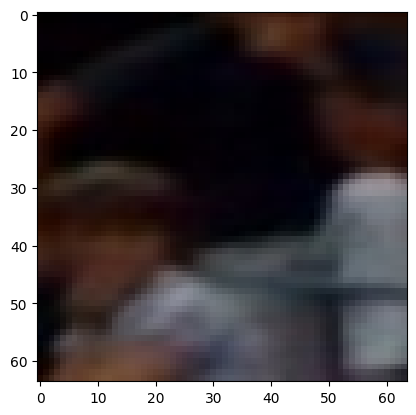

labels ---> tensor([ 17, 147, 108,  43])
predicted ---> tensor([ 25,  29, 108,  74])
total ---> 704
correct ---> 180
Истинный класс: Book, Предсказанный класс: Building


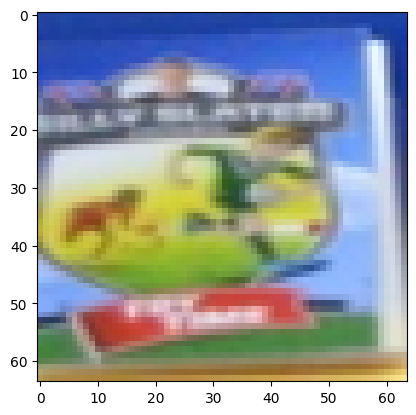

Истинный класс: Toy, Предсказанный класс: Car


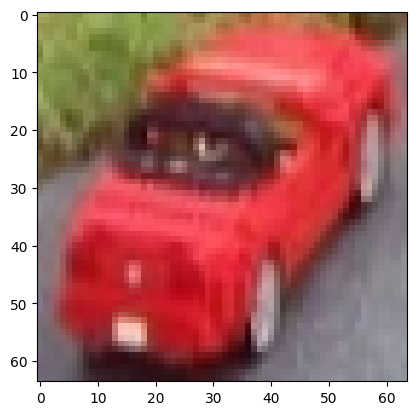

Истинный класс: Person, Предсказанный класс: Person


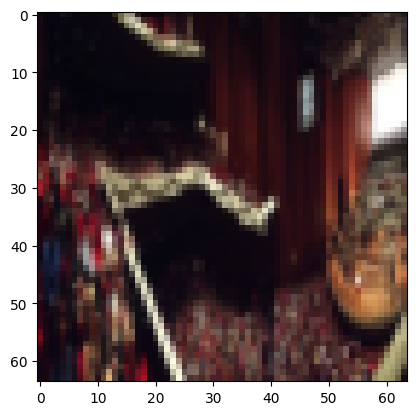

Истинный класс: Cupboard, Предсказанный класс: Human eye


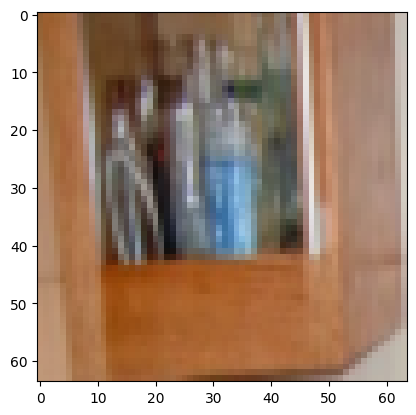

labels ---> tensor([150,  95,  25,  47])
predicted ---> tensor([108, 164,  25,  69])
total ---> 708
correct ---> 181
Истинный класс: Tree, Предсказанный класс: Person


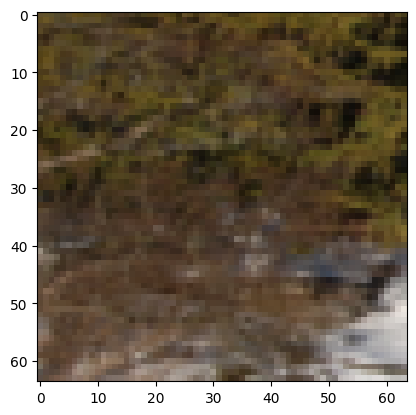

Истинный класс: Mammal, Предсказанный класс: Window


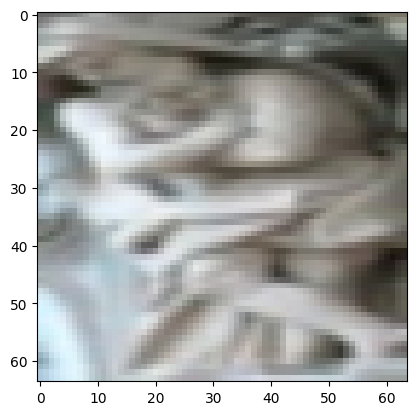

Истинный класс: Building, Предсказанный класс: Building


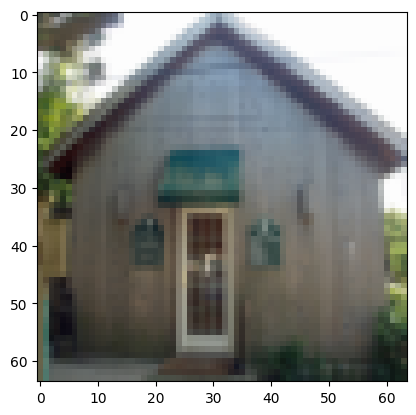

Истинный класс: Door, Предсказанный класс: House


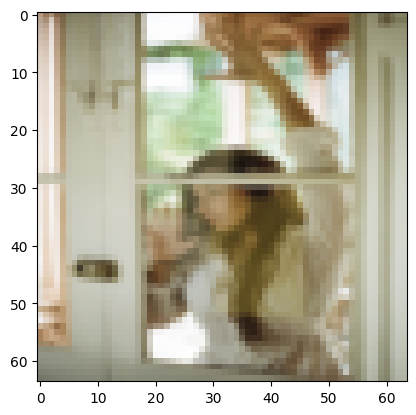

labels ---> tensor([ 23,  25, 164,   3])
predicted ---> tensor([108,  25, 164, 108])
total ---> 712
correct ---> 183
Истинный класс: Boy, Предсказанный класс: Person


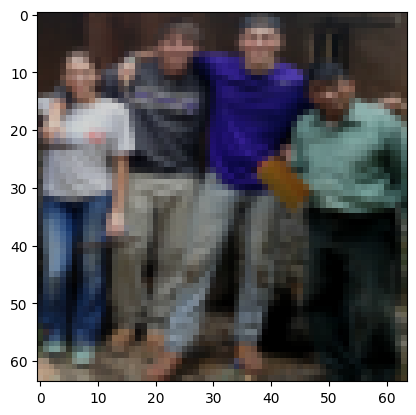

Истинный класс: Building, Предсказанный класс: Building


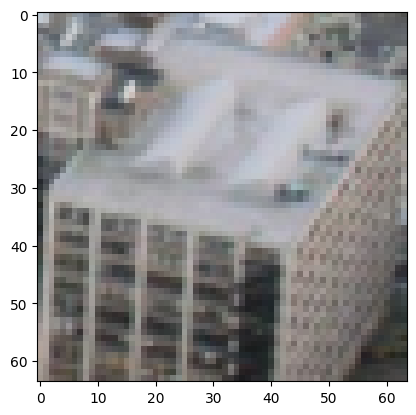

Истинный класс: Window, Предсказанный класс: Window


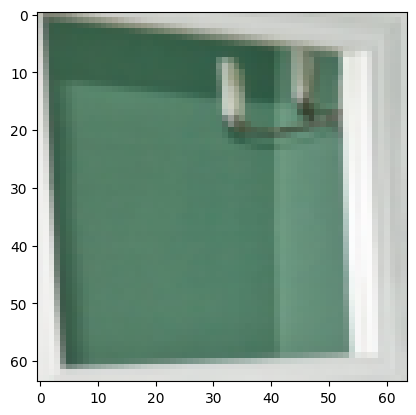

Истинный класс: Baked goods, Предсказанный класс: Person


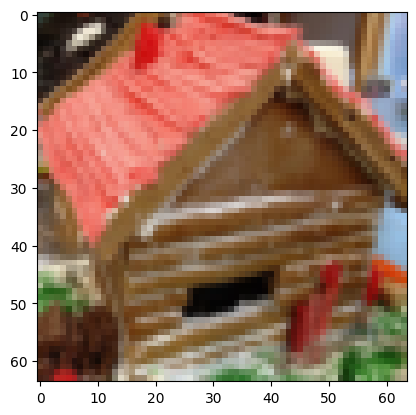

labels ---> tensor([108, 164, 108,  87])
predicted ---> tensor([164, 164,  25, 108])
total ---> 716
correct ---> 184
Истинный класс: Person, Предсказанный класс: Window


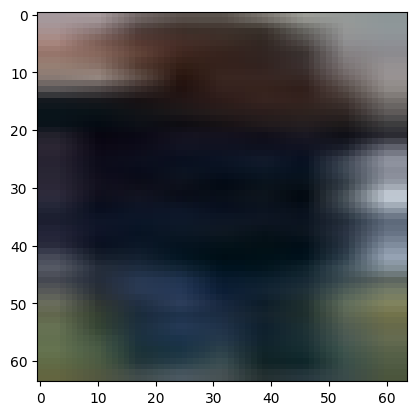

Истинный класс: Window, Предсказанный класс: Window


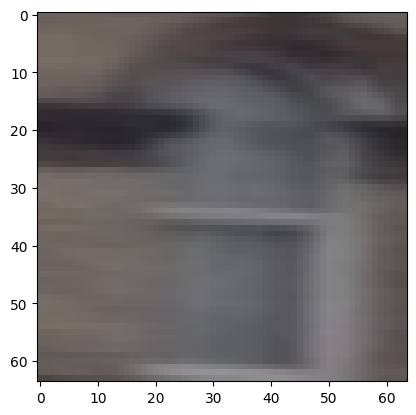

Истинный класс: Person, Предсказанный класс: Building


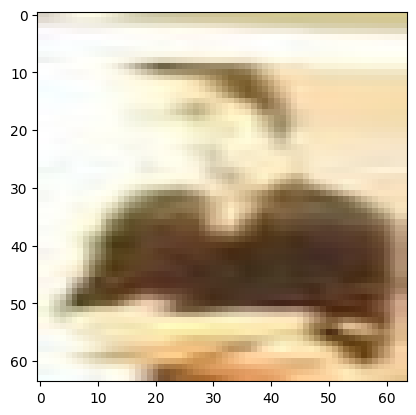

Истинный класс: Ladder, Предсказанный класс: Person


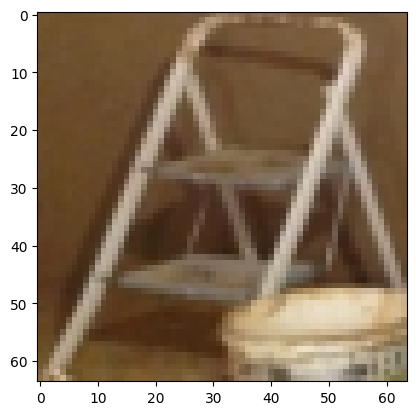

labels ---> tensor([ 58, 164, 164, 168])
predicted ---> tensor([108, 164, 164, 108])
total ---> 720
correct ---> 186
Истинный класс: Flower, Предсказанный класс: Person


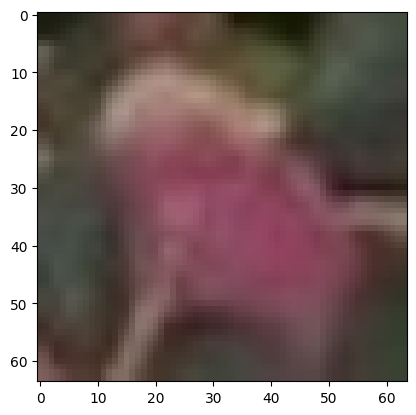

Истинный класс: Window, Предсказанный класс: Window


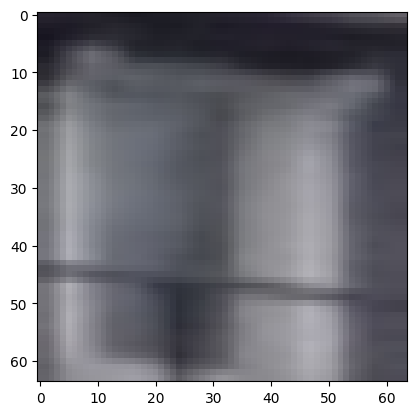

Истинный класс: Window, Предсказанный класс: Window


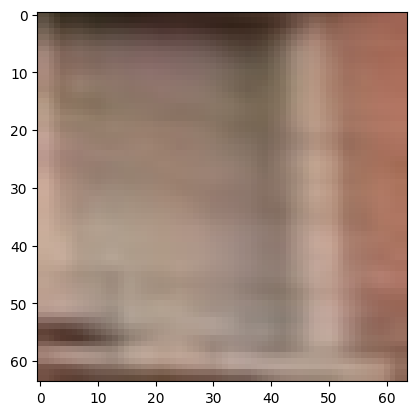

Истинный класс: Woman, Предсказанный класс: Person


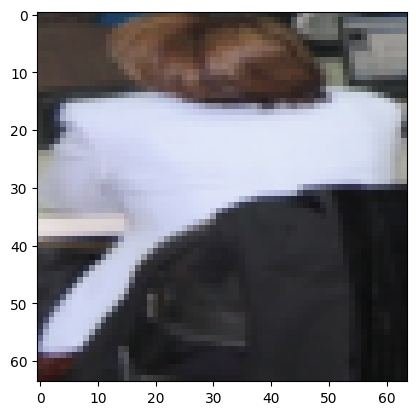

labels ---> tensor([125, 147, 141, 164])
predicted ---> tensor([ 25,  69, 164, 164])
total ---> 724
correct ---> 187
Истинный класс: Skyscraper, Предсказанный класс: Building


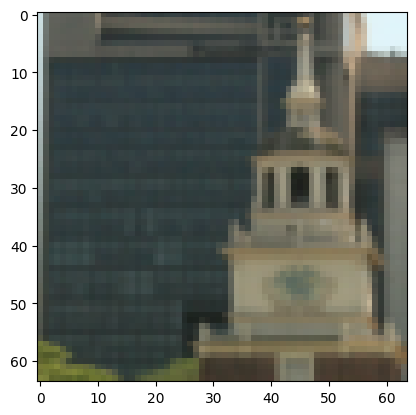

Истинный класс: Toy, Предсказанный класс: House


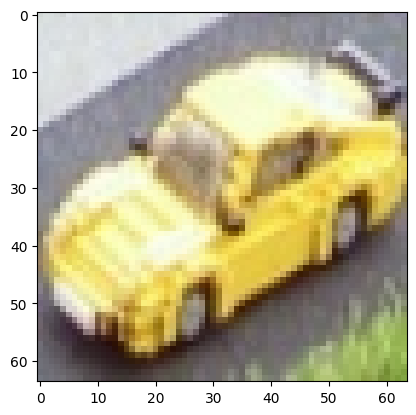

Истинный класс: Television, Предсказанный класс: Window


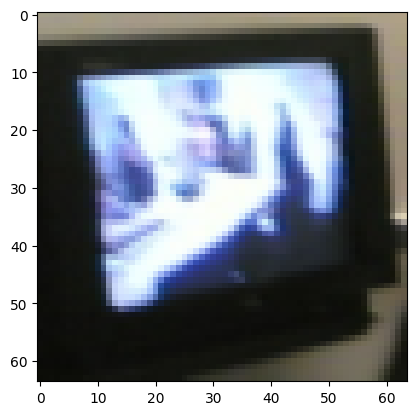

Истинный класс: Window, Предсказанный класс: Window


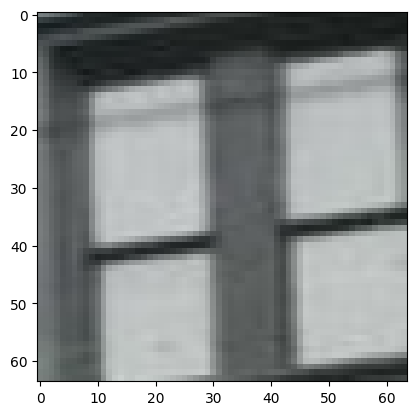

labels ---> tensor([58, 53, 76, 69])
predicted ---> tensor([ 77, 164,  61, 164])
total ---> 728
correct ---> 187
Истинный класс: Flower, Предсказанный класс: Human hand


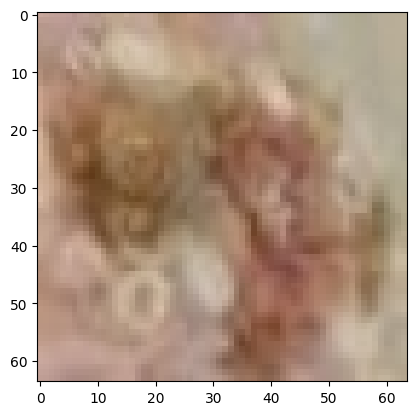

Истинный класс: Fashion accessory, Предсказанный класс: Window


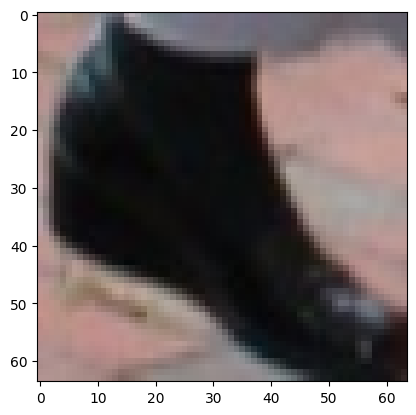

Истинный класс: Human hair, Предсказанный класс: Footwear


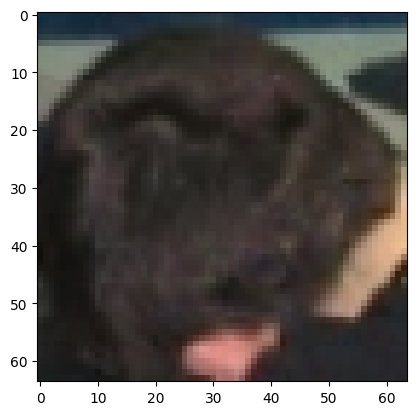

Истинный класс: House, Предсказанный класс: Window


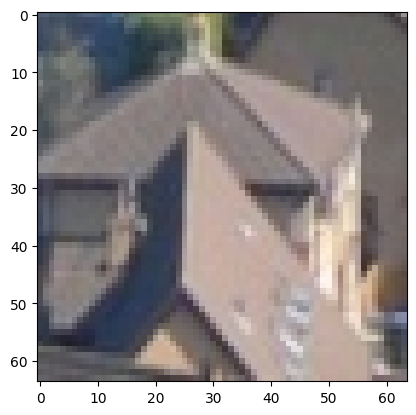

labels ---> tensor([ 36, 143,  69,  63])
predicted ---> tensor([108, 164,  25, 164])
total ---> 732
correct ---> 187
Истинный класс: Clothing, Предсказанный класс: Person


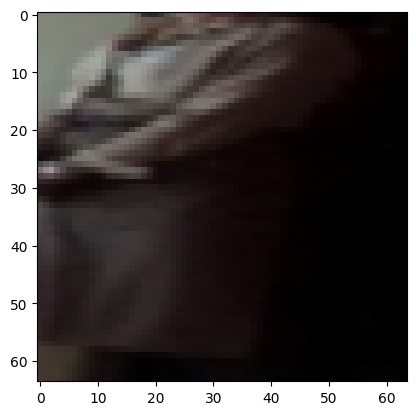

Истинный класс: Tie, Предсказанный класс: Window


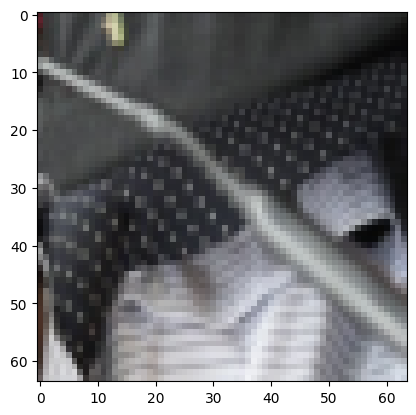

Истинный класс: House, Предсказанный класс: Building


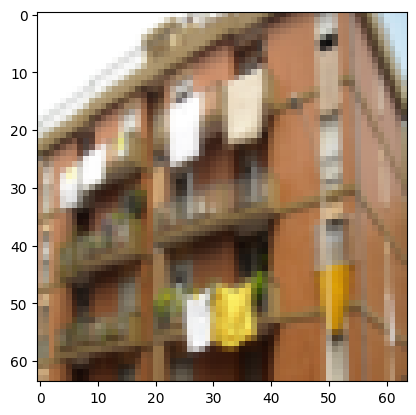

Истинный класс: Furniture, Предсказанный класс: Window


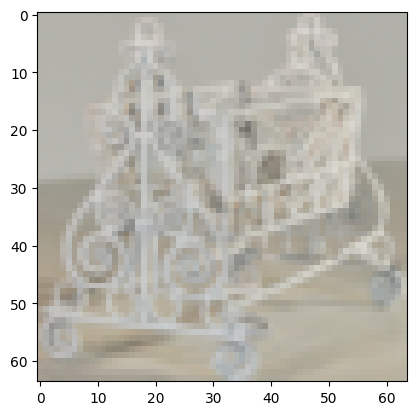

labels ---> tensor([164,  77,  29,  63])
predicted ---> tensor([164, 164, 108,  25])
total ---> 736
correct ---> 188
Истинный класс: Window, Предсказанный класс: Window


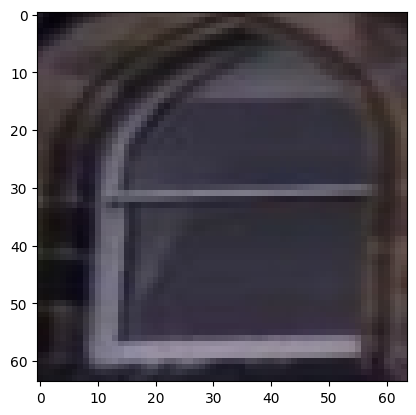

Истинный класс: Human hand, Предсказанный класс: Window


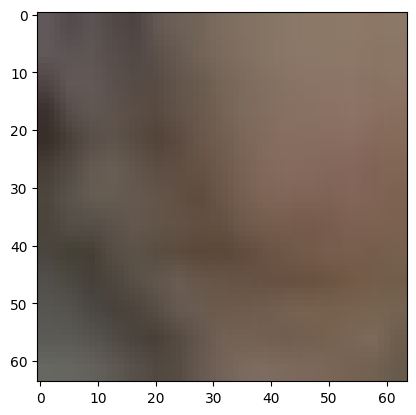

Истинный класс: Car, Предсказанный класс: Person


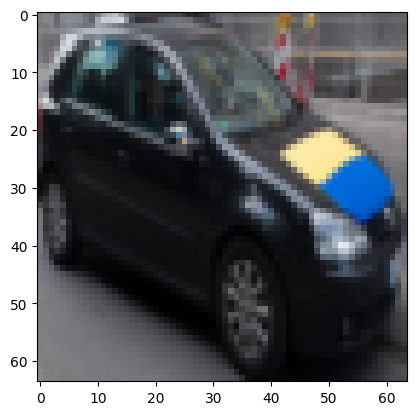

Истинный класс: Furniture, Предсказанный класс: Building


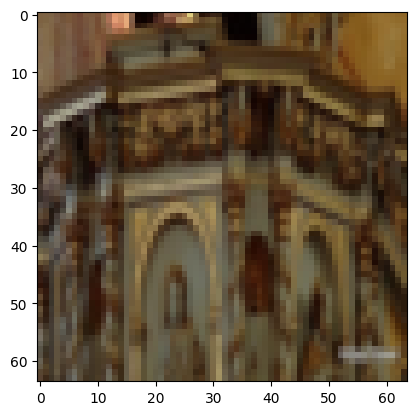

labels ---> tensor([ 25, 164,  36,  69])
predicted ---> tensor([ 69, 164,  25,  25])
total ---> 740
correct ---> 189
Истинный класс: Building, Предсказанный класс: House


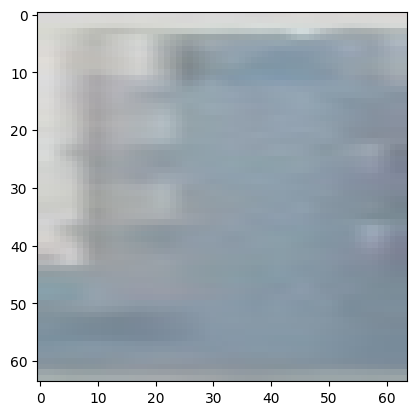

Истинный класс: Window, Предсказанный класс: Window


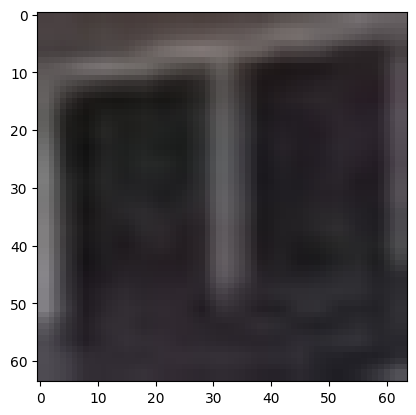

Истинный класс: Clothing, Предсказанный класс: Building


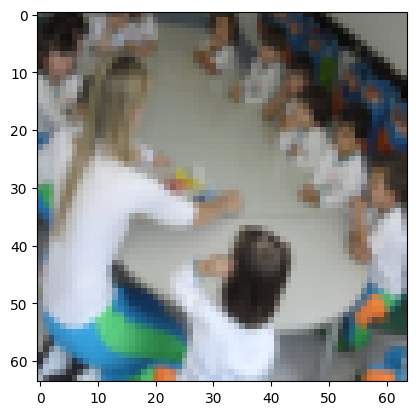

Истинный класс: House, Предсказанный класс: Building


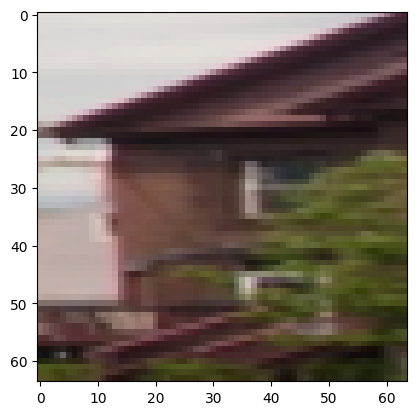

labels ---> tensor([ 25, 156,  65, 147])
predicted ---> tensor([ 25, 164,  25, 150])
total ---> 744
correct ---> 190
Истинный класс: Building, Предсказанный класс: Building


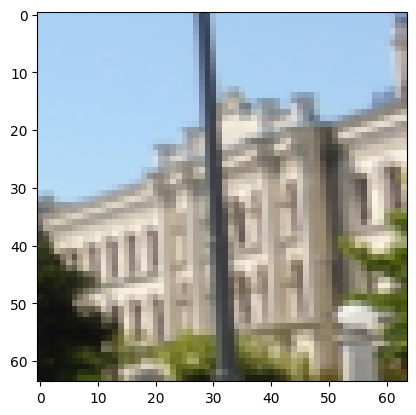

Истинный класс: Vehicle, Предсказанный класс: Window


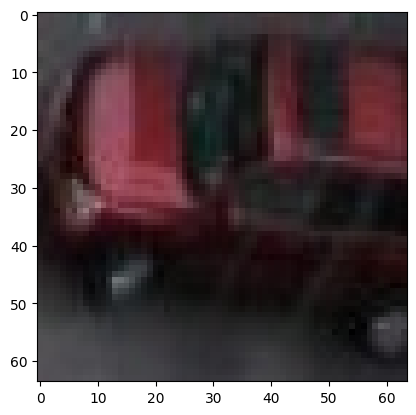

Истинный класс: Girl, Предсказанный класс: Building


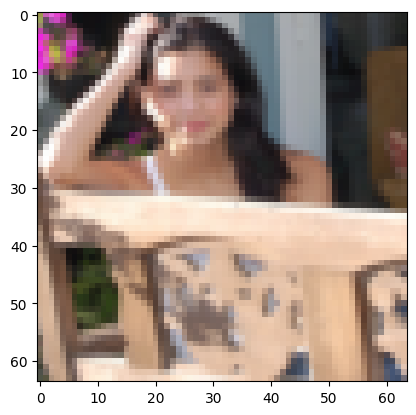

Истинный класс: Toy, Предсказанный класс: Tree


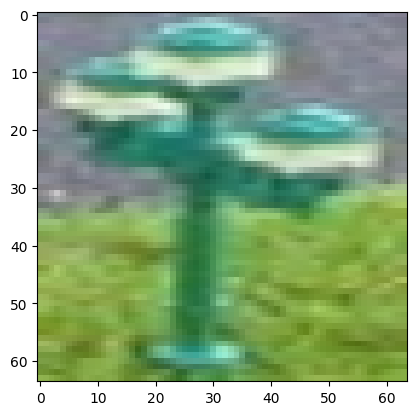

labels ---> tensor([164,  25,  69, 108])
predicted ---> tensor([164, 164,  25, 108])
total ---> 748
correct ---> 192
Истинный класс: Window, Предсказанный класс: Window


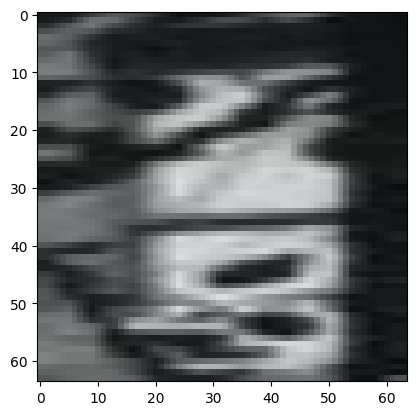

Истинный класс: Building, Предсказанный класс: Window


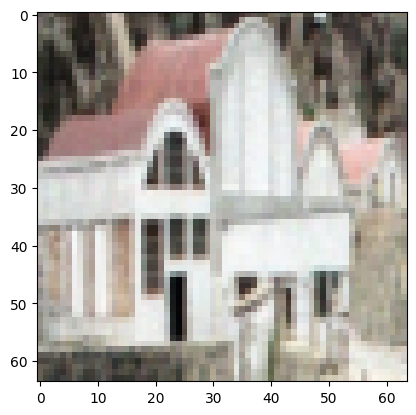

Истинный класс: House, Предсказанный класс: Building


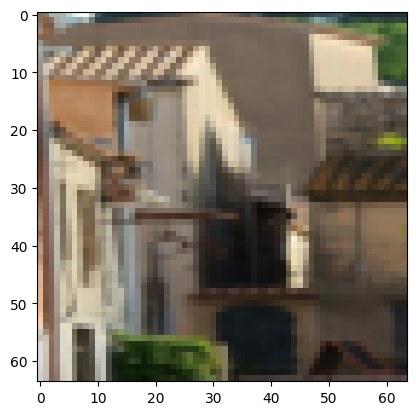

Истинный класс: Person, Предсказанный класс: Person


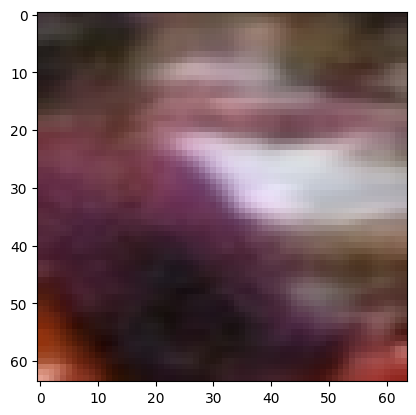

labels ---> tensor([ 25, 114, 164,  72])
predicted ---> tensor([ 69, 108, 164, 108])
total ---> 752
correct ---> 193
Истинный класс: Building, Предсказанный класс: House


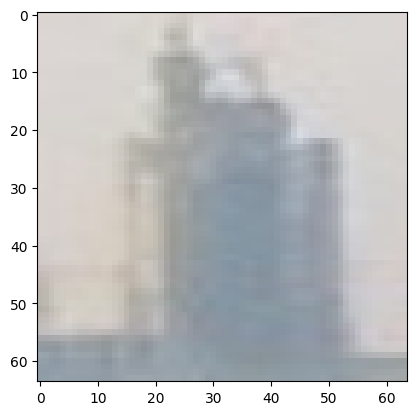

Истинный класс: Poster, Предсказанный класс: Person


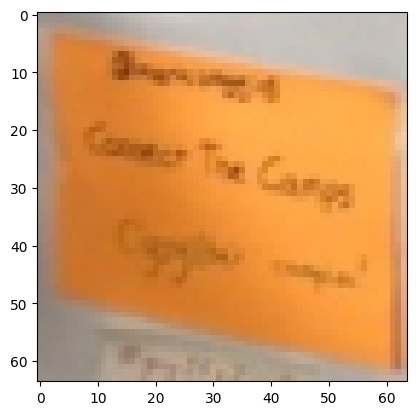

Истинный класс: Window, Предсказанный класс: Window


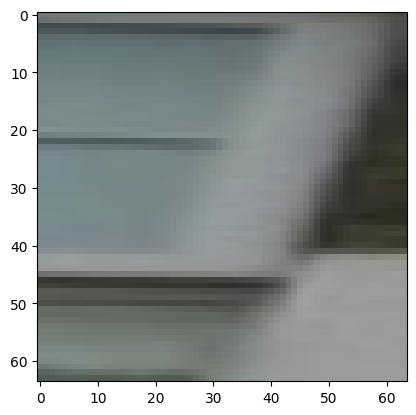

Истинный класс: Human body, Предсказанный класс: Person


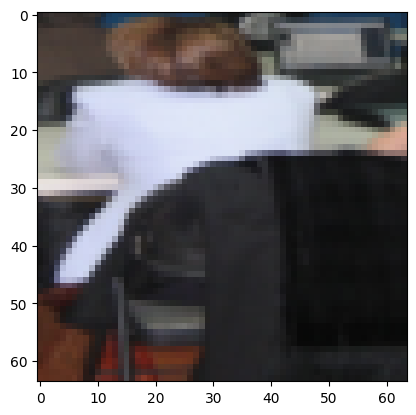

labels ---> tensor([ 63, 108, 112,  29])
predicted ---> tensor([164,  69, 150, 108])
total ---> 756
correct ---> 193
Истинный класс: Furniture, Предсказанный класс: Window


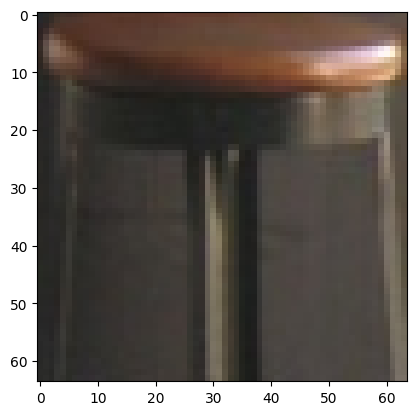

Истинный класс: Person, Предсказанный класс: House


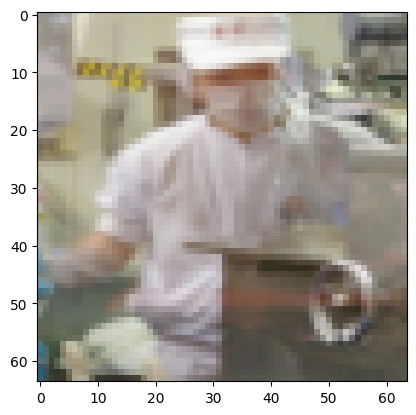

Истинный класс: Plant, Предсказанный класс: Tree


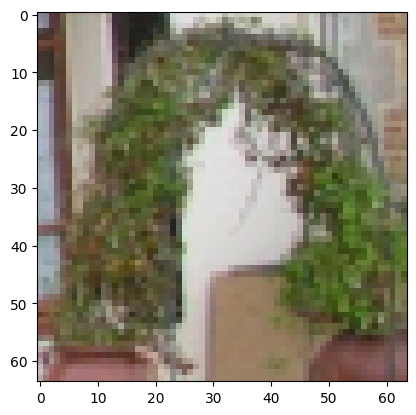

Истинный класс: Car, Предсказанный класс: Person


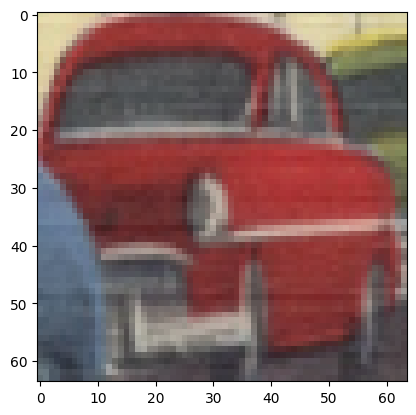

labels ---> tensor([ 76, 164,  61, 108])
predicted ---> tensor([108, 164, 164,  25])
total ---> 760
correct ---> 194
Истинный класс: Human hair, Предсказанный класс: Person


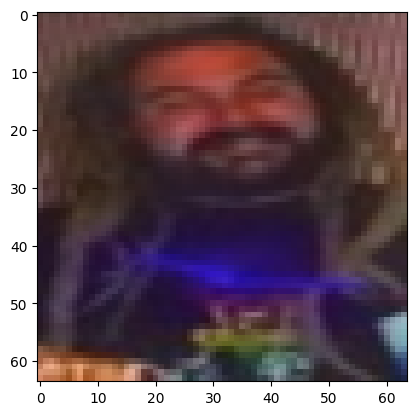

Истинный класс: Window, Предсказанный класс: Window


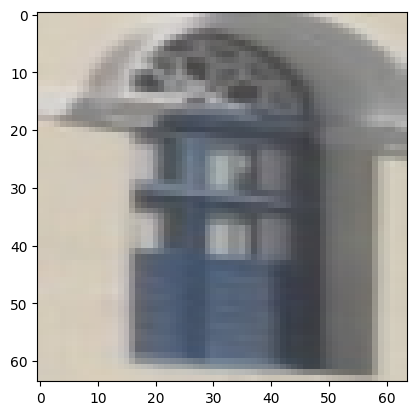

Истинный класс: Footwear, Предсказанный класс: Window


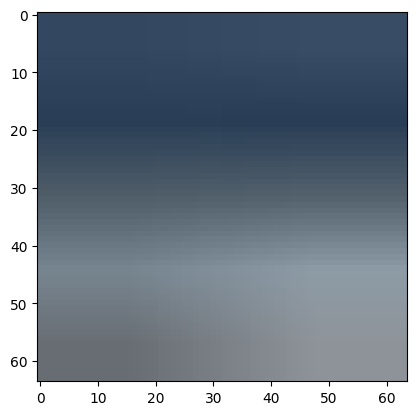

Истинный класс: Person, Предсказанный класс: Building


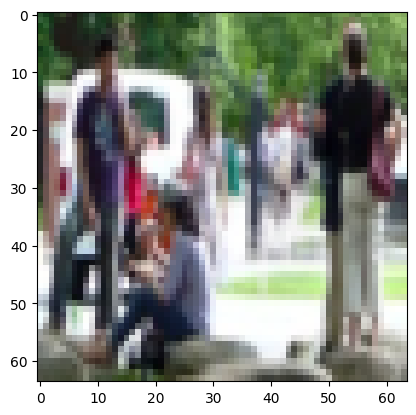

labels ---> tensor([ 95, 151, 164,  69])
predicted ---> tensor([108,  61, 164,  69])
total ---> 764
correct ---> 196
Истинный класс: Mammal, Предсказанный класс: Person


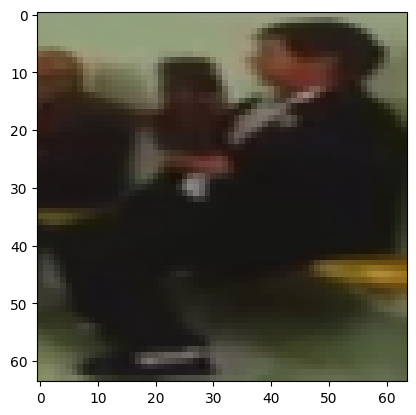

Истинный класс: Trousers, Предсказанный класс: Footwear


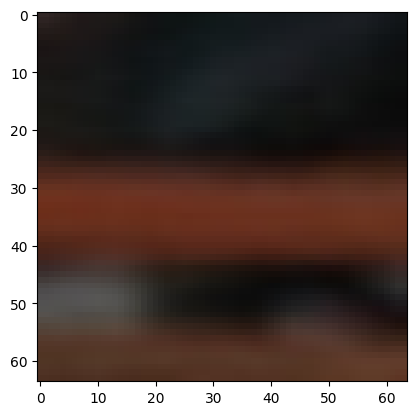

Истинный класс: Window, Предсказанный класс: Window


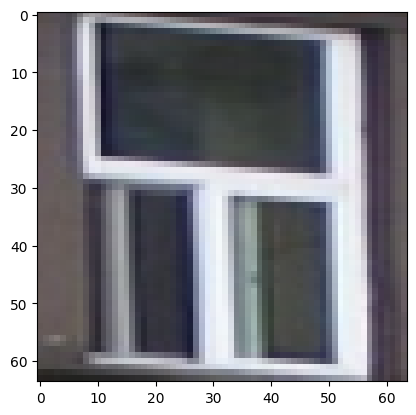

Истинный класс: House, Предсказанный класс: House


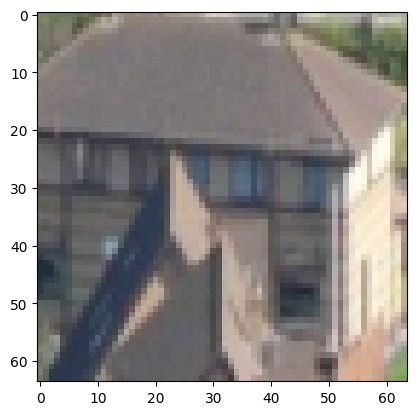

labels ---> tensor([61, 25, 25, 97])
predicted ---> tensor([164,  25,  25,  25])
total ---> 768
correct ---> 198
Истинный класс: Footwear, Предсказанный класс: Window


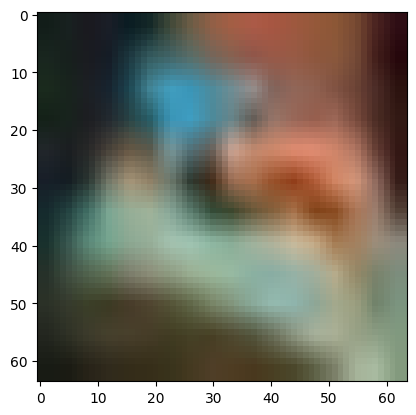

Истинный класс: Building, Предсказанный класс: Building


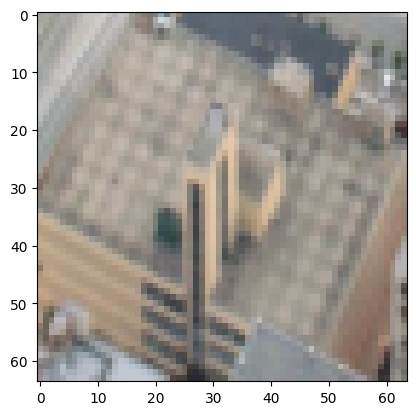

Истинный класс: Building, Предсказанный класс: Building


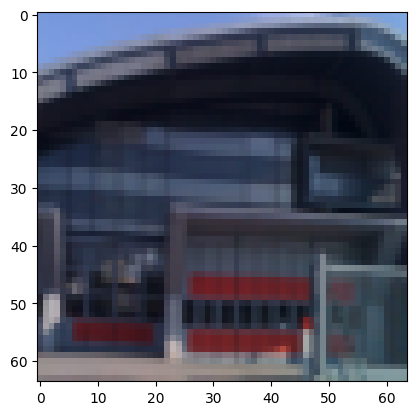

Истинный класс: Medical equipment, Предсказанный класс: Building


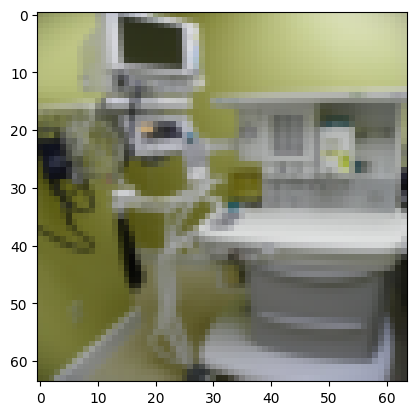

labels ---> tensor([104,  95,  92,  72])
predicted ---> tensor([ 25,  69,  92, 108])
total ---> 772
correct ---> 199
Истинный класс: Office building, Предсказанный класс: Building


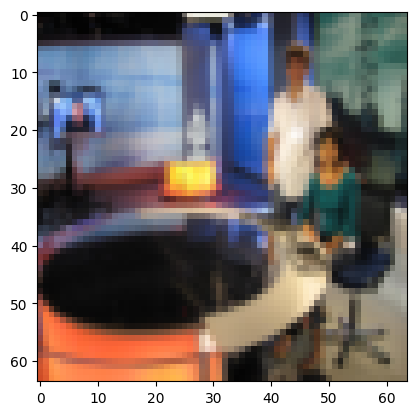

Истинный класс: Mammal, Предсказанный класс: House


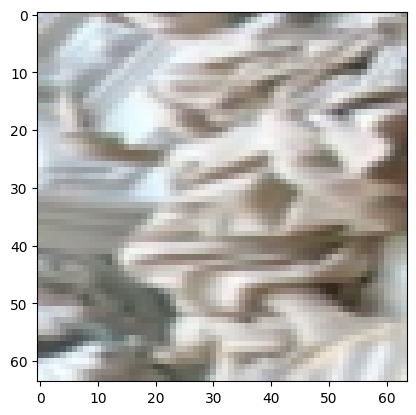

Истинный класс: Light bulb, Предсказанный класс: Light bulb


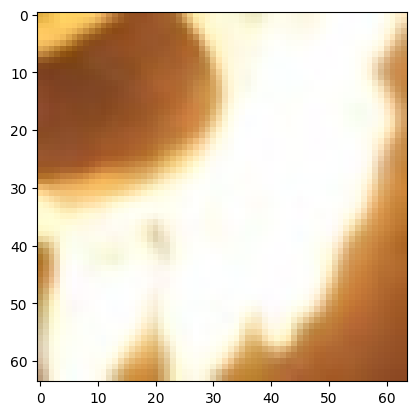

Истинный класс: Human body, Предсказанный класс: Person


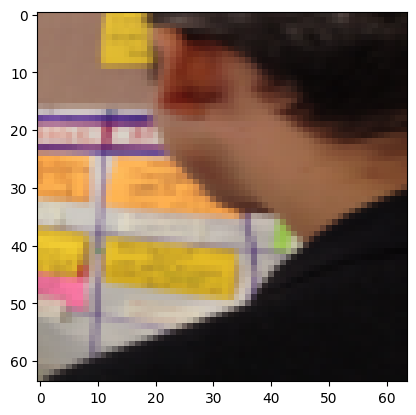

labels ---> tensor([59, 25, 36, 29])
predicted ---> tensor([150,  76, 108, 108])
total ---> 776
correct ---> 199
Истинный класс: Flowerpot, Предсказанный класс: Tree


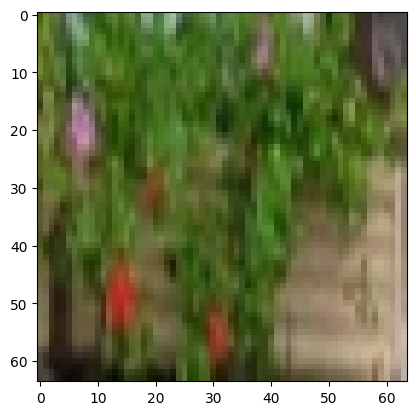

Истинный класс: Building, Предсказанный класс: Human hair


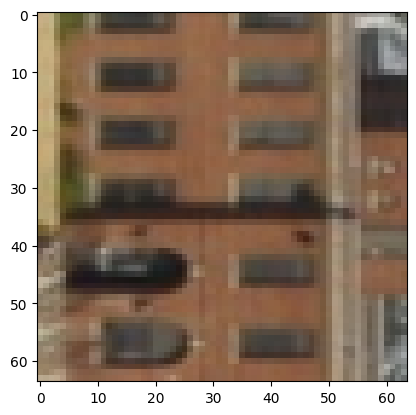

Истинный класс: Clothing, Предсказанный класс: Person


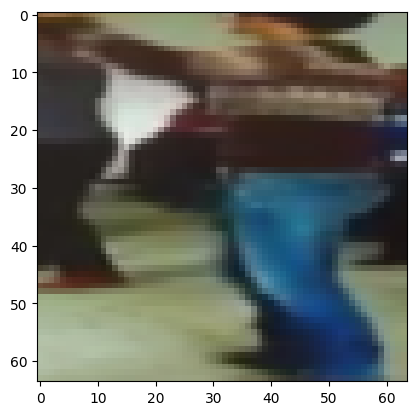

Истинный класс: Car, Предсказанный класс: Person


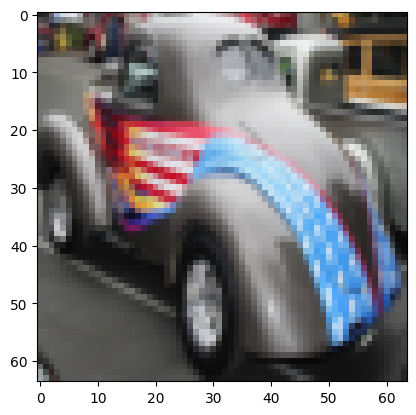

labels ---> tensor([108,  47,  76, 108])
predicted ---> tensor([108, 108,  63,  92])
total ---> 780
correct ---> 200
Истинный класс: Person, Предсказанный класс: Person


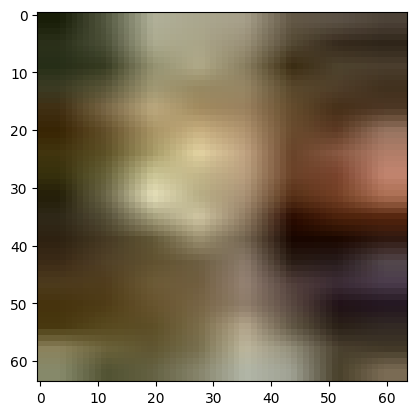

Истинный класс: Door, Предсказанный класс: Person


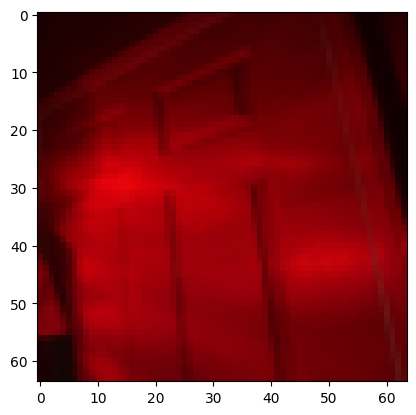

Истинный класс: Human hair, Предсказанный класс: Furniture


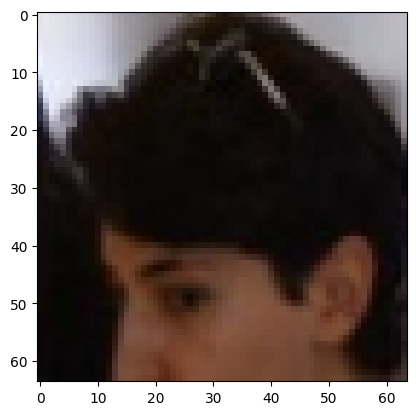

Истинный класс: Person, Предсказанный класс: Light bulb


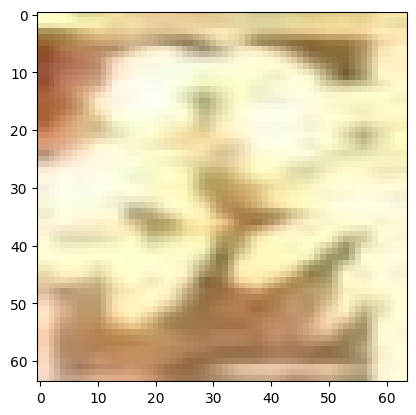

labels ---> tensor([150,  37, 164,  72])
predicted ---> tensor([ 25, 108, 164,  25])
total ---> 784
correct ---> 201
Истинный класс: Tree, Предсказанный класс: Building


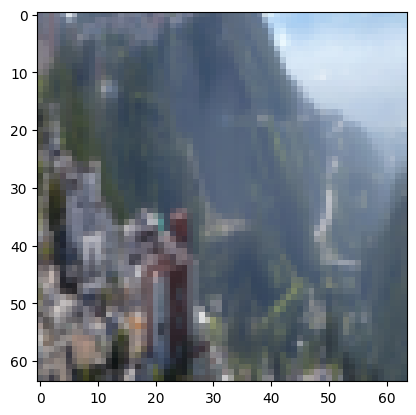

Истинный класс: Coffee table, Предсказанный класс: Person


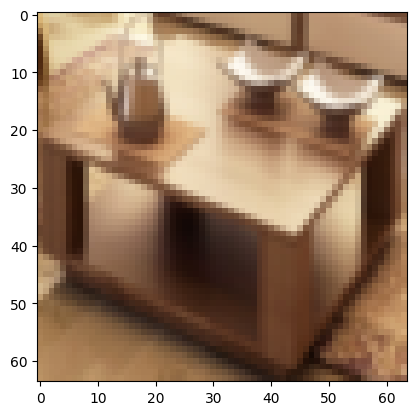

Истинный класс: Window, Предсказанный класс: Window


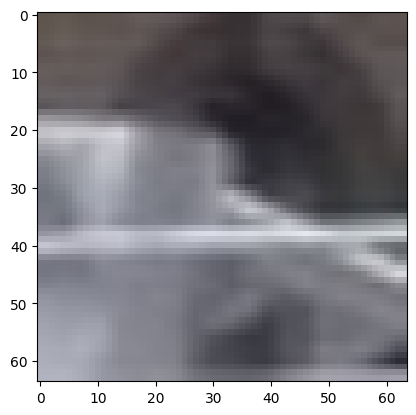

Истинный класс: Human body, Предсказанный класс: Building


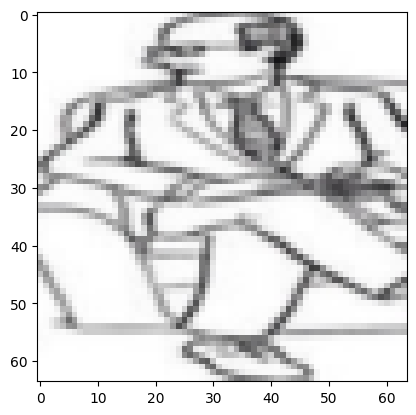

labels ---> tensor([144, 108,  58, 108])
predicted ---> tensor([164,  69, 108, 108])
total ---> 788
correct ---> 202
Истинный класс: Tire, Предсказанный класс: Window


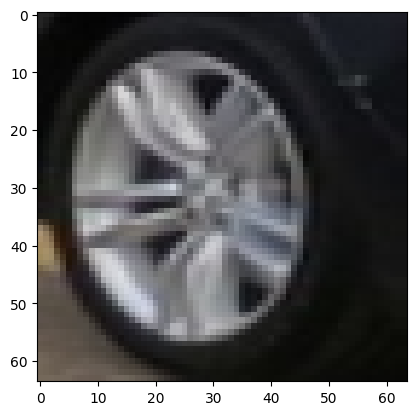

Истинный класс: Person, Предсказанный класс: House


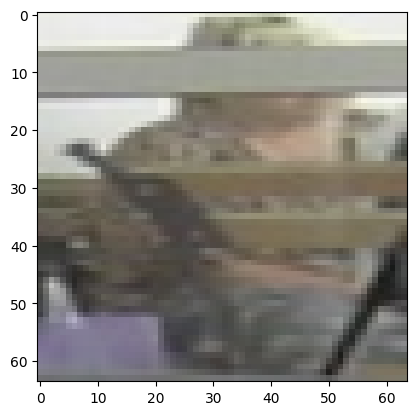

Истинный класс: Flower, Предсказанный класс: Person


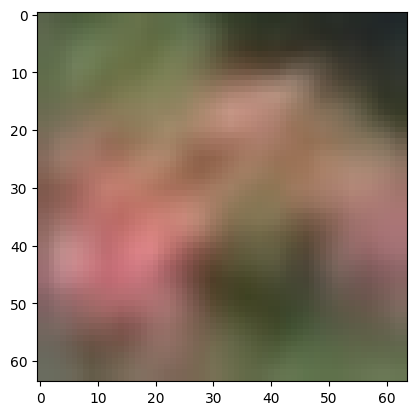

Истинный класс: Person, Предсказанный класс: Person


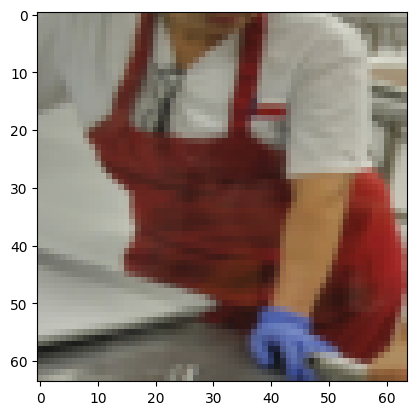

labels ---> tensor([ 45,  17, 164, 162])
predicted ---> tensor([ 25, 164, 164,  25])
total ---> 792
correct ---> 203
Истинный класс: Desk, Предсказанный класс: Building


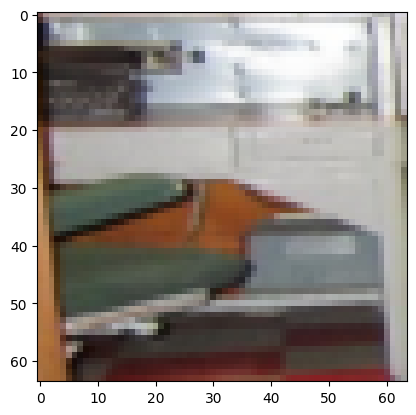

Истинный класс: Book, Предсказанный класс: Window


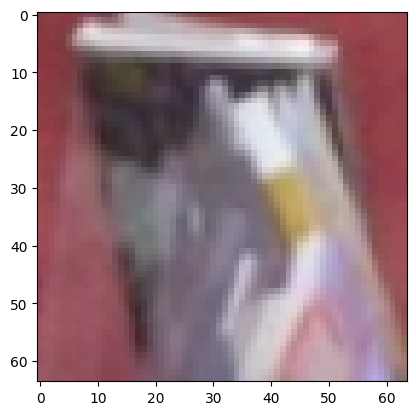

Истинный класс: Window, Предсказанный класс: Window


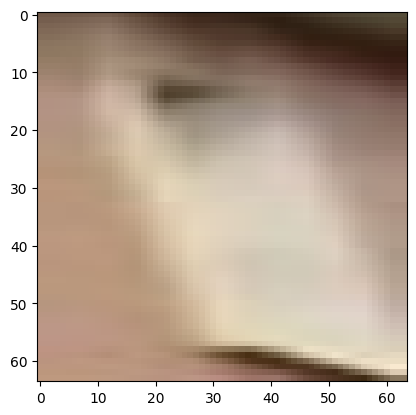

Истинный класс: Wheel, Предсказанный класс: Building


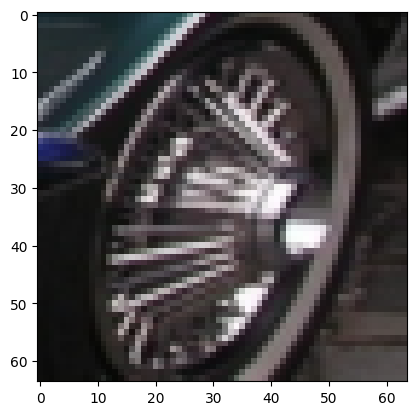

labels ---> tensor([ 45,  29, 136,  61])
predicted ---> tensor([ 25, 164,  25,  61])
total ---> 796
correct ---> 204
Истинный класс: Desk, Предсказанный класс: Building


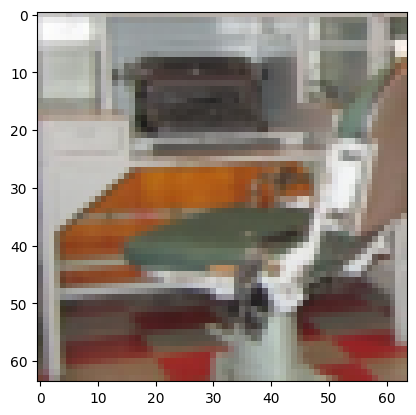

Истинный класс: Car, Предсказанный класс: Window


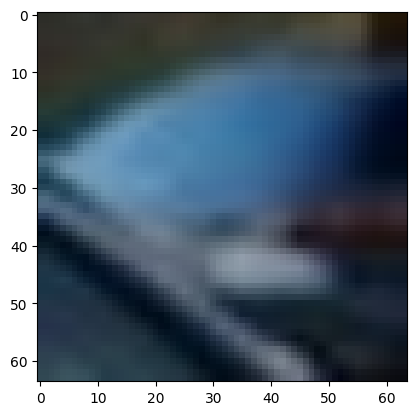

Истинный класс: Table, Предсказанный класс: Building


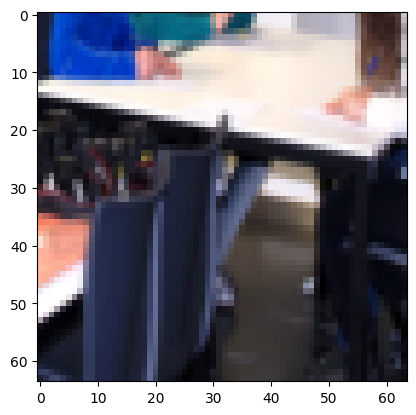

Истинный класс: Footwear, Предсказанный класс: Footwear


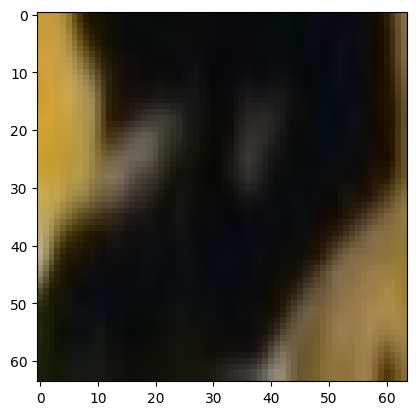

labels ---> tensor([150, 164, 143, 164])
predicted ---> tensor([ 25, 164, 108, 164])
total ---> 800
correct ---> 206
Истинный класс: Tree, Предсказанный класс: Building


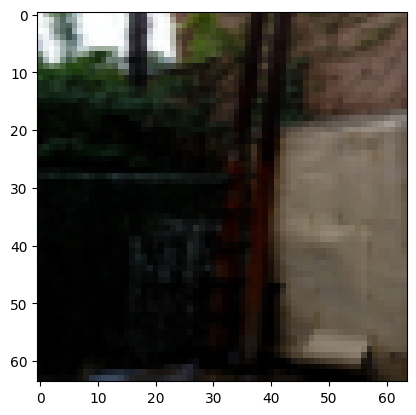

Истинный класс: Window, Предсказанный класс: Window


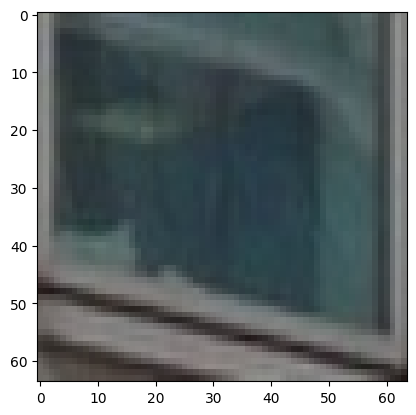

Истинный класс: Tie, Предсказанный класс: Person


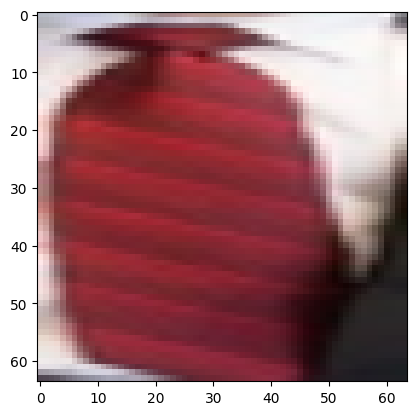

Истинный класс: Window, Предсказанный класс: Window


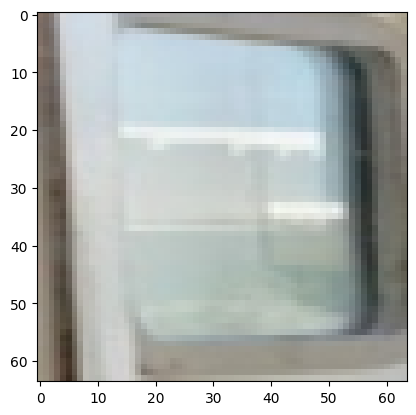

labels ---> tensor([ 83, 119, 150,  96])
predicted ---> tensor([ 61, 108,  69, 108])
total ---> 804
correct ---> 206
Истинный класс: Jeans, Предсказанный класс: Footwear


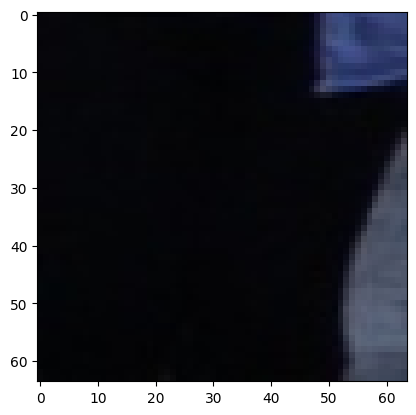

Истинный класс: Shelf, Предсказанный класс: Person


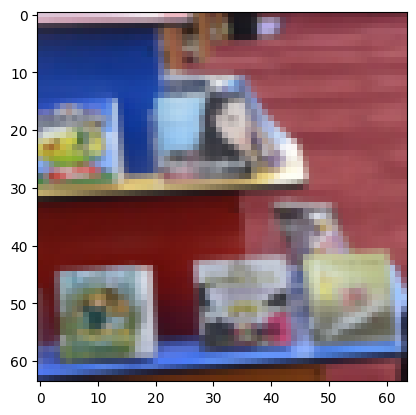

Истинный класс: Tree, Предсказанный класс: House


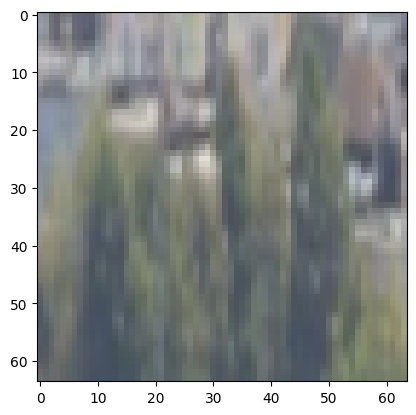

Истинный класс: Man, Предсказанный класс: Person


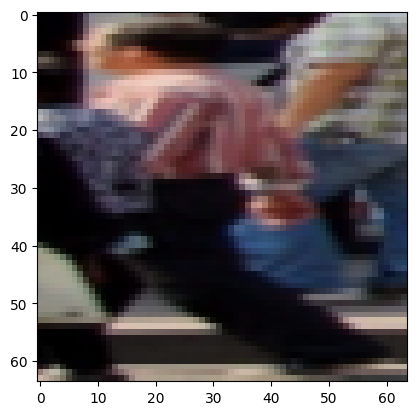

labels ---> tensor([164, 108,  63,  83])
predicted ---> tensor([164,  61, 108, 164])
total ---> 808
correct ---> 207
Истинный класс: Window, Предсказанный класс: Window


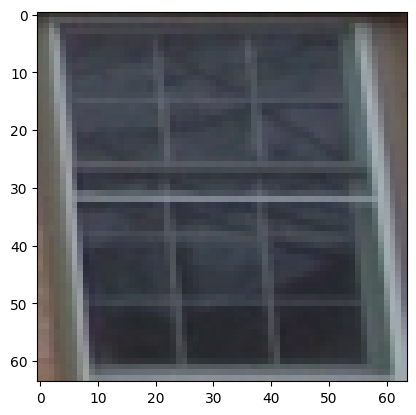

Истинный класс: Person, Предсказанный класс: Footwear


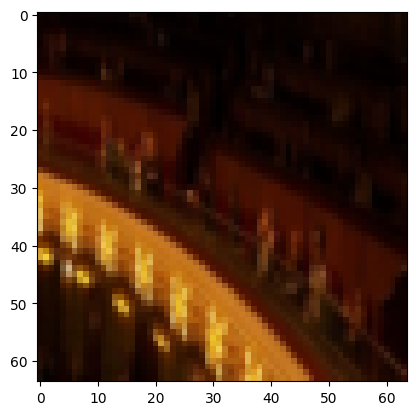

Истинный класс: Furniture, Предсказанный класс: Person


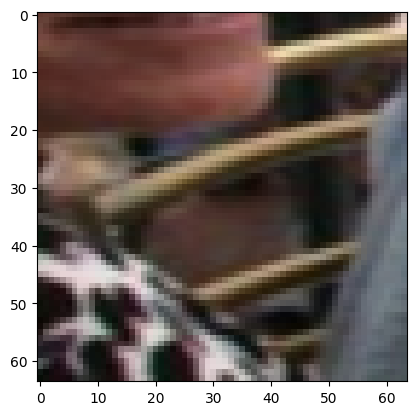

Истинный класс: Jeans, Предсказанный класс: Window


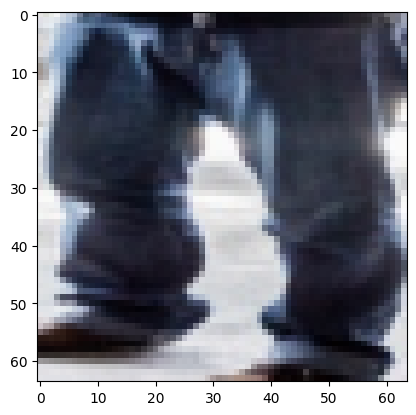

labels ---> tensor([ 70, 164, 164,  77])
predicted ---> tensor([108, 164, 164, 164])
total ---> 812
correct ---> 209
Истинный класс: Houseplant, Предсказанный класс: Person


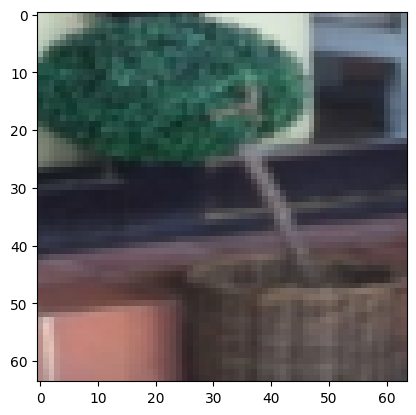

Истинный класс: Window, Предсказанный класс: Window


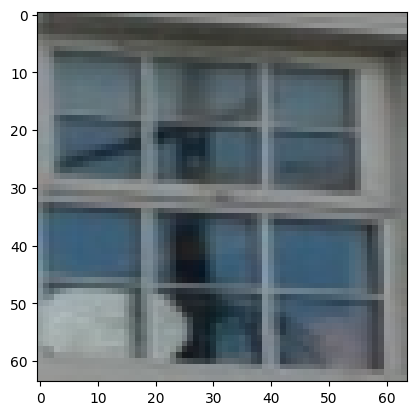

Истинный класс: Window, Предсказанный класс: Window


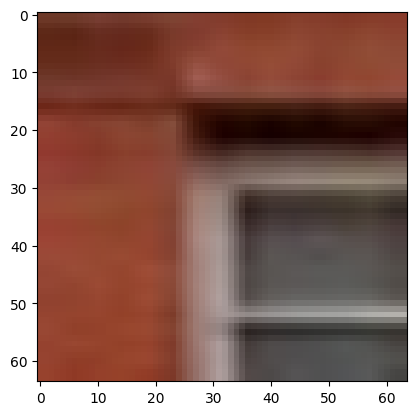

Истинный класс: Human hand, Предсказанный класс: Window


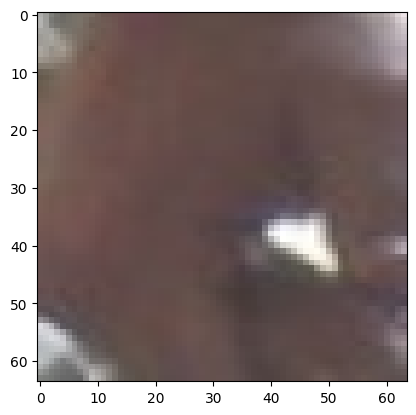

labels ---> tensor([ 77,  69, 162,  29])
predicted ---> tensor([ 76, 164, 108, 108])
total ---> 816
correct ---> 209
Истинный класс: Human hand, Предсказанный класс: Human hair


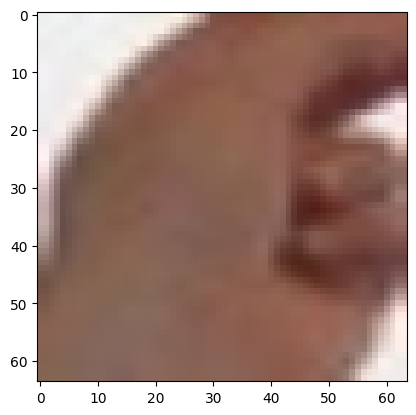

Истинный класс: House, Предсказанный класс: Window


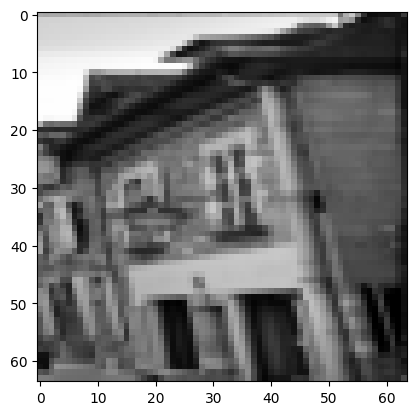

Истинный класс: Wheel, Предсказанный класс: Person


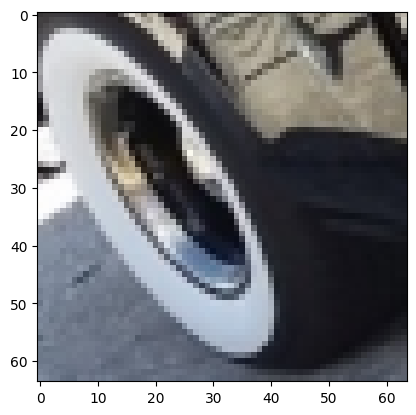

Истинный класс: Car, Предсказанный класс: Person


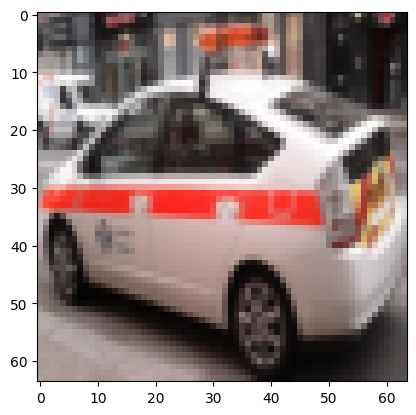

labels ---> tensor([164, 164, 164, 164])
predicted ---> tensor([164, 164,  25,  61])
total ---> 820
correct ---> 211
Истинный класс: Window, Предсказанный класс: Window


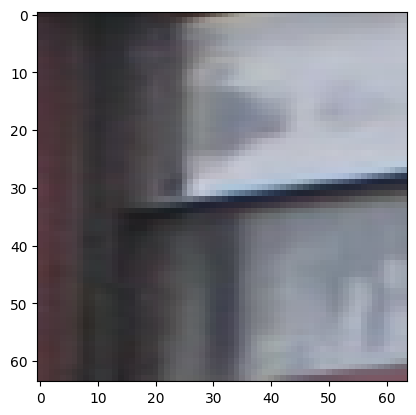

Истинный класс: Window, Предсказанный класс: Window


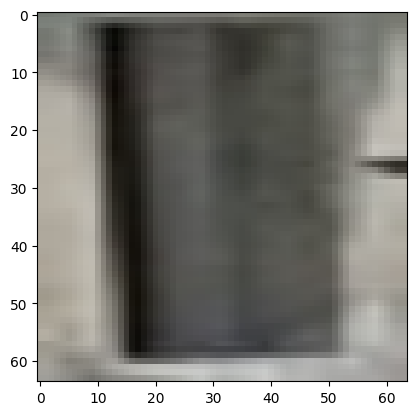

Истинный класс: Window, Предсказанный класс: Building


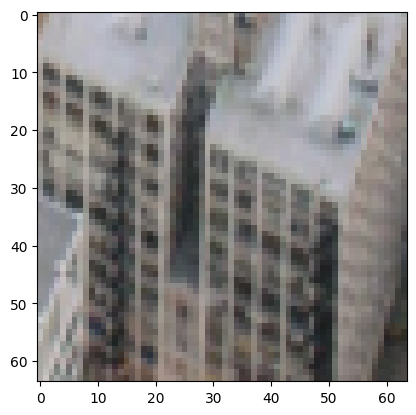

Истинный класс: Window, Предсказанный класс: Footwear


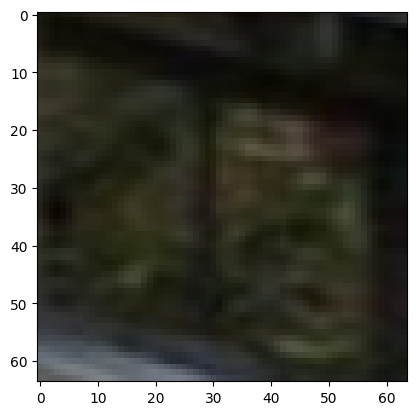

labels ---> tensor([ 95, 164,  63,  61])
predicted ---> tensor([164,  69, 108,  61])
total ---> 824
correct ---> 212
Истинный класс: Mammal, Предсказанный класс: Window


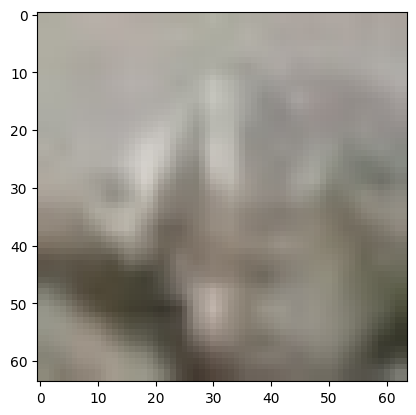

Истинный класс: Window, Предсказанный класс: House


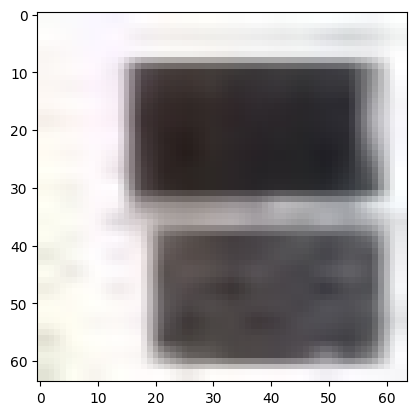

Истинный класс: Furniture, Предсказанный класс: Person


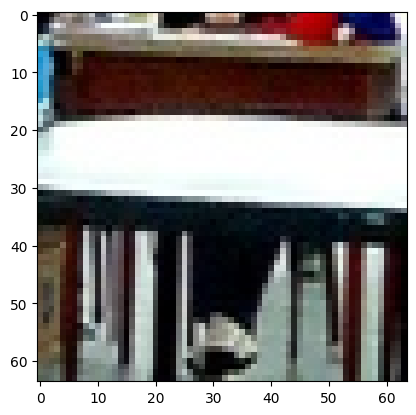

Истинный класс: Footwear, Предсказанный класс: Footwear


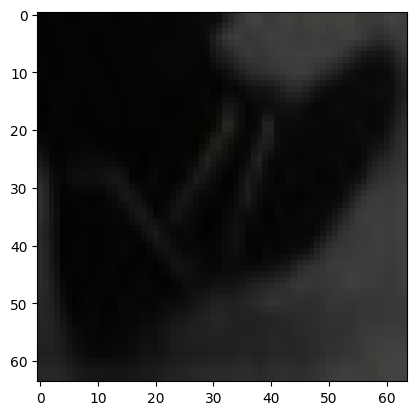

labels ---> tensor([164,  59, 164, 136])
predicted ---> tensor([164, 150, 164, 108])
total ---> 828
correct ---> 214
Истинный класс: Window, Предсказанный класс: Window


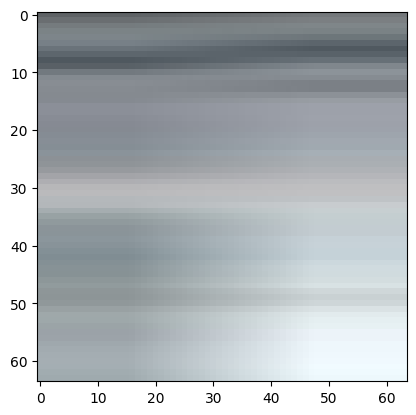

Истинный класс: Flowerpot, Предсказанный класс: Tree


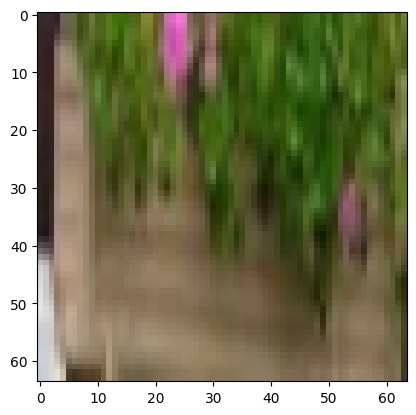

Истинный класс: Window, Предсказанный класс: Window


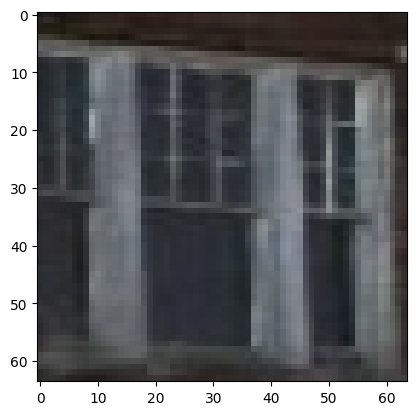

Истинный класс: Table, Предсказанный класс: Person


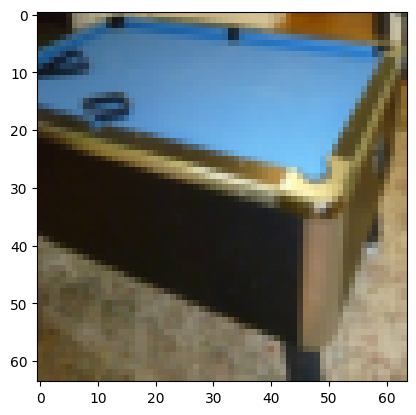

labels ---> tensor([ 71,  25,  62, 150])
predicted ---> tensor([164,  25, 164,  69])
total ---> 832
correct ---> 215
Истинный класс: Human arm, Предсказанный класс: Window


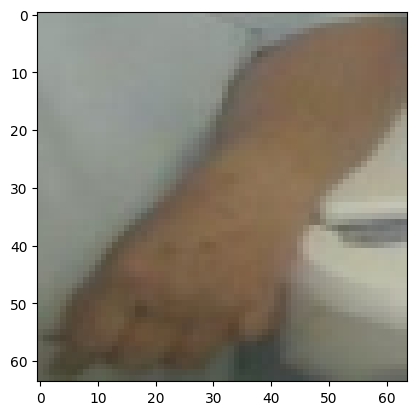

Истинный класс: Building, Предсказанный класс: Building


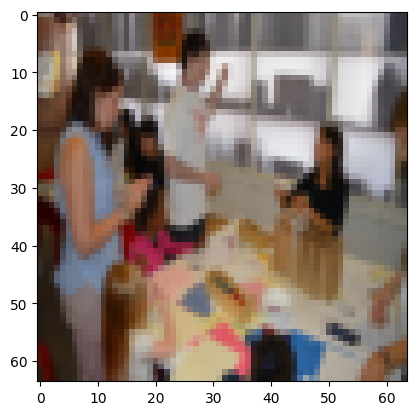

Истинный класс: Fountain, Предсказанный класс: Window


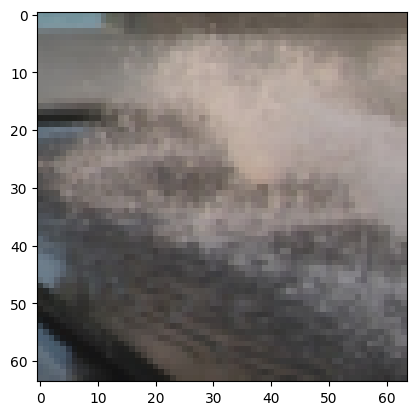

Истинный класс: Tree, Предсказанный класс: House


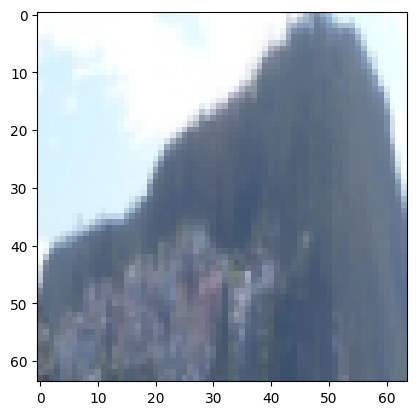

labels ---> tensor([ 25, 164, 164, 134])
predicted ---> tensor([ 69,  69, 164,  25])
total ---> 836
correct ---> 216
Истинный класс: Building, Предсказанный класс: House


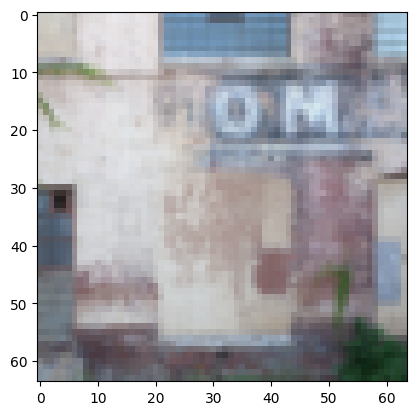

Истинный класс: Window, Предсказанный класс: House


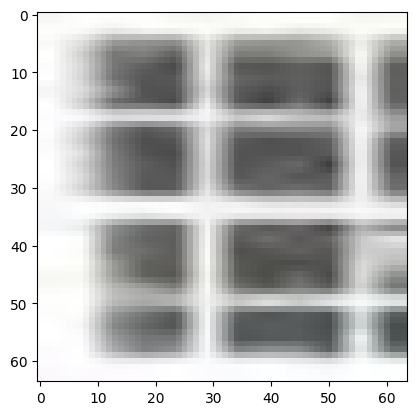

Истинный класс: Window, Предсказанный класс: Window


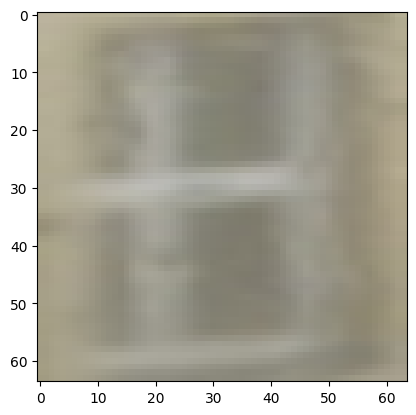

Истинный класс: Suit, Предсказанный класс: Building


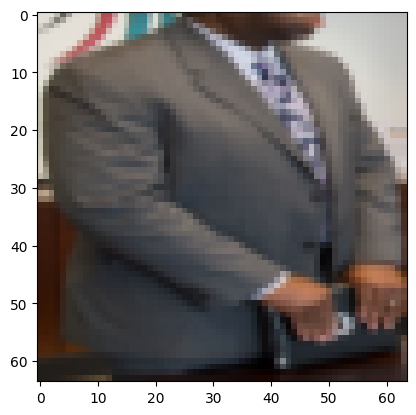

labels ---> tensor([156,  72, 150, 164])
predicted ---> tensor([164,  25, 150, 164])
total ---> 840
correct ---> 218
Истинный класс: Vehicle, Предсказанный класс: Window


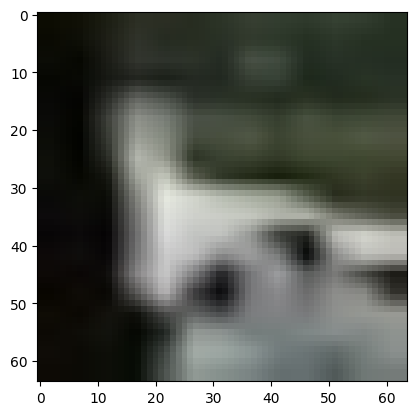

Истинный класс: Human body, Предсказанный класс: Building


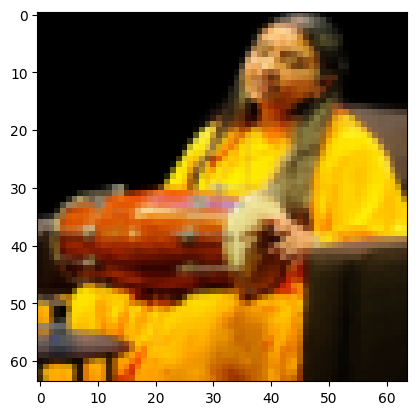

Истинный класс: Tree, Предсказанный класс: Tree


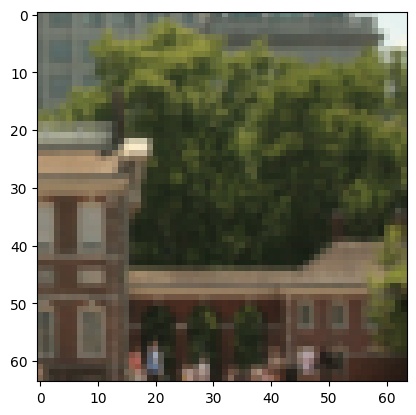

Истинный класс: Window, Предсказанный класс: Window


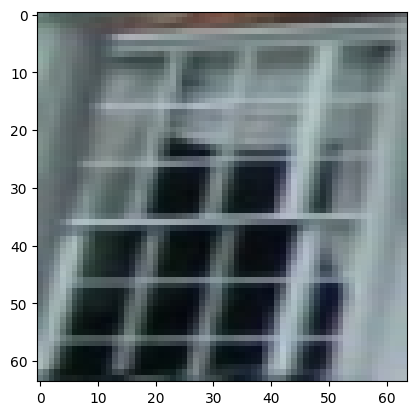

labels ---> tensor([ 29, 164, 150,  65])
predicted ---> tensor([ 25, 164,  25, 108])
total ---> 844
correct ---> 219
Истинный класс: Car, Предсказанный класс: Building


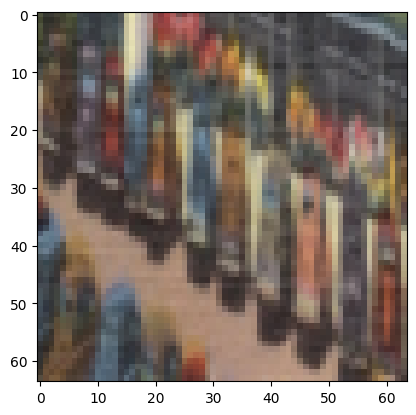

Истинный класс: Window, Предсказанный класс: Window


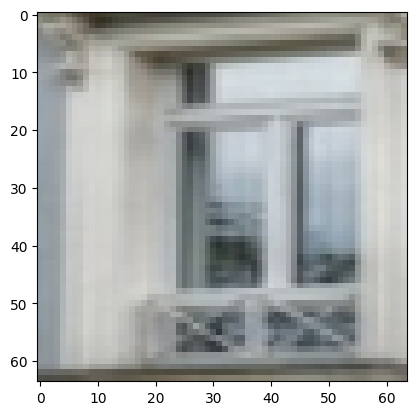

Истинный класс: Tree, Предсказанный класс: Building


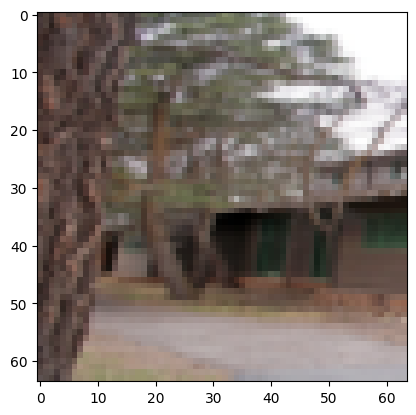

Истинный класс: Girl, Предсказанный класс: Person


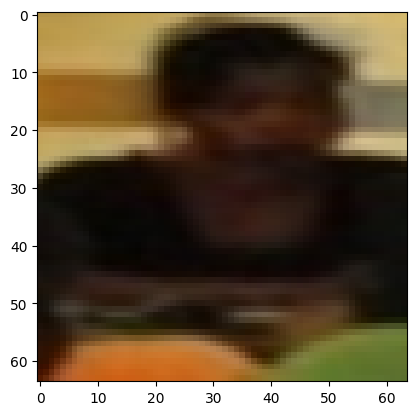

labels ---> tensor([ 36, 164,  36,  92])
predicted ---> tensor([164, 164,  61,  92])
total ---> 848
correct ---> 221
Истинный класс: Clothing, Предсказанный класс: Window


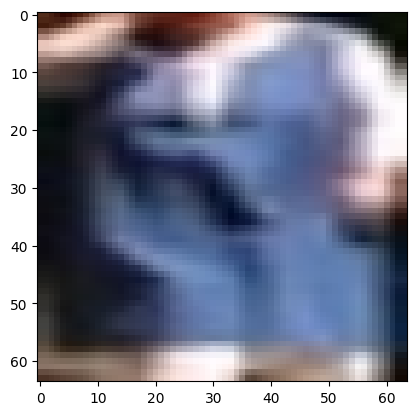

Истинный класс: Window, Предсказанный класс: Window


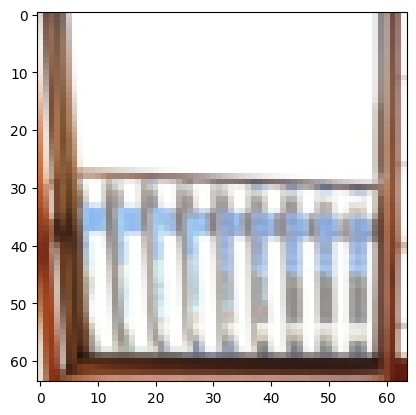

Истинный класс: Clothing, Предсказанный класс: Footwear


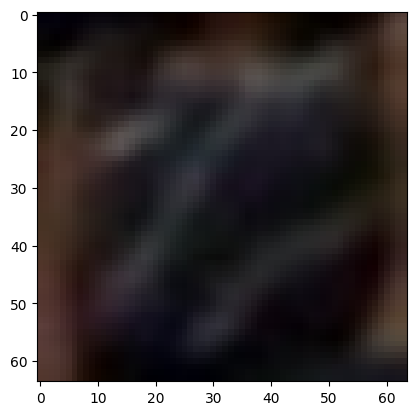

Истинный класс: Light bulb, Предсказанный класс: Light bulb


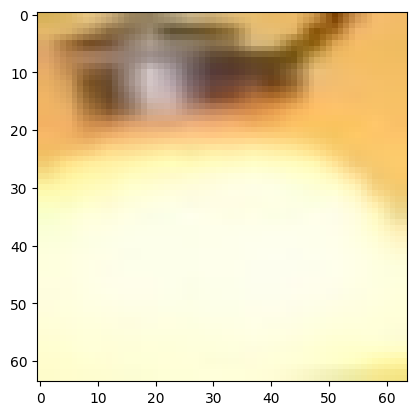

labels ---> tensor([ 63,  25, 164, 108])
predicted ---> tensor([ 25,  69, 164, 108])
total ---> 852
correct ---> 223
Истинный класс: Furniture, Предсказанный класс: Building


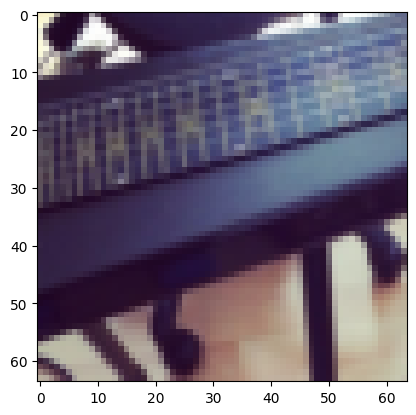

Истинный класс: Building, Предсказанный класс: House


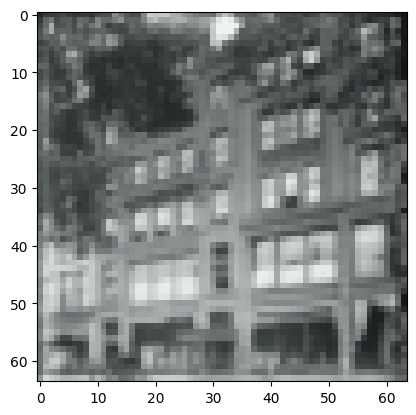

Истинный класс: Window, Предсказанный класс: Window


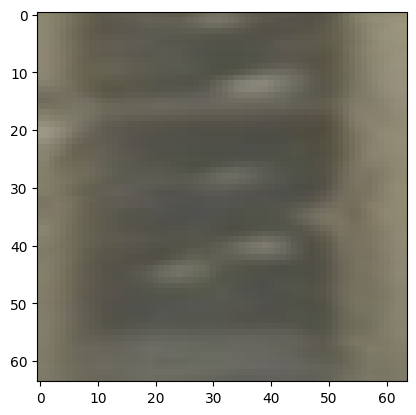

Истинный класс: Person, Предсказанный класс: Person


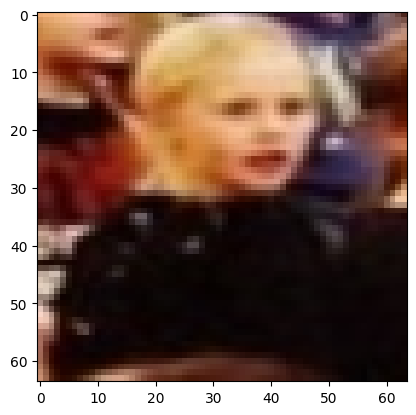

labels ---> tensor([108,  96, 150,  25])
predicted ---> tensor([108, 108, 150,  29])
total ---> 856
correct ---> 225
Истинный класс: Person, Предсказанный класс: Person


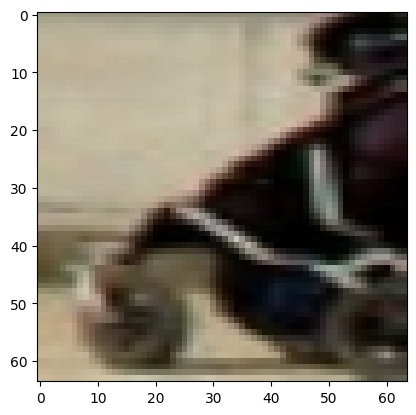

Истинный класс: Man, Предсказанный класс: Person


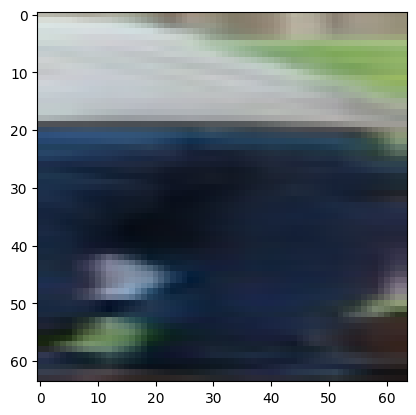

Истинный класс: Tree, Предсказанный класс: Tree


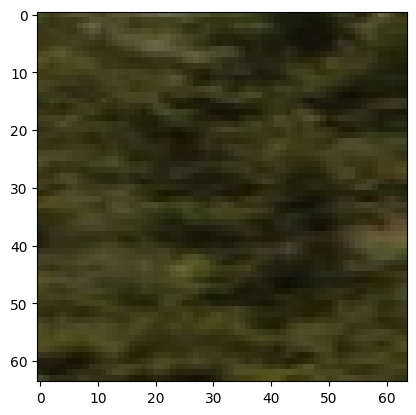

Истинный класс: Building, Предсказанный класс: Car


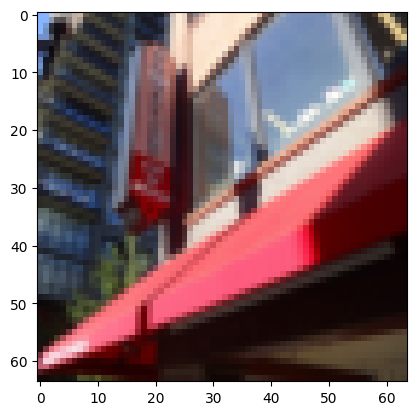

labels ---> tensor([128, 136, 108, 131])
predicted ---> tensor([ 61, 164, 108,  92])
total ---> 860
correct ---> 226
Истинный класс: Sports equipment, Предсказанный класс: Footwear


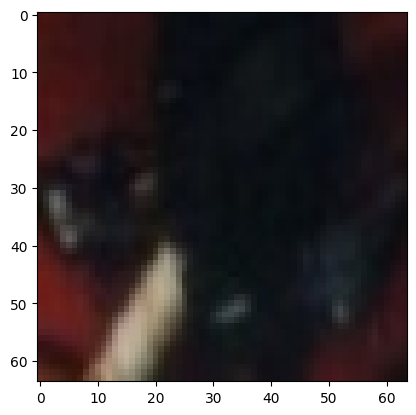

Истинный класс: Table, Предсказанный класс: Window


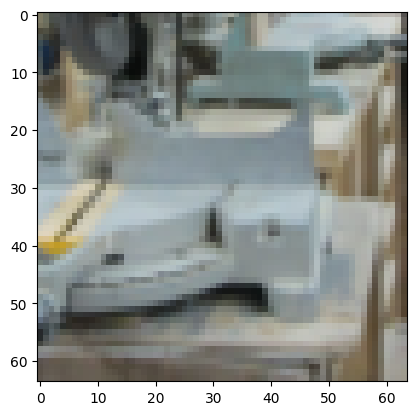

Истинный класс: Person, Предсказанный класс: Person


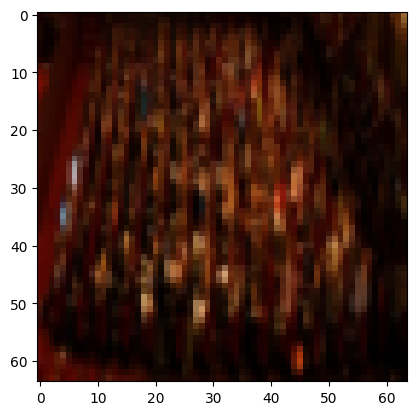

Истинный класс: Street light, Предсказанный класс: Light bulb


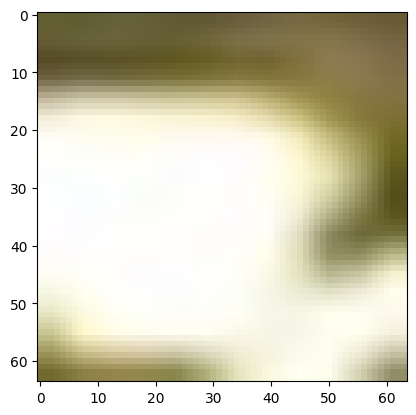

labels ---> tensor([164, 164,  58,  36])
predicted ---> tensor([164,  63, 108, 164])
total ---> 864
correct ---> 227
Истинный класс: Window, Предсказанный класс: Window


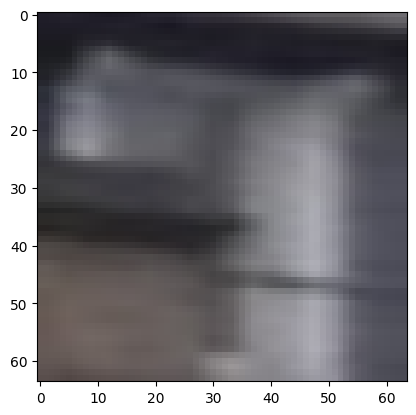

Истинный класс: Window, Предсказанный класс: Furniture


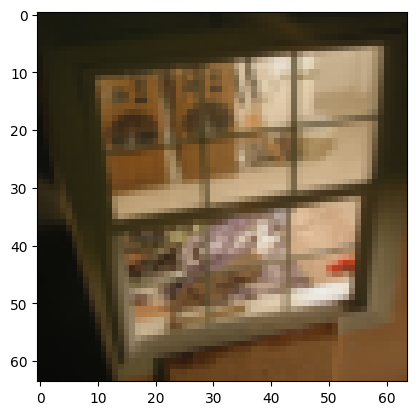

Истинный класс: Flower, Предсказанный класс: Person


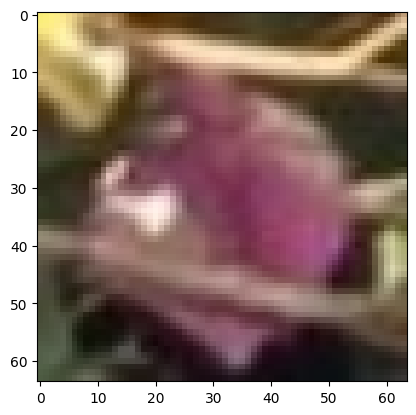

Истинный класс: Clothing, Предсказанный класс: Window


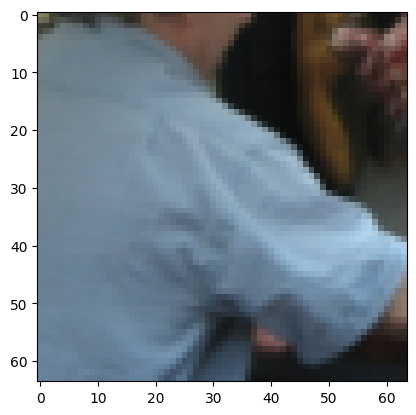

labels ---> tensor([ 63, 150, 164, 164])
predicted ---> tensor([108, 150, 164, 164])
total ---> 868
correct ---> 230
Истинный класс: Furniture, Предсказанный класс: Person


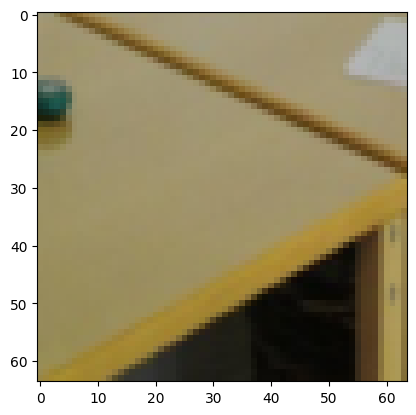

Истинный класс: Tree, Предсказанный класс: Tree


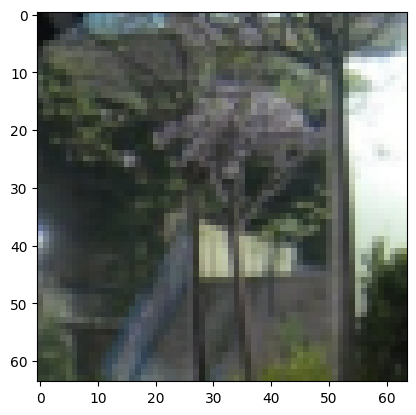

Истинный класс: Window, Предсказанный класс: Window


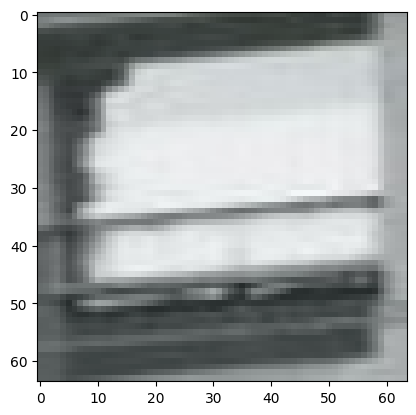

Истинный класс: Window, Предсказанный класс: Window


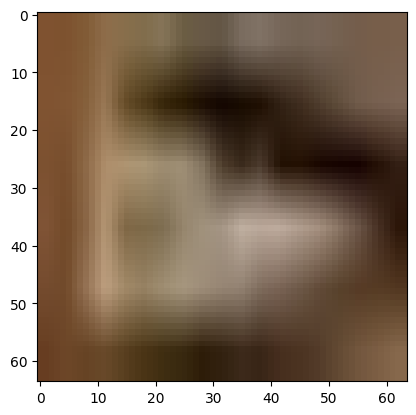

labels ---> tensor([ 29,  36, 145,  25])
predicted ---> tensor([108, 108, 108,  69])
total ---> 872
correct ---> 230
Истинный класс: Car, Предсказанный класс: Person


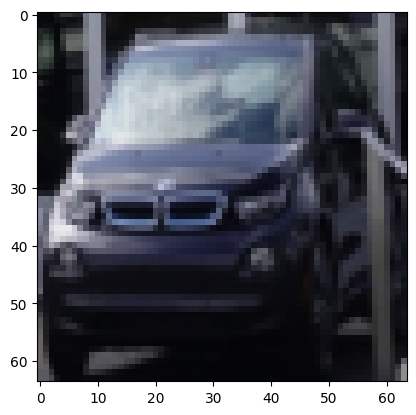

Истинный класс: Clothing, Предсказанный класс: Person


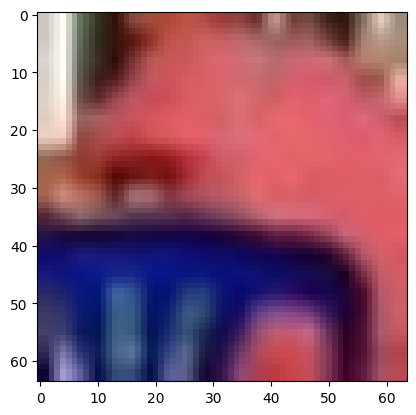

Истинный класс: Tool, Предсказанный класс: Person


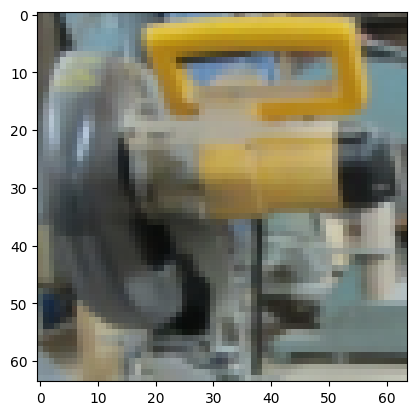

Истинный класс: Building, Предсказанный класс: House


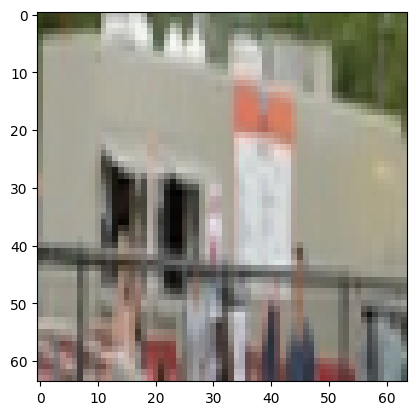

labels ---> tensor([138,  77, 164, 164])
predicted ---> tensor([164,  76, 164, 164])
total ---> 876
correct ---> 232
Истинный класс: Tableware, Предсказанный класс: Window


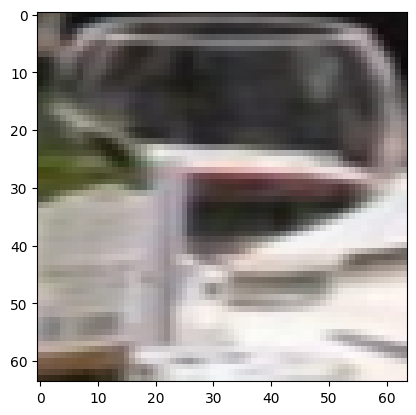

Истинный класс: Human hand, Предсказанный класс: Human hair


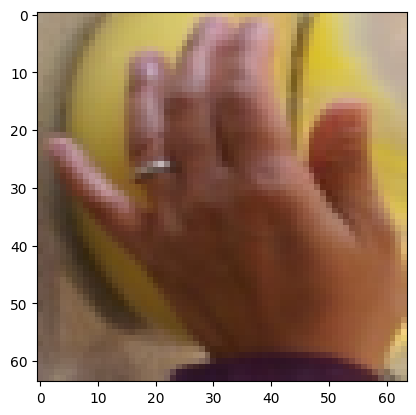

Истинный класс: Window, Предсказанный класс: Window


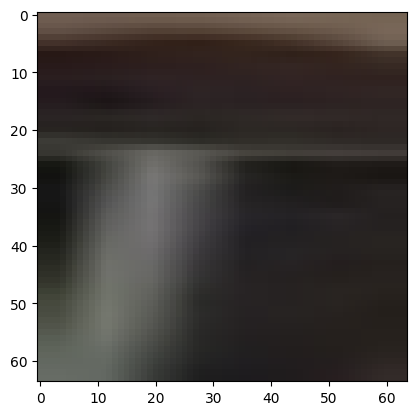

Истинный класс: Window, Предсказанный класс: Window


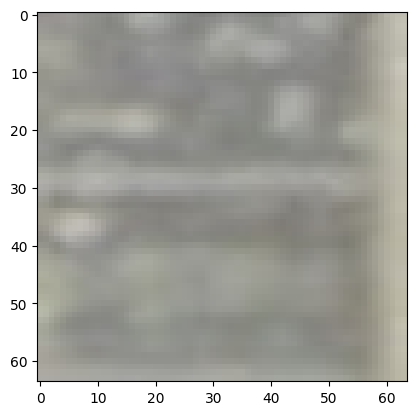

labels ---> tensor([ 63,  76, 164, 164])
predicted ---> tensor([ 61,  25, 164, 164])
total ---> 880
correct ---> 234
Истинный класс: Furniture, Предсказанный класс: Footwear


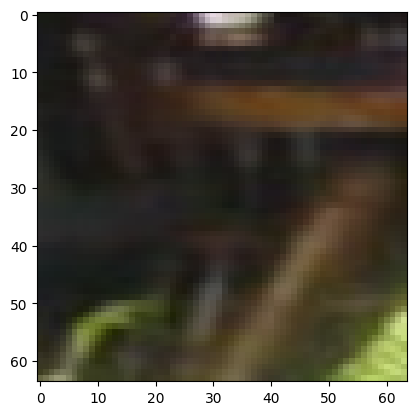

Истинный класс: Human hair, Предсказанный класс: Building


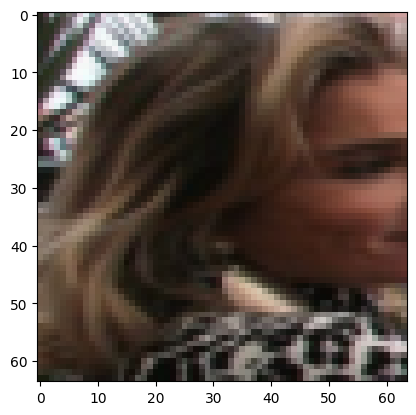

Истинный класс: Window, Предсказанный класс: Window


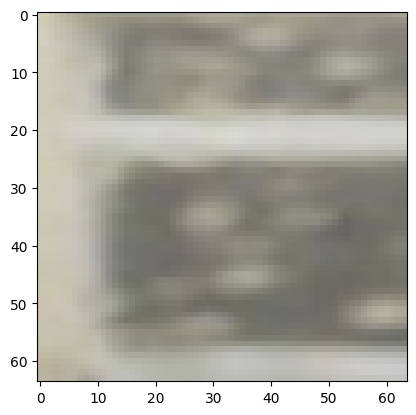

Истинный класс: Window, Предсказанный класс: Window


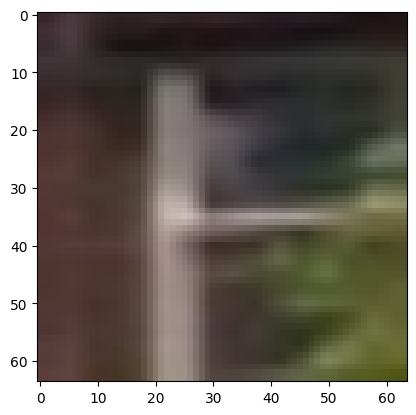

labels ---> tensor([ 78, 112, 164, 127])
predicted ---> tensor([ 61, 112, 164, 108])
total ---> 884
correct ---> 236
Истинный класс: Human head, Предсказанный класс: Footwear


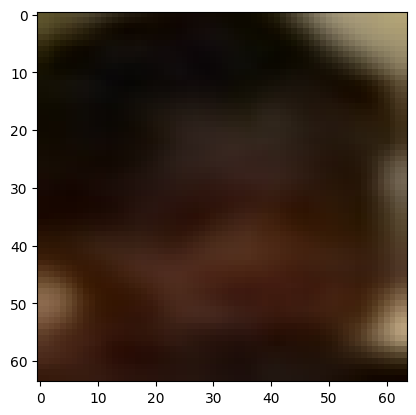

Истинный класс: Plant, Предсказанный класс: Plant


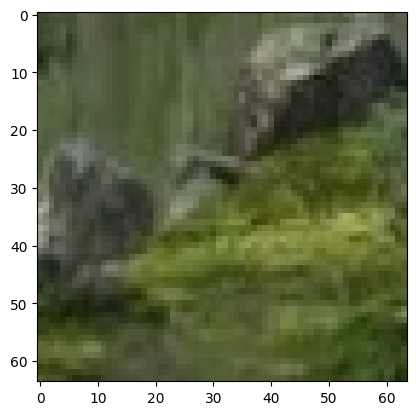

Истинный класс: Window, Предсказанный класс: Window


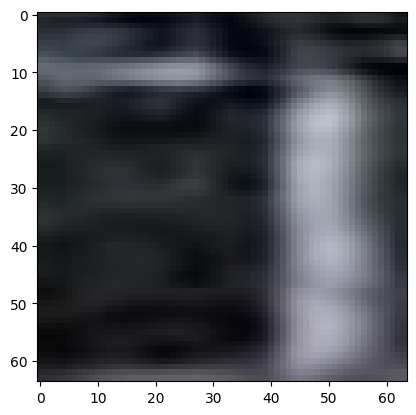

Истинный класс: Sofa bed, Предсказанный класс: Person


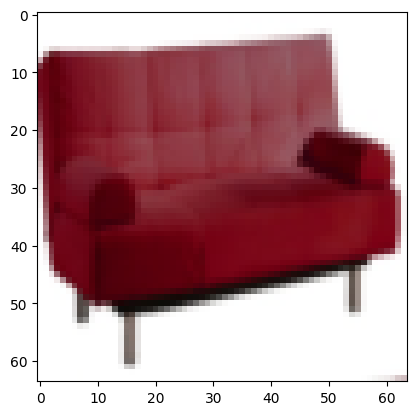

labels ---> tensor([150,  71,  29, 164])
predicted ---> tensor([ 25,  69, 108, 164])
total ---> 888
correct ---> 237
Истинный класс: Tree, Предсказанный класс: Building


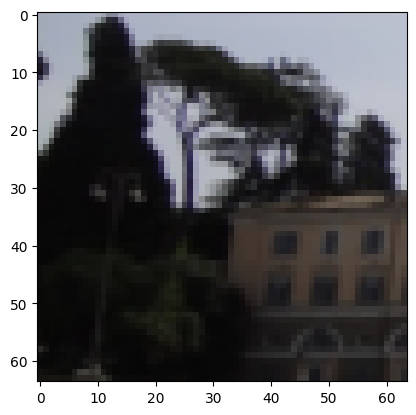

Истинный класс: Human arm, Предсказанный класс: House


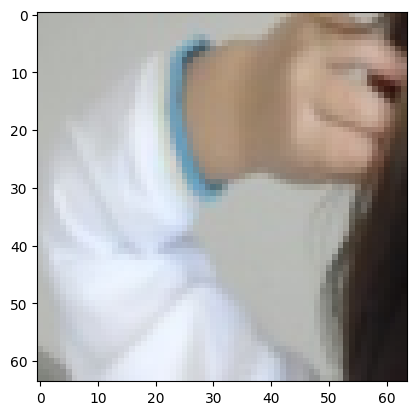

Истинный класс: Car, Предсказанный класс: Person


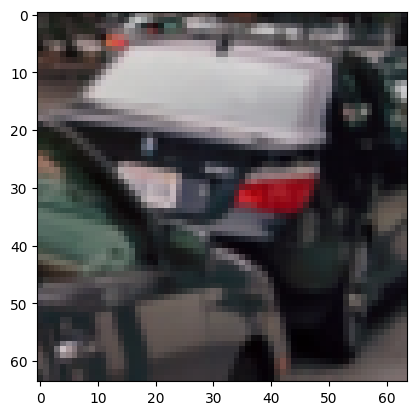

Истинный класс: Window, Предсказанный класс: Window


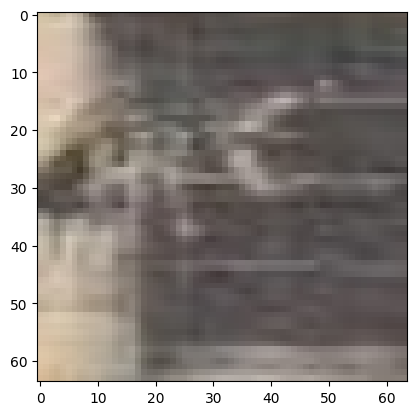

labels ---> tensor([ 63, 164,  96, 164])
predicted ---> tensor([108, 164, 108, 164])
total ---> 892
correct ---> 239
Истинный класс: Furniture, Предсказанный класс: Person


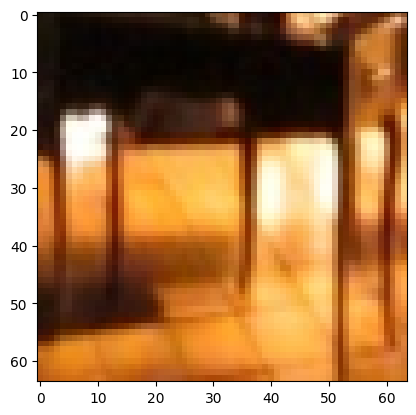

Истинный класс: Window, Предсказанный класс: Window


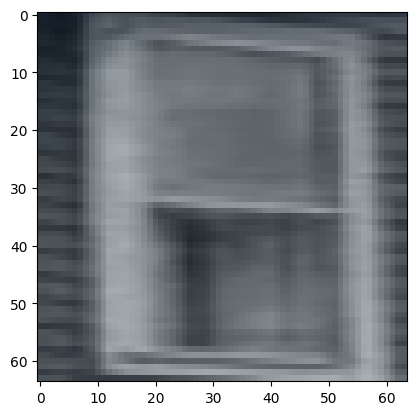

Истинный класс: Man, Предсказанный класс: Person


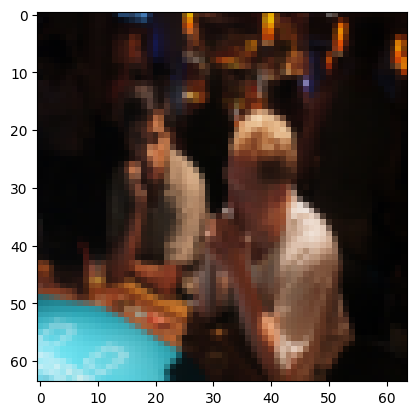

Истинный класс: Window, Предсказанный класс: Window


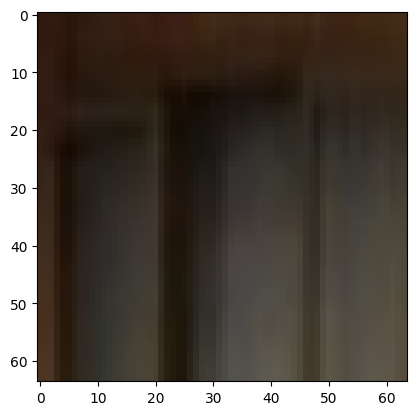

labels ---> tensor([164, 120,  63, 108])
predicted ---> tensor([164, 164, 108, 108])
total ---> 896
correct ---> 241
Истинный класс: Window, Предсказанный класс: Window


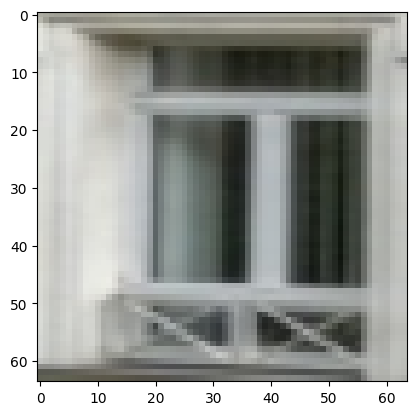

Истинный класс: Shirt, Предсказанный класс: Window


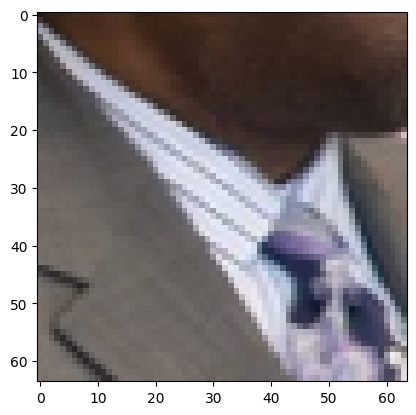

Истинный класс: Furniture, Предсказанный класс: Person


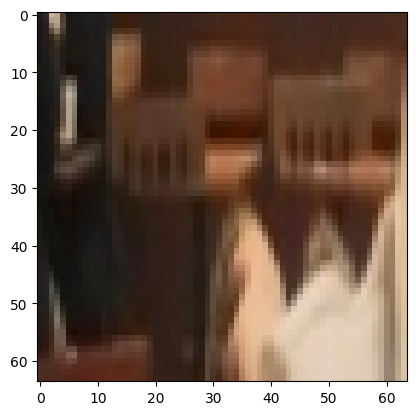

Истинный класс: Person, Предсказанный класс: Person


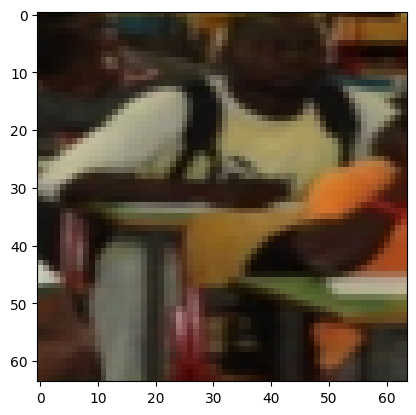

labels ---> tensor([ 61, 108,  71, 136])
predicted ---> tensor([108,  25, 164, 108])
total ---> 900
correct ---> 241
Истинный класс: Footwear, Предсказанный класс: Person


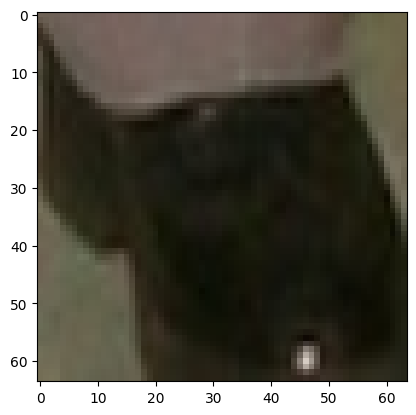

Истинный класс: Person, Предсказанный класс: Building


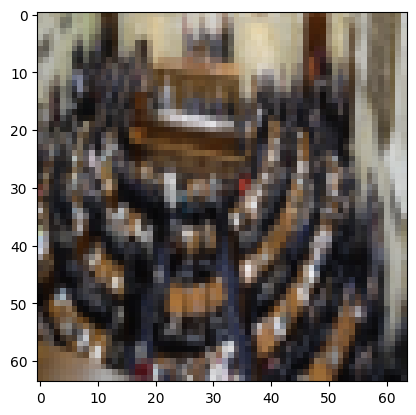

Истинный класс: Human arm, Предсказанный класс: Window


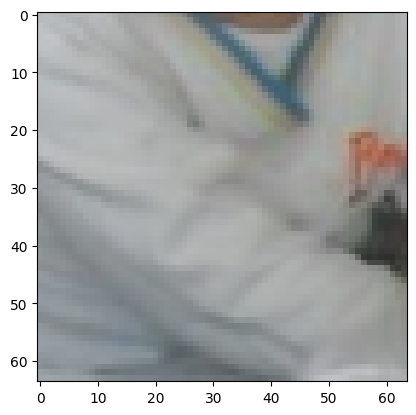

Истинный класс: Table, Предсказанный класс: Person


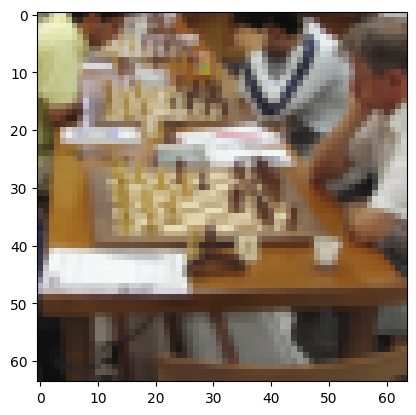

labels ---> tensor([164,  25, 164,  72])
predicted ---> tensor([164,  69, 164,  69])
total ---> 904
correct ---> 243
Истинный класс: Window, Предсказанный класс: Window


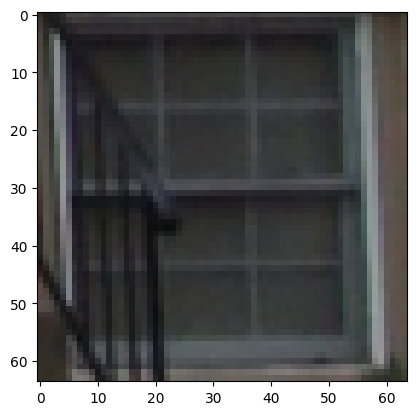

Истинный класс: Building, Предсказанный класс: House


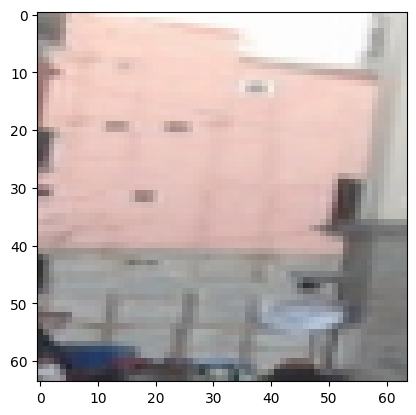

Истинный класс: Window, Предсказанный класс: Window


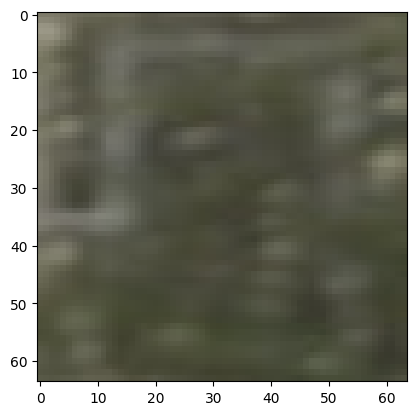

Истинный класс: Human body, Предсказанный класс: House


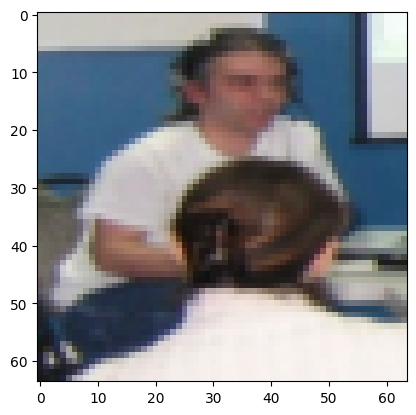

labels ---> tensor([164, 164, 164,  65])
predicted ---> tensor([164, 164, 164,  76])
total ---> 908
correct ---> 246
Истинный класс: Window, Предсказанный класс: Window


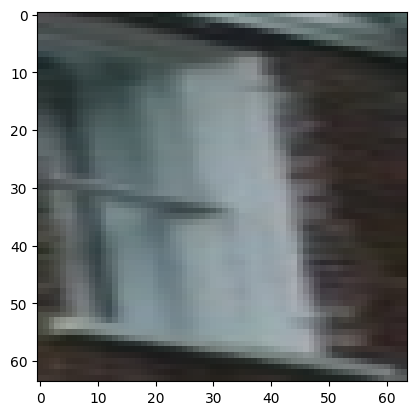

Истинный класс: Window, Предсказанный класс: Window


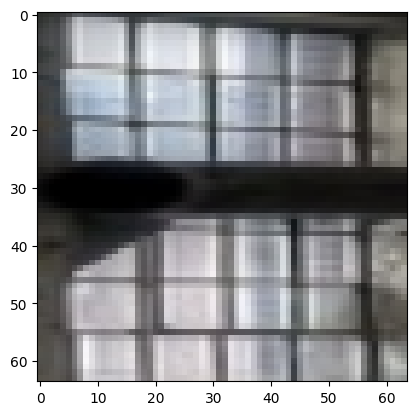

Истинный класс: Window, Предсказанный класс: Window


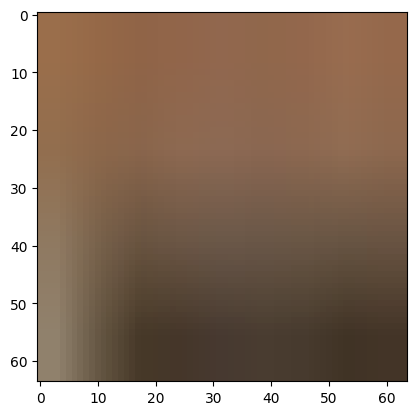

Истинный класс: Girl, Предсказанный класс: Human hair


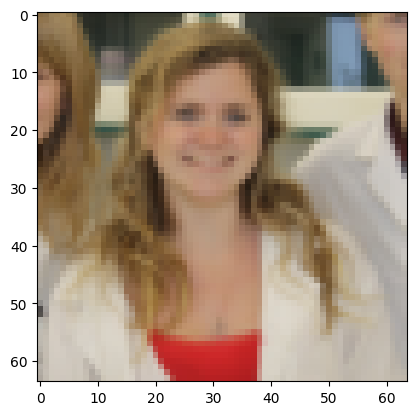

labels ---> tensor([ 53,  36, 117,  25])
predicted ---> tensor([ 61, 164, 164,  69])
total ---> 912
correct ---> 246
Истинный класс: Fashion accessory, Предсказанный класс: Footwear


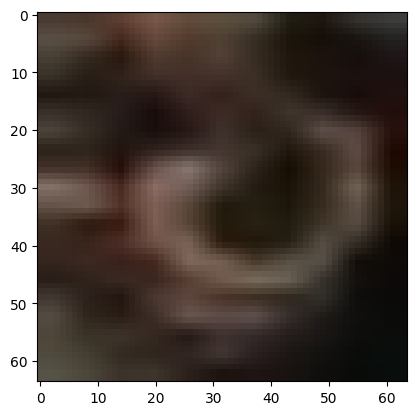

Истинный класс: Clothing, Предсказанный класс: Window


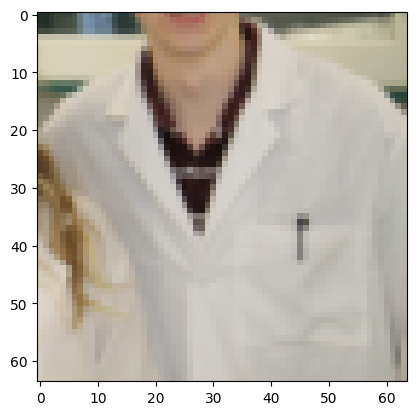

Истинный класс: Sculpture, Предсказанный класс: Window


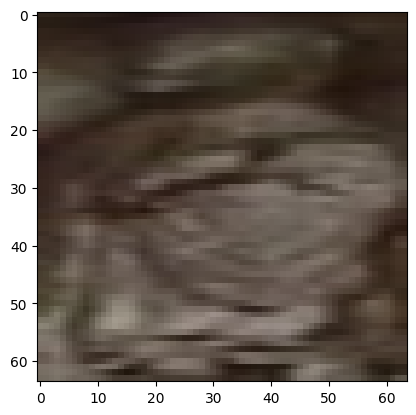

Истинный класс: Building, Предсказанный класс: House


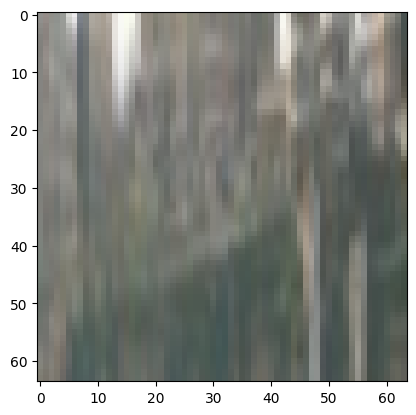

labels ---> tensor([108, 164, 134, 164])
predicted ---> tensor([108, 164, 108, 164])
total ---> 916
correct ---> 249
Истинный класс: Person, Предсказанный класс: Person


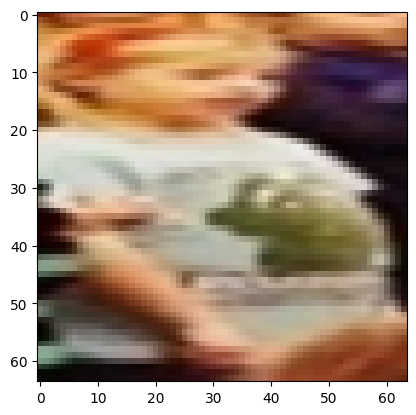

Истинный класс: Window, Предсказанный класс: Window


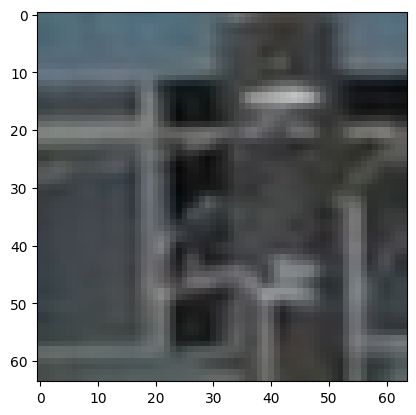

Истинный класс: Suit, Предсказанный класс: Person


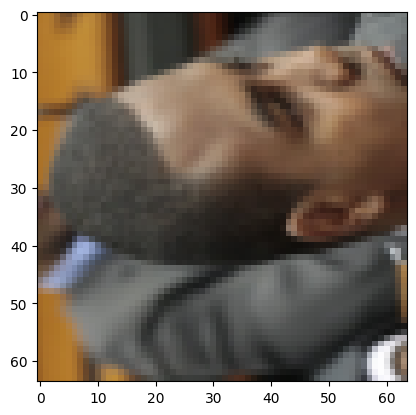

Истинный класс: Window, Предсказанный класс: Window


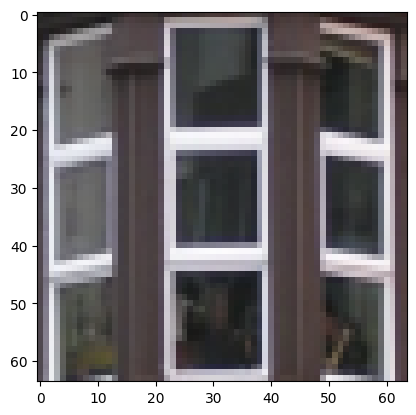

labels ---> tensor([150, 164, 108,  76])
predicted ---> tensor([ 25,  61,  69, 108])
total ---> 920
correct ---> 249
Истинный класс: Tree, Предсказанный класс: Building


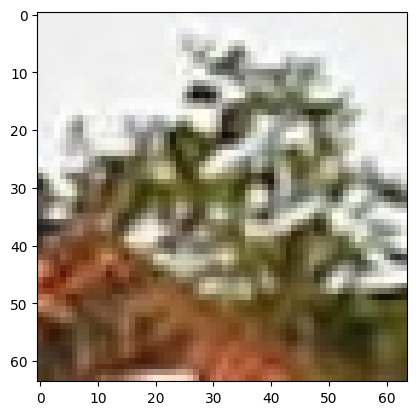

Истинный класс: Window, Предсказанный класс: Footwear


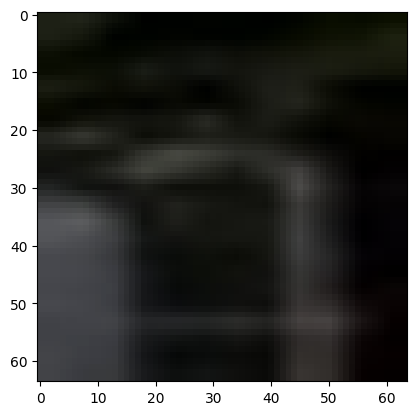

Истинный класс: Person, Предсказанный класс: House


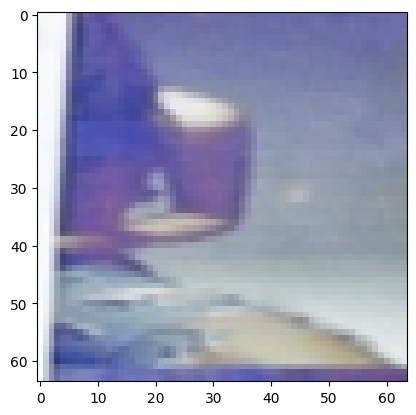

Истинный класс: Human hair, Предсказанный класс: Person


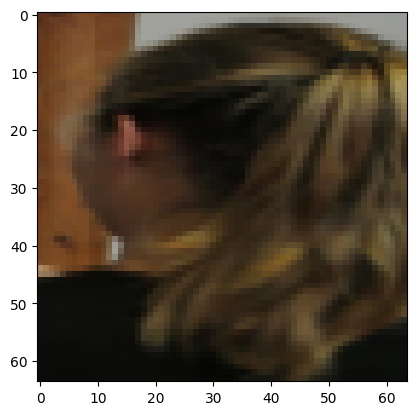

labels ---> tensor([144, 162, 164, 108])
predicted ---> tensor([164, 164, 164,  78])
total ---> 924
correct ---> 250
Истинный класс: Tire, Предсказанный класс: Window


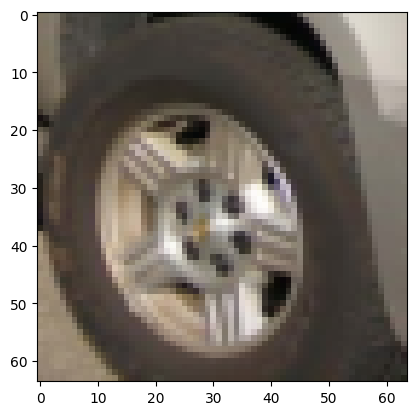

Истинный класс: Wheel, Предсказанный класс: Window


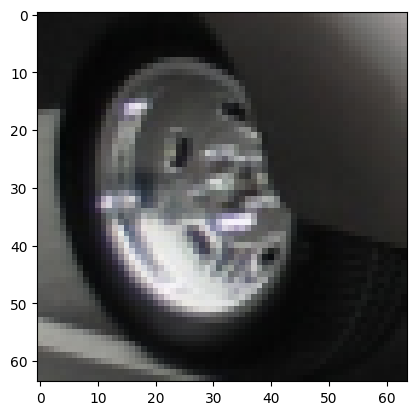

Истинный класс: Window, Предсказанный класс: Window


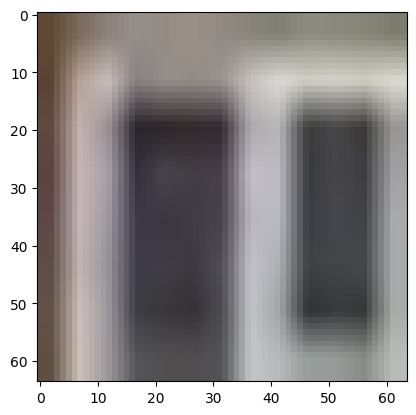

Истинный класс: Person, Предсказанный класс: Human head


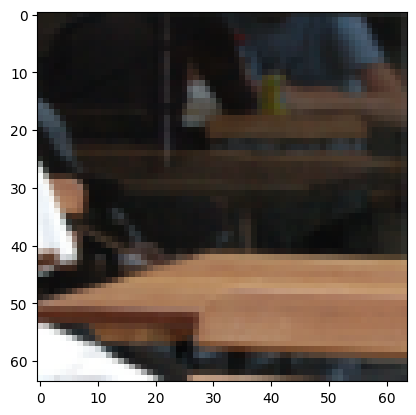

labels ---> tensor([ 69, 150,  25, 164])
predicted ---> tensor([ 69,  61, 108, 164])
total ---> 928
correct ---> 252
Истинный класс: House, Предсказанный класс: House


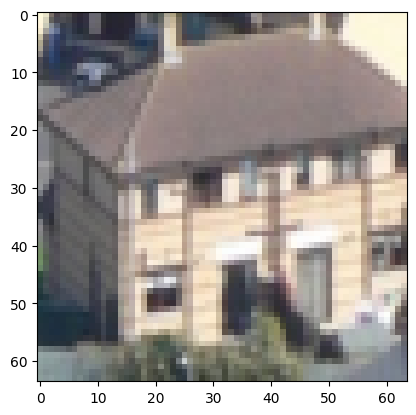

Истинный класс: Tree, Предсказанный класс: Footwear


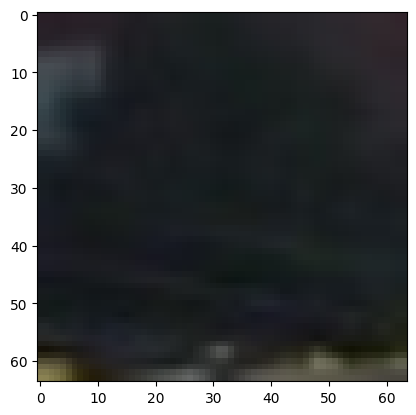

Истинный класс: Building, Предсказанный класс: Person


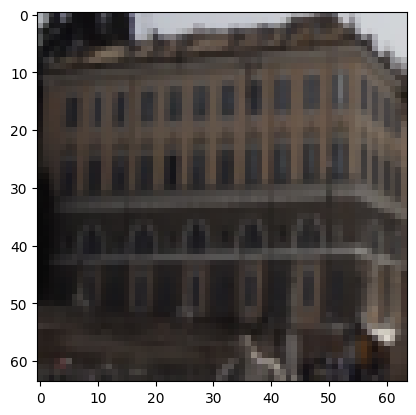

Истинный класс: Window, Предсказанный класс: Window


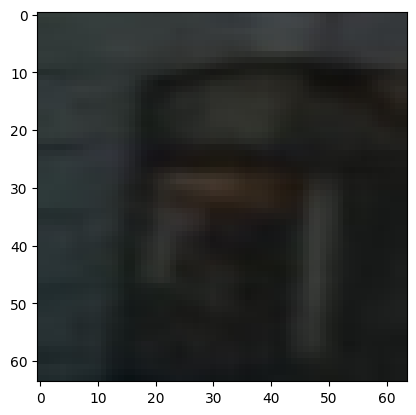

labels ---> tensor([ 61, 164, 136, 114])
predicted ---> tensor([164, 164, 108, 164])
total ---> 932
correct ---> 253
Истинный класс: Footwear, Предсказанный класс: Window


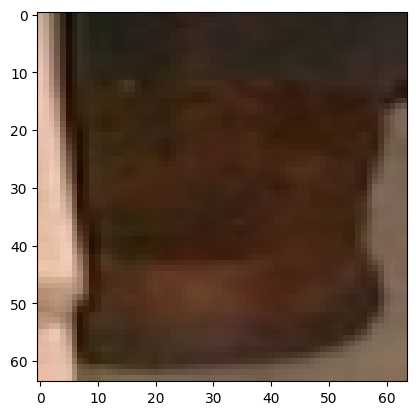

Истинный класс: Window, Предсказанный класс: Window


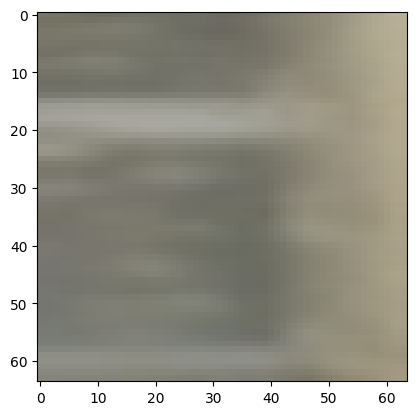

Истинный класс: Table, Предсказанный класс: Person


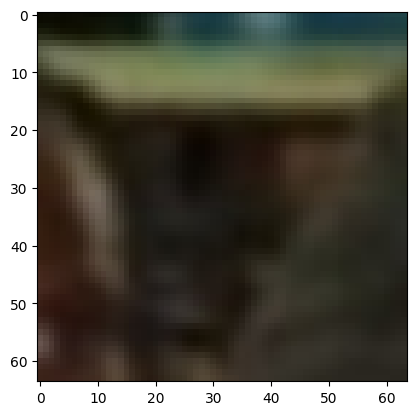

Истинный класс: Poster, Предсказанный класс: Window


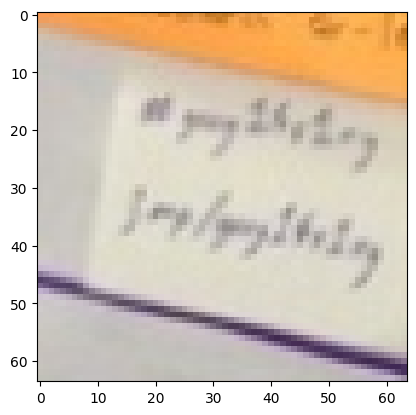

labels ---> tensor([147,  96, 164, 164])
predicted ---> tensor([ 69,  25, 164,  61])
total ---> 936
correct ---> 254
Истинный класс: Toy, Предсказанный класс: House


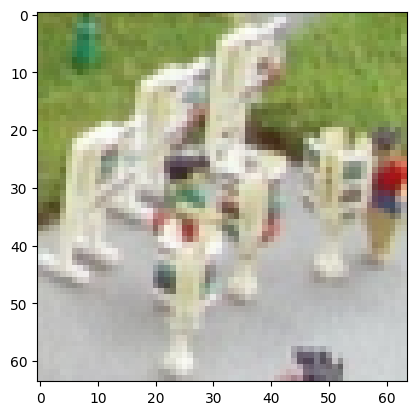

Истинный класс: Man, Предсказанный класс: Building


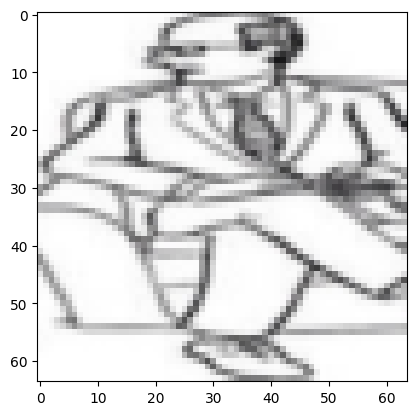

Истинный класс: Window, Предсказанный класс: Window


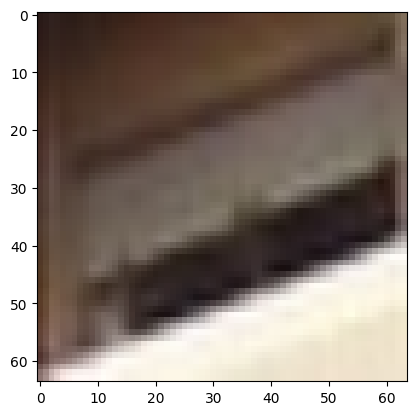

Истинный класс: Window, Предсказанный класс: Footwear


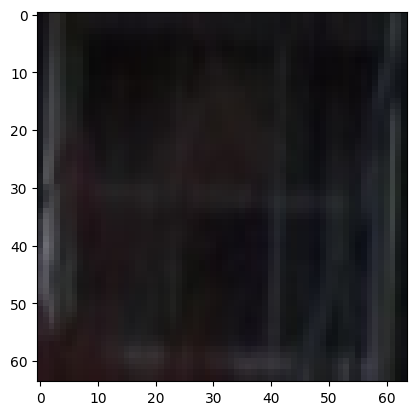

labels ---> tensor([150,  63,  78,  72])
predicted ---> tensor([150, 108, 108, 108])
total ---> 940
correct ---> 255
Истинный класс: Tree, Предсказанный класс: Tree


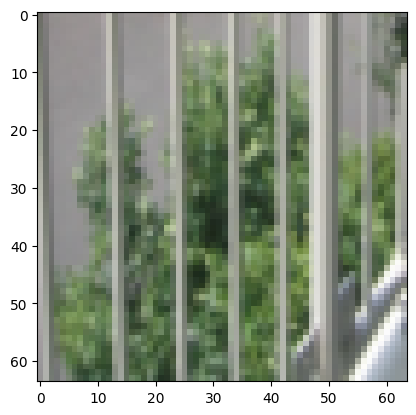

Истинный класс: Furniture, Предсказанный класс: Person


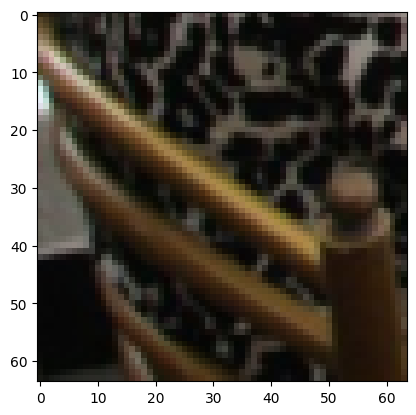

Истинный класс: Human head, Предсказанный класс: Person


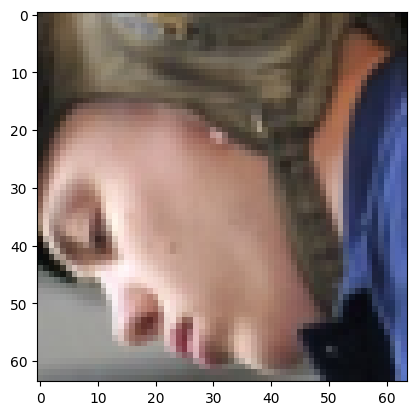

Истинный класс: Human body, Предсказанный класс: Person


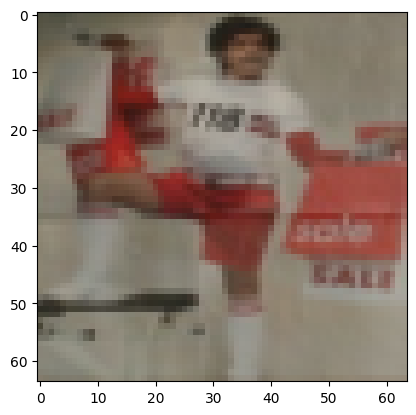

labels ---> tensor([ 63, 108,  92,  25])
predicted ---> tensor([164,  69,  92,  25])
total ---> 944
correct ---> 257
Истинный класс: Furniture, Предсказанный класс: Window


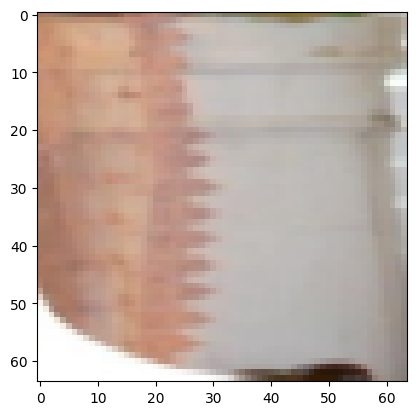

Истинный класс: Person, Предсказанный класс: House


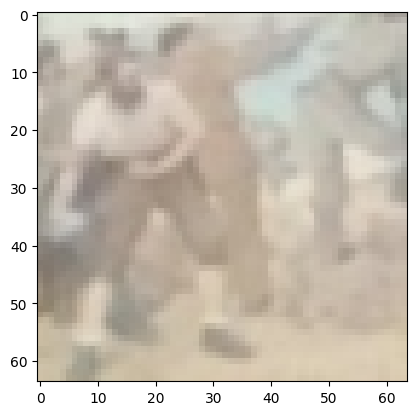

Истинный класс: Light bulb, Предсказанный класс: Light bulb


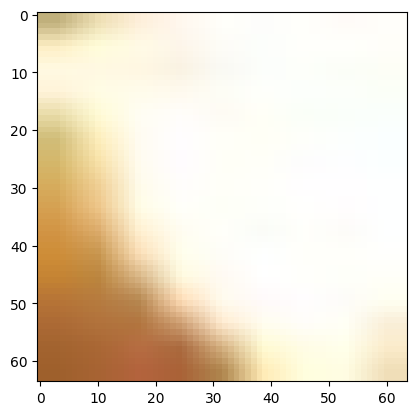

Истинный класс: Building, Предсказанный класс: Building


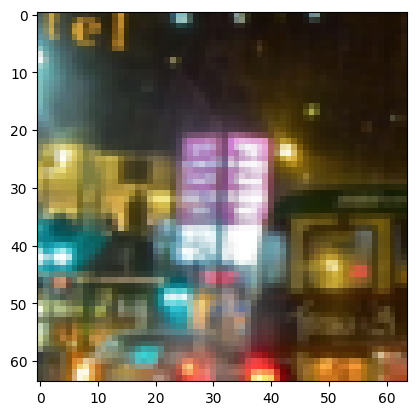

labels ---> tensor([ 36,  58, 168,  96])
predicted ---> tensor([108,  25, 164, 164])
total ---> 948
correct ---> 257
Истинный класс: Clothing, Предсказанный класс: Person


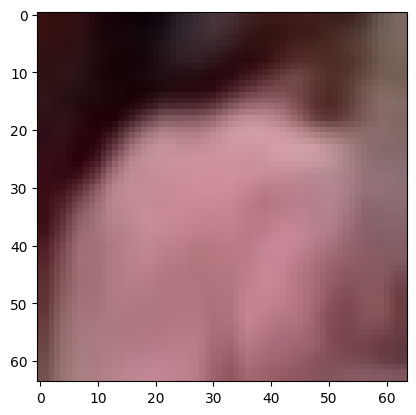

Истинный класс: Flower, Предсказанный класс: Building


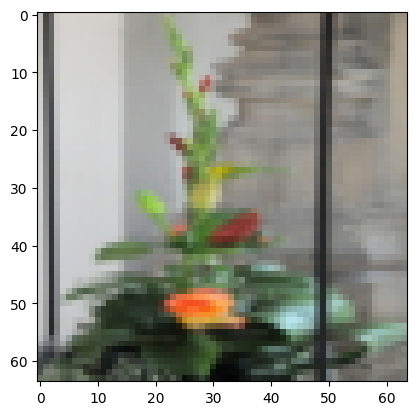

Истинный класс: Woman, Предсказанный класс: Window


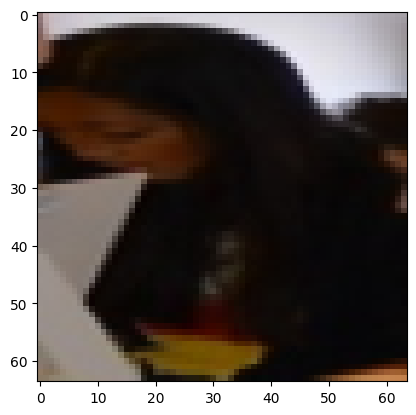

Истинный класс: Man, Предсказанный класс: Window


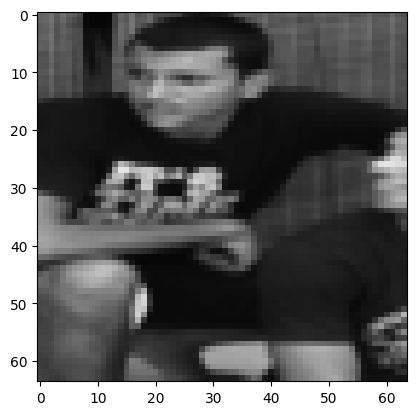

labels ---> tensor([76, 61, 96, 63])
predicted ---> tensor([108, 164, 108, 108])
total ---> 952
correct ---> 257
Истинный класс: Human hair, Предсказанный класс: Person


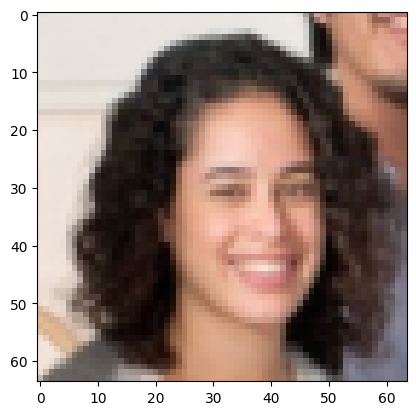

Истинный класс: Footwear, Предсказанный класс: Window


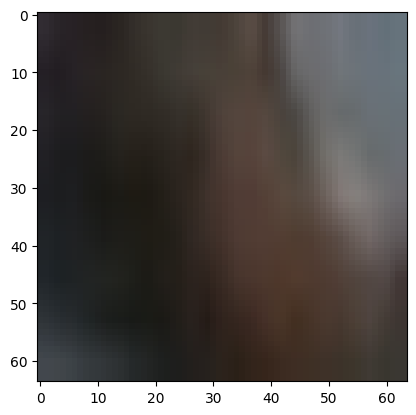

Истинный класс: Man, Предсказанный класс: Person


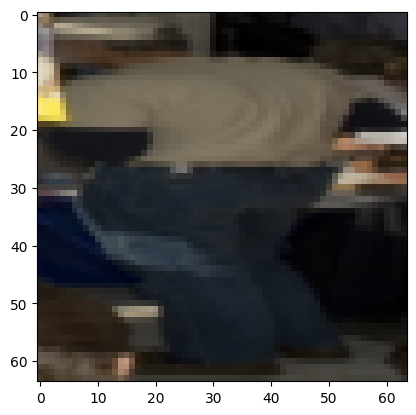

Истинный класс: Furniture, Предсказанный класс: Person


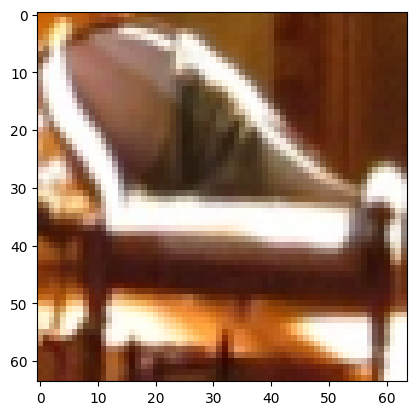

labels ---> tensor([ 23,  95, 150,  95])
predicted ---> tensor([164, 164, 164, 108])
total ---> 956
correct ---> 257
Истинный класс: Boy, Предсказанный класс: Window


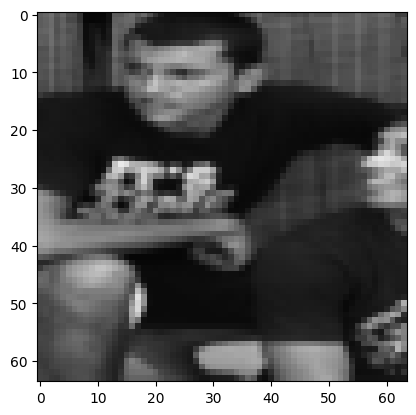

Истинный класс: Mammal, Предсказанный класс: Window


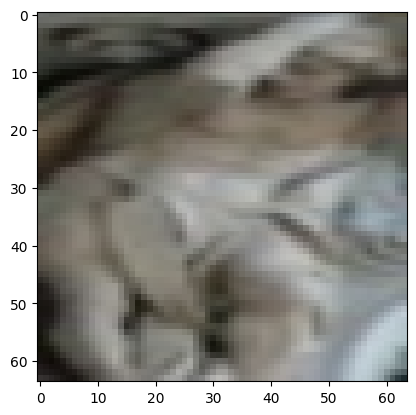

Истинный класс: Tree, Предсказанный класс: Window


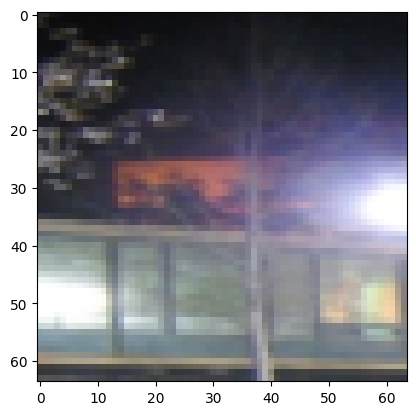

Истинный класс: Mammal, Предсказанный класс: Person


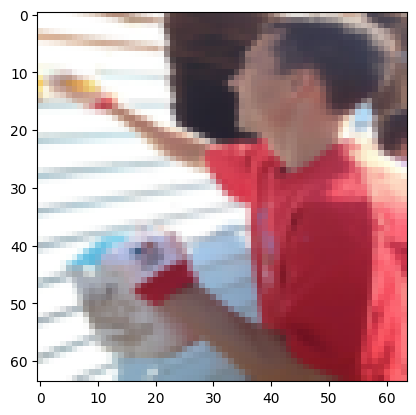

labels ---> tensor([155,  78, 164, 164])
predicted ---> tensor([150,  75, 164, 164])
total ---> 960
correct ---> 259
Истинный класс: Vegetable, Предсказанный класс: Tree


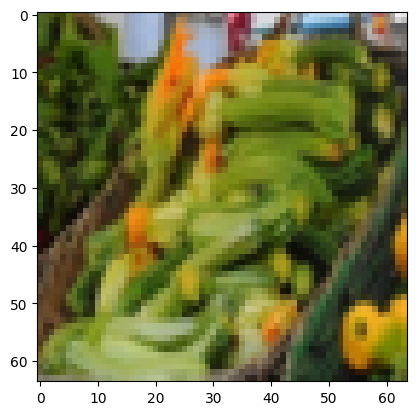

Истинный класс: Human head, Предсказанный класс: Human face


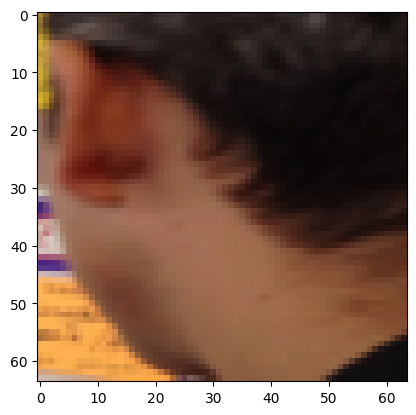

Истинный класс: Window, Предсказанный класс: Window


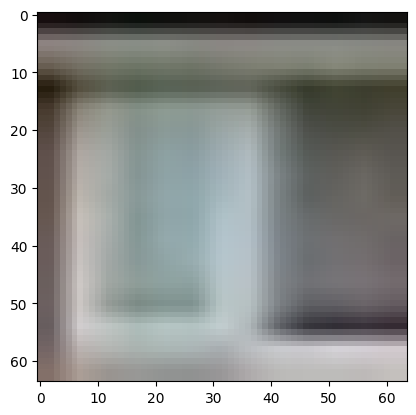

Истинный класс: Window, Предсказанный класс: Window


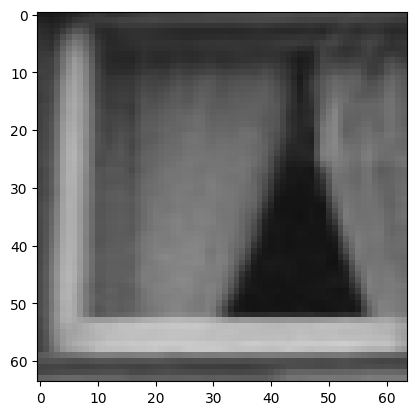

labels ---> tensor([36, 25, 96, 61])
predicted ---> tensor([ 69,  25,  69, 164])
total ---> 964
correct ---> 260
Истинный класс: Clothing, Предсказанный класс: House


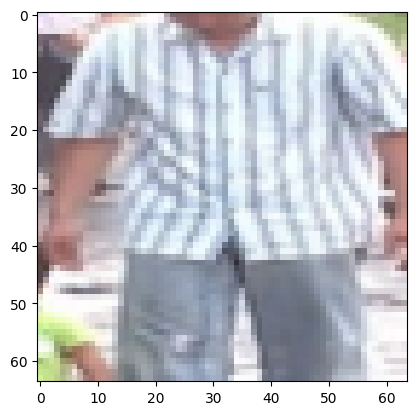

Истинный класс: Building, Предсказанный класс: Building


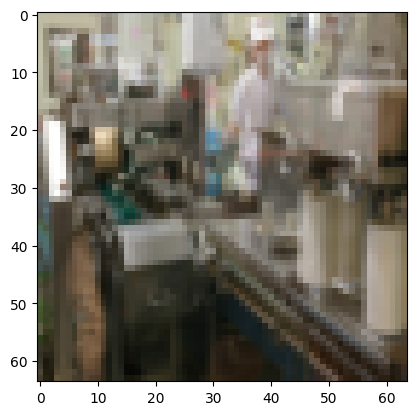

Истинный класс: Man, Предсказанный класс: House


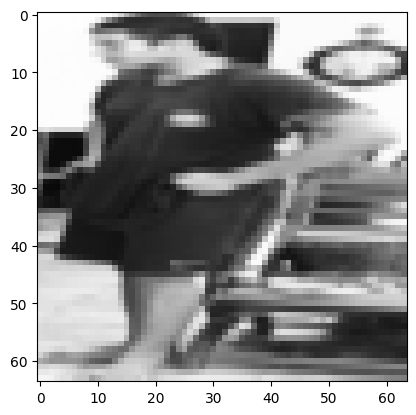

Истинный класс: Footwear, Предсказанный класс: Window


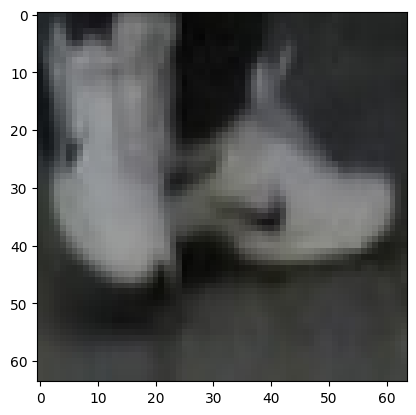

labels ---> tensor([164,  69, 164, 164])
predicted ---> tensor([164, 164, 164, 164])
total ---> 968
correct ---> 263
Истинный класс: Window, Предсказанный класс: Window


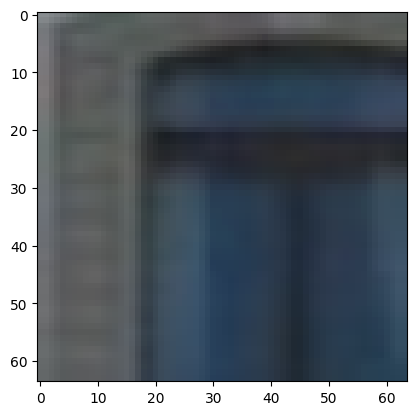

Истинный класс: House, Предсказанный класс: Window


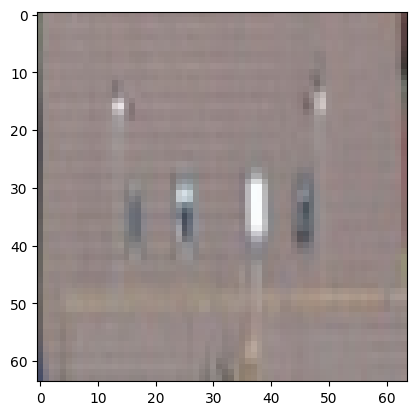

Истинный класс: Window, Предсказанный класс: Window


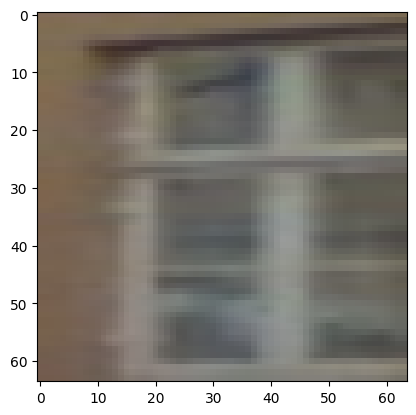

Истинный класс: Window, Предсказанный класс: Window


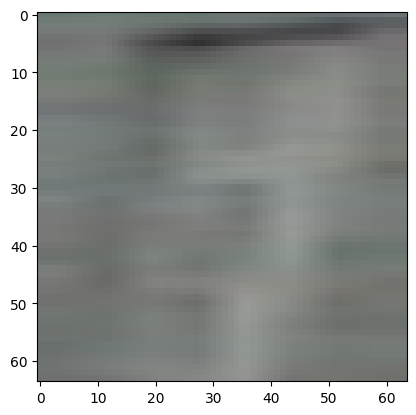

labels ---> tensor([ 63,  63, 150,  29])
predicted ---> tensor([108, 108,  69,  25])
total ---> 972
correct ---> 263
Истинный класс: Furniture, Предсказанный класс: Person


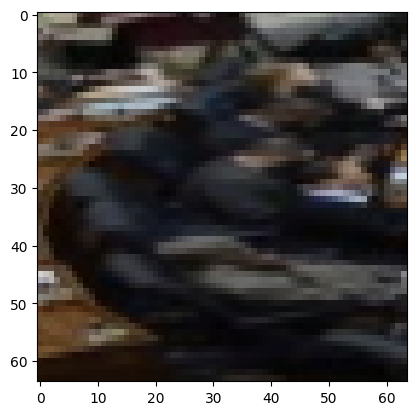

Истинный класс: Furniture, Предсказанный класс: Person


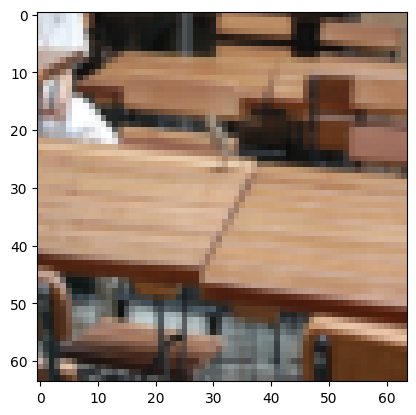

Истинный класс: Tree, Предсказанный класс: House


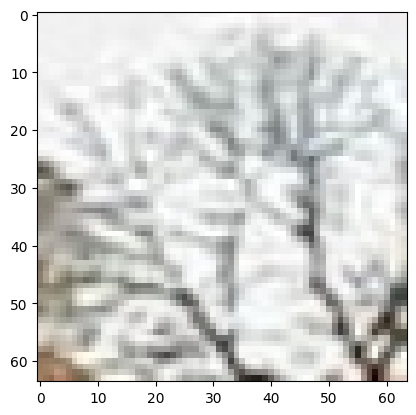

Истинный класс: Car, Предсказанный класс: Building


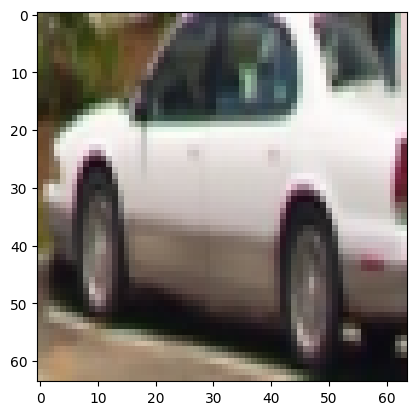

labels ---> tensor([ 96, 114, 164, 114])
predicted ---> tensor([108, 164, 164, 164])
total ---> 976
correct ---> 264
Истинный класс: Man, Предсказанный класс: Person


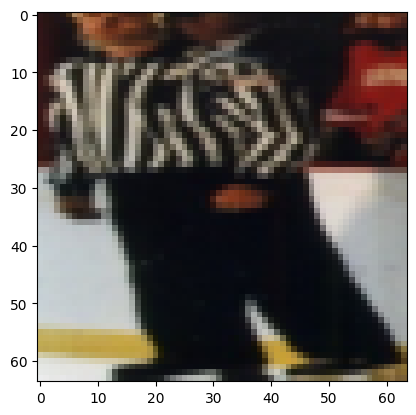

Истинный класс: Poster, Предсказанный класс: Window


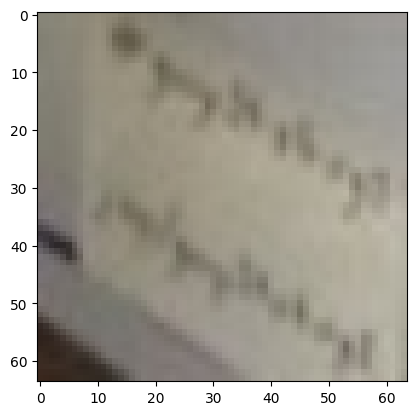

Истинный класс: Window, Предсказанный класс: Window


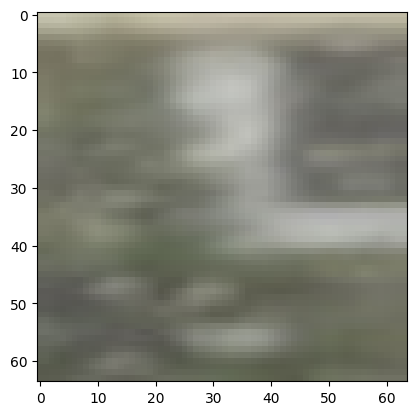

Истинный класс: Poster, Предсказанный класс: Window


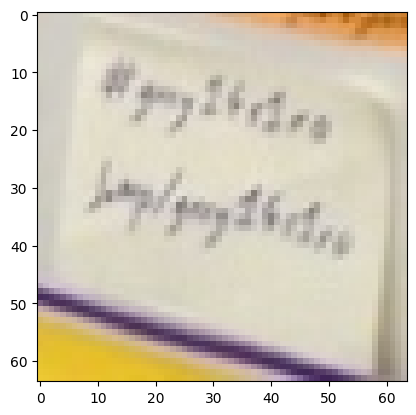

labels ---> tensor([108,  47,  39, 138])
predicted ---> tensor([108, 164, 164, 164])
total ---> 980
correct ---> 265
Истинный класс: Person, Предсказанный класс: Person


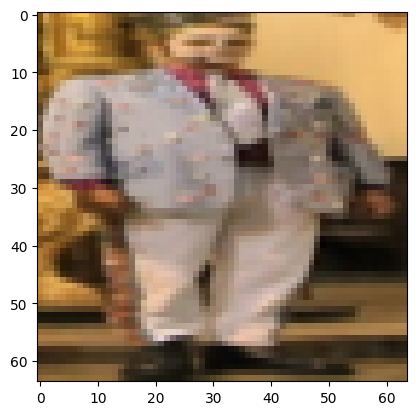

Истинный класс: Door, Предсказанный класс: Window


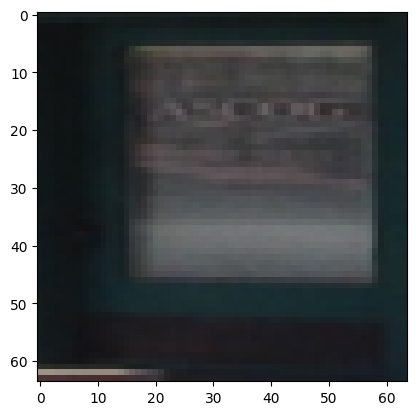

Истинный класс: Computer monitor, Предсказанный класс: Window


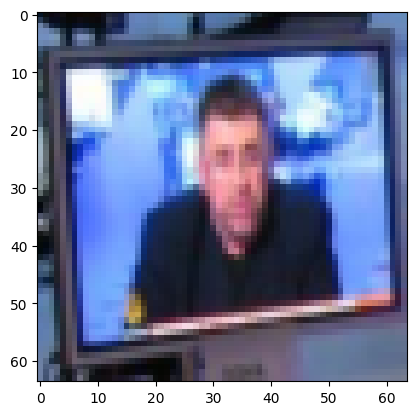

Истинный класс: Tableware, Предсказанный класс: Window


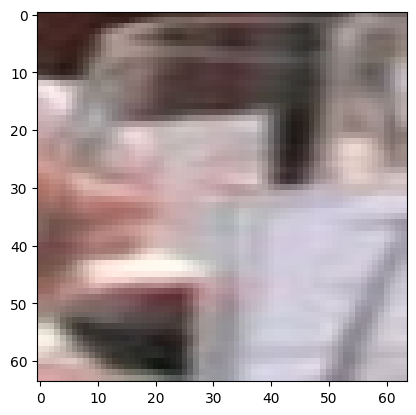

labels ---> tensor([164,  25,  25, 108])
predicted ---> tensor([164, 164,  25,  61])
total ---> 984
correct ---> 267
Истинный класс: Window, Предсказанный класс: Window


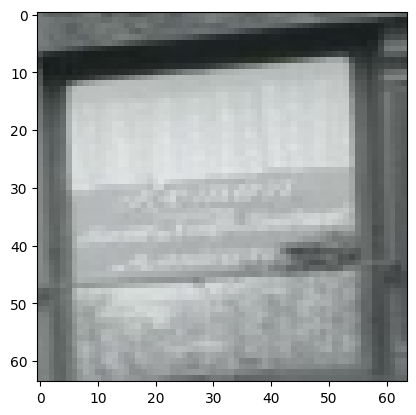

Истинный класс: Building, Предсказанный класс: Window


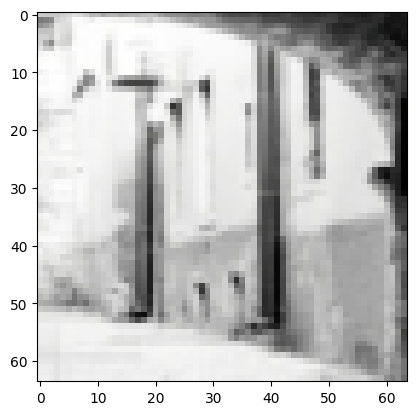

Истинный класс: Building, Предсказанный класс: Building


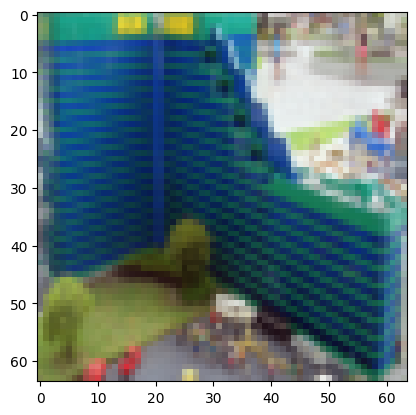

Истинный класс: Person, Предсказанный класс: Footwear


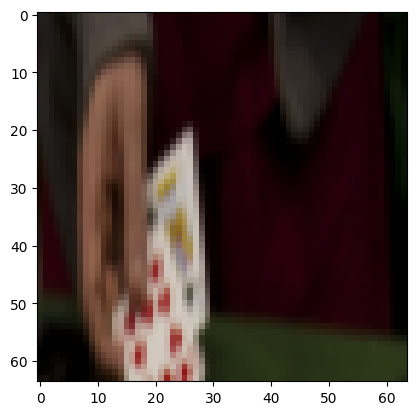

labels ---> tensor([ 29,  25, 164,  25])
predicted ---> tensor([108,  69, 164,  25])
total ---> 988
correct ---> 269
Истинный класс: Car, Предсказанный класс: Person


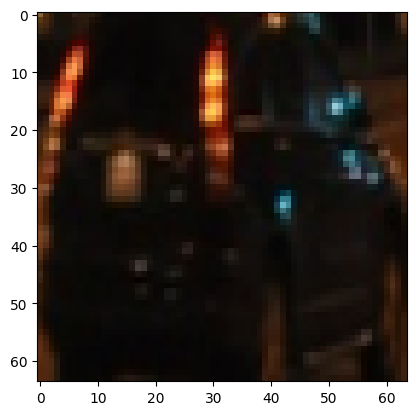

Истинный класс: Building, Предсказанный класс: House


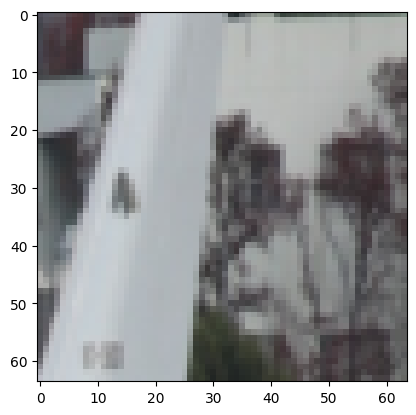

Истинный класс: Window, Предсказанный класс: Window


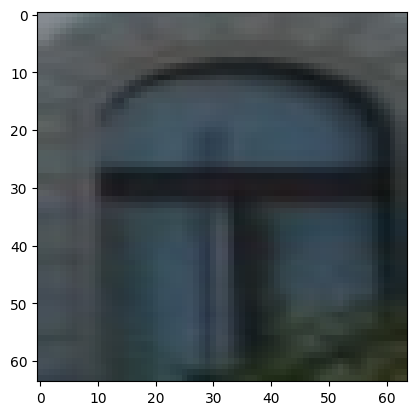

Истинный класс: Building, Предсказанный класс: Building


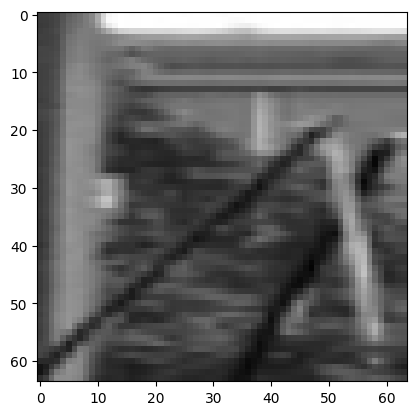

labels ---> tensor([108, 150, 131,  45])
predicted ---> tensor([164,  69, 108, 108])
total ---> 992
correct ---> 269
Истинный класс: Person, Предсказанный класс: Window


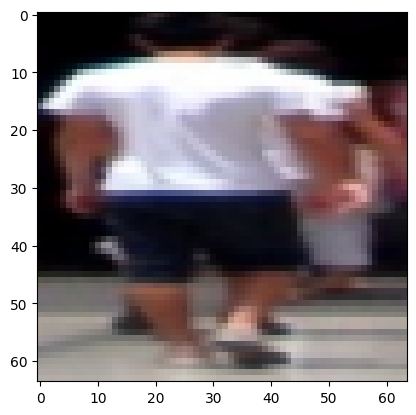

Истинный класс: Tree, Предсказанный класс: House


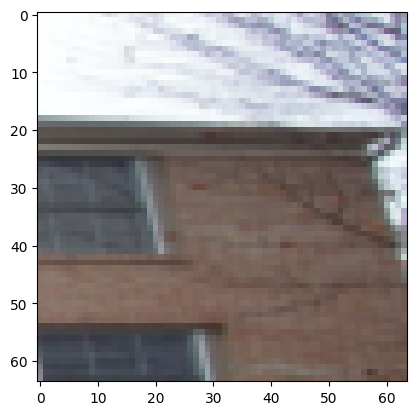

Истинный класс: Street light, Предсказанный класс: Person


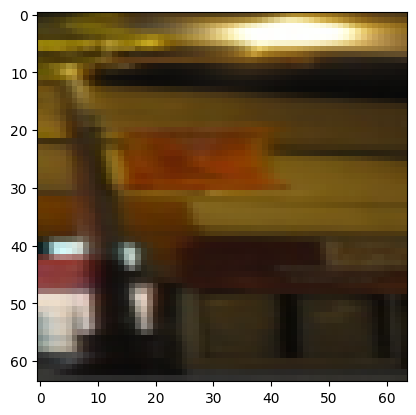

Истинный класс: Desk, Предсказанный класс: Person


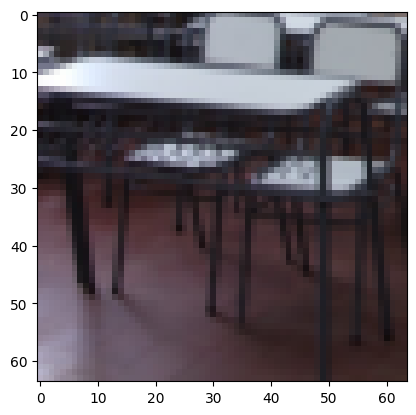

labels ---> tensor([ 25,  25, 111, 118])
predicted ---> tensor([ 25,  25, 164,  25])
total ---> 996
correct ---> 271
Истинный класс: Building, Предсказанный класс: Building


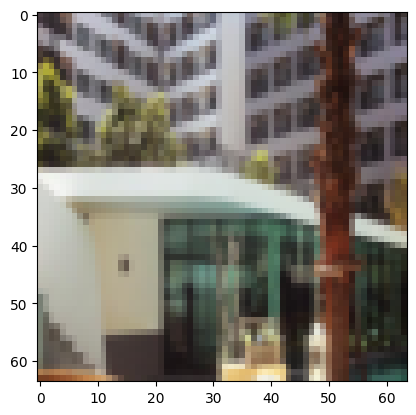

Истинный класс: Building, Предсказанный класс: Building


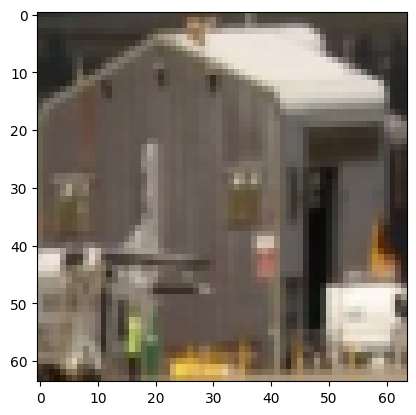

Истинный класс: Pillow, Предсказанный класс: Window


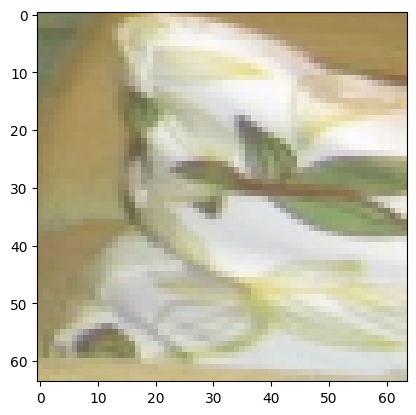

Истинный класс: Sewing machine, Предсказанный класс: Building


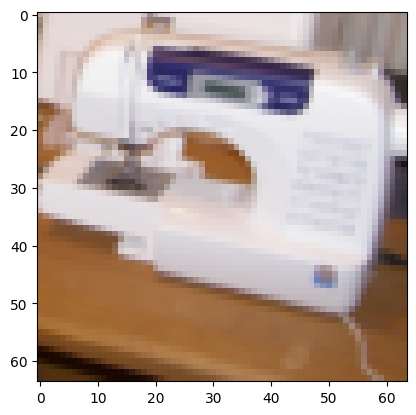

labels ---> tensor([108,  89, 164, 164])
predicted ---> tensor([ 69,  25, 164, 164])
total ---> 1000
correct ---> 273
Истинный класс: Person, Предсказанный класс: House


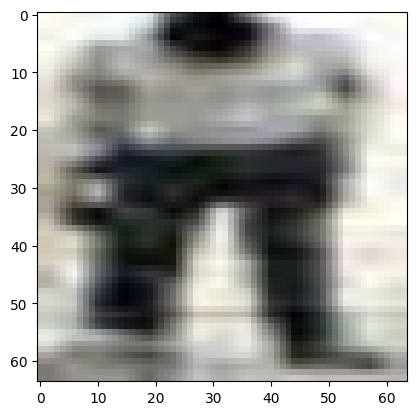

Истинный класс: Land vehicle, Предсказанный класс: Building


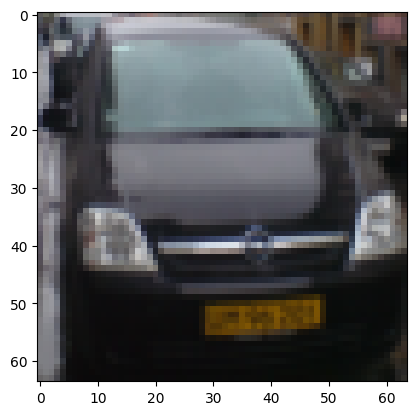

Истинный класс: Window, Предсказанный класс: Window


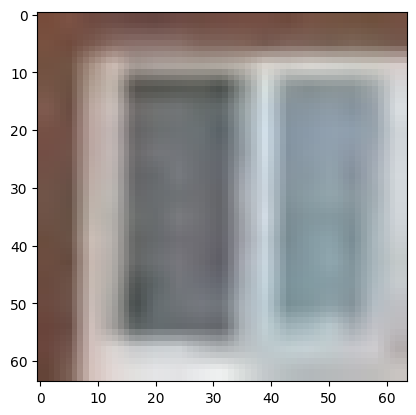

Истинный класс: Window, Предсказанный класс: Window


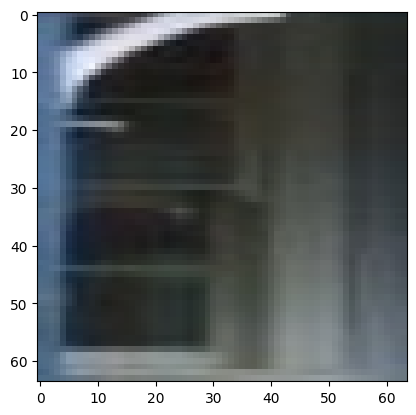

labels ---> tensor([159,  89, 112,  76])
predicted ---> tensor([164, 108, 150, 164])
total ---> 1004
correct ---> 273
Истинный класс: Waste container, Предсказанный класс: Window


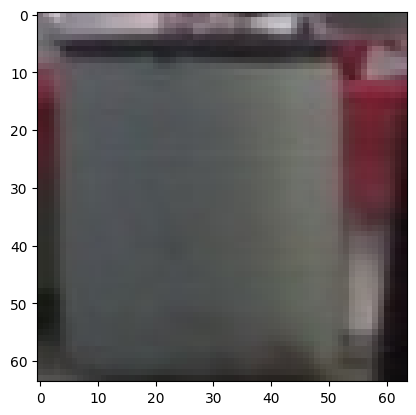

Истинный класс: Land vehicle, Предсказанный класс: Person


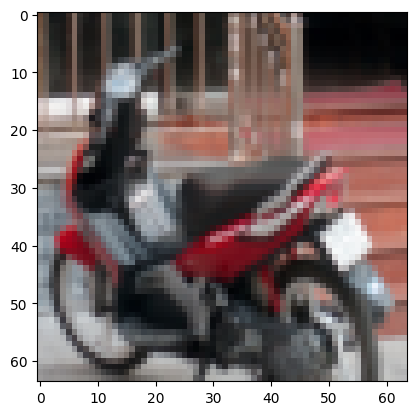

Истинный класс: Plant, Предсказанный класс: Tree


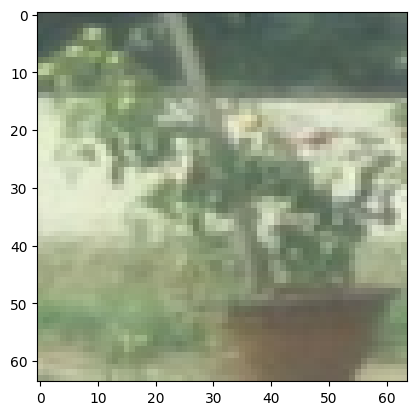

Истинный класс: Human hair, Предсказанный класс: Window


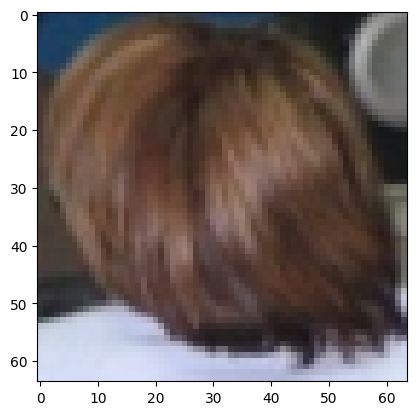

labels ---> tensor([ 25, 164,  36,  25])
predicted ---> tensor([ 25, 164,  25, 164])
total ---> 1008
correct ---> 275
Истинный класс: Building, Предсказанный класс: Building


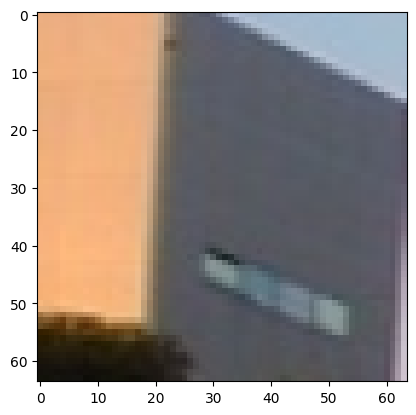

Истинный класс: Window, Предсказанный класс: Window


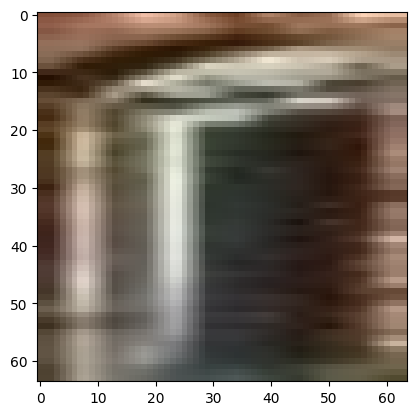

Истинный класс: Clothing, Предсказанный класс: Building


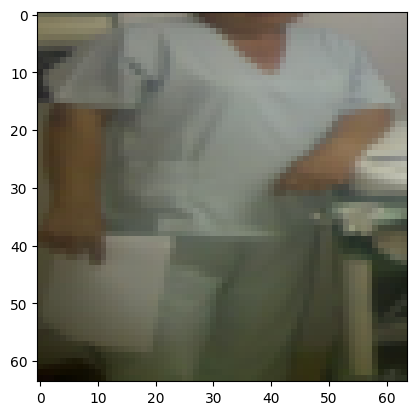

Истинный класс: Building, Предсказанный класс: Window


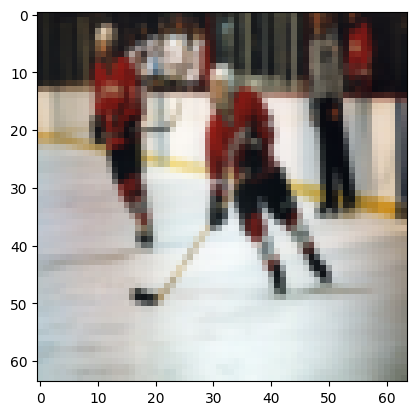

labels ---> tensor([ 25,  69, 108,  61])
predicted ---> tensor([69, 25, 61, 61])
total ---> 1012
correct ---> 276
Истинный класс: Building, Предсказанный класс: House


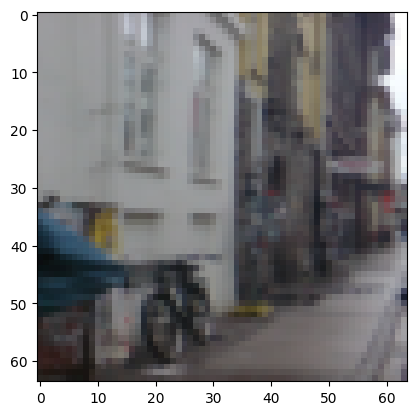

Истинный класс: House, Предсказанный класс: Building


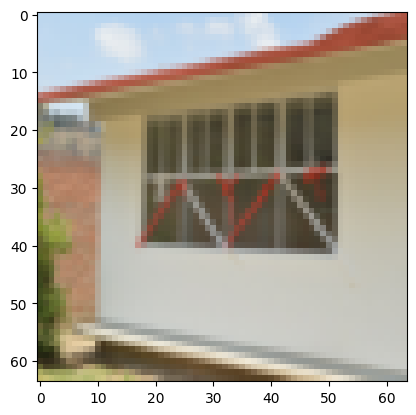

Истинный класс: Person, Предсказанный класс: Footwear


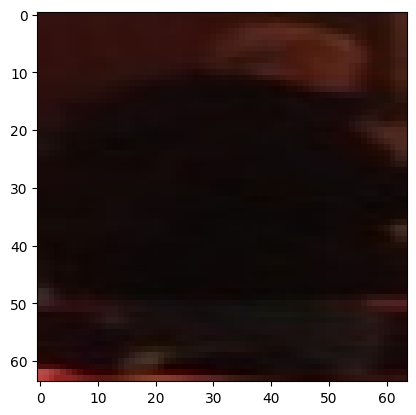

Истинный класс: Footwear, Предсказанный класс: Footwear


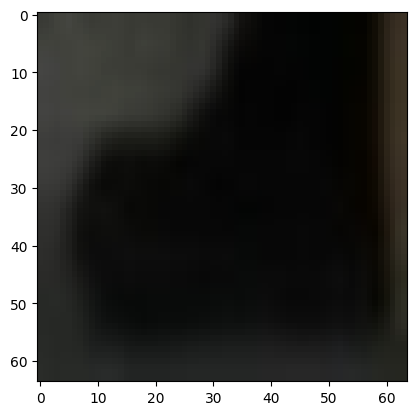

labels ---> tensor([168, 150])
predicted ---> tensor([164, 108])
total ---> 1014
correct ---> 276
Истинный класс: Woman, Предсказанный класс: Window


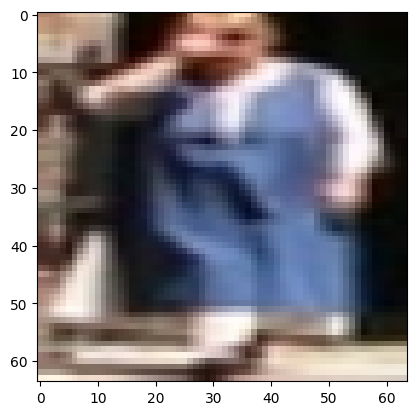

Истинный класс: Tree, Предсказанный класс: Person


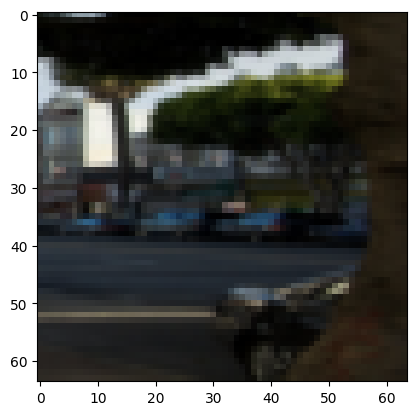

Точность на тестовых данных: 27.22%


In [9]:
# Оценка модели
correct = 0
total = 0
with torch.no_grad():
    for data in testloader:
        images, labels = data
        outputs = net(images)
        print('labels --->', labels)
        _, predicted = torch.max(outputs.data, 1)
        print('predicted --->', predicted)
        total += labels.size(0)
        print('total --->', total)
        correct += (predicted == labels).sum().item()
        print('correct --->', correct)
        # Вывод изображений и предсказаний
        for i in range(len(images)):
            print(f'Истинный класс: {classes[labels[i]]}, Предсказанный класс: {classes[predicted[i]]}')
            imshow(images[i])

print(f'Точность на тестовых данных: {100 * correct / total:.2f}%')